In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
from sklearn.model_selection import LeaveOneOut
from sklearn.metrics import accuracy_score, confusion_matrix, f1_score
from scipy import stats
import matplotlib.ticker as ticker
from sklearn.preprocessing import LabelEncoder
from sklearn.utils.class_weight import compute_class_weight
from collections import Counter
from sklearn.metrics import confusion_matrix, accuracy_score
import seaborn as sns

from collections import Counter
import math

from keras.optimizers import Adam
from keras.models import Sequential
from keras.layers import LSTM, Dense, Dropout, Bidirectional, Normalization
from keras.regularizers import l1, l2
from keras.callbacks import EarlyStopping
from keras.layers import Conv1D, MaxPooling1D, Flatten

seed = 31102016 
rng = np.random.RandomState(seed)

batch_size = 128

2024-01-19 05:28:50.765456: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-19 05:28:50.805024: E tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:9342] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-01-19 05:28:50.805085: E tensorflow/compiler/xla/stream_executor/cuda/cuda_fft.cc:609] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-01-19 05:28:50.805109: E tensorflow/compiler/xla/stream_executor/cuda/cuda_blas.cc:1518] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-01-19 05:28:50.812234: I tensorflow/tsl/cuda/cudart_stub.cc:28] Could not find cuda drivers on your machine, GPU will not be used.
2024-01-19 05:28:50.812908: I tensorflow/core/platform/cpu_feature_guard.cc:182] This Tens

In [2]:
filename = "data/consolidated.csv"  # raw consolidated data
dataset = pd.read_csv(filename, index_col='Unnamed: 0')

dataset.head()

,timestamp,accel_x,accel_y,accel_z,gyro_x,gyro_y,gyro_z,file_id,class
0,1697605965,0.011963,-0.855774,-0.029846,-9.625000,-0.859375,-5.656250,1,ascending_breathingNormal
1,1697606005,-0.001709,-0.826233,-0.036194,0.359375,4.953125,-1.656250,1,ascending_breathingNormal
2,1697606045,-0.058838,-0.933899,-0.032532,3.437500,9.406250,-2.031250,1,ascending_breathingNormal
3,1697606085,-0.002441,-1.115051,-0.028870,3.078125,6.921875,-5.984375,1,ascending_breathingNormal
4,1697606125,-0.036621,-1.035217,-0.076477,4.328125,8.125000,0.625000,1,ascending_breathingNormal


In [3]:
activity_label_dict = {'ascending': 0,
 'descending': 1,
 'lyingBack': 2,
 'lyingLeft': 3,
 'lyingRight': 4,
 'lyingStomach': 5,
 'miscMovement': 6,
 'normalWalking': 7,
 'running': 8,
 'shuffleWalking': 9,
 'sitStand': 10}

sub_activity_label_dict = {'breathingNormal': 0, 'coughing': 1, 'hyperventilating': 2, 'other': 3}

label_sub_activity_dict = {value: key for key, value in sub_activity_label_dict.items()}

stationary_dict = {'lyingBack':0, 'lyingLeft':1, 'lyingRight':2, 'lyingStomach':3, 'sitStand':4}

label_stationary_dict = {value: key for key, value in stationary_dict.items()}

In [4]:
dataset['activity'] = list(map(lambda x: x.split('_')[0], dataset['class']))
dataset['sub_activity'] = list(map(lambda x: x.split('_')[1], dataset['class']))

dataset['activity_label'] = dataset['activity'].replace(activity_label_dict)
dataset['sub_activity_label'] = dataset['sub_activity'].replace(sub_activity_label_dict)

dataset

,timestamp,accel_x,accel_y,accel_z,gyro_x,gyro_y,gyro_z,file_id,class,activity,sub_activity,activity_label,sub_activity_label
0,1697605965,0.011963,-0.855774,-0.029846,-9.625000,-0.859375,-5.656250,1,ascending_breathingNormal,ascending,breathingNormal,0,0
1,1697606005,-0.001709,-0.826233,-0.036194,0.359375,4.953125,-1.656250,1,ascending_breathingNormal,ascending,breathingNormal,0,0
2,1697606045,-0.058838,-0.933899,-0.032532,3.437500,9.406250,-2.031250,1,ascending_breathingNormal,ascending,breathingNormal,0,0
3,1697606085,-0.002441,-1.115051,-0.028870,3.078125,6.921875,-5.984375,1,ascending_breathingNormal,ascending,breathingNormal,0,0
4,1697606125,-0.036621,-1.035217,-0.076477,4.328125,8.125000,0.625000,1,ascending_breathingNormal,ascending,breathingNormal,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,1697636165,-0.206299,-0.975891,0.181335,0.859375,-1.125000,-0.625000,98,sitStand_other,sitStand,other,10,3
756,1697636205,-0.196289,-0.944153,0.163513,0.812500,0.390625,0.203125,98,sitStand_other,sitStand,other,10,3
757,1697636245,-0.194824,-0.959290,0.168640,1.390625,0.421875,0.312500,98,sitStand_other,sitStand,other,10,3
758,1697636285,-0.191406,-0.976868,0.154480,0.546875,0.859375,-0.406250,98,sitStand_other,sitStand,other,10,3


# Task 1

In [5]:
SENSOR_CHANNELS = 3
SLIDING_WINDOW_LENGTH = 125

In [7]:
breatheNormalDataset = dataset[dataset.sub_activity == 'breathingNormal']
students = breatheNormalDataset.file_id.unique()

In [ ]:
def sliding_window(X, label_col):
    step = 10
    segments = []
    labels = []

    for i in range(0, len(X)-SLIDING_WINDOW_LENGTH, step):
        xs = X['accel_x'].values[i: i+SLIDING_WINDOW_LENGTH]
        ys = X['accel_y'].values[i: i+SLIDING_WINDOW_LENGTH]
        zs = X['accel_z'].values[i: i+SLIDING_WINDOW_LENGTH]
            
        d = Counter(X[label_col][i: i+SLIDING_WINDOW_LENGTH])
        
        if len(d)==1:
            label = list(d.keys())[0]
            label = [0]*label+[1]+[0]*(11-label-1)
            segments.append([xs, ys, zs])
            labels.append(label)

    reshaped_segments = np.asarray(segments)
    labels = np.asarray(labels)
    
    X1, X2, y1, y2 = train_test_split(reshaped_segments, labels, test_size=0.2, random_state=rng)
    
    return np.concatenate((X1, X2), axis=0), np.concatenate((y1, y2), axis=0)

In [8]:
def build_model(Xtrn):
    output_dim = 11
    epochs = 100
    dropout_rate = 0.3

    input_shape=(SLIDING_WINDOW_LENGTH, SENSOR_CHANNELS)

    # LSTM parameters
    n_neurons_lstm = 256
    n_neurons = 64

    # optimization parameters
    lr = 0.001
    decay = 1e-6

    normalizer = Normalization()
    normalizer.adapt(Xtrn)

    model = Sequential()
    model.add(normalizer)
    model.add(Bidirectional(LSTM(units = n_neurons_lstm, activation='relu',
                                 kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)), input_shape=(3,125)))
    model.add(Dropout(dropout_rate))
    model.add(Dense(n_neurons, activation='relu', kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)))
    model.add(Dense(output_dim, activation='softmax', kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)))
    adam = Adam(learning_rate=lr, weight_decay=decay)
    model.compile(loss='categorical_crossentropy', optimizer=adam, metrics=['accuracy'])
    model.summary()
    
    return model

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizati  (None, None, 125)         251       
 on)                                                             
                                                                 
 bidirectional (Bidirection  (None, 512)               782336    
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 64)                32832     
                                                                 
 dense_1 (Dense)

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1100 - accuracy: 0.9839 - val_loss: 0.1600 - val_accuracy: 0.9706
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0911 - accuracy: 0.9909 - val_loss: 0.1709 - val_accuracy: 0.9714
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0917 - accuracy: 0.9894 - val_loss: 0.1644 - val_accuracy: 0.9707
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0962 - accuracy: 0.9880 - val_loss: 0.1478 - val_accuracy: 0.9744
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1006 - accuracy: 0.9870 - val_loss: 0.1493 - val_accuracy: 0.9738
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0884 - accuracy: 0.9908 - val_loss: 0.1464 - val_accuracy: 0.9720
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0889 - accuracy: 0.9898 - val_loss: 0.1570 - val_ac

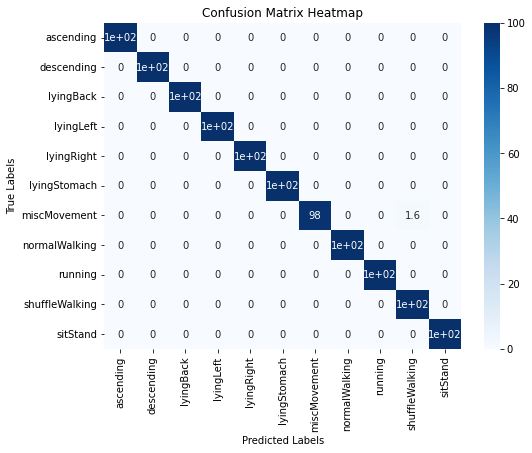

0/71 [0.0652385875582695, 0.9987179636955261] 0.9987179636955261


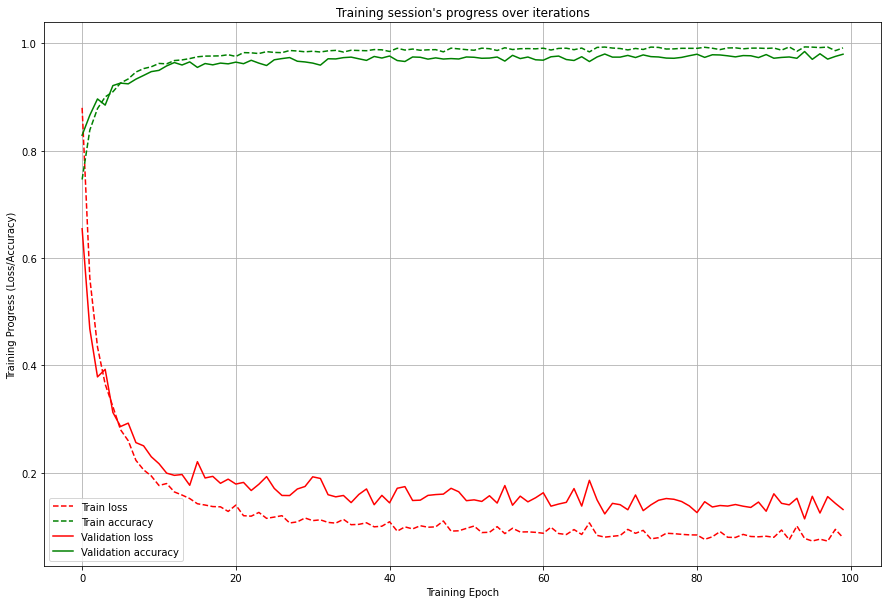

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_1 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_1 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_1 (Dropout)         (None, 512)               0         
                                                                 
 dense_2 (Dense)             (None, 64)                32832     
                                                                 
 dense_3 (Dens

Epoch 48/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0998 - accuracy: 0.9866 - val_loss: 0.1216 - val_accuracy: 0.9800
Epoch 49/100
335/335 [==============================] - 4s 13ms/step - loss: 0.1021 - accuracy: 0.9857 - val_loss: 0.1754 - val_accuracy: 0.9656
Epoch 50/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0923 - accuracy: 0.9890 - val_loss: 0.1431 - val_accuracy: 0.9747
Epoch 51/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0928 - accuracy: 0.9886 - val_loss: 0.1842 - val_accuracy: 0.9626
Epoch 52/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0934 - accuracy: 0.9884 - val_loss: 0.1426 - val_accuracy: 0.9740
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1030 - accuracy: 0.9856 - val_loss: 0.1506 - val_accuracy: 0.9723
Epoch 54/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0913 - accuracy: 0.9893 - val_loss: 0.1347 - val_ac

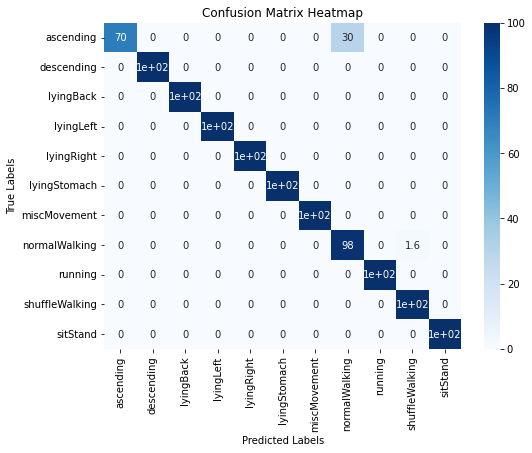

1/71 [0.1487070769071579, 0.9743589758872986] 0.9865384697914124


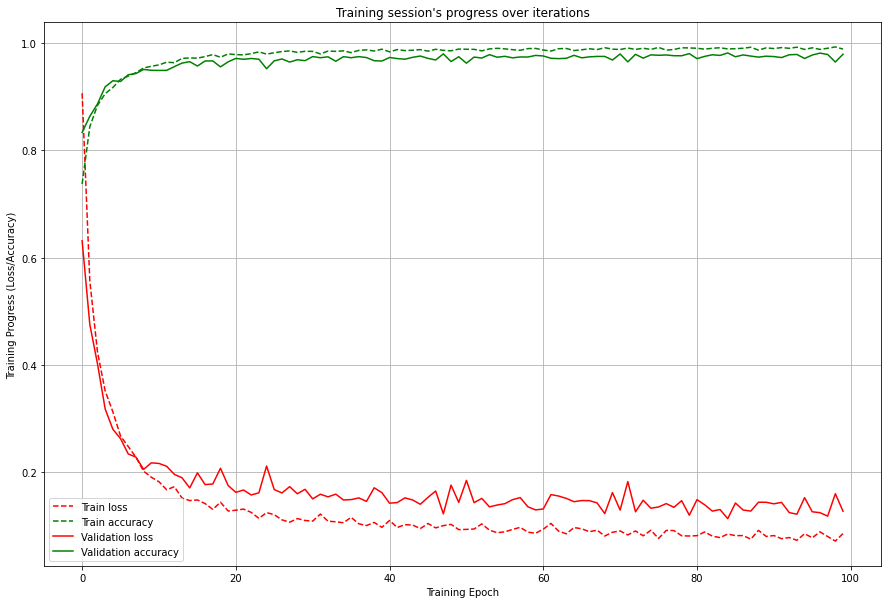

 ..after sliding and reshaping, train data: inputs (53595, 3, 125), targets (53595, 11)
 ..after sliding and reshaping, test data : inputs (767, 3, 125), targets (767, 11)
Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_2 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_2 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_2 (Dropout)         (None, 512)               0         
                                                                 
 dense_4 (Dense)             (None, 64)                32832     
                                                                 
 dense_5 (Dens

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9897 - val_loss: 0.1360 - val_accuracy: 0.9779
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0911 - accuracy: 0.9892 - val_loss: 0.1642 - val_accuracy: 0.9684
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0962 - accuracy: 0.9884 - val_loss: 0.1706 - val_accuracy: 0.9658
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1001 - accuracy: 0.9876 - val_loss: 0.1400 - val_accuracy: 0.9744
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1010 - accuracy: 0.9865 - val_loss: 0.1888 - val_accuracy: 0.9600
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1013 - accuracy: 0.9864 - val_loss: 0.1485 - val_accuracy: 0.9735
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9890 - val_loss: 0.1483 - val_ac

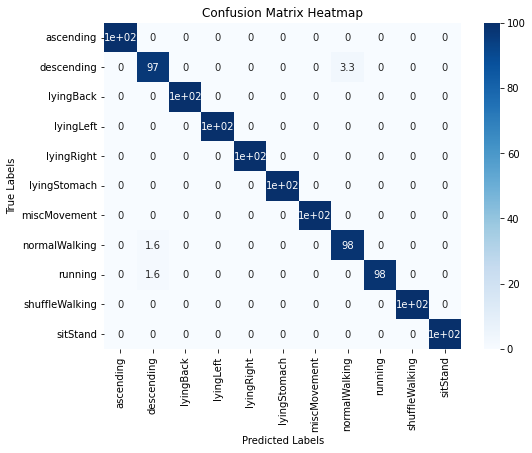

2/71 [0.07398282736539841, 0.9947848916053772] 0.989287277062734


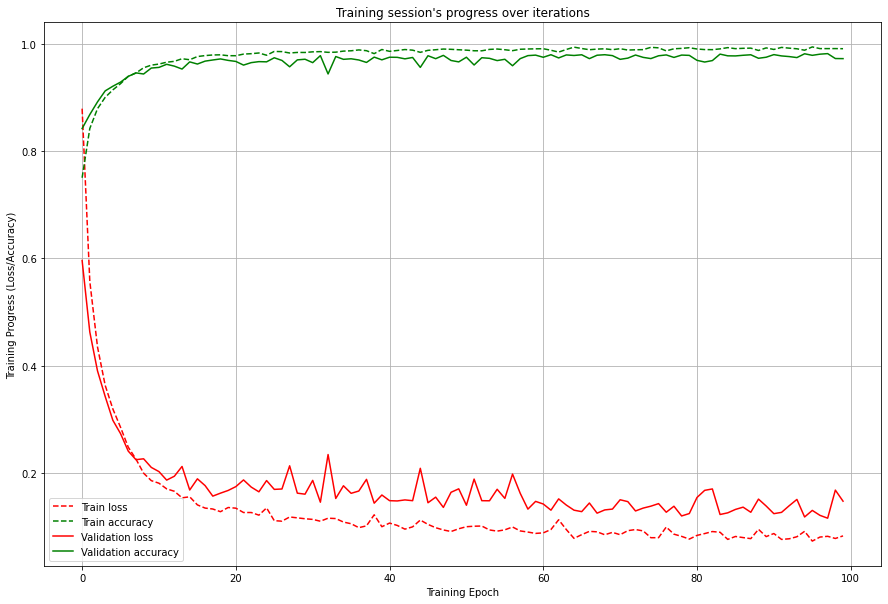

 ..after sliding and reshaping, train data: inputs (53635, 3, 125), targets (53635, 11)
 ..after sliding and reshaping, test data : inputs (772, 3, 125), targets (772, 11)
Model: "sequential_3"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_3 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_3 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_3 (Dropout)         (None, 512)               0         
                                                                 
 dense_6 (Dense)             (None, 64)                32832     
                                                                 
 dense_7 (Dens

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0969 - accuracy: 0.9875 - val_loss: 0.1514 - val_accuracy: 0.9773
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9895 - val_loss: 0.1881 - val_accuracy: 0.9608
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9882 - val_loss: 0.1581 - val_accuracy: 0.9726
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0965 - accuracy: 0.9873 - val_loss: 0.1776 - val_accuracy: 0.9677
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0962 - accuracy: 0.9876 - val_loss: 0.1535 - val_accuracy: 0.9725
Epoch 53/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0958 - accuracy: 0.9878 - val_loss: 0.1467 - val_accuracy: 0.9747
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0982 - accuracy: 0.9881 - val_loss: 0.1472 - val_ac

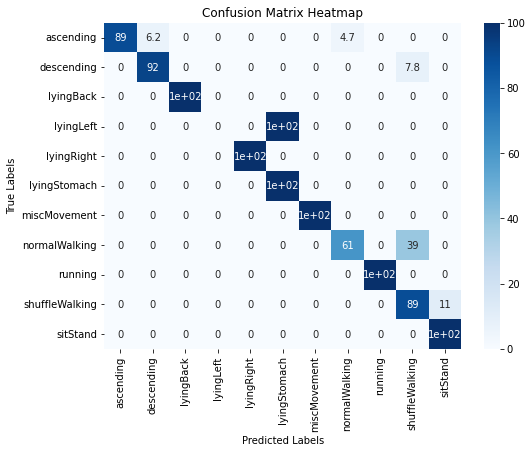

3/71 [0.7154330611228943, 0.8613989353179932] 0.9573151916265488


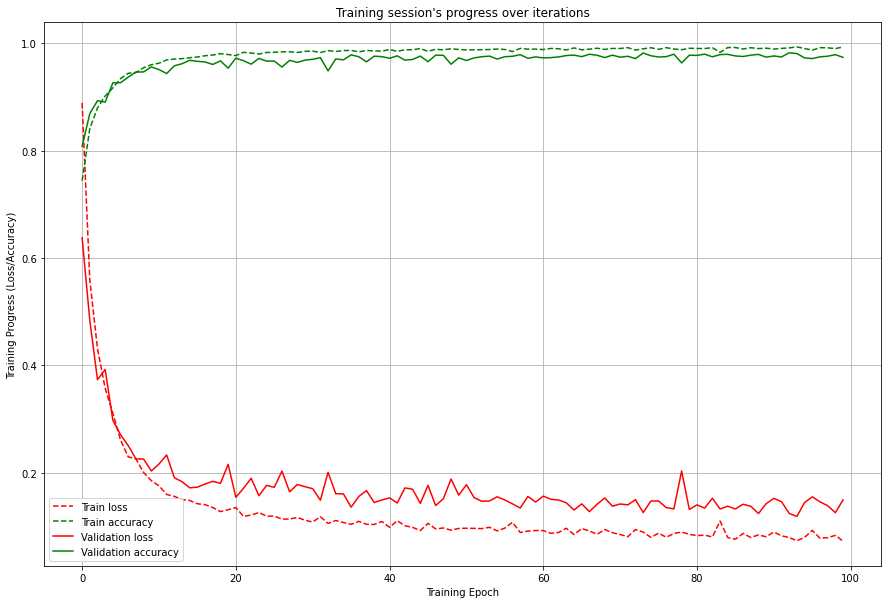

 ..after sliding and reshaping, train data: inputs (53742, 3, 125), targets (53742, 11)
 ..after sliding and reshaping, test data : inputs (756, 3, 125), targets (756, 11)
Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_4 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_4 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_8 (Dense)             (None, 64)                32832     
                                                                 
 dense_9 (Dens

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0927 - accuracy: 0.9887 - val_loss: 0.1437 - val_accuracy: 0.9726
Epoch 49/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0860 - accuracy: 0.9903 - val_loss: 0.1357 - val_accuracy: 0.9757
Epoch 50/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0890 - accuracy: 0.9886 - val_loss: 0.1533 - val_accuracy: 0.9750
Epoch 51/100
336/336 [==============================] - 4s 13ms/step - loss: 0.1024 - accuracy: 0.9852 - val_loss: 0.1384 - val_accuracy: 0.9786
Epoch 52/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0893 - accuracy: 0.9893 - val_loss: 0.1516 - val_accuracy: 0.9725
Epoch 53/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0847 - accuracy: 0.9904 - val_loss: 0.1429 - val_accuracy: 0.9746
Epoch 54/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0890 - accuracy: 0.9886 - val_loss: 0.1791 - val_ac

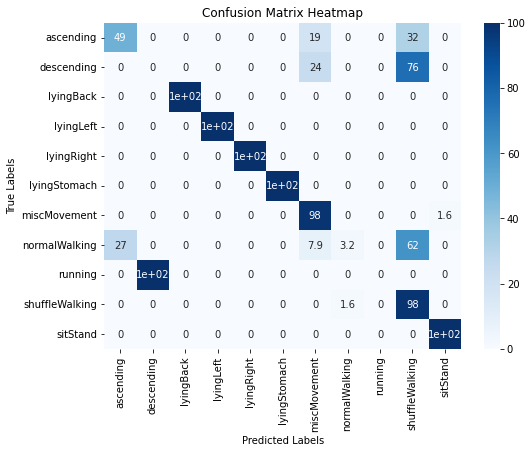

4/71 [2.4585764408111572, 0.7089946866035461] 0.9076510906219483


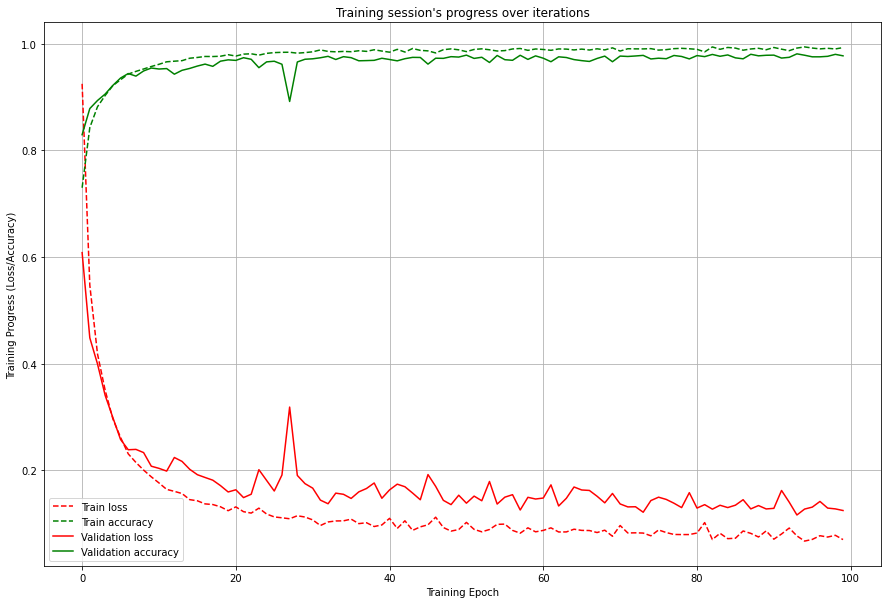

 ..after sliding and reshaping, train data: inputs (53601, 3, 125), targets (53601, 11)
 ..after sliding and reshaping, test data : inputs (702, 3, 125), targets (702, 11)
Model: "sequential_5"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_5 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_5 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_5 (Dropout)         (None, 512)               0         
                                                                 
 dense_10 (Dense)            (None, 64)                32832     
                                                                 
 dense_11 (Den

Epoch 48/100
335/335 [==============================] - 4s 11ms/step - loss: 0.0919 - accuracy: 0.9894 - val_loss: 0.1534 - val_accuracy: 0.9705
Epoch 49/100
335/335 [==============================] - 4s 11ms/step - loss: 0.0949 - accuracy: 0.9883 - val_loss: 0.1403 - val_accuracy: 0.9779
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0902 - accuracy: 0.9897 - val_loss: 0.1443 - val_accuracy: 0.9769
Epoch 51/100
335/335 [==============================] - 4s 11ms/step - loss: 0.1048 - accuracy: 0.9844 - val_loss: 0.1612 - val_accuracy: 0.9728
Epoch 52/100
335/335 [==============================] - 4s 11ms/step - loss: 0.0900 - accuracy: 0.9896 - val_loss: 0.1462 - val_accuracy: 0.9723
Epoch 53/100
335/335 [==============================] - 4s 11ms/step - loss: 0.1078 - accuracy: 0.9853 - val_loss: 0.1387 - val_accuracy: 0.9783
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0879 - accuracy: 0.9909 - val_loss: 0.1510 - val_ac

/tmp/ipykernel_1515363/3992885760.py:25: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100


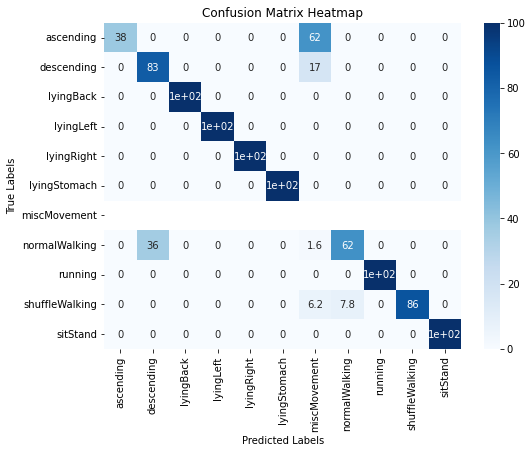

5/71 [0.9912086725234985, 0.8817663788795471] 0.9033369719982147


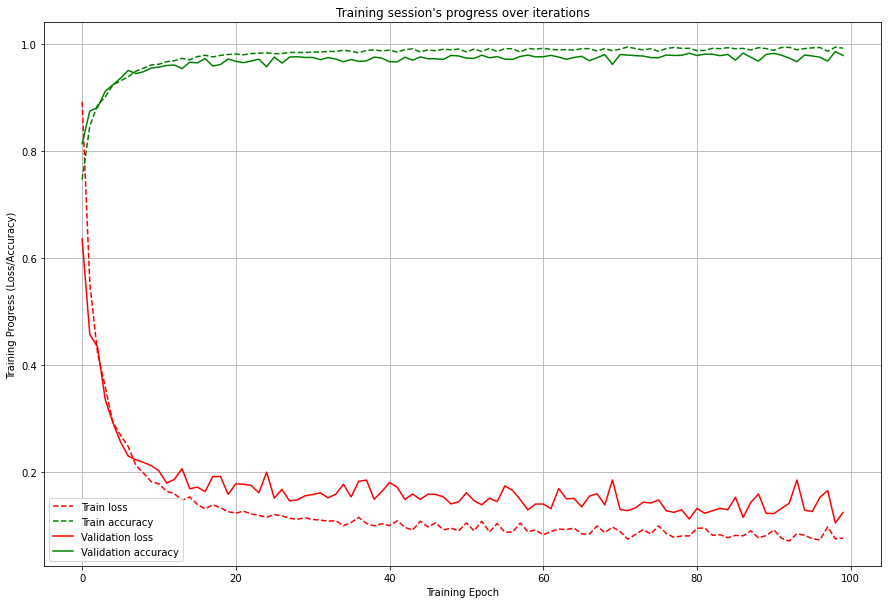

 ..after sliding and reshaping, train data: inputs (53763, 3, 125), targets (53763, 11)
 ..after sliding and reshaping, test data : inputs (776, 3, 125), targets (776, 11)
Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_6 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_6 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_6 (Dropout)         (None, 512)               0         
                                                                 
 dense_12 (Dense)            (None, 64)                32832     
                                                                 
 dense_13 (Den

Epoch 48/100
337/337 [==============================] - 4s 12ms/step - loss: 0.0964 - accuracy: 0.9884 - val_loss: 0.1548 - val_accuracy: 0.9705
Epoch 49/100
337/337 [==============================] - 4s 12ms/step - loss: 0.0975 - accuracy: 0.9879 - val_loss: 0.1556 - val_accuracy: 0.9720
Epoch 50/100
337/337 [==============================] - 4s 12ms/step - loss: 0.0987 - accuracy: 0.9873 - val_loss: 0.1756 - val_accuracy: 0.9676
Epoch 51/100
337/337 [==============================] - 4s 12ms/step - loss: 0.1023 - accuracy: 0.9865 - val_loss: 0.2518 - val_accuracy: 0.9413
Epoch 52/100
337/337 [==============================] - 4s 12ms/step - loss: 0.1023 - accuracy: 0.9862 - val_loss: 0.1631 - val_accuracy: 0.9741
Epoch 53/100
337/337 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9880 - val_loss: 0.1443 - val_accuracy: 0.9766
Epoch 54/100
337/337 [==============================] - 4s 12ms/step - loss: 0.0959 - accuracy: 0.9887 - val_loss: 0.1532 - val_ac

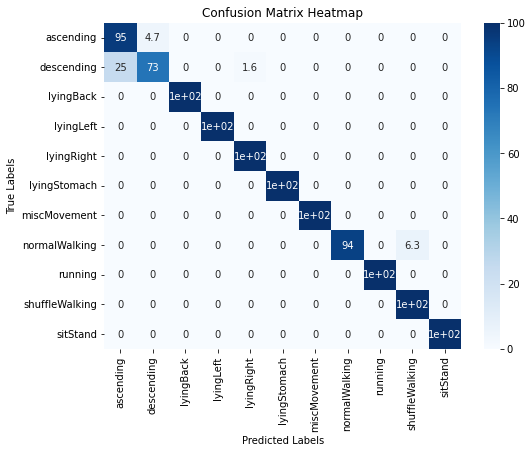

6/71 [0.1706434190273285, 0.969072163105011] 0.9127277135848999


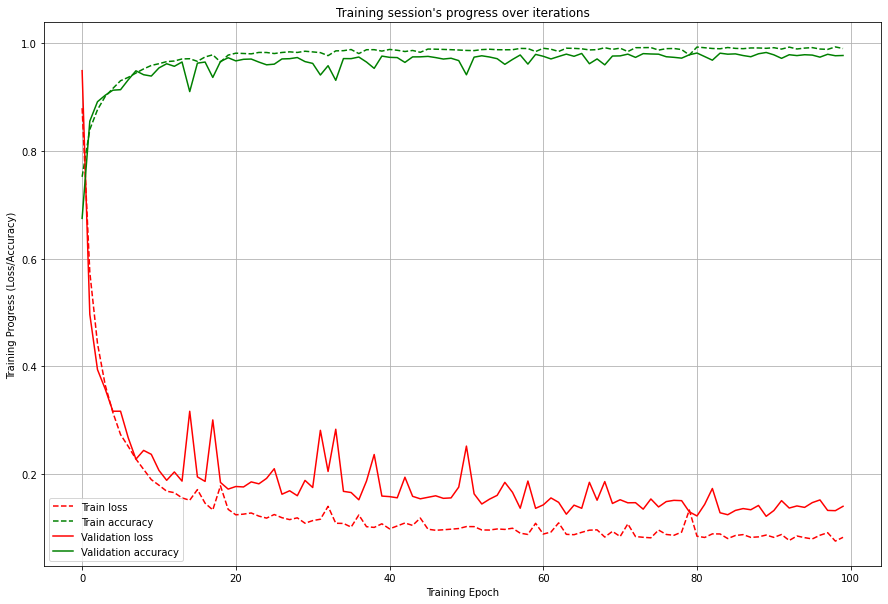

 ..after sliding and reshaping, train data: inputs (53511, 3, 125), targets (53511, 11)
 ..after sliding and reshaping, test data : inputs (798, 3, 125), targets (798, 11)
Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_7 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_7 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_7 (Dropout)         (None, 512)               0         
                                                                 
 dense_14 (Dense)            (None, 64)                32832     
                                                                 
 dense_15 (Den

Epoch 48/100
335/335 [==============================] - 4s 13ms/step - loss: 0.1003 - accuracy: 0.9867 - val_loss: 0.1411 - val_accuracy: 0.9732
Epoch 49/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0987 - accuracy: 0.9870 - val_loss: 0.1763 - val_accuracy: 0.9646
Epoch 50/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0937 - accuracy: 0.9886 - val_loss: 0.1277 - val_accuracy: 0.9781
Epoch 51/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0948 - accuracy: 0.9884 - val_loss: 0.1687 - val_accuracy: 0.9706
Epoch 52/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0989 - accuracy: 0.9866 - val_loss: 0.1340 - val_accuracy: 0.9749
Epoch 53/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0898 - accuracy: 0.9899 - val_loss: 0.1337 - val_accuracy: 0.9760
Epoch 54/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0910 - accuracy: 0.9893 - val_loss: 0.1288 - val_ac

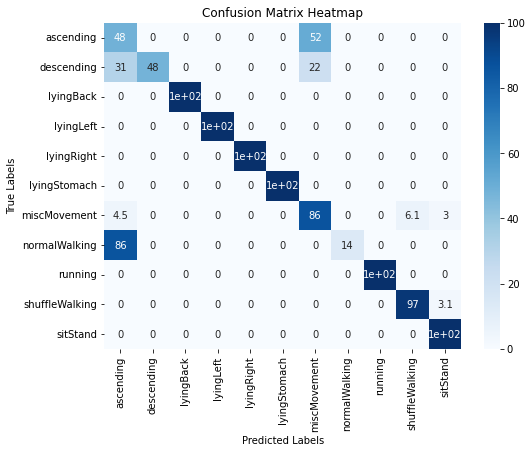

7/71 [0.8490584492683411, 0.8308270573616028] 0.9024901315569878


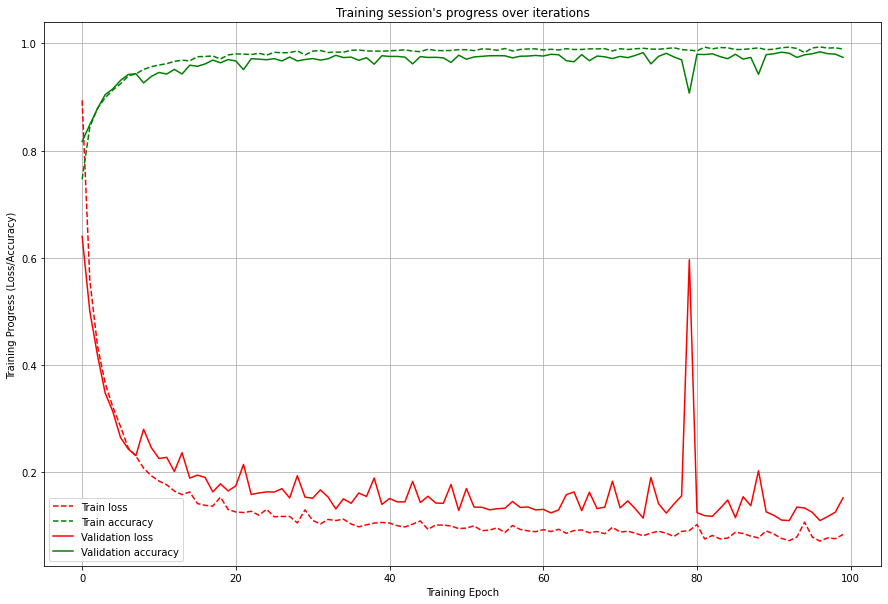

 ..after sliding and reshaping, train data: inputs (53634, 3, 125), targets (53634, 11)
 ..after sliding and reshaping, test data : inputs (768, 3, 125), targets (768, 11)
Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_8 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_8 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_8 (Dropout)         (None, 512)               0         
                                                                 
 dense_16 (Dense)            (None, 64)                32832     
                                                                 
 dense_17 (Den

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0987 - accuracy: 0.9870 - val_loss: 0.1377 - val_accuracy: 0.9757
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0943 - accuracy: 0.9885 - val_loss: 0.1392 - val_accuracy: 0.9782
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0986 - accuracy: 0.9874 - val_loss: 0.1380 - val_accuracy: 0.9770
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0897 - accuracy: 0.9894 - val_loss: 0.1438 - val_accuracy: 0.9771
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1020 - accuracy: 0.9860 - val_loss: 0.1649 - val_accuracy: 0.9700
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9892 - val_loss: 0.1365 - val_accuracy: 0.9775
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0986 - accuracy: 0.9863 - val_loss: 0.1610 - val_ac

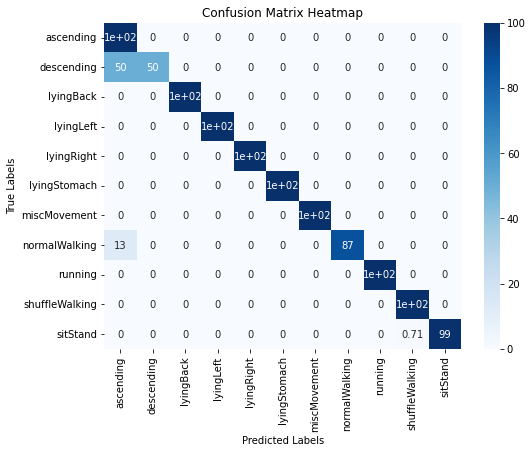

8/71 [0.2503505051136017, 0.9466145634651184] 0.9073928462134467


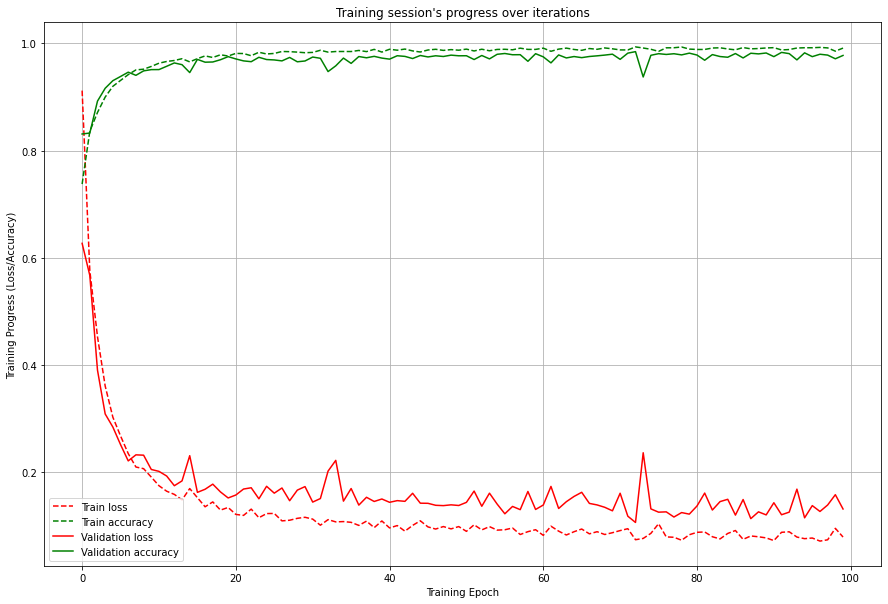

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_9 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_9 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_9 (Dropout)         (None, 512)               0         
                                                                 
 dense_18 (Dense)            (None, 64)                32832     
                                                                 
 dense_19 (Den

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9887 - val_loss: 0.1391 - val_accuracy: 0.9778
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1031 - accuracy: 0.9862 - val_loss: 0.1413 - val_accuracy: 0.9766
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0901 - accuracy: 0.9897 - val_loss: 0.1419 - val_accuracy: 0.9768
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9870 - val_loss: 0.1381 - val_accuracy: 0.9782
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0960 - accuracy: 0.9872 - val_loss: 0.1617 - val_accuracy: 0.9712
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9894 - val_loss: 0.1488 - val_accuracy: 0.9745
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0911 - accuracy: 0.9896 - val_loss: 0.1289 - val_ac

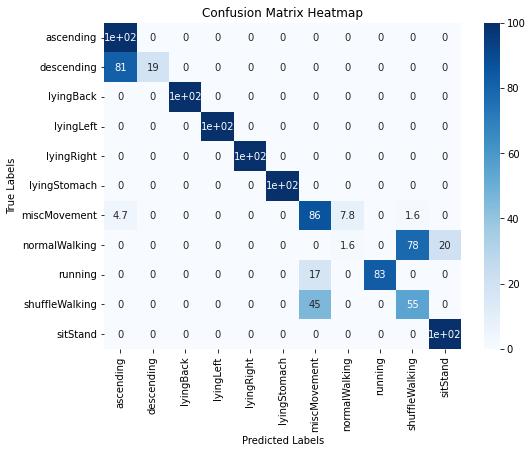

9/71 [0.9273495674133301, 0.7897436022758484] 0.8956279218196869


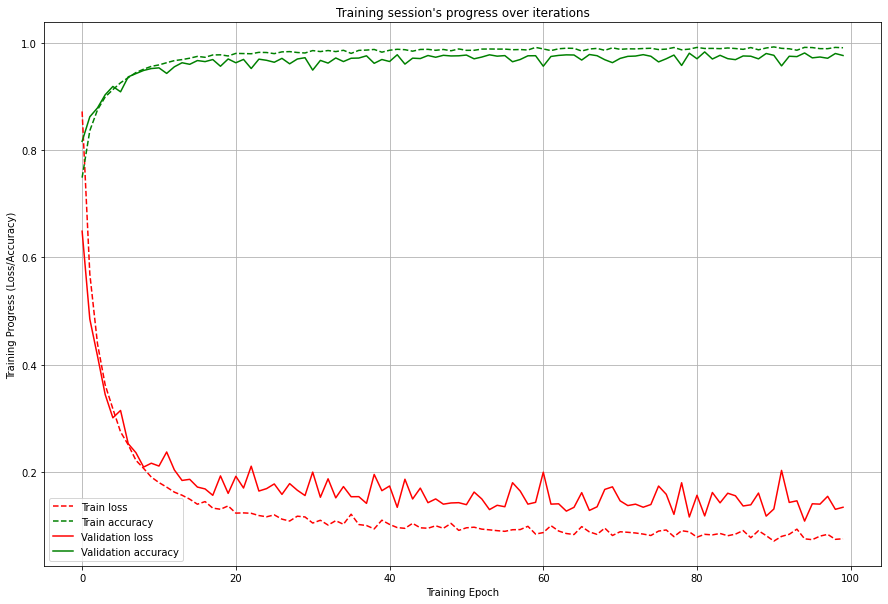

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_10 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_10 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_10 (Dropout)        (None, 512)               0         
                                                                 
 dense_20 (Dense)            (None, 64)                32832     
                                                                 
 dense_21 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0927 - accuracy: 0.9888 - val_loss: 0.1658 - val_accuracy: 0.9696
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0953 - accuracy: 0.9880 - val_loss: 0.1633 - val_accuracy: 0.9685
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9880 - val_loss: 0.1575 - val_accuracy: 0.9732
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1047 - accuracy: 0.9841 - val_loss: 0.1520 - val_accuracy: 0.9707
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0889 - accuracy: 0.9905 - val_loss: 0.1462 - val_accuracy: 0.9743
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9890 - val_loss: 0.1346 - val_accuracy: 0.9752
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0853 - accuracy: 0.9913 - val_loss: 0.1378 - val_ac

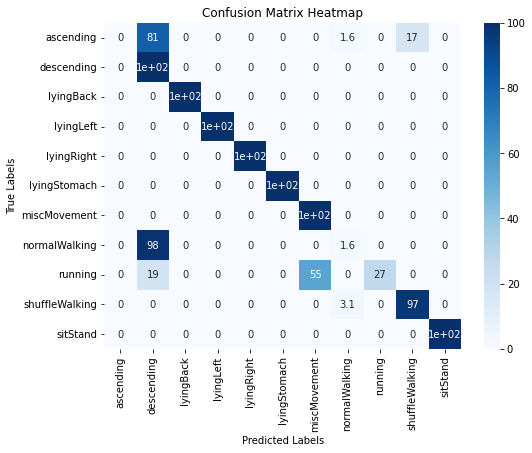

10/71 [2.183790683746338, 0.7743589878082275] 0.8846034732731906


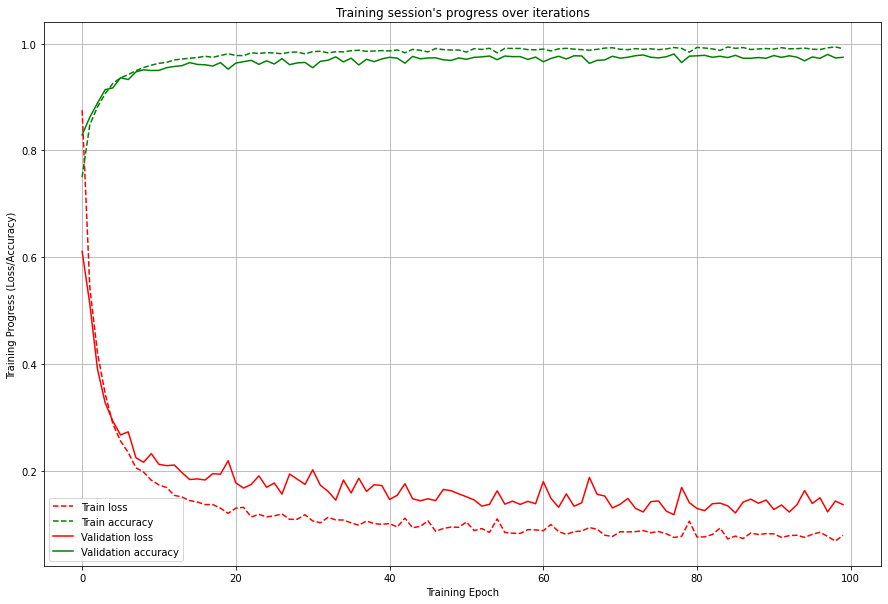

 ..after sliding and reshaping, train data: inputs (53686, 3, 125), targets (53686, 11)
 ..after sliding and reshaping, test data : inputs (775, 3, 125), targets (775, 11)
Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_11 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_11 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_11 (Dropout)        (None, 512)               0         
                                                                 
 dense_22 (Dense)            (None, 64)                32832     
                                                                 
 dense_23 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1016 - accuracy: 0.9869 - val_loss: 0.1596 - val_accuracy: 0.9713
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1041 - accuracy: 0.9855 - val_loss: 0.1839 - val_accuracy: 0.9671
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1126 - accuracy: 0.9839 - val_loss: 0.1591 - val_accuracy: 0.9709
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0946 - accuracy: 0.9894 - val_loss: 0.1572 - val_accuracy: 0.9716
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0916 - accuracy: 0.9902 - val_loss: 0.1519 - val_accuracy: 0.9742
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0923 - accuracy: 0.9894 - val_loss: 0.1394 - val_accuracy: 0.9770
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0907 - accuracy: 0.9893 - val_loss: 0.1489 - val_ac

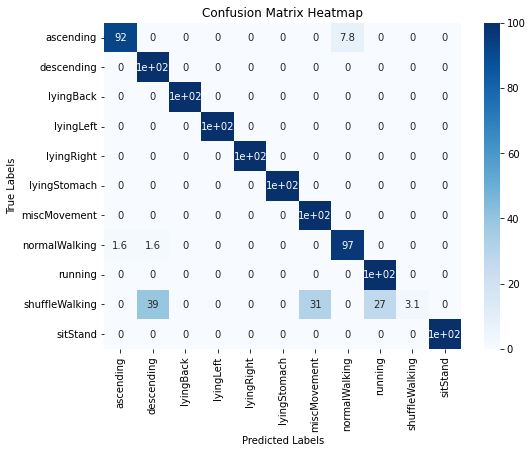

11/71 [0.3970731198787689, 0.9109677672386169] 0.8868004977703094


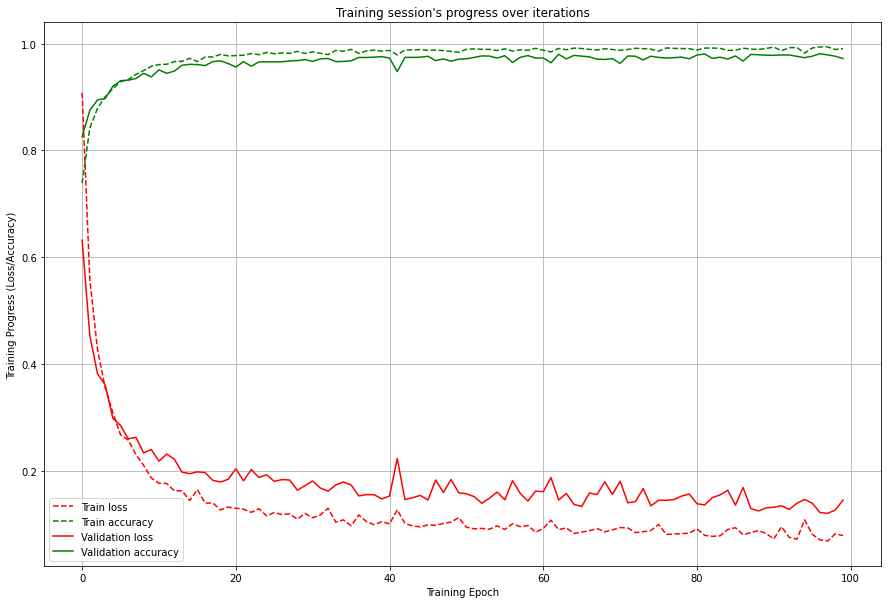

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_12 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_12 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_12 (Dropout)        (None, 512)               0         
                                                                 
 dense_24 (Dense)            (None, 64)                32832     
                                                                 
 dense_25 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1015 - accuracy: 0.9867 - val_loss: 0.1864 - val_accuracy: 0.9648
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1065 - accuracy: 0.9845 - val_loss: 0.1564 - val_accuracy: 0.9740
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0902 - accuracy: 0.9897 - val_loss: 0.1450 - val_accuracy: 0.9777
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0890 - accuracy: 0.9899 - val_loss: 0.1557 - val_accuracy: 0.9775
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0964 - accuracy: 0.9871 - val_loss: 0.1927 - val_accuracy: 0.9649
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9886 - val_loss: 0.1542 - val_accuracy: 0.9763
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0942 - accuracy: 0.9882 - val_loss: 0.1469 - val_ac

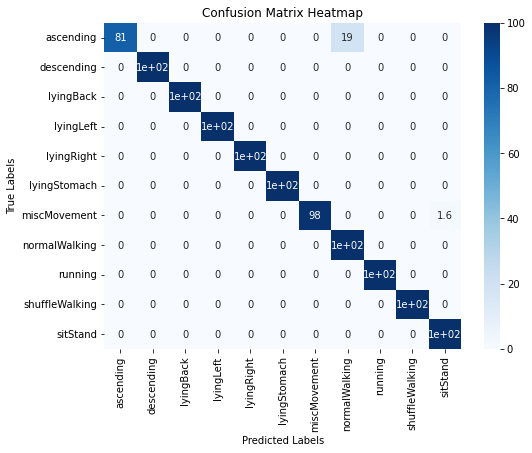

12/71 [0.11007345467805862, 0.9833333492279053] 0.8942261017285861


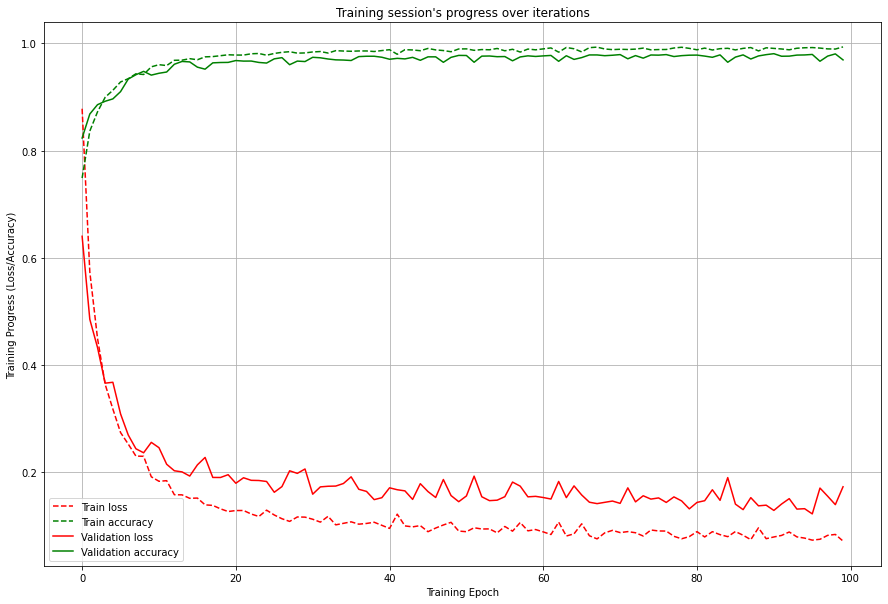

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_13 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_13 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_13 (Dropout)        (None, 512)               0         
                                                                 
 dense_26 (Dense)            (None, 64)                32832     
                                                                 
 dense_27 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1024 - accuracy: 0.9861 - val_loss: 0.2011 - val_accuracy: 0.9557
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0952 - accuracy: 0.9879 - val_loss: 0.1629 - val_accuracy: 0.9684
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9883 - val_loss: 0.1694 - val_accuracy: 0.9683
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1141 - accuracy: 0.9823 - val_loss: 0.1434 - val_accuracy: 0.9772
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0866 - accuracy: 0.9907 - val_loss: 0.1421 - val_accuracy: 0.9770
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0905 - accuracy: 0.9894 - val_loss: 0.1454 - val_accuracy: 0.9752
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0919 - accuracy: 0.9888 - val_loss: 0.1457 - val_ac

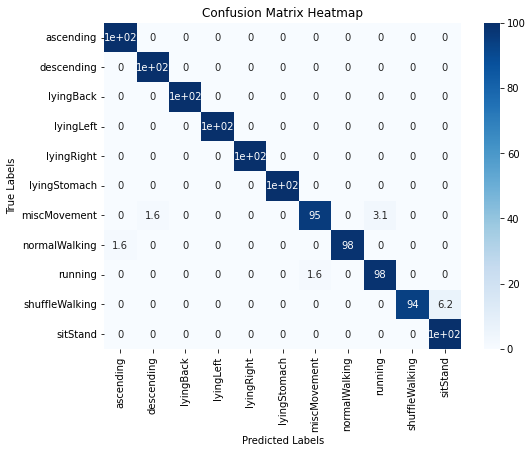

13/71 [0.09817539155483246, 0.9884615540504456] 0.9009572054658618


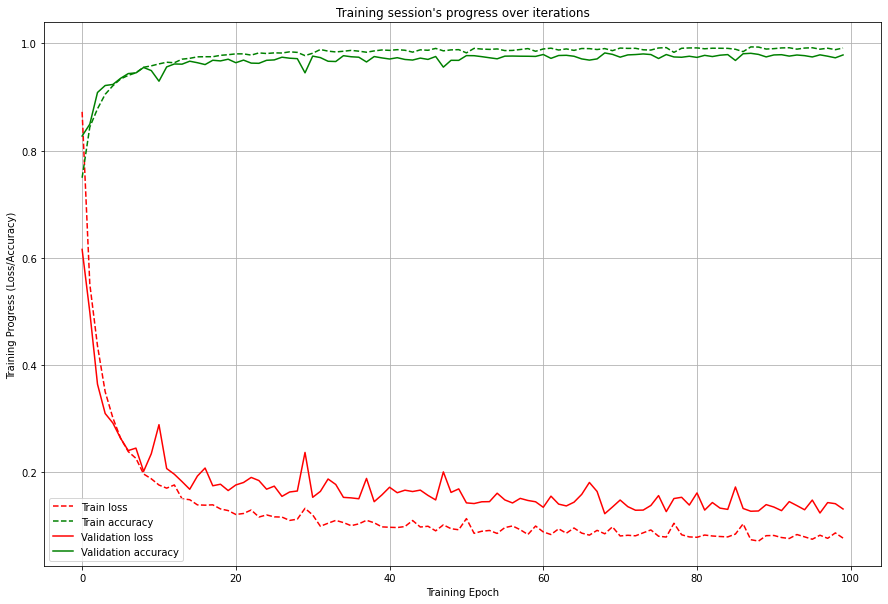

 ..after sliding and reshaping, train data: inputs (53706, 3, 125), targets (53706, 11)
 ..after sliding and reshaping, test data : inputs (785, 3, 125), targets (785, 11)
Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_14 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_14 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_14 (Dropout)        (None, 512)               0         
                                                                 
 dense_28 (Dense)            (None, 64)                32832     
                                                                 
 dense_29 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9893 - val_loss: 0.1468 - val_accuracy: 0.9744
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0907 - accuracy: 0.9901 - val_loss: 0.1450 - val_accuracy: 0.9769
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0969 - accuracy: 0.9879 - val_loss: 0.1603 - val_accuracy: 0.9692
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0969 - accuracy: 0.9882 - val_loss: 0.1460 - val_accuracy: 0.9761
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9880 - val_loss: 0.1348 - val_accuracy: 0.9789
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0933 - accuracy: 0.9888 - val_loss: 0.1478 - val_accuracy: 0.9743
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0951 - accuracy: 0.9875 - val_loss: 0.1784 - val_ac

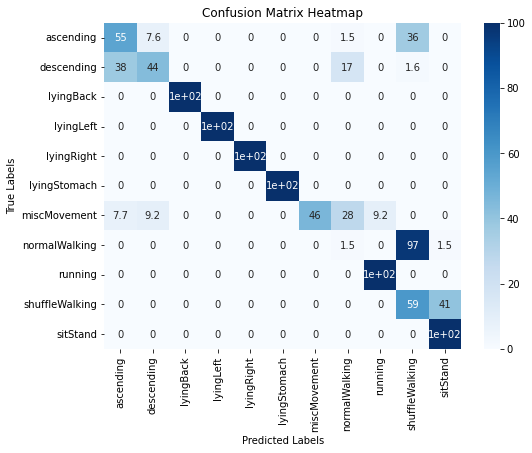

14/71 [1.496538519859314, 0.7566878795623779] 0.8913392504056294


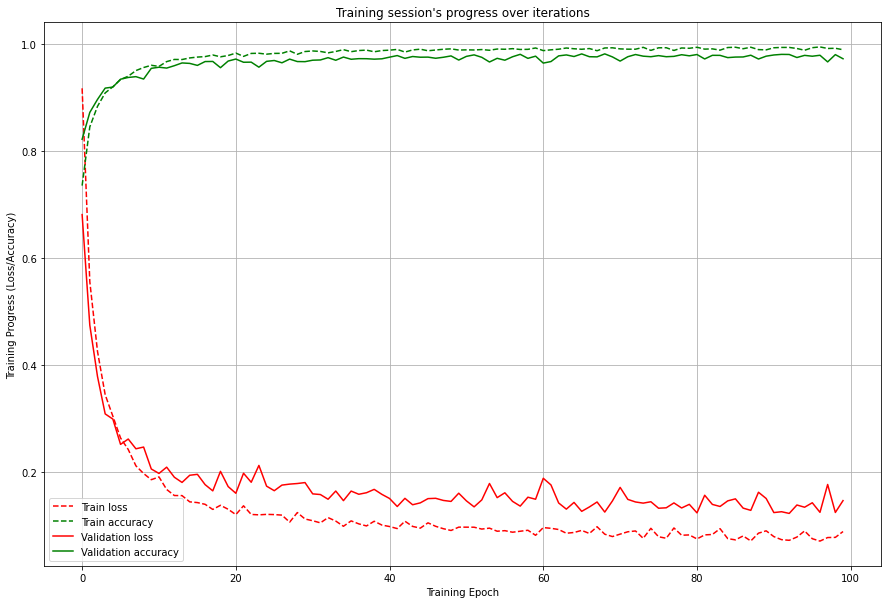

 ..after sliding and reshaping, train data: inputs (53479, 3, 125), targets (53479, 11)
 ..after sliding and reshaping, test data : inputs (785, 3, 125), targets (785, 11)
Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_15 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_15 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_15 (Dropout)        (None, 512)               0         
                                                                 
 dense_30 (Dense)            (None, 64)                32832     
                                                                 
 dense_31 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0886 - accuracy: 0.9909 - val_loss: 0.1638 - val_accuracy: 0.9712
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1003 - accuracy: 0.9867 - val_loss: 0.1430 - val_accuracy: 0.9739
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0905 - accuracy: 0.9898 - val_loss: 0.2041 - val_accuracy: 0.9607
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0995 - accuracy: 0.9866 - val_loss: 0.1672 - val_accuracy: 0.9696
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0990 - accuracy: 0.9874 - val_loss: 0.1479 - val_accuracy: 0.9744
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0937 - accuracy: 0.9890 - val_loss: 0.1617 - val_accuracy: 0.9692
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1090 - accuracy: 0.9843 - val_loss: 0.1341 - val_ac

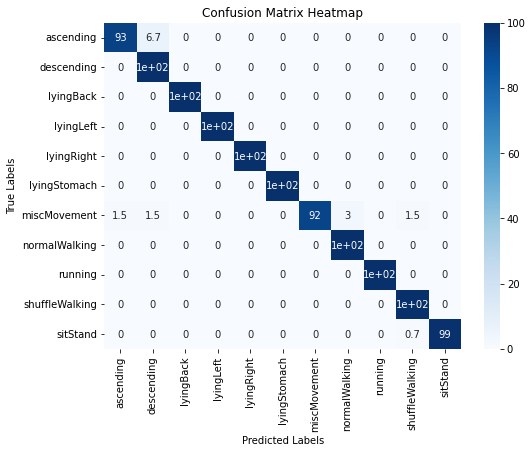

15/71 [0.09735193103551865, 0.987261176109314] 0.8973343707621098


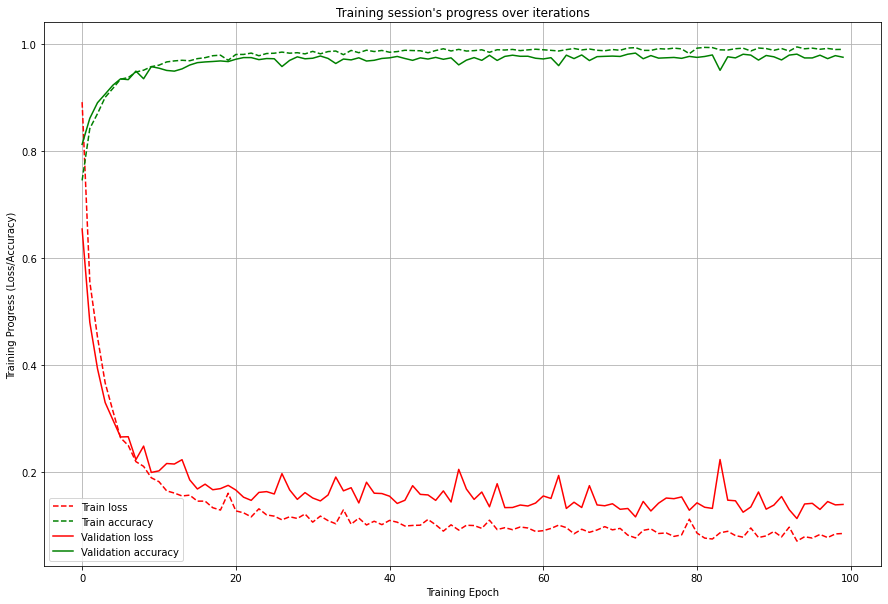

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_16"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_16 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_16 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_16 (Dropout)        (None, 512)               0         
                                                                 
 dense_32 (Dense)            (None, 64)                32832     
                                                                 
 dense_33 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0951 - accuracy: 0.9879 - val_loss: 0.1620 - val_accuracy: 0.9734
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0969 - accuracy: 0.9877 - val_loss: 0.1531 - val_accuracy: 0.9728
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1016 - accuracy: 0.9863 - val_loss: 0.1684 - val_accuracy: 0.9719
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9889 - val_loss: 0.1507 - val_accuracy: 0.9770
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0894 - accuracy: 0.9899 - val_loss: 0.2326 - val_accuracy: 0.9444
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1136 - accuracy: 0.9828 - val_loss: 0.1944 - val_accuracy: 0.9657
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0918 - accuracy: 0.9894 - val_loss: 0.1666 - val_ac

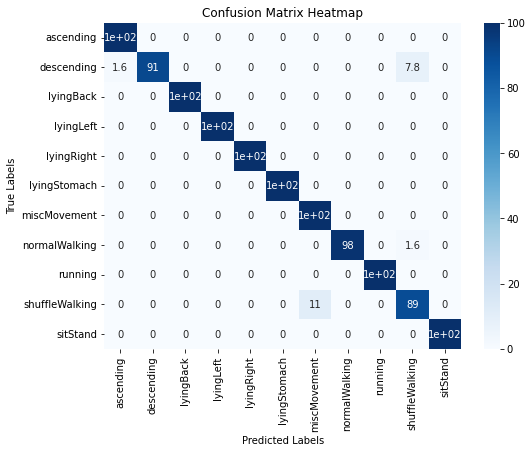

16/71 [0.09622901678085327, 0.9820512533187866] 0.9023177167948555


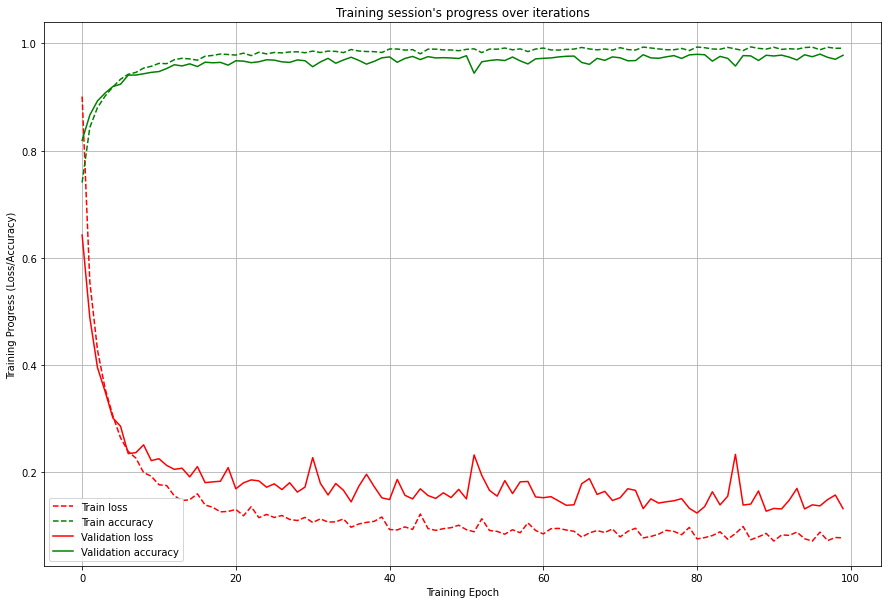

 ..after sliding and reshaping, train data: inputs (53647, 3, 125), targets (53647, 11)
 ..after sliding and reshaping, test data : inputs (769, 3, 125), targets (769, 11)
Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_17 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_17 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_17 (Dropout)        (None, 512)               0         
                                                                 
 dense_34 (Dense)            (None, 64)                32832     
                                                                 
 dense_35 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9875 - val_loss: 0.1491 - val_accuracy: 0.9762
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1051 - accuracy: 0.9858 - val_loss: 0.1877 - val_accuracy: 0.9629
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0979 - accuracy: 0.9887 - val_loss: 0.1356 - val_accuracy: 0.9754
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0950 - accuracy: 0.9889 - val_loss: 0.1654 - val_accuracy: 0.9683
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1011 - accuracy: 0.9864 - val_loss: 0.1480 - val_accuracy: 0.9746
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0918 - accuracy: 0.9894 - val_loss: 0.1575 - val_accuracy: 0.9726
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0879 - accuracy: 0.9897 - val_loss: 0.1547 - val_ac

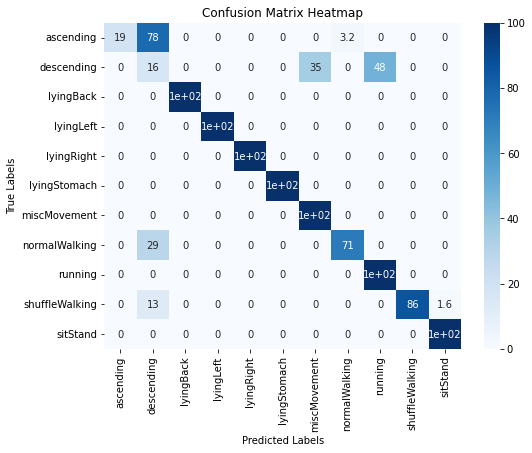

17/71 [1.1739968061447144, 0.8309493064880371] 0.8983528051111433


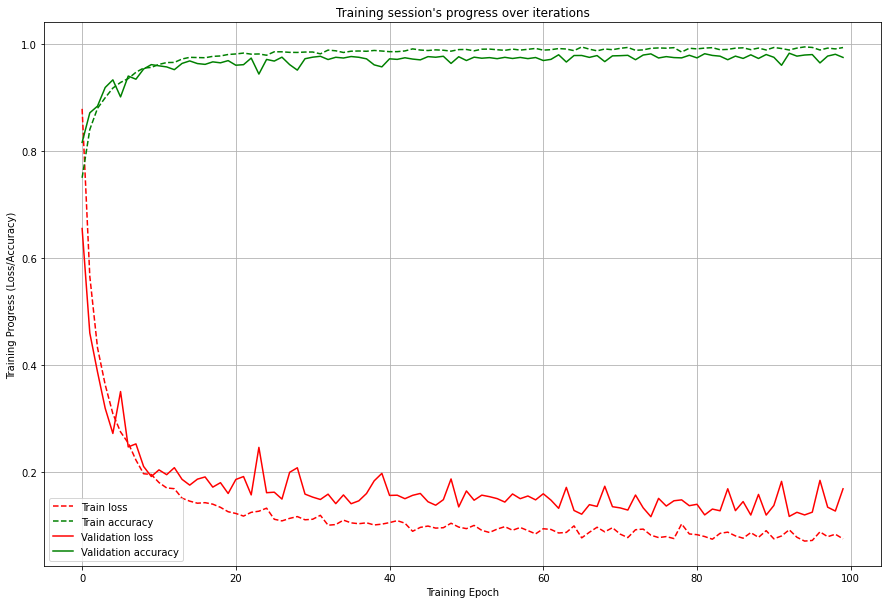

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_18 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_18 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_18 (Dropout)        (None, 512)               0         
                                                                 
 dense_36 (Dense)            (None, 64)                32832     
                                                                 
 dense_37 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0930 - accuracy: 0.9884 - val_loss: 0.1696 - val_accuracy: 0.9663
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1036 - accuracy: 0.9855 - val_loss: 0.2266 - val_accuracy: 0.9500
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1032 - accuracy: 0.9865 - val_loss: 0.1426 - val_accuracy: 0.9765
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0879 - accuracy: 0.9905 - val_loss: 0.1447 - val_accuracy: 0.9772
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0887 - accuracy: 0.9895 - val_loss: 0.1489 - val_accuracy: 0.9785
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0868 - accuracy: 0.9896 - val_loss: 0.1669 - val_accuracy: 0.9699
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0991 - accuracy: 0.9861 - val_loss: 0.1697 - val_ac

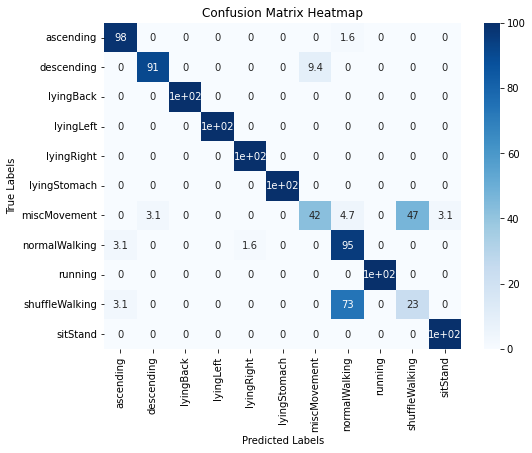

18/71 [0.8881039619445801, 0.8769230842590332] 0.8972249250662955


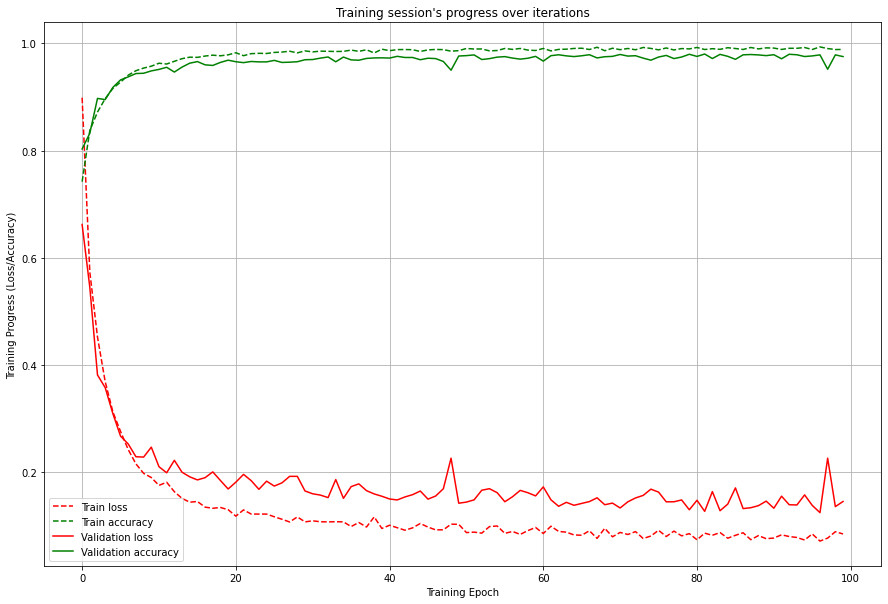

 ..after sliding and reshaping, train data: inputs (53577, 3, 125), targets (53577, 11)
 ..after sliding and reshaping, test data : inputs (761, 3, 125), targets (761, 11)
Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_19 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_19 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_19 (Dropout)        (None, 512)               0         
                                                                 
 dense_38 (Dense)            (None, 64)                32832     
                                                                 
 dense_39 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0888 - accuracy: 0.9898 - val_loss: 0.1425 - val_accuracy: 0.9741
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9880 - val_loss: 0.1494 - val_accuracy: 0.9722
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9883 - val_loss: 0.1356 - val_accuracy: 0.9780
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1063 - accuracy: 0.9845 - val_loss: 0.1318 - val_accuracy: 0.9781
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0869 - accuracy: 0.9906 - val_loss: 0.1400 - val_accuracy: 0.9760
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0953 - accuracy: 0.9876 - val_loss: 0.1360 - val_accuracy: 0.9750
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0868 - accuracy: 0.9900 - val_loss: 0.1474 - val_ac

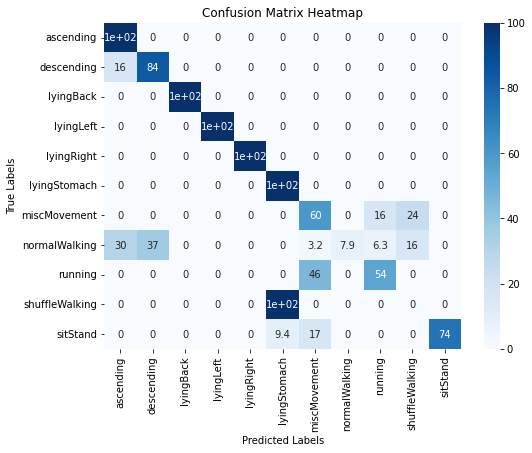

19/71 [3.224945545196533, 0.7095926403999329] 0.8878433108329773


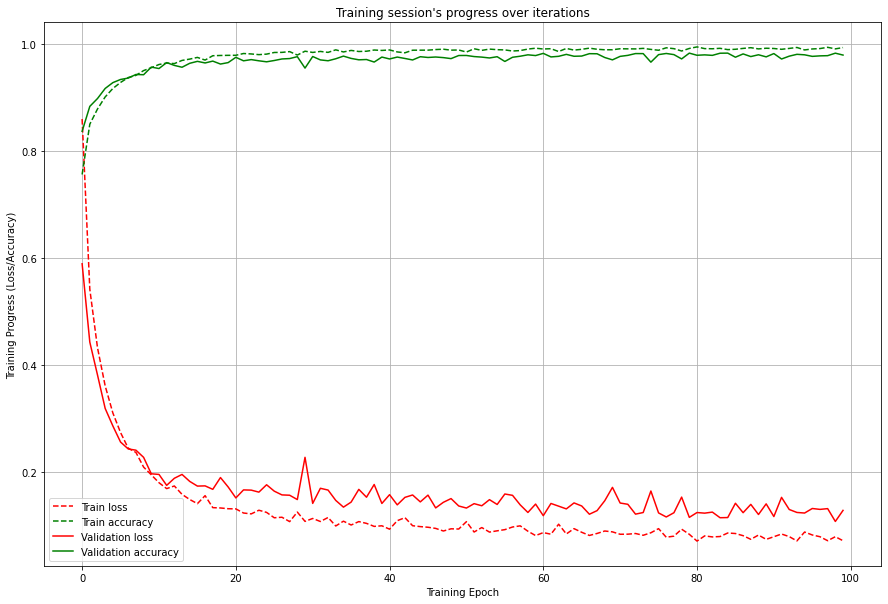

 ..after sliding and reshaping, train data: inputs (53546, 3, 125), targets (53546, 11)
 ..after sliding and reshaping, test data : inputs (768, 3, 125), targets (768, 11)
Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_20 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_20 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_20 (Dropout)        (None, 512)               0         
                                                                 
 dense_40 (Dense)            (None, 64)                32832     
                                                                 
 dense_41 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0955 - accuracy: 0.9881 - val_loss: 0.1361 - val_accuracy: 0.9773
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0990 - accuracy: 0.9867 - val_loss: 0.1555 - val_accuracy: 0.9745
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0900 - accuracy: 0.9909 - val_loss: 0.1356 - val_accuracy: 0.9779
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0987 - accuracy: 0.9863 - val_loss: 0.1493 - val_accuracy: 0.9739
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0957 - accuracy: 0.9881 - val_loss: 0.1526 - val_accuracy: 0.9739
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0899 - accuracy: 0.9900 - val_loss: 0.1528 - val_accuracy: 0.9769
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9889 - val_loss: 0.1944 - val_ac

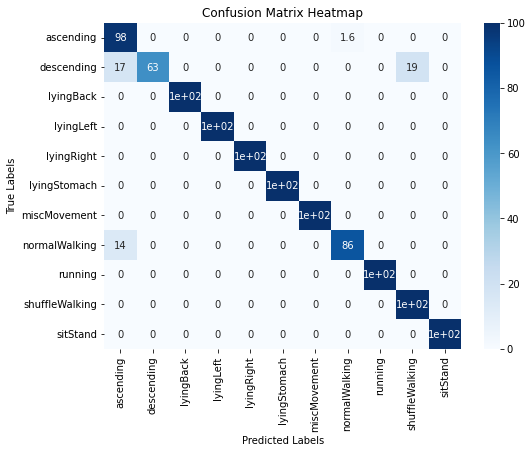

20/71 [0.1606193333864212, 0.95703125] 0.8911379746028355


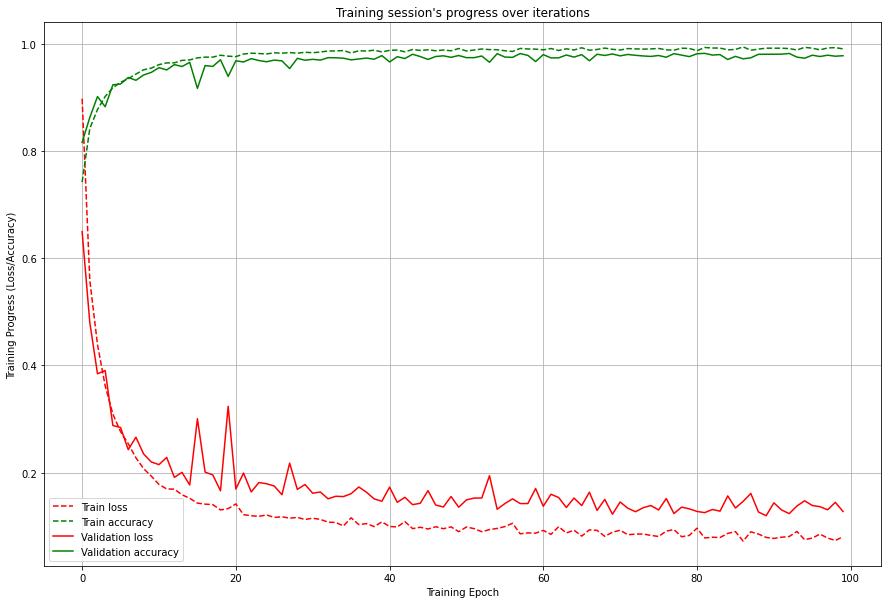

 ..after sliding and reshaping, train data: inputs (53739, 3, 125), targets (53739, 11)
 ..after sliding and reshaping, test data : inputs (774, 3, 125), targets (774, 11)
Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_21 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_21 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_21 (Dropout)        (None, 512)               0         
                                                                 
 dense_42 (Dense)            (None, 64)                32832     
                                                                 
 dense_43 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1001 - accuracy: 0.9871 - val_loss: 0.1554 - val_accuracy: 0.9742
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1003 - accuracy: 0.9875 - val_loss: 0.1639 - val_accuracy: 0.9678
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1130 - accuracy: 0.9833 - val_loss: 0.1696 - val_accuracy: 0.9657
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0950 - accuracy: 0.9899 - val_loss: 0.1424 - val_accuracy: 0.9742
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0909 - accuracy: 0.9899 - val_loss: 0.2057 - val_accuracy: 0.9551
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0988 - accuracy: 0.9875 - val_loss: 0.1566 - val_accuracy: 0.9732
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0893 - accuracy: 0.9907 - val_loss: 0.1361 - val_ac

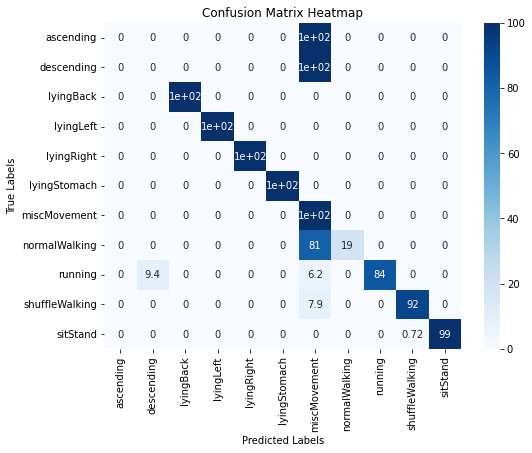

21/71 [3.074908494949341, 0.748062014579773] 0.8846345218745145


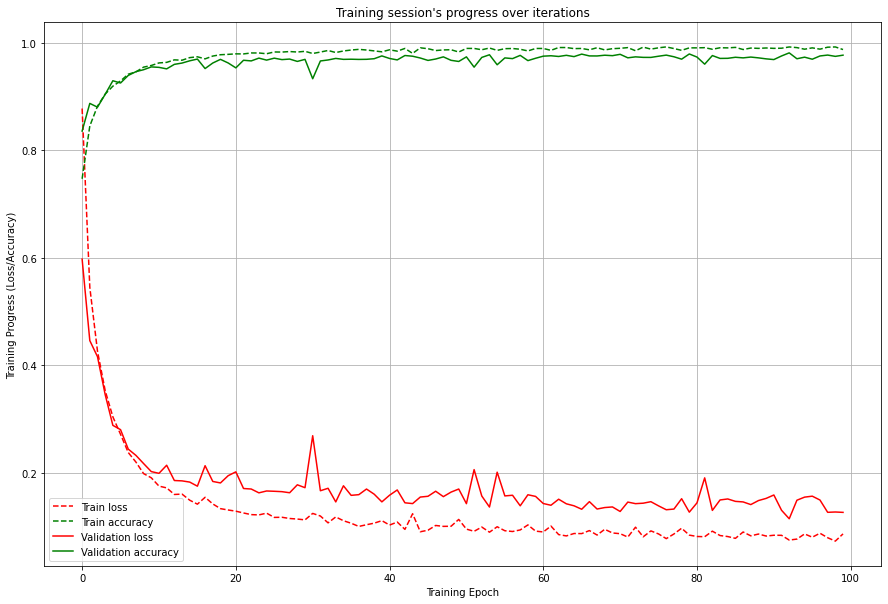

 ..after sliding and reshaping, train data: inputs (53616, 3, 125), targets (53616, 11)
 ..after sliding and reshaping, test data : inputs (792, 3, 125), targets (792, 11)
Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_22 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_22 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_22 (Dropout)        (None, 512)               0         
                                                                 
 dense_44 (Dense)            (None, 64)                32832     
                                                                 
 dense_45 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0947 - accuracy: 0.9882 - val_loss: 0.1354 - val_accuracy: 0.9767
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1010 - accuracy: 0.9861 - val_loss: 0.1383 - val_accuracy: 0.9748
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0978 - accuracy: 0.9871 - val_loss: 0.1443 - val_accuracy: 0.9742
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0856 - accuracy: 0.9908 - val_loss: 0.1520 - val_accuracy: 0.9726
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0998 - accuracy: 0.9866 - val_loss: 0.1390 - val_accuracy: 0.9788
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0853 - accuracy: 0.9909 - val_loss: 0.1818 - val_accuracy: 0.9637
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0911 - accuracy: 0.9893 - val_loss: 0.1604 - val_ac

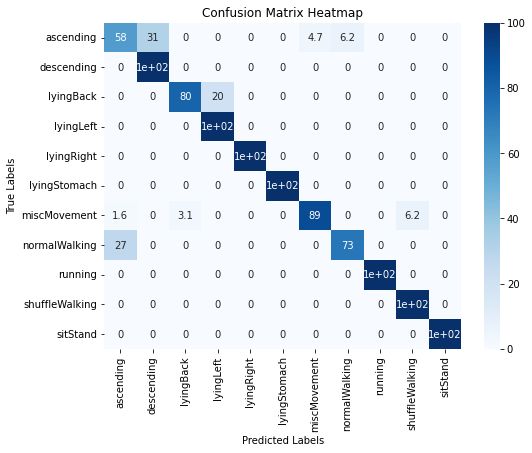

22/71 [0.3740846514701843, 0.9179292917251587] 0.886082120563673


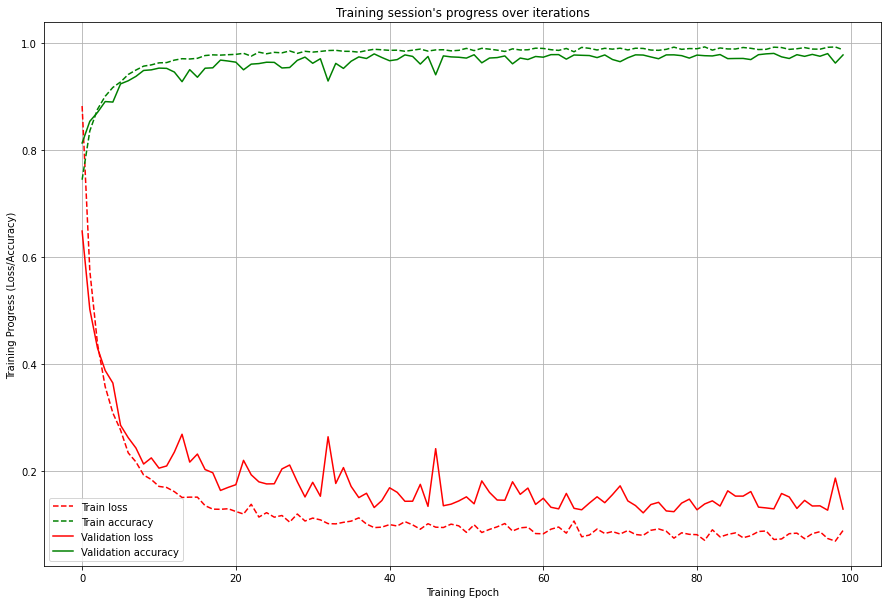

 ..after sliding and reshaping, train data: inputs (53631, 3, 125), targets (53631, 11)
 ..after sliding and reshaping, test data : inputs (767, 3, 125), targets (767, 11)
Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_23 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_23 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_23 (Dropout)        (None, 512)               0         
                                                                 
 dense_46 (Dense)            (None, 64)                32832     
                                                                 
 dense_47 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0986 - accuracy: 0.9875 - val_loss: 0.1385 - val_accuracy: 0.9773
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1005 - accuracy: 0.9868 - val_loss: 0.1486 - val_accuracy: 0.9708
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0896 - accuracy: 0.9904 - val_loss: 0.1508 - val_accuracy: 0.9739
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0992 - accuracy: 0.9871 - val_loss: 0.1463 - val_accuracy: 0.9739
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0917 - accuracy: 0.9890 - val_loss: 0.1560 - val_accuracy: 0.9725
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0864 - accuracy: 0.9901 - val_loss: 0.1294 - val_accuracy: 0.9779
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0908 - accuracy: 0.9887 - val_loss: 0.1520 - val_ac

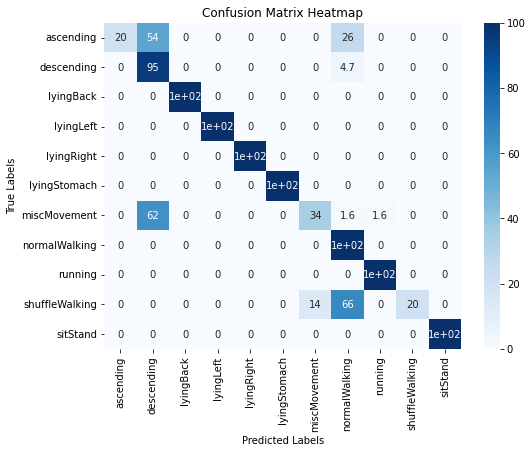

23/71 [1.226190209388733, 0.8109517693519592] 0.8829516892631849


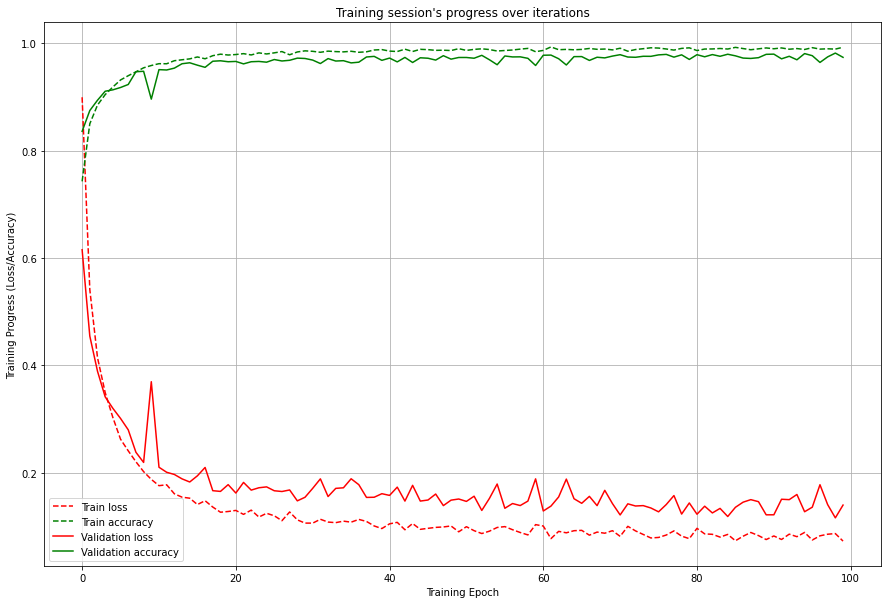

 ..after sliding and reshaping, train data: inputs (53636, 3, 125), targets (53636, 11)
 ..after sliding and reshaping, test data : inputs (767, 3, 125), targets (767, 11)
Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_24 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_24 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_24 (Dropout)        (None, 512)               0         
                                                                 
 dense_48 (Dense)            (None, 64)                32832     
                                                                 
 dense_49 (De

Epoch 48/100
336/336 [==============================] - 4s 13ms/step - loss: 0.0936 - accuracy: 0.9889 - val_loss: 0.1498 - val_accuracy: 0.9757
Epoch 49/100
336/336 [==============================] - 4s 13ms/step - loss: 0.1087 - accuracy: 0.9844 - val_loss: 0.1349 - val_accuracy: 0.9786
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0888 - accuracy: 0.9903 - val_loss: 0.1724 - val_accuracy: 0.9699
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0955 - accuracy: 0.9883 - val_loss: 0.1374 - val_accuracy: 0.9789
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0914 - accuracy: 0.9899 - val_loss: 0.1378 - val_accuracy: 0.9776
Epoch 53/100
336/336 [==============================] - 4s 13ms/step - loss: 0.1042 - accuracy: 0.9853 - val_loss: 0.1327 - val_accuracy: 0.9804
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9878 - val_loss: 0.1465 - val_ac

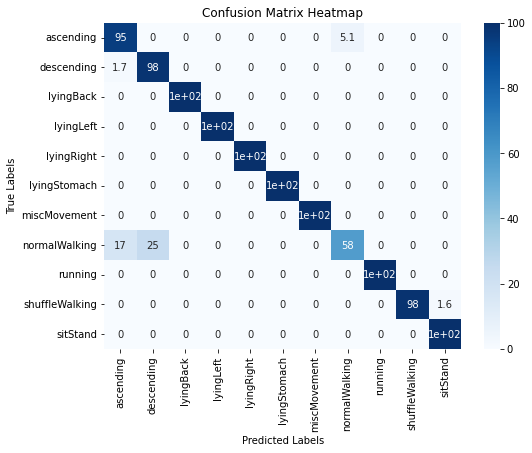

24/71 [0.18935991823673248, 0.958279013633728] 0.8859647822380066


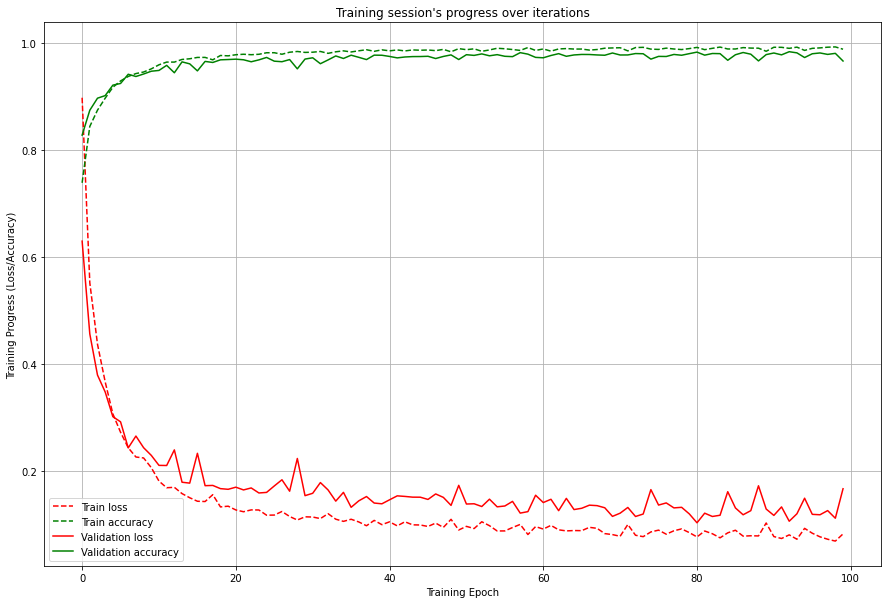

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_25 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_25 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_25 (Dropout)        (None, 512)               0         
                                                                 
 dense_50 (Dense)            (None, 64)                32832     
                                                                 
 dense_51 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1012 - accuracy: 0.9866 - val_loss: 0.1775 - val_accuracy: 0.9677
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1009 - accuracy: 0.9868 - val_loss: 0.1604 - val_accuracy: 0.9713
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0893 - accuracy: 0.9904 - val_loss: 0.1369 - val_accuracy: 0.9782
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0919 - accuracy: 0.9889 - val_loss: 0.1374 - val_accuracy: 0.9754
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1086 - accuracy: 0.9838 - val_loss: 0.1348 - val_accuracy: 0.9807
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0832 - accuracy: 0.9928 - val_loss: 0.1360 - val_accuracy: 0.9783
Epoch 54/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0867 - accuracy: 0.9910 - val_loss: 0.1593 - val_ac

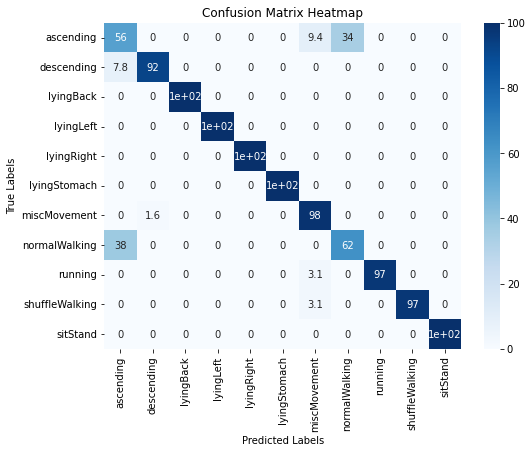

25/71 [0.3276854455471039, 0.9205127954483032] 0.8872935519768641


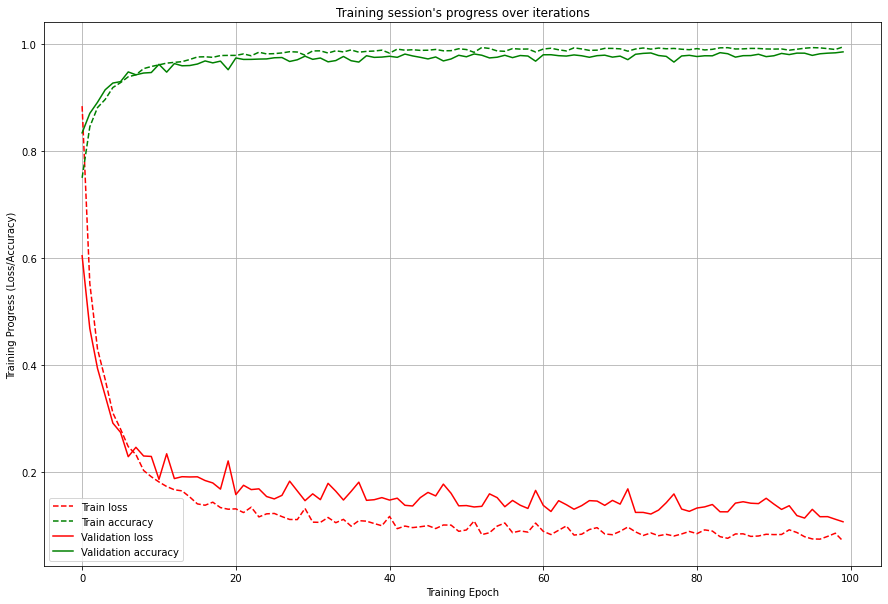

 ..after sliding and reshaping, train data: inputs (53660, 3, 125), targets (53660, 11)
 ..after sliding and reshaping, test data : inputs (652, 3, 125), targets (652, 11)
Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_26 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_26 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_26 (Dropout)        (None, 512)               0         
                                                                 
 dense_52 (Dense)            (None, 64)                32832     
                                                                 
 dense_53 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0985 - accuracy: 0.9875 - val_loss: 0.2223 - val_accuracy: 0.9569
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1019 - accuracy: 0.9863 - val_loss: 0.1566 - val_accuracy: 0.9694
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0953 - accuracy: 0.9881 - val_loss: 0.1376 - val_accuracy: 0.9748
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0900 - accuracy: 0.9894 - val_loss: 0.1479 - val_accuracy: 0.9739
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1038 - accuracy: 0.9855 - val_loss: 0.1590 - val_accuracy: 0.9726
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9886 - val_loss: 0.1441 - val_accuracy: 0.9754
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1006 - accuracy: 0.9873 - val_loss: 0.1554 - val_ac

/tmp/ipykernel_1515363/3992885760.py:25: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100


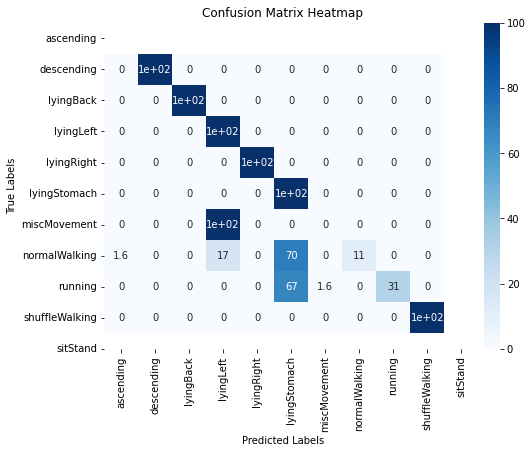

26/71 [2.231200933456421, 0.7469325065612793] 0.8820949947392499


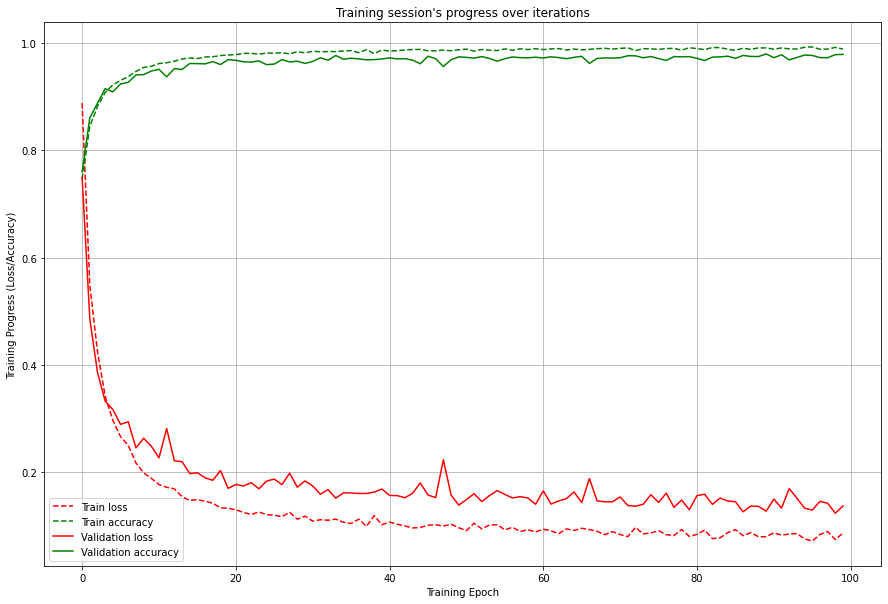

 ..after sliding and reshaping, train data: inputs (53521, 3, 125), targets (53521, 11)
 ..after sliding and reshaping, test data : inputs (771, 3, 125), targets (771, 11)
Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_27 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_27 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_27 (Dropout)        (None, 512)               0         
                                                                 
 dense_54 (Dense)            (None, 64)                32832     
                                                                 
 dense_55 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1015 - accuracy: 0.9870 - val_loss: 0.1406 - val_accuracy: 0.9774
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0920 - accuracy: 0.9895 - val_loss: 0.1537 - val_accuracy: 0.9751
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1052 - accuracy: 0.9850 - val_loss: 0.1698 - val_accuracy: 0.9673
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0879 - accuracy: 0.9905 - val_loss: 0.1499 - val_accuracy: 0.9754
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1062 - accuracy: 0.9849 - val_loss: 0.1589 - val_accuracy: 0.9734
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0860 - accuracy: 0.9911 - val_loss: 0.1442 - val_accuracy: 0.9770
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0934 - accuracy: 0.9886 - val_loss: 0.1465 - val_ac

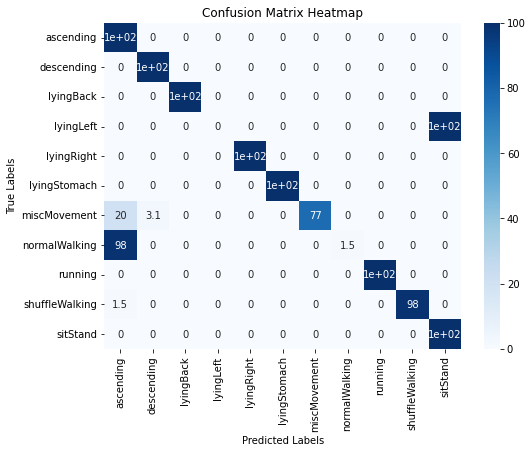

27/71 [1.0410224199295044, 0.8132295608520508] 0.8796355149575642


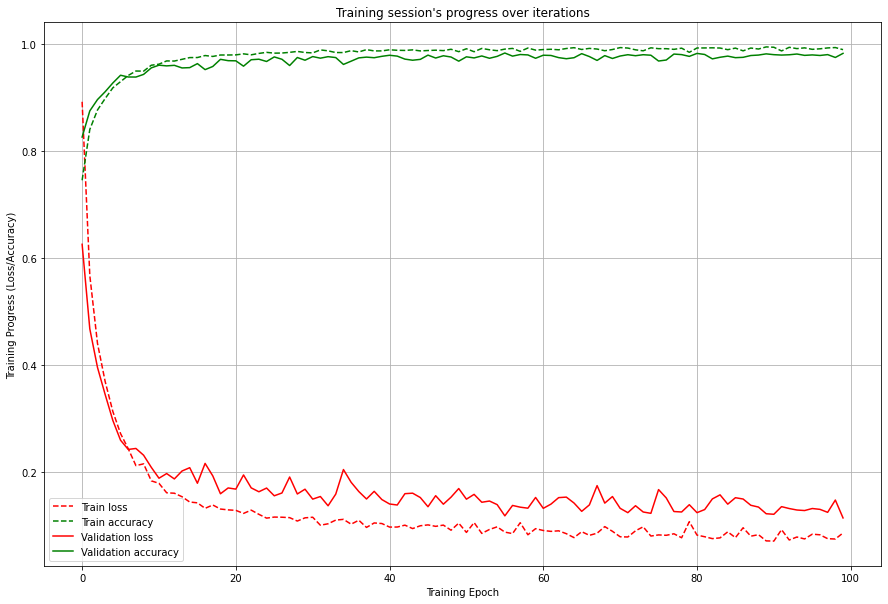

 ..after sliding and reshaping, train data: inputs (53605, 3, 125), targets (53605, 11)
 ..after sliding and reshaping, test data : inputs (777, 3, 125), targets (777, 11)
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_28 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_28 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_28 (Dropout)        (None, 512)               0         
                                                                 
 dense_56 (Dense)            (None, 64)                32832     
                                                                 
 dense_57 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0942 - accuracy: 0.9896 - val_loss: 0.1773 - val_accuracy: 0.9660
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1138 - accuracy: 0.9836 - val_loss: 0.1625 - val_accuracy: 0.9667
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9898 - val_loss: 0.1450 - val_accuracy: 0.9750
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0916 - accuracy: 0.9900 - val_loss: 0.1814 - val_accuracy: 0.9660
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0989 - accuracy: 0.9879 - val_loss: 0.2334 - val_accuracy: 0.9578
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1061 - accuracy: 0.9858 - val_loss: 0.1495 - val_accuracy: 0.9756
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9900 - val_loss: 0.1586 - val_ac

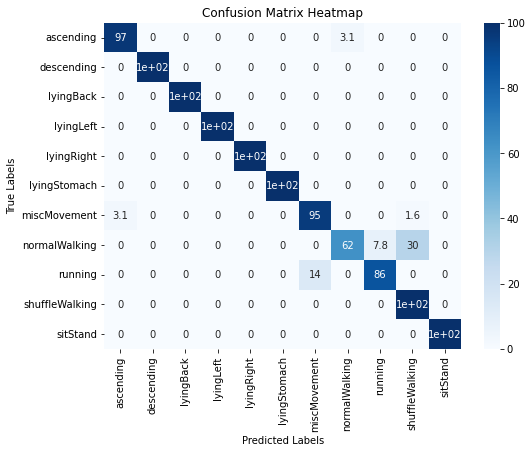

28/71 [0.19996823370456696, 0.9510939717292786] 0.8820995996738302


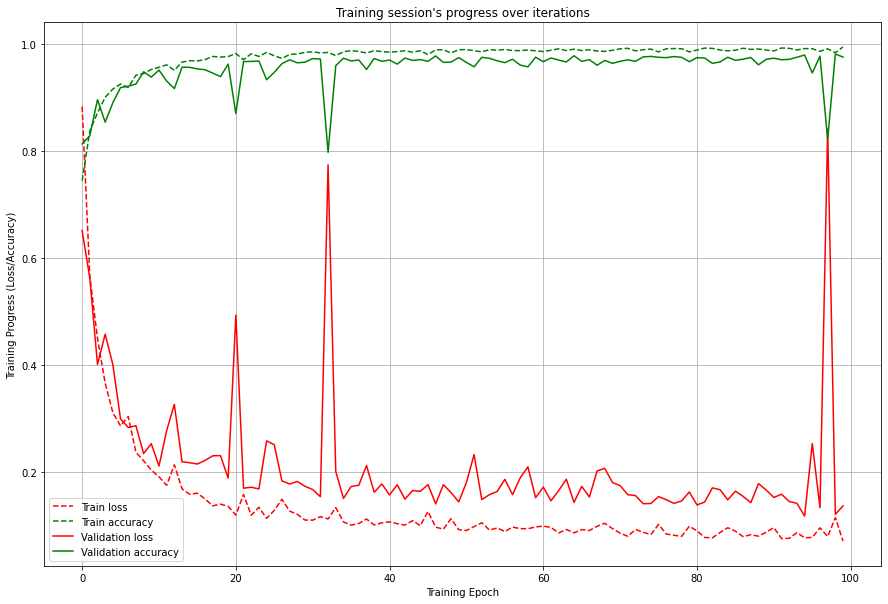

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_29 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_29 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_29 (Dropout)        (None, 512)               0         
                                                                 
 dense_58 (Dense)            (None, 64)                32832     
                                                                 
 dense_59 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9879 - val_loss: 0.1617 - val_accuracy: 0.9693
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0937 - accuracy: 0.9889 - val_loss: 0.1546 - val_accuracy: 0.9710
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0863 - accuracy: 0.9910 - val_loss: 0.1328 - val_accuracy: 0.9789
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1168 - accuracy: 0.9816 - val_loss: 0.1353 - val_accuracy: 0.9766
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0836 - accuracy: 0.9919 - val_loss: 0.1386 - val_accuracy: 0.9766
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0837 - accuracy: 0.9911 - val_loss: 0.1386 - val_accuracy: 0.9737
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1027 - accuracy: 0.9845 - val_loss: 0.1444 - val_ac

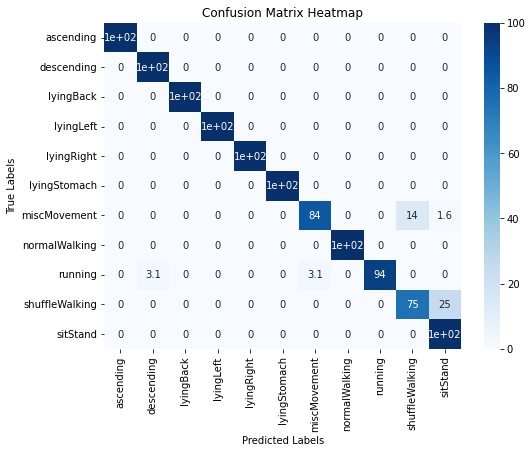

29/71 [0.2320719063282013, 0.9615384340286255] 0.8847475608189901


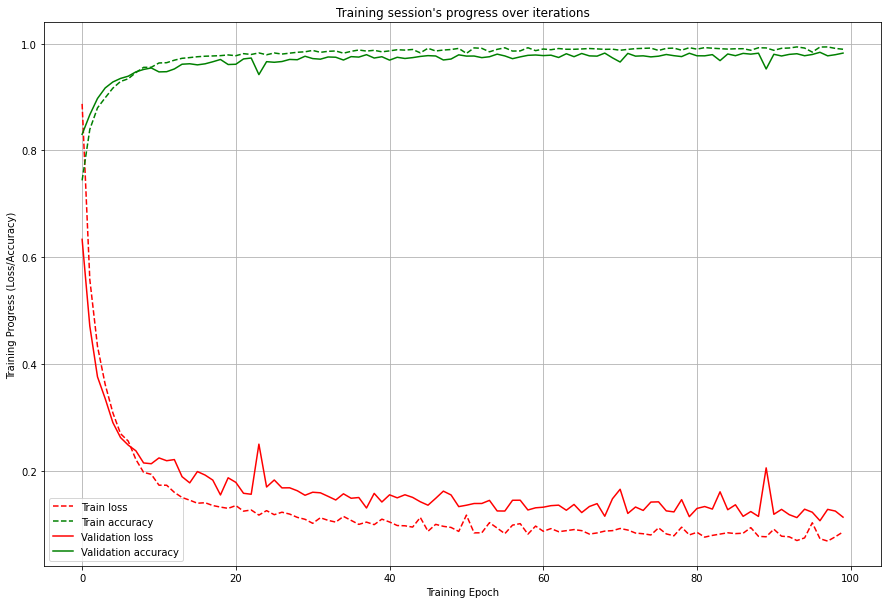

 ..after sliding and reshaping, train data: inputs (53706, 3, 125), targets (53706, 11)
 ..after sliding and reshaping, test data : inputs (785, 3, 125), targets (785, 11)
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_30 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_30 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_30 (Dropout)        (None, 512)               0         
                                                                 
 dense_60 (Dense)            (None, 64)                32832     
                                                                 
 dense_61 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1001 - accuracy: 0.9874 - val_loss: 0.1524 - val_accuracy: 0.9752
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0960 - accuracy: 0.9882 - val_loss: 0.1610 - val_accuracy: 0.9697
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1021 - accuracy: 0.9858 - val_loss: 0.1593 - val_accuracy: 0.9730
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0988 - accuracy: 0.9886 - val_loss: 0.1515 - val_accuracy: 0.9739
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0959 - accuracy: 0.9882 - val_loss: 0.1720 - val_accuracy: 0.9691
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0941 - accuracy: 0.9891 - val_loss: 0.1552 - val_accuracy: 0.9740
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1029 - accuracy: 0.9859 - val_loss: 0.1572 - val_ac

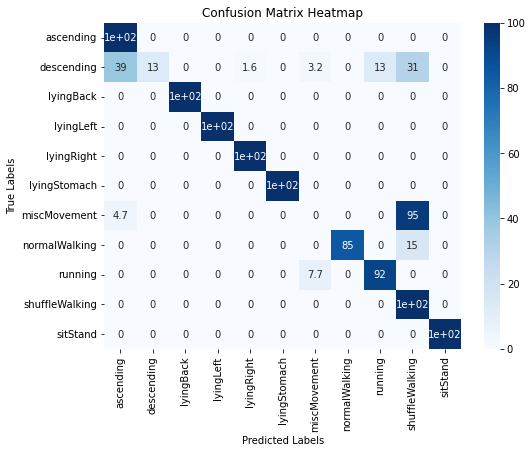

30/71 [1.032390832901001, 0.8305732607841492] 0.88300000275335


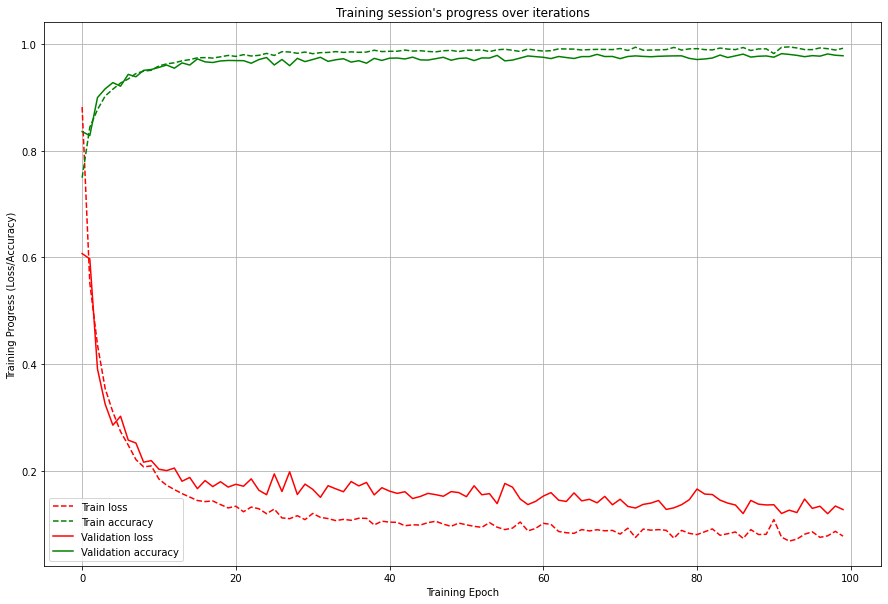

 ..after sliding and reshaping, train data: inputs (53578, 3, 125), targets (53578, 11)
 ..after sliding and reshaping, test data : inputs (769, 3, 125), targets (769, 11)
Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_31 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_31 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_31 (Dropout)        (None, 512)               0         
                                                                 
 dense_62 (Dense)            (None, 64)                32832     
                                                                 
 dense_63 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9885 - val_loss: 0.1454 - val_accuracy: 0.9770
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0944 - accuracy: 0.9885 - val_loss: 0.1373 - val_accuracy: 0.9762
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1028 - accuracy: 0.9854 - val_loss: 0.1436 - val_accuracy: 0.9755
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9893 - val_loss: 0.1518 - val_accuracy: 0.9771
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0990 - accuracy: 0.9877 - val_loss: 0.1397 - val_accuracy: 0.9740
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0892 - accuracy: 0.9906 - val_loss: 0.1454 - val_accuracy: 0.9766
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0834 - accuracy: 0.9917 - val_loss: 0.1483 - val_ac

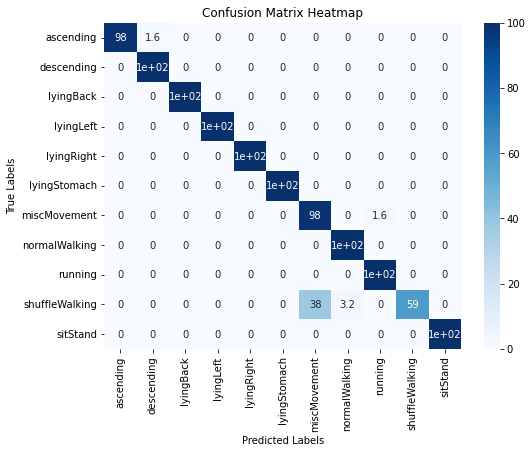

31/71 [0.17182540893554688, 0.963589072227478] 0.8855184111744165


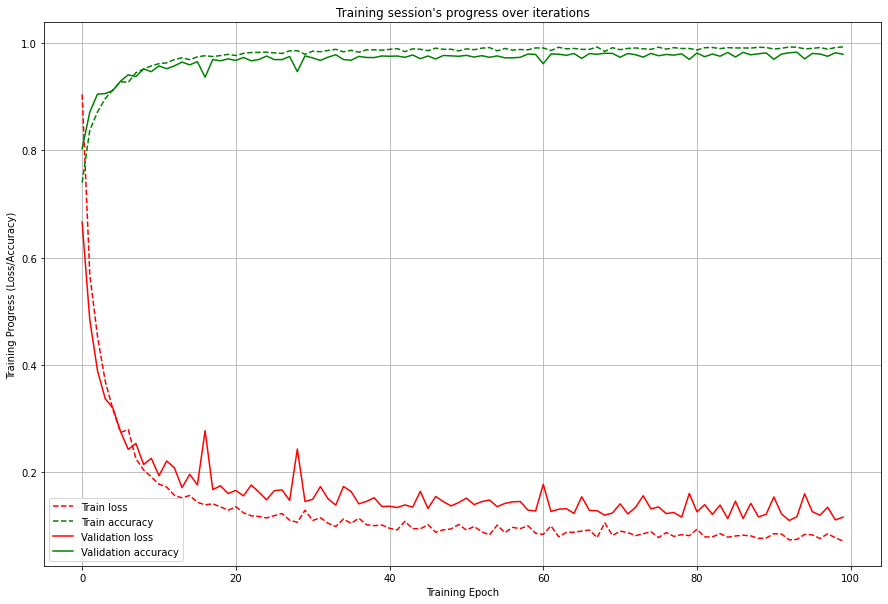

 ..after sliding and reshaping, train data: inputs (53672, 3, 125), targets (53672, 11)
 ..after sliding and reshaping, test data : inputs (774, 3, 125), targets (774, 11)
Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_32 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_32 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_32 (Dropout)        (None, 512)               0         
                                                                 
 dense_64 (Dense)            (None, 64)                32832     
                                                                 
 dense_65 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1062 - accuracy: 0.9851 - val_loss: 0.1346 - val_accuracy: 0.9778
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0960 - accuracy: 0.9879 - val_loss: 0.1349 - val_accuracy: 0.9777
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0951 - accuracy: 0.9888 - val_loss: 0.1374 - val_accuracy: 0.9767
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9886 - val_loss: 0.1610 - val_accuracy: 0.9702
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0969 - accuracy: 0.9878 - val_loss: 0.1886 - val_accuracy: 0.9628
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1056 - accuracy: 0.9853 - val_loss: 0.1389 - val_accuracy: 0.9796
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0921 - accuracy: 0.9897 - val_loss: 0.1254 - val_ac

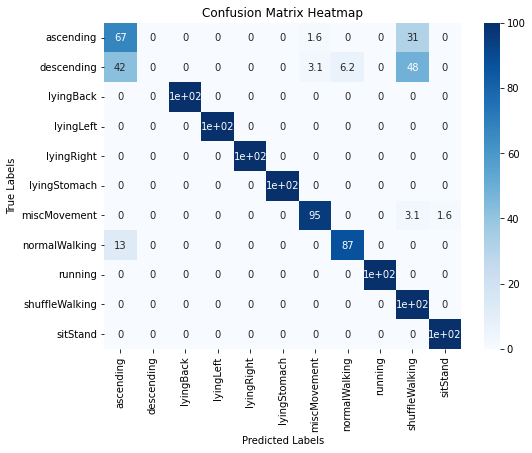

32/71 [1.3792108297348022, 0.8759689927101135] 0.8852290348573164


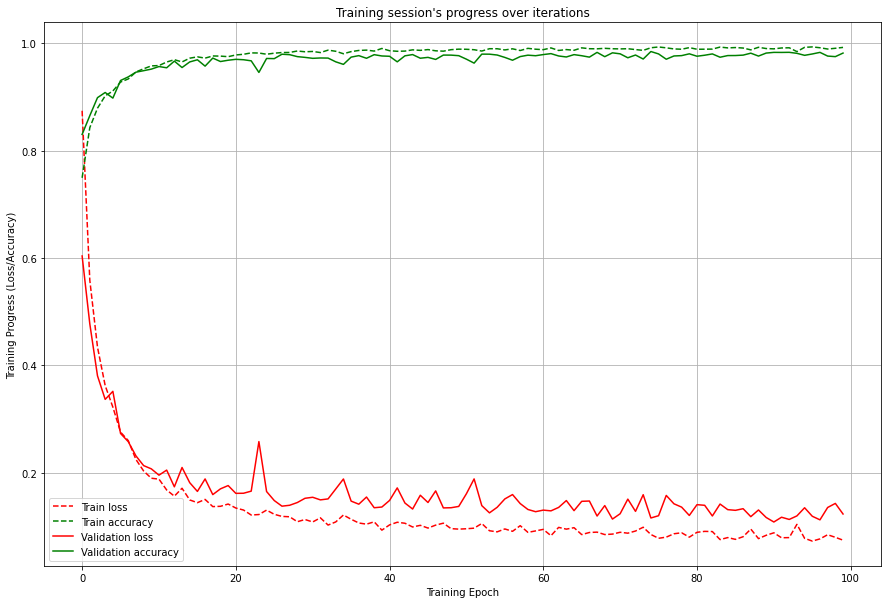

 ..after sliding and reshaping, train data: inputs (53574, 3, 125), targets (53574, 11)
 ..after sliding and reshaping, test data : inputs (766, 3, 125), targets (766, 11)
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_33 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_33 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_33 (Dropout)        (None, 512)               0         
                                                                 
 dense_66 (Dense)            (None, 64)                32832     
                                                                 
 dense_67 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1023 - accuracy: 0.9862 - val_loss: 0.1445 - val_accuracy: 0.9747
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0943 - accuracy: 0.9892 - val_loss: 0.1333 - val_accuracy: 0.9782
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9894 - val_loss: 0.1456 - val_accuracy: 0.9727
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1045 - accuracy: 0.9860 - val_loss: 0.1258 - val_accuracy: 0.9790
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0851 - accuracy: 0.9909 - val_loss: 0.1186 - val_accuracy: 0.9806
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0980 - accuracy: 0.9877 - val_loss: 0.1466 - val_accuracy: 0.9742
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0948 - accuracy: 0.9885 - val_loss: 0.1351 - val_ac

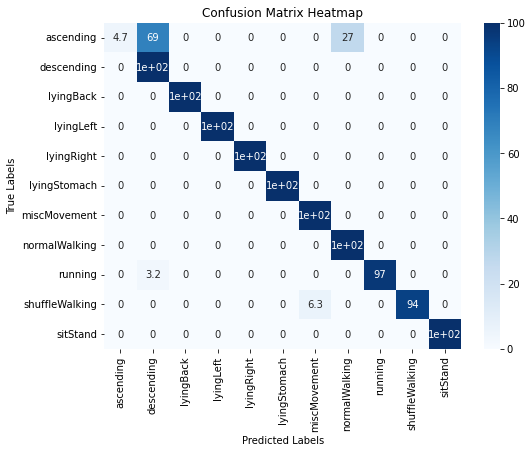

33/71 [0.5914817452430725, 0.91253262758255] 0.8860320817021763


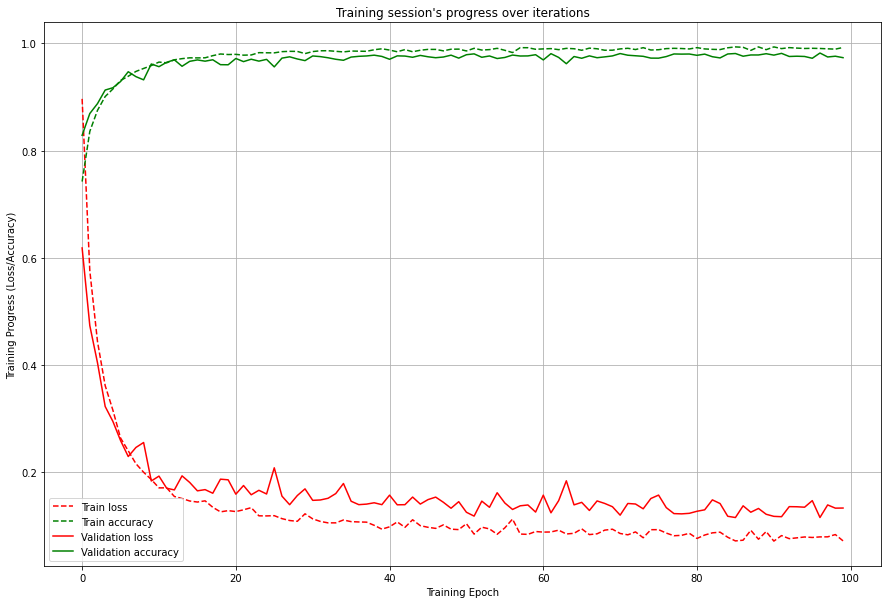

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_34 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_34 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_34 (Dropout)        (None, 512)               0         
                                                                 
 dense_68 (Dense)            (None, 64)                32832     
                                                                 
 dense_69 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0971 - accuracy: 0.9881 - val_loss: 0.1439 - val_accuracy: 0.9780
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9883 - val_loss: 0.1538 - val_accuracy: 0.9752
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9894 - val_loss: 0.1519 - val_accuracy: 0.9756
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0908 - accuracy: 0.9896 - val_loss: 0.1429 - val_accuracy: 0.9766
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0906 - accuracy: 0.9896 - val_loss: 0.1404 - val_accuracy: 0.9759
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0843 - accuracy: 0.9915 - val_loss: 0.1288 - val_accuracy: 0.9799
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0852 - accuracy: 0.9913 - val_loss: 0.1469 - val_ac

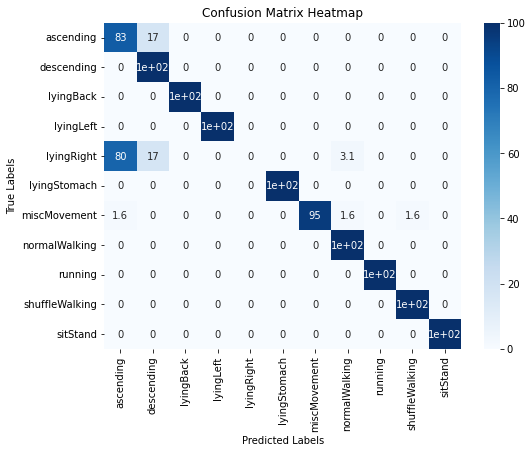

34/71 [1.474656581878662, 0.8999999761581421] 0.8864311644009182


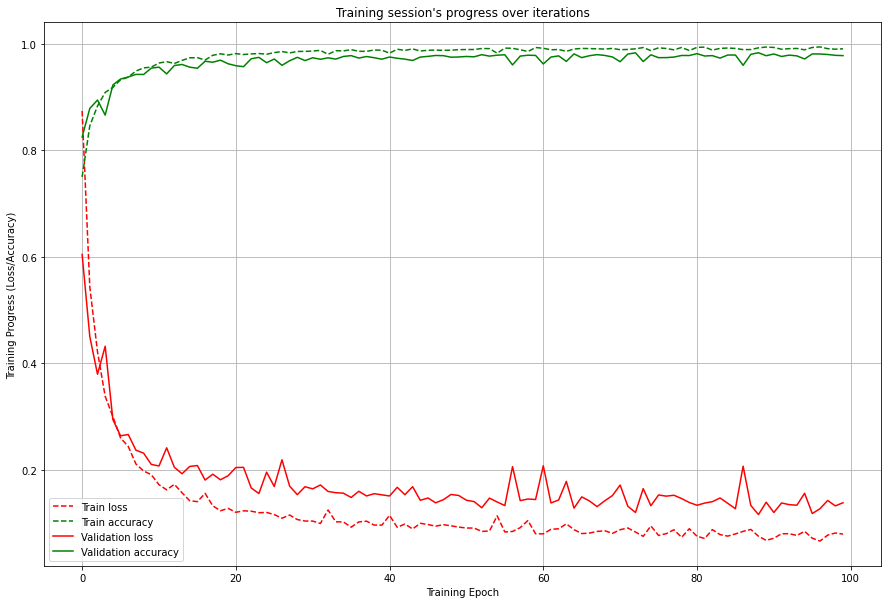

 ..after sliding and reshaping, train data: inputs (53525, 3, 125), targets (53525, 11)
 ..after sliding and reshaping, test data : inputs (767, 3, 125), targets (767, 11)
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_35 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_35 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_35 (Dropout)        (None, 512)               0         
                                                                 
 dense_70 (Dense)            (None, 64)                32832     
                                                                 
 dense_71 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0922 - accuracy: 0.9904 - val_loss: 0.1838 - val_accuracy: 0.9681
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9885 - val_loss: 0.1443 - val_accuracy: 0.9775
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9884 - val_loss: 0.1484 - val_accuracy: 0.9742
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9889 - val_loss: 0.1396 - val_accuracy: 0.9744
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0987 - accuracy: 0.9870 - val_loss: 0.1840 - val_accuracy: 0.9672
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0972 - accuracy: 0.9889 - val_loss: 0.1543 - val_accuracy: 0.9729
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0886 - accuracy: 0.9904 - val_loss: 0.1720 - val_ac

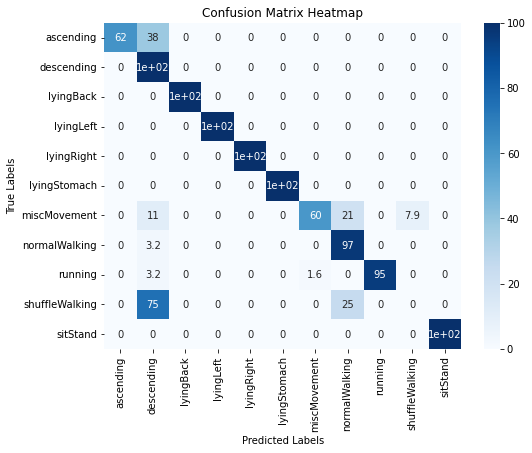

35/71 [1.4224776029586792, 0.8461538553237915] 0.8853123502598869


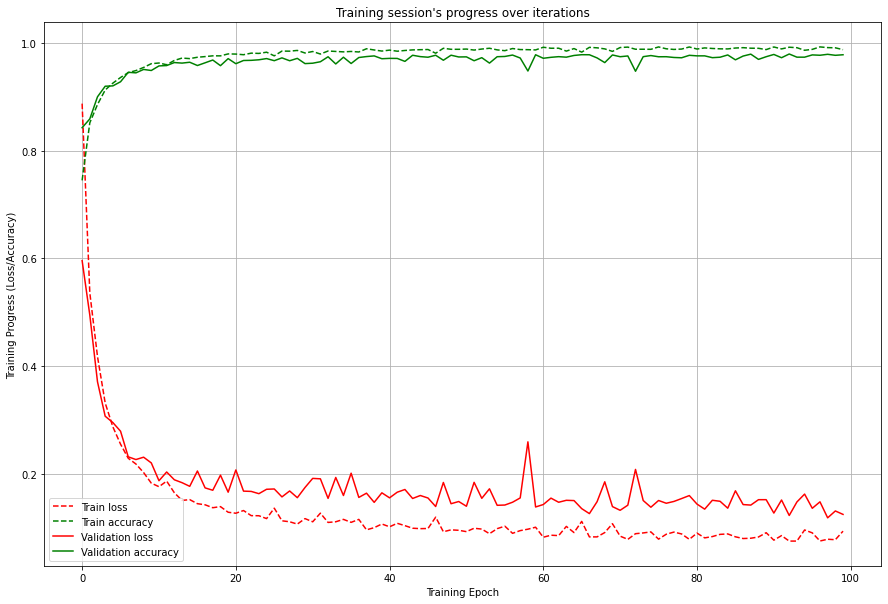

 ..after sliding and reshaping, train data: inputs (53531, 3, 125), targets (53531, 11)
 ..after sliding and reshaping, test data : inputs (765, 3, 125), targets (765, 11)
Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_36 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_36 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_36 (Dropout)        (None, 512)               0         
                                                                 
 dense_72 (Dense)            (None, 64)                32832     
                                                                 
 dense_73 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9878 - val_loss: 0.1461 - val_accuracy: 0.9780
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9893 - val_loss: 0.1490 - val_accuracy: 0.9743
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9879 - val_loss: 0.1430 - val_accuracy: 0.9754
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1048 - accuracy: 0.9851 - val_loss: 0.1470 - val_accuracy: 0.9764
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0930 - accuracy: 0.9894 - val_loss: 0.1429 - val_accuracy: 0.9752
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0990 - accuracy: 0.9870 - val_loss: 0.1493 - val_accuracy: 0.9743
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0970 - accuracy: 0.9878 - val_loss: 0.1507 - val_ac

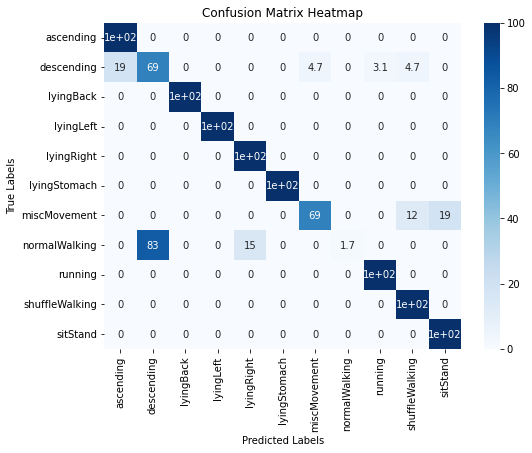

36/71 [0.6293234825134277, 0.871895432472229] 0.8849497308602204


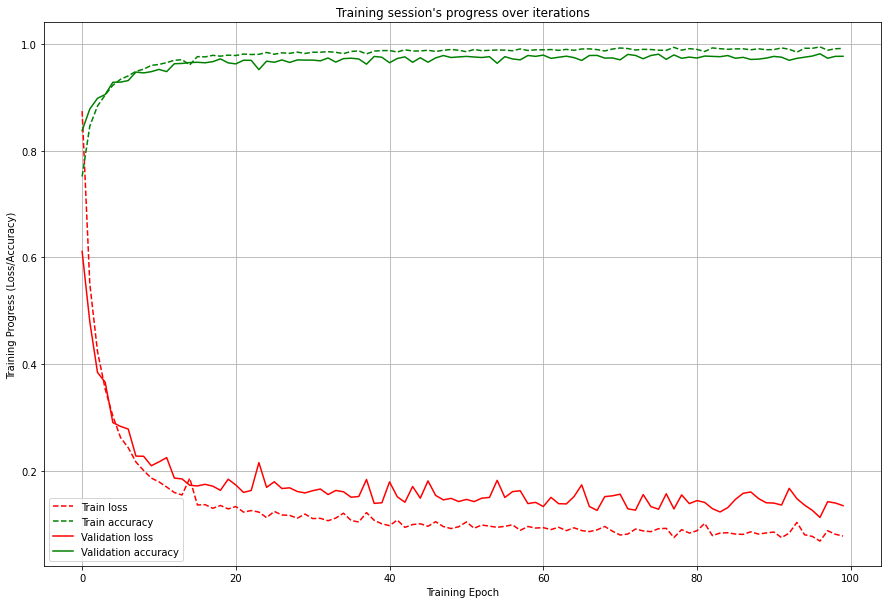

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_37 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_37 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_37 (Dropout)        (None, 512)               0         
                                                                 
 dense_74 (Dense)            (None, 64)                32832     
                                                                 
 dense_75 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0868 - accuracy: 0.9913 - val_loss: 0.1665 - val_accuracy: 0.9693
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1059 - accuracy: 0.9853 - val_loss: 0.1504 - val_accuracy: 0.9737
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0894 - accuracy: 0.9915 - val_loss: 0.1169 - val_accuracy: 0.9833
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0868 - accuracy: 0.9913 - val_loss: 0.2054 - val_accuracy: 0.9597
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0901 - accuracy: 0.9900 - val_loss: 0.1384 - val_accuracy: 0.9759
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0930 - accuracy: 0.9894 - val_loss: 0.1244 - val_accuracy: 0.9786
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0946 - accuracy: 0.9884 - val_loss: 0.1451 - val_ac

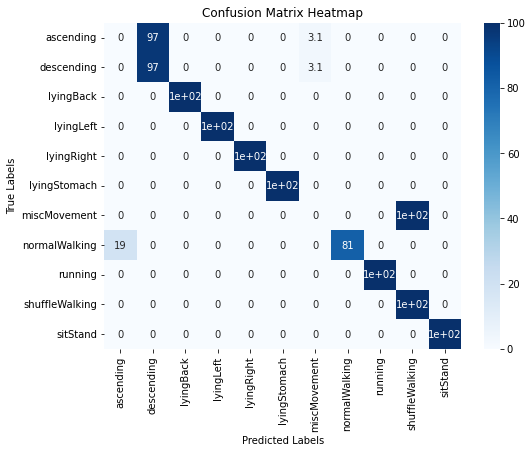

37/71 [2.110203742980957, 0.8179486989974976] 0.8831865458112014


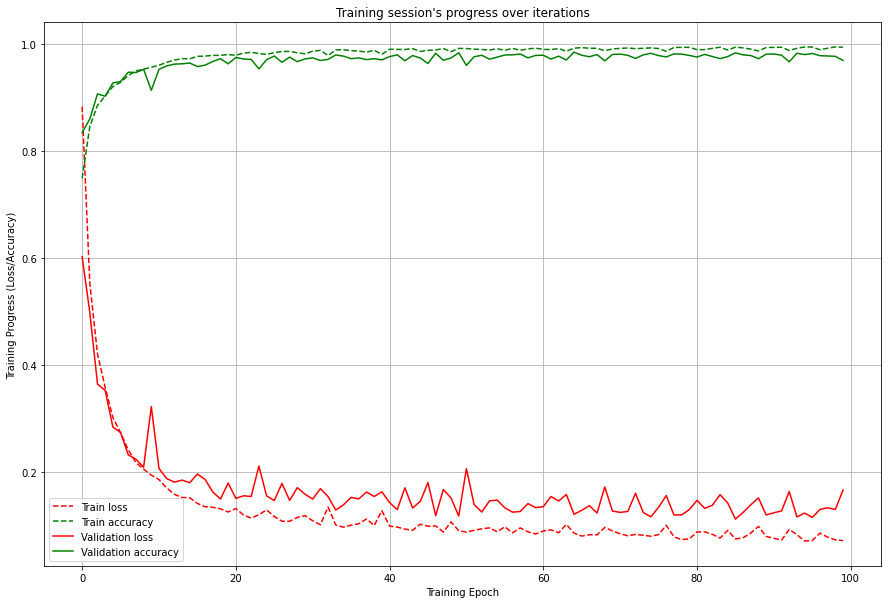

 ..after sliding and reshaping, train data: inputs (53739, 3, 125), targets (53739, 11)
 ..after sliding and reshaping, test data : inputs (773, 3, 125), targets (773, 11)
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_38 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_38 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_38 (Dropout)        (None, 512)               0         
                                                                 
 dense_76 (Dense)            (None, 64)                32832     
                                                                 
 dense_77 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1085 - accuracy: 0.9839 - val_loss: 0.1320 - val_accuracy: 0.9789
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0907 - accuracy: 0.9902 - val_loss: 0.1360 - val_accuracy: 0.9765
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0955 - accuracy: 0.9877 - val_loss: 0.1611 - val_accuracy: 0.9709
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0953 - accuracy: 0.9880 - val_loss: 0.1627 - val_accuracy: 0.9741
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0999 - accuracy: 0.9873 - val_loss: 0.1512 - val_accuracy: 0.9726
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1000 - accuracy: 0.9874 - val_loss: 0.1500 - val_accuracy: 0.9762
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0901 - accuracy: 0.9893 - val_loss: 0.1412 - val_ac

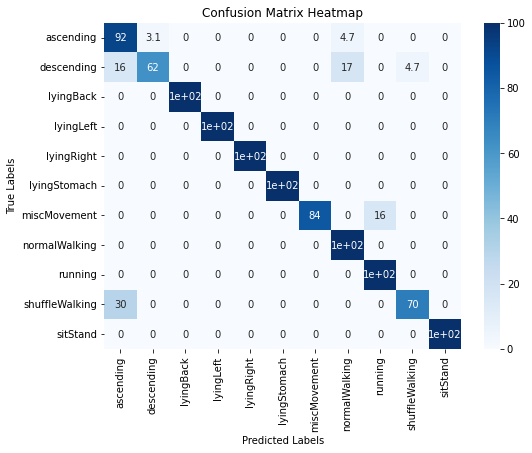

38/71 [0.35947349667549133, 0.9249676465988159] 0.8842578560878069


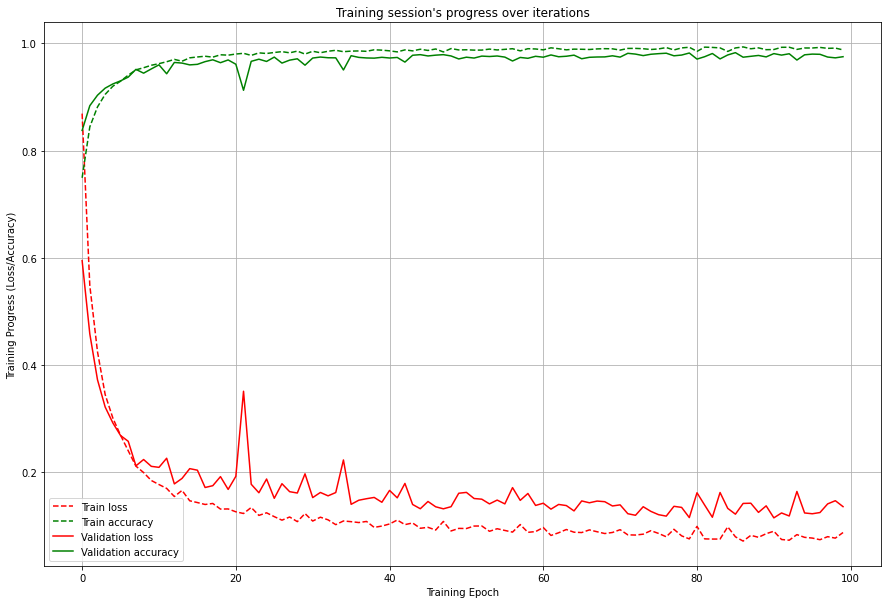

 ..after sliding and reshaping, train data: inputs (53502, 3, 125), targets (53502, 11)
 ..after sliding and reshaping, test data : inputs (790, 3, 125), targets (790, 11)
Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_39 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_39 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_39 (Dropout)        (None, 512)               0         
                                                                 
 dense_78 (Dense)            (None, 64)                32832     
                                                                 
 dense_79 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0922 - accuracy: 0.9890 - val_loss: 0.1746 - val_accuracy: 0.9653
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1132 - accuracy: 0.9829 - val_loss: 0.1602 - val_accuracy: 0.9733
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1055 - accuracy: 0.9873 - val_loss: 0.1713 - val_accuracy: 0.9687
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0917 - accuracy: 0.9897 - val_loss: 0.1617 - val_accuracy: 0.9716
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0989 - accuracy: 0.9866 - val_loss: 0.1652 - val_accuracy: 0.9708
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0950 - accuracy: 0.9885 - val_loss: 0.1398 - val_accuracy: 0.9787
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1054 - accuracy: 0.9855 - val_loss: 0.1529 - val_ac

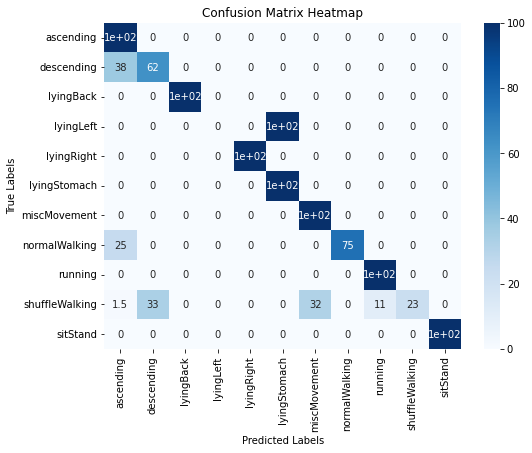

39/71 [1.1919341087341309, 0.8063291311264038] 0.8823096379637718


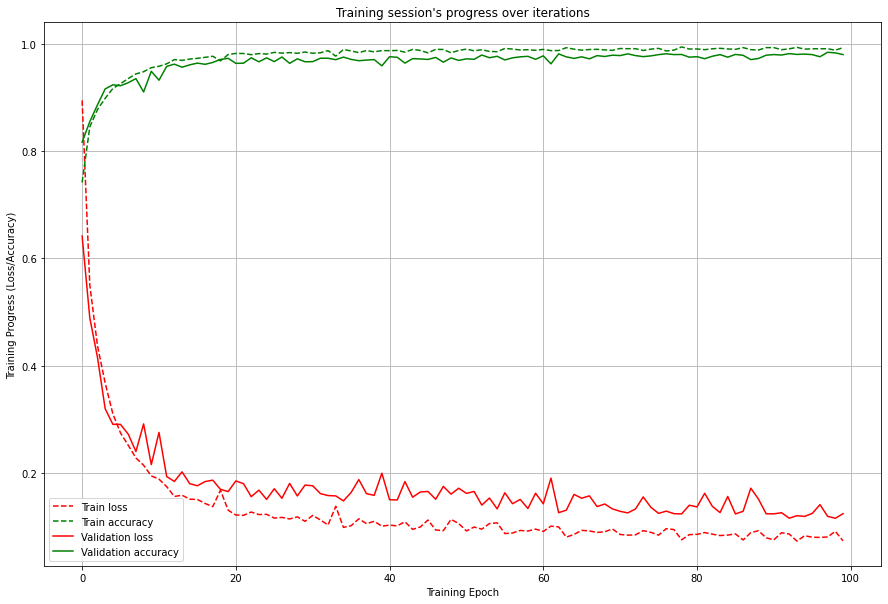

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_40 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_40 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_40 (Dropout)        (None, 512)               0         
                                                                 
 dense_80 (Dense)            (None, 64)                32832     
                                                                 
 dense_81 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0973 - accuracy: 0.9882 - val_loss: 0.1590 - val_accuracy: 0.9703
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0943 - accuracy: 0.9890 - val_loss: 0.1516 - val_accuracy: 0.9682
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1031 - accuracy: 0.9856 - val_loss: 0.1999 - val_accuracy: 0.9601
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0947 - accuracy: 0.9884 - val_loss: 0.1353 - val_accuracy: 0.9747
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0920 - accuracy: 0.9889 - val_loss: 0.1635 - val_accuracy: 0.9720
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9890 - val_loss: 0.1303 - val_accuracy: 0.9771
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9883 - val_loss: 0.1305 - val_ac

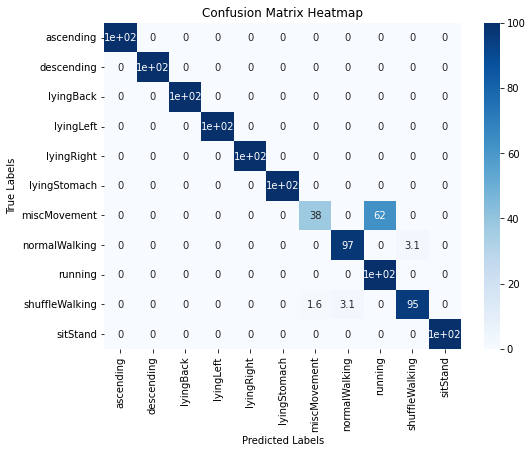

40/71 [0.8564894199371338, 0.942307710647583] 0.8837730055902062


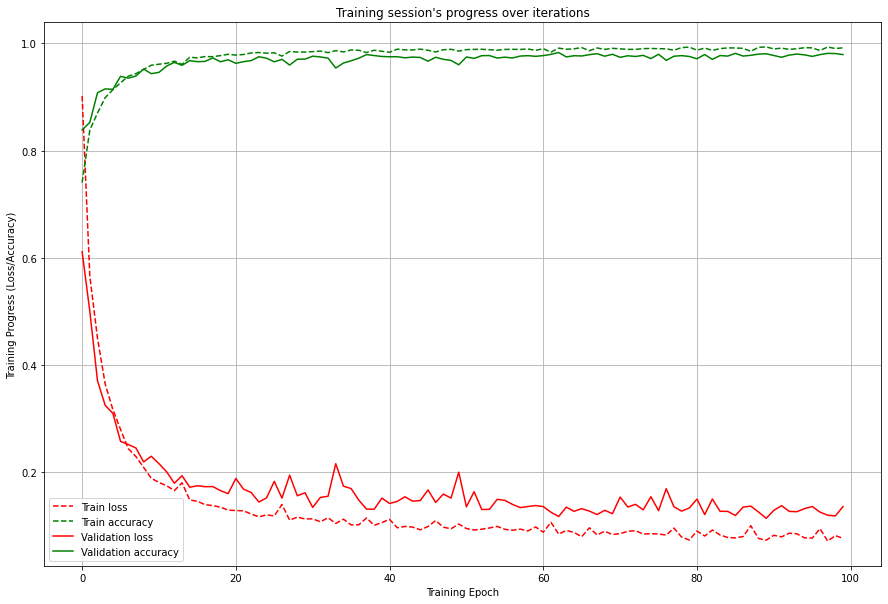

 ..after sliding and reshaping, train data: inputs (53742, 3, 125), targets (53742, 11)
 ..after sliding and reshaping, test data : inputs (768, 3, 125), targets (768, 11)
Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_41 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_41 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_41 (Dropout)        (None, 512)               0         
                                                                 
 dense_82 (Dense)            (None, 64)                32832     
                                                                 
 dense_83 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1061 - accuracy: 0.9851 - val_loss: 0.1447 - val_accuracy: 0.9743
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9899 - val_loss: 0.1502 - val_accuracy: 0.9747
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1115 - accuracy: 0.9830 - val_loss: 0.1966 - val_accuracy: 0.9580
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0930 - accuracy: 0.9897 - val_loss: 0.1275 - val_accuracy: 0.9790
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0861 - accuracy: 0.9904 - val_loss: 0.1548 - val_accuracy: 0.9703
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9885 - val_loss: 0.1337 - val_accuracy: 0.9754
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1018 - accuracy: 0.9863 - val_loss: 0.1579 - val_ac

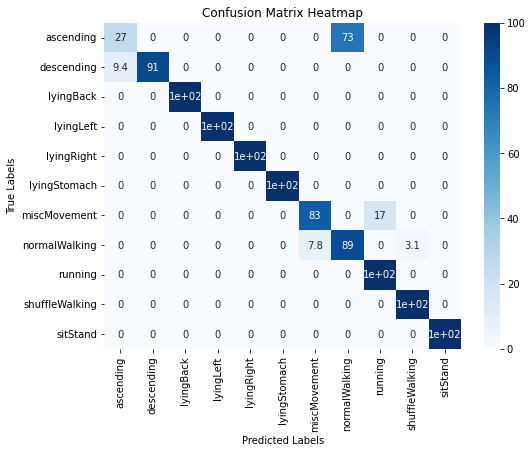

41/71 [0.4980091154575348, 0.9075520634651184] 0.884339173634847


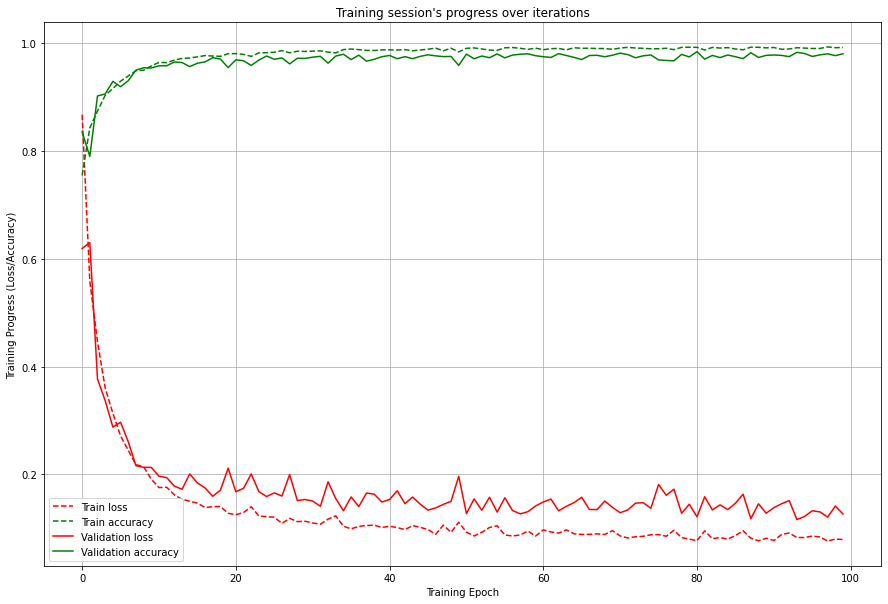

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_42 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_42 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_42 (Dropout)        (None, 512)               0         
                                                                 
 dense_84 (Dense)            (None, 64)                32832     
                                                                 
 dense_85 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9895 - val_loss: 0.1688 - val_accuracy: 0.9702
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0954 - accuracy: 0.9876 - val_loss: 0.1835 - val_accuracy: 0.9656
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1086 - accuracy: 0.9848 - val_loss: 0.1477 - val_accuracy: 0.9760
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0906 - accuracy: 0.9890 - val_loss: 0.1349 - val_accuracy: 0.9788
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0915 - accuracy: 0.9890 - val_loss: 0.1711 - val_accuracy: 0.9708
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0970 - accuracy: 0.9877 - val_loss: 0.1637 - val_accuracy: 0.9698
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0955 - accuracy: 0.9883 - val_loss: 0.1442 - val_ac

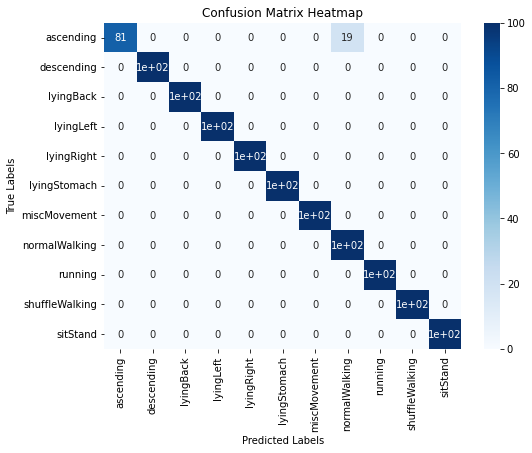

42/71 [0.10528219491243362, 0.9846153855323792] 0.8866711785626966


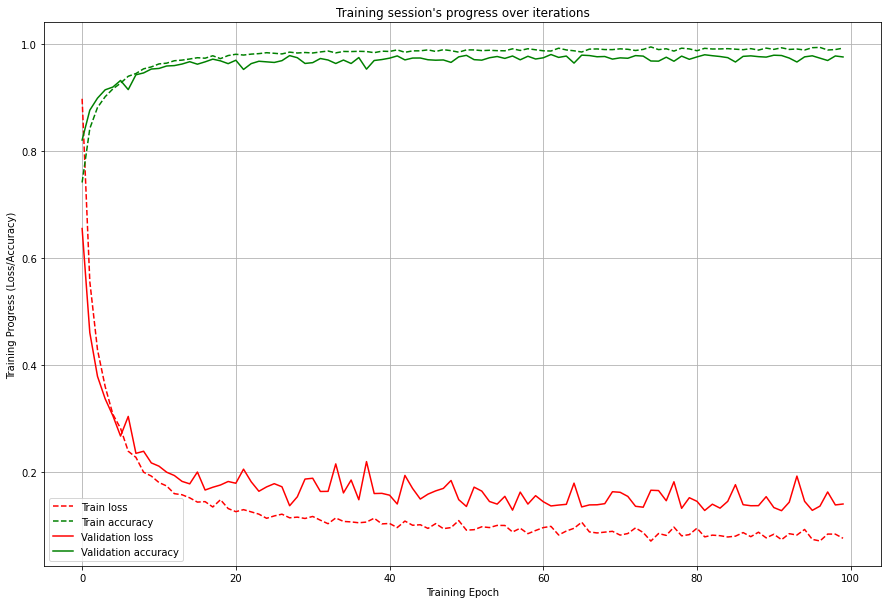

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_43 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_43 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_43 (Dropout)        (None, 512)               0         
                                                                 
 dense_86 (Dense)            (None, 64)                32832     
                                                                 
 dense_87 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1026 - accuracy: 0.9860 - val_loss: 0.1929 - val_accuracy: 0.9616
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1015 - accuracy: 0.9869 - val_loss: 0.1386 - val_accuracy: 0.9771
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0924 - accuracy: 0.9895 - val_loss: 0.1361 - val_accuracy: 0.9764
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0902 - accuracy: 0.9902 - val_loss: 0.1564 - val_accuracy: 0.9707
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9879 - val_loss: 0.1337 - val_accuracy: 0.9792
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0980 - accuracy: 0.9874 - val_loss: 0.1548 - val_accuracy: 0.9711
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1011 - accuracy: 0.9872 - val_loss: 0.1584 - val_ac

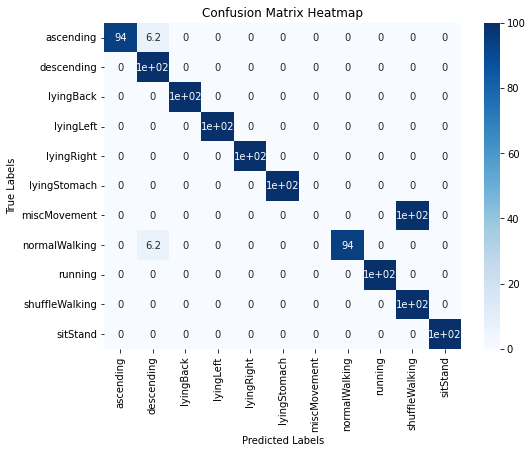

43/71 [1.146734595298767, 0.9076923131942749] 0.8871489316225052


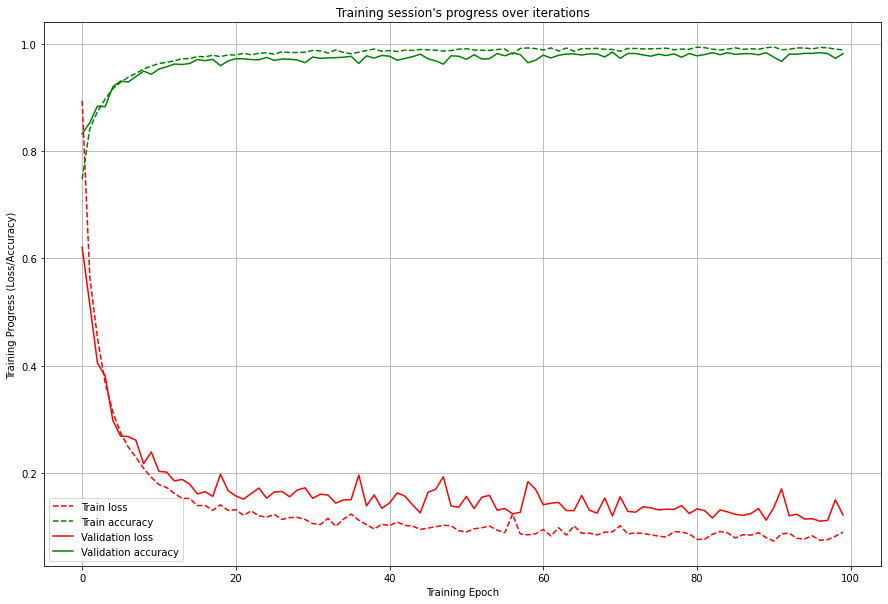

 ..after sliding and reshaping, train data: inputs (53510, 3, 125), targets (53510, 11)
 ..after sliding and reshaping, test data : inputs (762, 3, 125), targets (762, 11)
Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_44 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_44 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_44 (Dropout)        (None, 512)               0         
                                                                 
 dense_88 (Dense)            (None, 64)                32832     
                                                                 
 dense_89 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0943 - accuracy: 0.9890 - val_loss: 0.1415 - val_accuracy: 0.9779
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0882 - accuracy: 0.9904 - val_loss: 0.1437 - val_accuracy: 0.9770
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9878 - val_loss: 0.1683 - val_accuracy: 0.9740
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1065 - accuracy: 0.9839 - val_loss: 0.1853 - val_accuracy: 0.9654
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9892 - val_loss: 0.1469 - val_accuracy: 0.9735
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0927 - accuracy: 0.9894 - val_loss: 0.1626 - val_accuracy: 0.9709
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0906 - accuracy: 0.9893 - val_loss: 0.1462 - val_ac

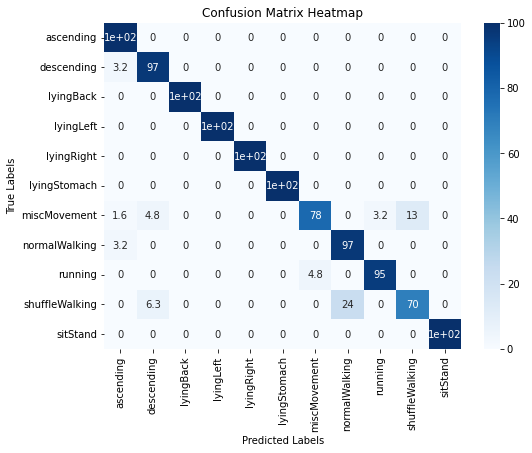

44/71 [0.20287199318408966, 0.9475065469741821] 0.8884902119636535


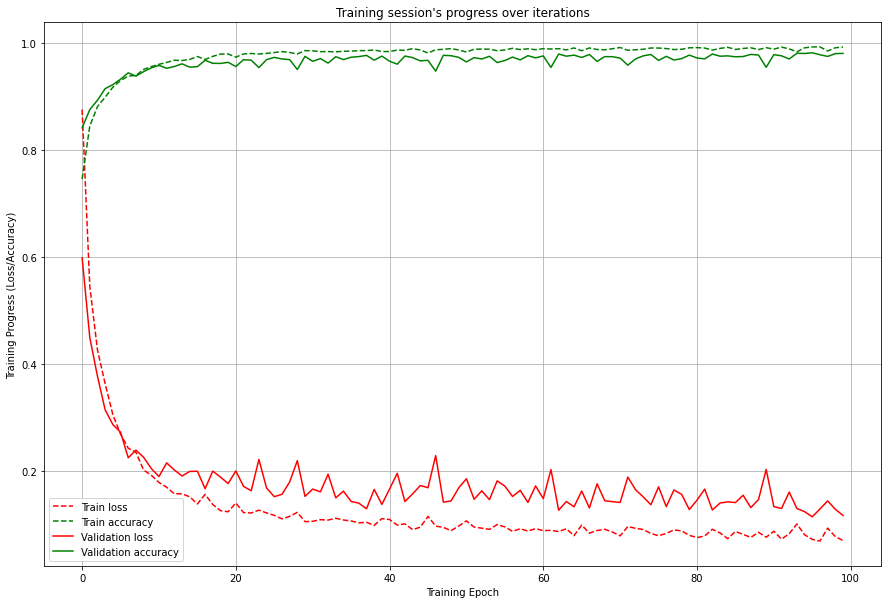

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_45 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_45 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_45 (Dropout)        (None, 512)               0         
                                                                 
 dense_90 (Dense)            (None, 64)                32832     
                                                                 
 dense_91 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1057 - accuracy: 0.9861 - val_loss: 0.1684 - val_accuracy: 0.9684
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0967 - accuracy: 0.9883 - val_loss: 0.1437 - val_accuracy: 0.9764
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9892 - val_loss: 0.1825 - val_accuracy: 0.9654
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1010 - accuracy: 0.9869 - val_loss: 0.1479 - val_accuracy: 0.9769
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9899 - val_loss: 0.1771 - val_accuracy: 0.9659
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0907 - accuracy: 0.9910 - val_loss: 0.1610 - val_accuracy: 0.9660
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0976 - accuracy: 0.9874 - val_loss: 0.1549 - val_ac

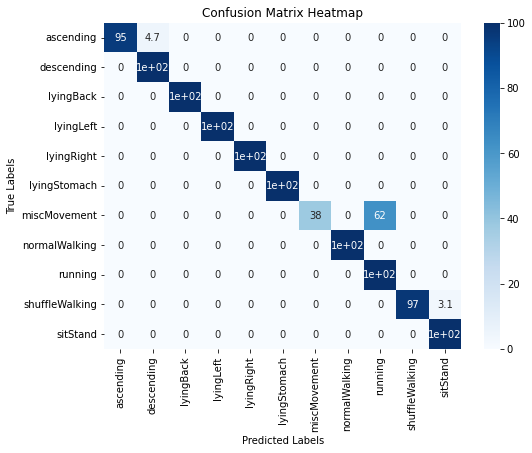

45/71 [0.748736560344696, 0.942307710647583] 0.8896601575872173


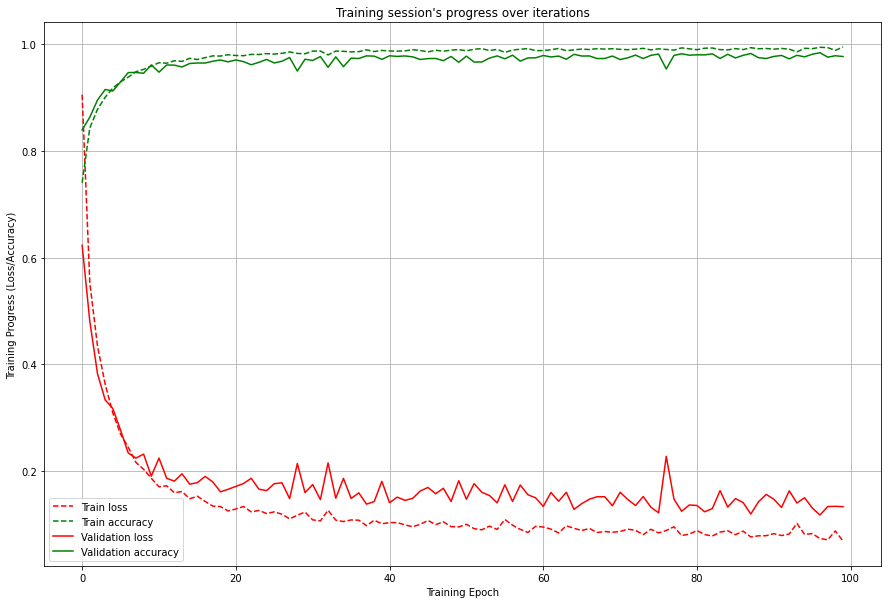

 ..after sliding and reshaping, train data: inputs (53587, 3, 125), targets (53587, 11)
 ..after sliding and reshaping, test data : inputs (716, 3, 125), targets (716, 11)
Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_46 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_46 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_46 (Dropout)        (None, 512)               0         
                                                                 
 dense_92 (Dense)            (None, 64)                32832     
                                                                 
 dense_93 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0877 - accuracy: 0.9906 - val_loss: 0.1464 - val_accuracy: 0.9733
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1296 - accuracy: 0.9790 - val_loss: 0.1439 - val_accuracy: 0.9756
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0960 - accuracy: 0.9891 - val_loss: 0.1345 - val_accuracy: 0.9798
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0938 - accuracy: 0.9889 - val_loss: 0.1383 - val_accuracy: 0.9758
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0858 - accuracy: 0.9914 - val_loss: 0.1505 - val_accuracy: 0.9760
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1004 - accuracy: 0.9863 - val_loss: 0.1400 - val_accuracy: 0.9777
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9898 - val_loss: 0.1317 - val_ac

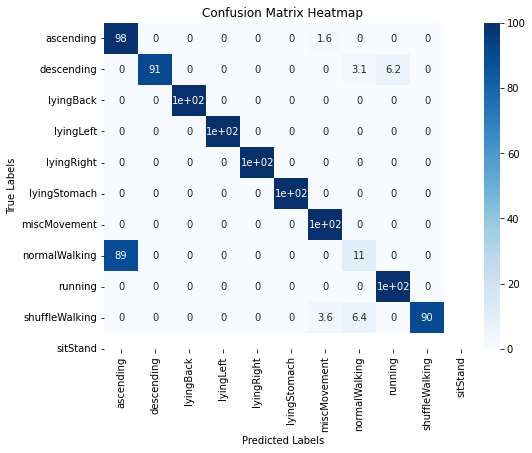

46/71 [0.42177054286003113, 0.8910614252090454] 0.889689971791937


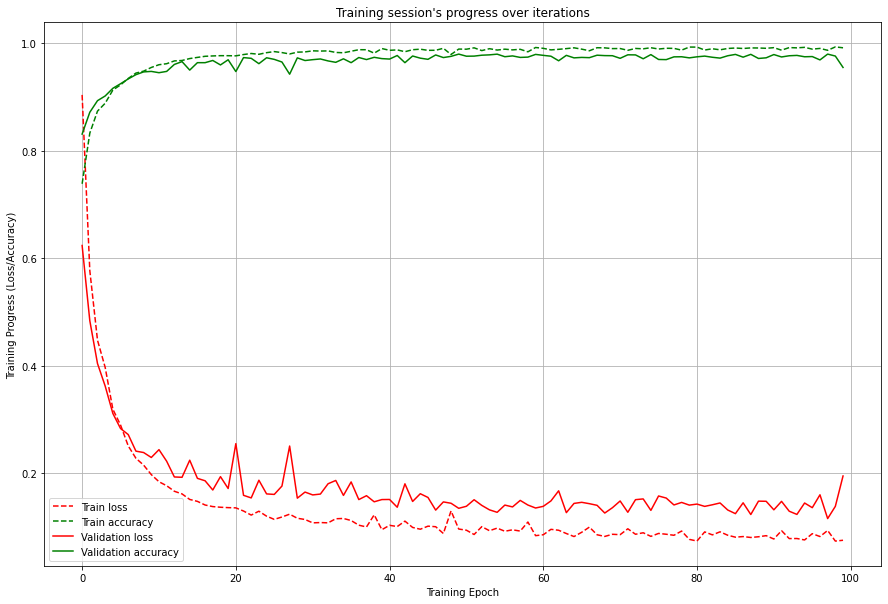

 ..after sliding and reshaping, train data: inputs (53720, 3, 125), targets (53720, 11)
 ..after sliding and reshaping, test data : inputs (772, 3, 125), targets (772, 11)
Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_47 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_47 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_47 (Dropout)        (None, 512)               0         
                                                                 
 dense_94 (Dense)            (None, 64)                32832     
                                                                 
 dense_95 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1069 - accuracy: 0.9845 - val_loss: 0.1519 - val_accuracy: 0.9763
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0989 - accuracy: 0.9879 - val_loss: 0.1408 - val_accuracy: 0.9759
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0923 - accuracy: 0.9903 - val_loss: 0.1446 - val_accuracy: 0.9738
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0959 - accuracy: 0.9882 - val_loss: 0.1548 - val_accuracy: 0.9713
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0981 - accuracy: 0.9883 - val_loss: 0.1383 - val_accuracy: 0.9778
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0983 - accuracy: 0.9876 - val_loss: 0.1244 - val_accuracy: 0.9821
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9896 - val_loss: 0.1393 - val_ac

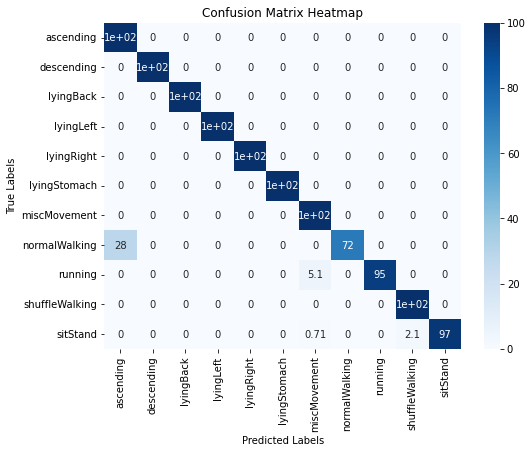

47/71 [0.19896848499774933, 0.9689119458198547] 0.8913404295841852


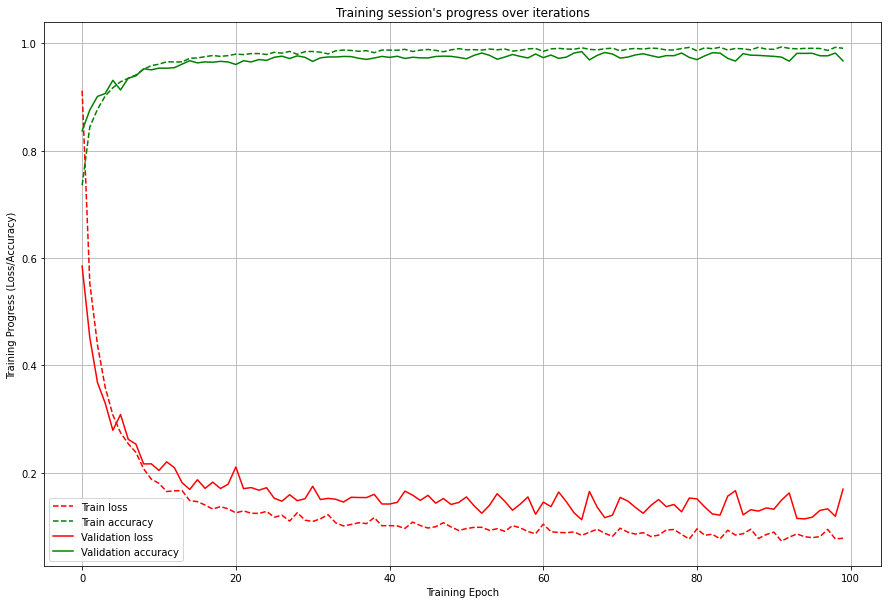

 ..after sliding and reshaping, train data: inputs (53532, 3, 125), targets (53532, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_48 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_48 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_48 (Dropout)        (None, 512)               0         
                                                                 
 dense_96 (Dense)            (None, 64)                32832     
                                                                 
 dense_97 (De

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1045 - accuracy: 0.9857 - val_loss: 0.1299 - val_accuracy: 0.9792
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0918 - accuracy: 0.9898 - val_loss: 0.1609 - val_accuracy: 0.9750
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1150 - accuracy: 0.9824 - val_loss: 0.1793 - val_accuracy: 0.9653
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1035 - accuracy: 0.9870 - val_loss: 0.1469 - val_accuracy: 0.9774
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9898 - val_loss: 0.1596 - val_accuracy: 0.9720
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0894 - accuracy: 0.9899 - val_loss: 0.1436 - val_accuracy: 0.9757
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1131 - accuracy: 0.9829 - val_loss: 0.1438 - val_ac

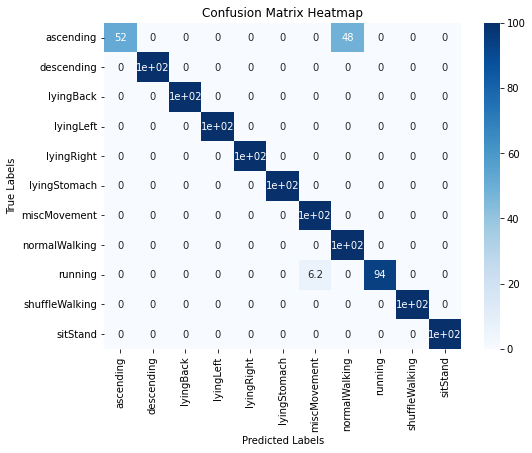

48/71 [0.20098112523555756, 0.9551281929016113] 0.892642220672296


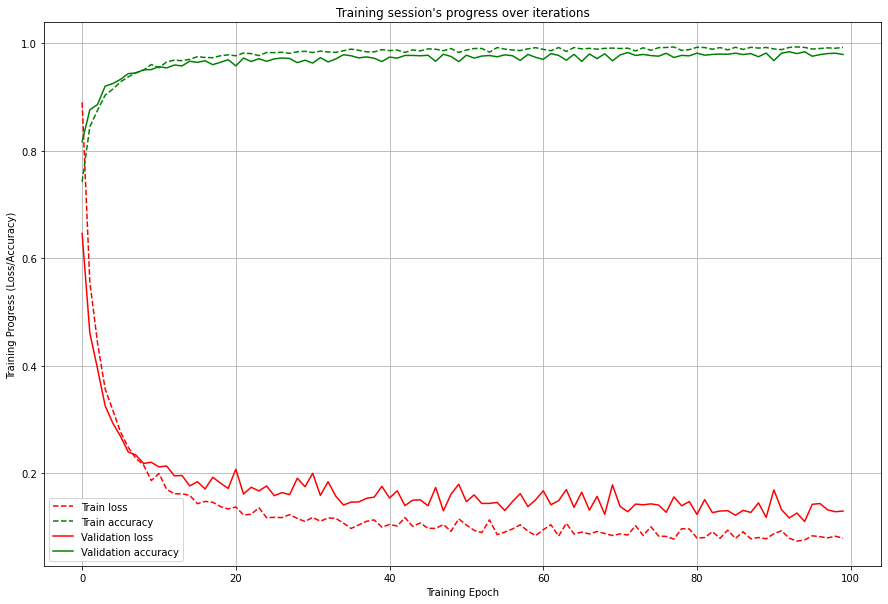

 ..after sliding and reshaping, train data: inputs (53711, 3, 125), targets (53711, 11)
 ..after sliding and reshaping, test data : inputs (766, 3, 125), targets (766, 11)
Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_49 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_49 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_49 (Dropout)        (None, 512)               0         
                                                                 
 dense_98 (Dense)            (None, 64)                32832     
                                                                 
 dense_99 (De

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0981 - accuracy: 0.9883 - val_loss: 0.1658 - val_accuracy: 0.9701
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1050 - accuracy: 0.9859 - val_loss: 0.1509 - val_accuracy: 0.9730
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0957 - accuracy: 0.9883 - val_loss: 0.1380 - val_accuracy: 0.9754
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0903 - accuracy: 0.9896 - val_loss: 0.1485 - val_accuracy: 0.9712
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0994 - accuracy: 0.9874 - val_loss: 0.1467 - val_accuracy: 0.9726
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0941 - accuracy: 0.9885 - val_loss: 0.1708 - val_accuracy: 0.9677
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0951 - accuracy: 0.9882 - val_loss: 0.1538 - val_ac

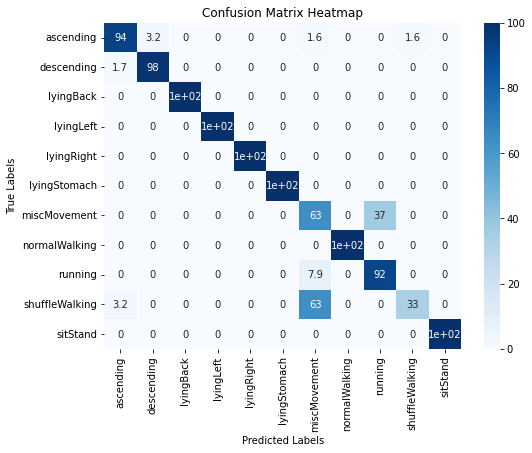

49/71 [0.541317880153656, 0.9020887613296509] 0.8928311514854431


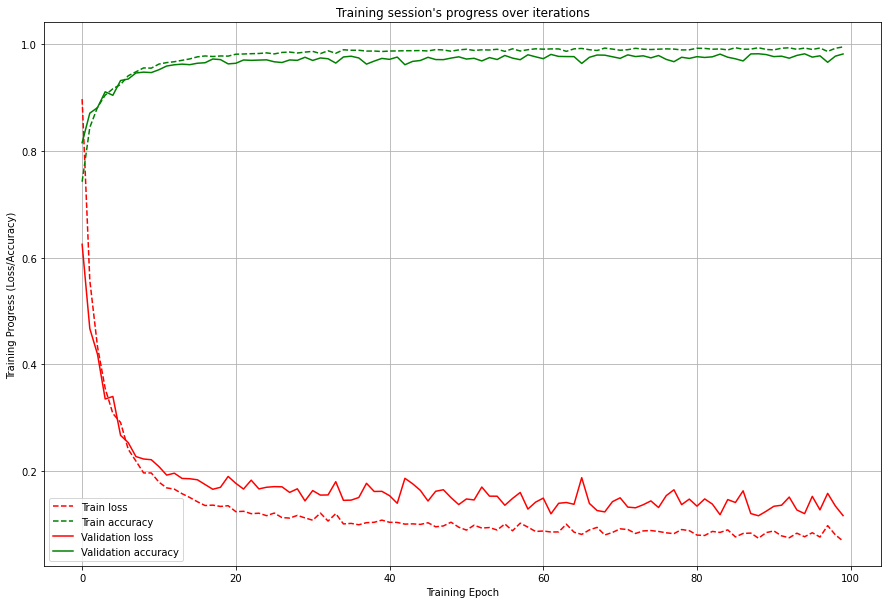

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_50 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_50 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_50 (Dropout)        (None, 512)               0         
                                                                 
 dense_100 (Dense)           (None, 64)                32832     
                                                                 
 dense_101 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0987 - accuracy: 0.9880 - val_loss: 0.1576 - val_accuracy: 0.9734
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0930 - accuracy: 0.9901 - val_loss: 0.1720 - val_accuracy: 0.9641
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1047 - accuracy: 0.9862 - val_loss: 0.1410 - val_accuracy: 0.9771
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0884 - accuracy: 0.9902 - val_loss: 0.1540 - val_accuracy: 0.9737
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0981 - accuracy: 0.9865 - val_loss: 0.1388 - val_accuracy: 0.9775
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0966 - accuracy: 0.9885 - val_loss: 0.1469 - val_accuracy: 0.9748
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1076 - accuracy: 0.9846 - val_loss: 0.1586 - val_ac

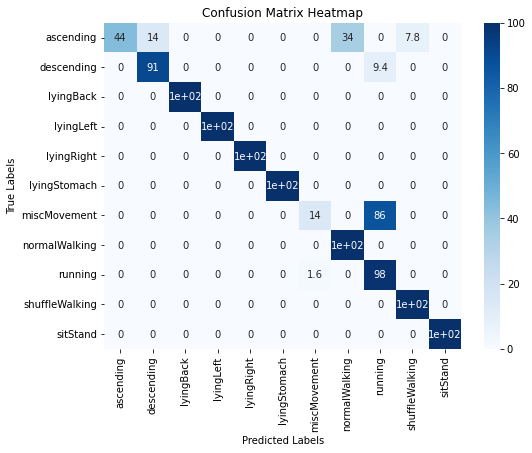

50/71 [1.703768253326416, 0.8743589520454407] 0.8924689514964235


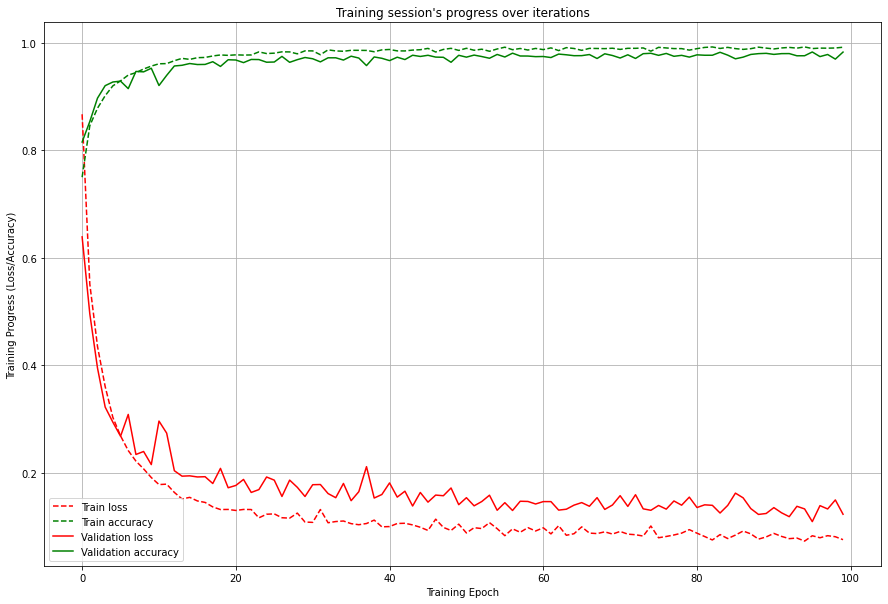

 ..after sliding and reshaping, train data: inputs (53532, 3, 125), targets (53532, 11)
 ..after sliding and reshaping, test data : inputs (778, 3, 125), targets (778, 11)
Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_51 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_51 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_51 (Dropout)        (None, 512)               0         
                                                                 
 dense_102 (Dense)           (None, 64)                32832     
                                                                 
 dense_103 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0923 - accuracy: 0.9888 - val_loss: 0.1532 - val_accuracy: 0.9763
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1041 - accuracy: 0.9853 - val_loss: 0.1664 - val_accuracy: 0.9686
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0948 - accuracy: 0.9888 - val_loss: 0.1552 - val_accuracy: 0.9745
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9871 - val_loss: 0.1734 - val_accuracy: 0.9713
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0997 - accuracy: 0.9866 - val_loss: 0.1584 - val_accuracy: 0.9719
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0962 - accuracy: 0.9876 - val_loss: 0.1895 - val_accuracy: 0.9653
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0891 - accuracy: 0.9896 - val_loss: 0.1618 - val_ac

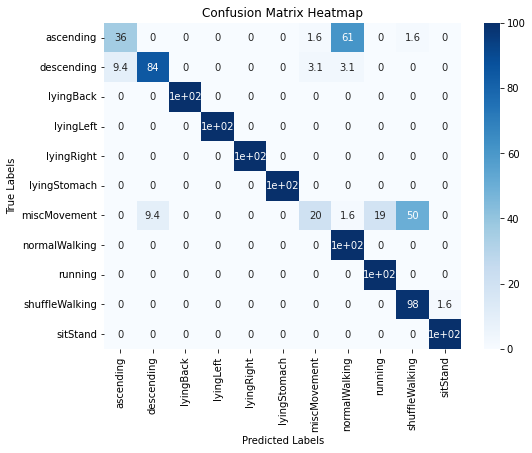

51/71 [0.4816770553588867, 0.8676092624664307] 0.891990880553539


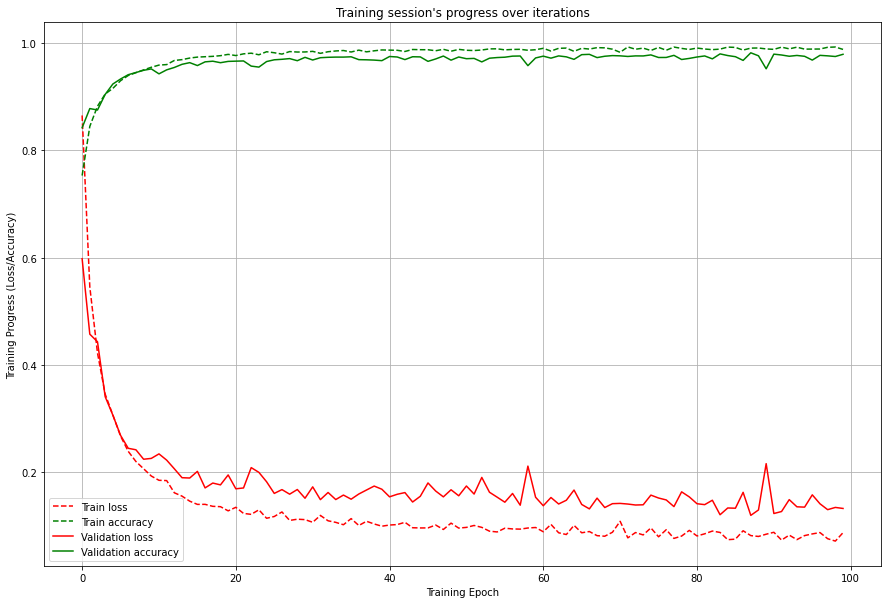

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_52 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_52 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_52 (Dropout)        (None, 512)               0         
                                                                 
 dense_104 (Dense)           (None, 64)                32832     
                                                                 
 dense_105 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0939 - accuracy: 0.9887 - val_loss: 0.1550 - val_accuracy: 0.9733
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0977 - accuracy: 0.9873 - val_loss: 0.1513 - val_accuracy: 0.9702
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1049 - accuracy: 0.9854 - val_loss: 0.1378 - val_accuracy: 0.9788
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9887 - val_loss: 0.1597 - val_accuracy: 0.9716
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0914 - accuracy: 0.9895 - val_loss: 0.1662 - val_accuracy: 0.9684
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0904 - accuracy: 0.9897 - val_loss: 0.1921 - val_accuracy: 0.9662
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1014 - accuracy: 0.9853 - val_loss: 0.1408 - val_ac

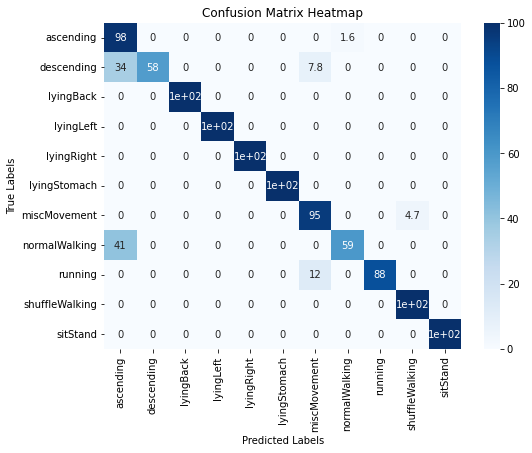

52/71 [0.35592129826545715, 0.9166666865348816] 0.8924564617984699


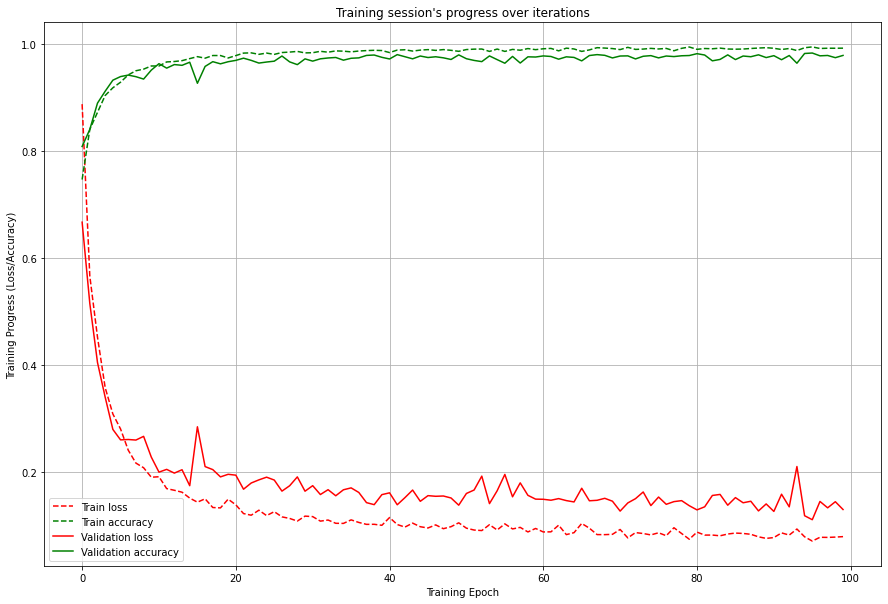

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_53 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_53 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_53 (Dropout)        (None, 512)               0         
                                                                 
 dense_106 (Dense)           (None, 64)                32832     
                                                                 
 dense_107 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1092 - accuracy: 0.9846 - val_loss: 0.1364 - val_accuracy: 0.9774
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0971 - accuracy: 0.9884 - val_loss: 0.1291 - val_accuracy: 0.9790
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0882 - accuracy: 0.9909 - val_loss: 0.1470 - val_accuracy: 0.9740
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9888 - val_loss: 0.1553 - val_accuracy: 0.9720
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9879 - val_loss: 0.1419 - val_accuracy: 0.9740
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9894 - val_loss: 0.1741 - val_accuracy: 0.9671
Epoch 54/100
335/335 [==============================] - 4s 13ms/step - loss: 0.1072 - accuracy: 0.9841 - val_loss: 0.1311 - val_ac

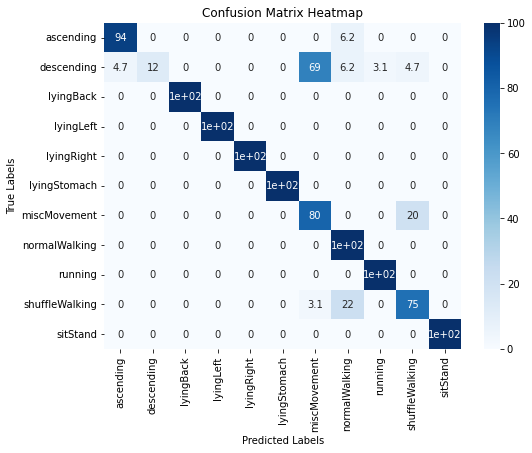

53/71 [0.5285232663154602, 0.8858974575996399] 0.8923349987577509


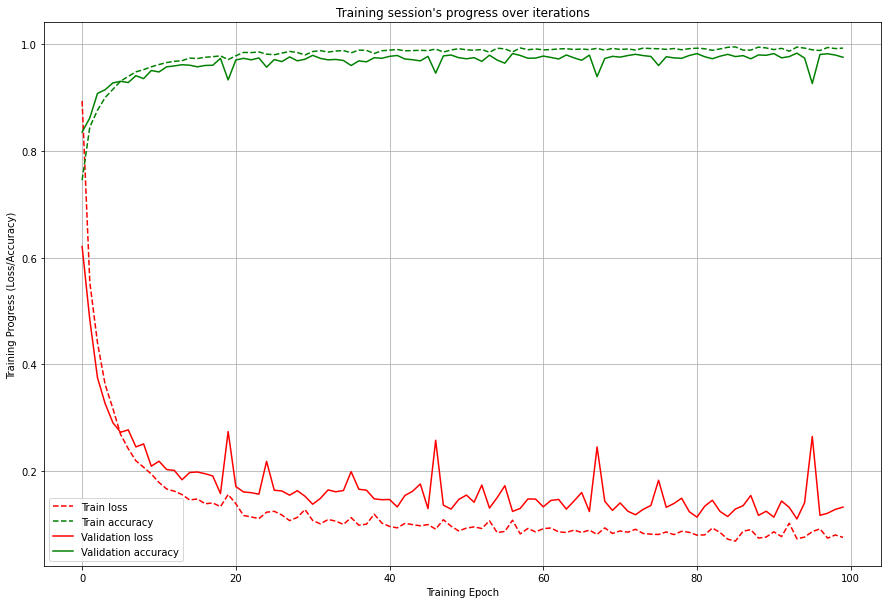

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_54 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_54 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_54 (Dropout)        (None, 512)               0         
                                                                 
 dense_108 (Dense)           (None, 64)                32832     
                                                                 
 dense_109 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1079 - accuracy: 0.9846 - val_loss: 0.1435 - val_accuracy: 0.9781
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1066 - accuracy: 0.9851 - val_loss: 0.1589 - val_accuracy: 0.9762
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9892 - val_loss: 0.1346 - val_accuracy: 0.9795
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1015 - accuracy: 0.9870 - val_loss: 0.1422 - val_accuracy: 0.9756
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0942 - accuracy: 0.9891 - val_loss: 0.1277 - val_accuracy: 0.9783
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0925 - accuracy: 0.9888 - val_loss: 0.1516 - val_accuracy: 0.9727
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0926 - accuracy: 0.9884 - val_loss: 0.1595 - val_ac

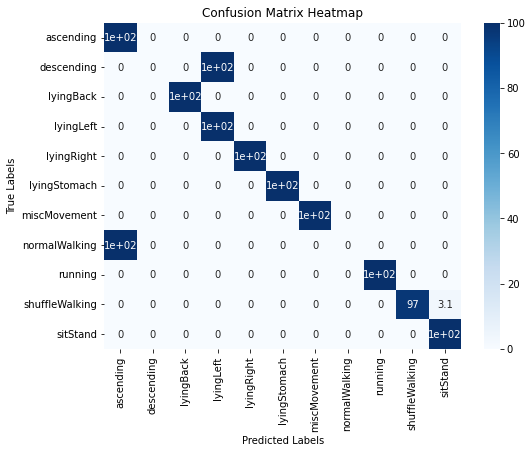

54/71 [1.3225512504577637, 0.8333333134651184] 0.8912622408433394


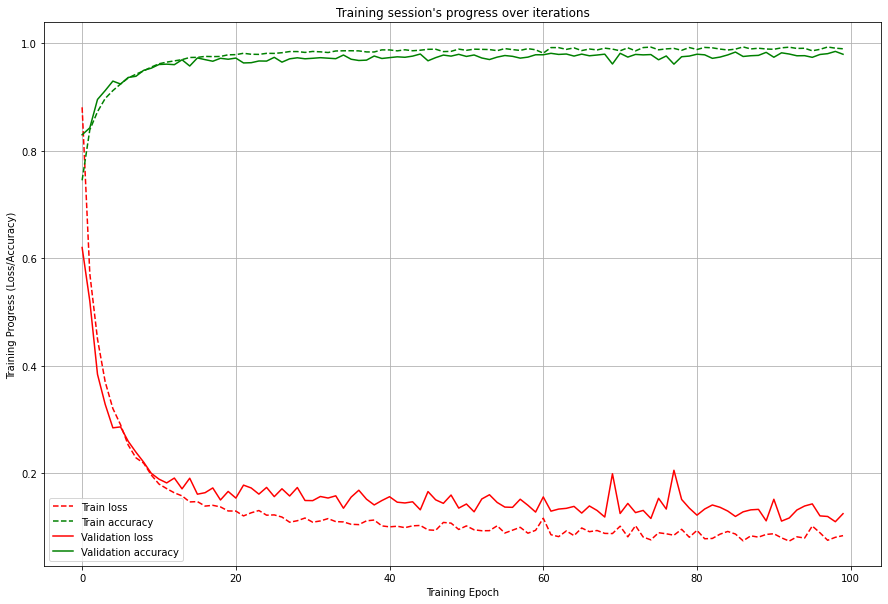

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_55 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_55 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_55 (Dropout)        (None, 512)               0         
                                                                 
 dense_110 (Dense)           (None, 64)                32832     
                                                                 
 dense_111 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1200 - accuracy: 0.9821 - val_loss: 0.1529 - val_accuracy: 0.9759
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9893 - val_loss: 0.1528 - val_accuracy: 0.9745
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0976 - accuracy: 0.9876 - val_loss: 0.1621 - val_accuracy: 0.9684
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9886 - val_loss: 0.1400 - val_accuracy: 0.9765
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1090 - accuracy: 0.9834 - val_loss: 0.1585 - val_accuracy: 0.9753
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9900 - val_loss: 0.1490 - val_accuracy: 0.9738
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0869 - accuracy: 0.9907 - val_loss: 0.1651 - val_ac

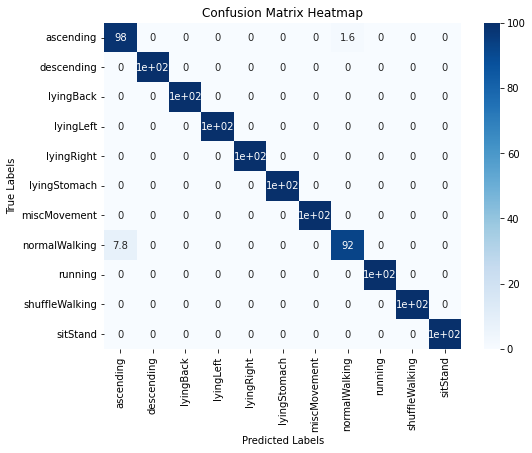

55/71 [0.0738503709435463, 0.9923076629638672] 0.893066623381206


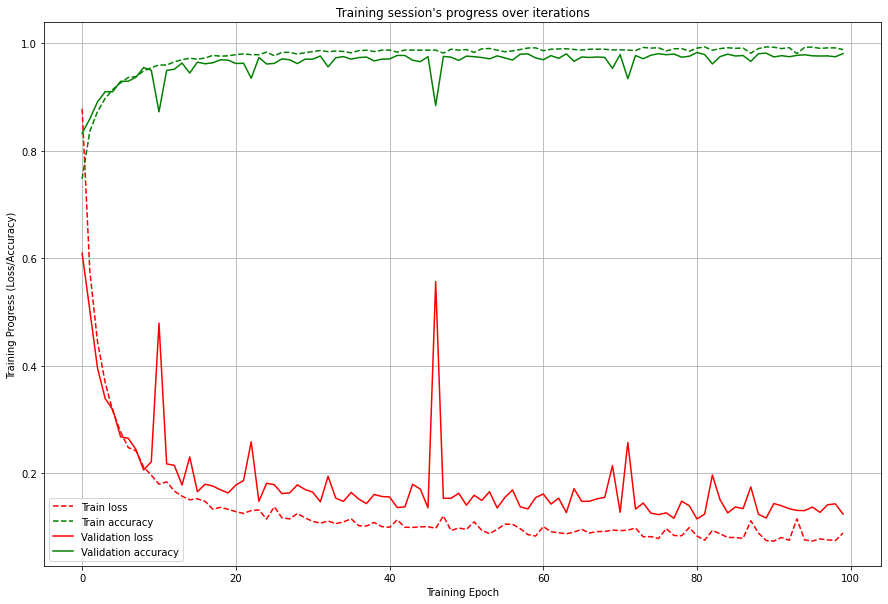

 ..after sliding and reshaping, train data: inputs (53608, 3, 125), targets (53608, 11)
 ..after sliding and reshaping, test data : inputs (705, 3, 125), targets (705, 11)
Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_56 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_56 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_56 (Dropout)        (None, 512)               0         
                                                                 
 dense_112 (Dense)           (None, 64)                32832     
                                                                 
 dense_113 (D

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9871 - val_loss: 0.1667 - val_accuracy: 0.9659
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0927 - accuracy: 0.9891 - val_loss: 0.1443 - val_accuracy: 0.9771
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1061 - accuracy: 0.9858 - val_loss: 0.1435 - val_accuracy: 0.9738
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0970 - accuracy: 0.9886 - val_loss: 0.1617 - val_accuracy: 0.9698
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9879 - val_loss: 0.1761 - val_accuracy: 0.9635
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0895 - accuracy: 0.9904 - val_loss: 0.1417 - val_accuracy: 0.9751
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1005 - accuracy: 0.9865 - val_loss: 0.1507 - val_ac

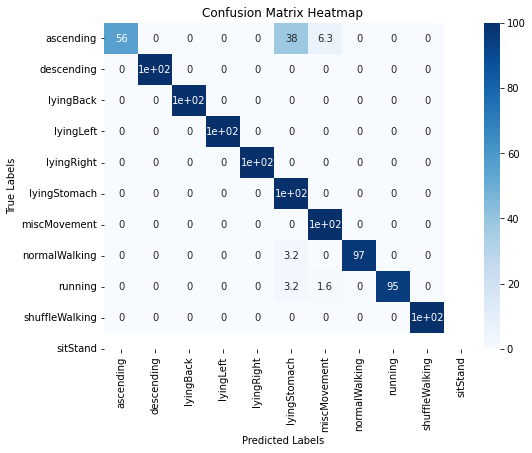

56/71 [0.3533410131931305, 0.9531915187835693] 0.8941214461075632


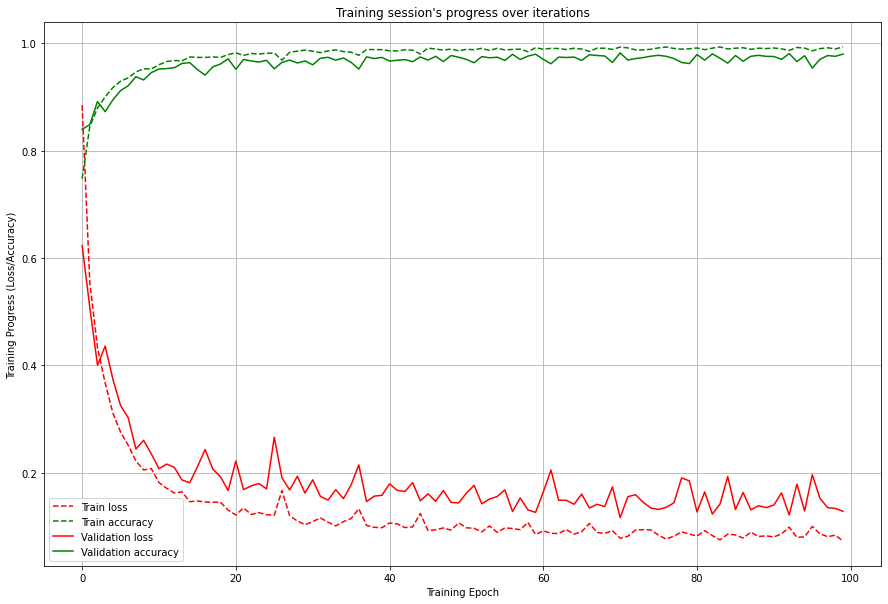

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_57 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_57 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_57 (Dropout)        (None, 512)               0         
                                                                 
 dense_114 (Dense)           (None, 64)                32832     
                                                                 
 dense_115 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1035 - accuracy: 0.9872 - val_loss: 0.1382 - val_accuracy: 0.9797
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1010 - accuracy: 0.9868 - val_loss: 0.1792 - val_accuracy: 0.9663
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0996 - accuracy: 0.9873 - val_loss: 0.1505 - val_accuracy: 0.9738
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0977 - accuracy: 0.9874 - val_loss: 0.1339 - val_accuracy: 0.9791
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1038 - accuracy: 0.9854 - val_loss: 0.1766 - val_accuracy: 0.9614
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0972 - accuracy: 0.9878 - val_loss: 0.1462 - val_accuracy: 0.9750
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0973 - accuracy: 0.9876 - val_loss: 0.1342 - val_ac

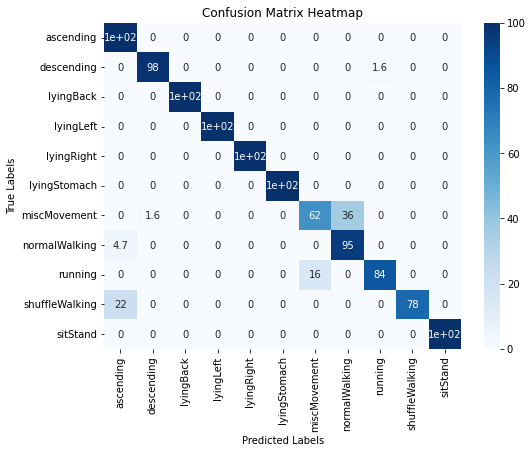

57/71 [0.24687018990516663, 0.9333333373069763] 0.8947975131972082


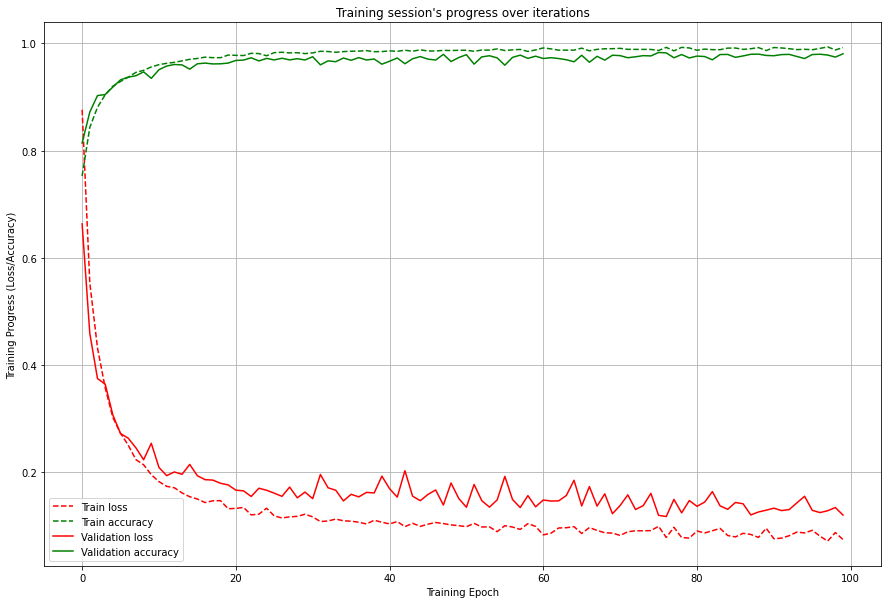

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_58 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_58 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_58 (Dropout)        (None, 512)               0         
                                                                 
 dense_116 (Dense)           (None, 64)                32832     
                                                                 
 dense_117 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0958 - accuracy: 0.9887 - val_loss: 0.1710 - val_accuracy: 0.9687
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0992 - accuracy: 0.9883 - val_loss: 0.1413 - val_accuracy: 0.9713
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1070 - accuracy: 0.9843 - val_loss: 0.1536 - val_accuracy: 0.9732
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0998 - accuracy: 0.9874 - val_loss: 0.1445 - val_accuracy: 0.9767
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0976 - accuracy: 0.9880 - val_loss: 0.1492 - val_accuracy: 0.9751
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0894 - accuracy: 0.9901 - val_loss: 0.1898 - val_accuracy: 0.9504
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0910 - accuracy: 0.9897 - val_loss: 0.1484 - val_ac

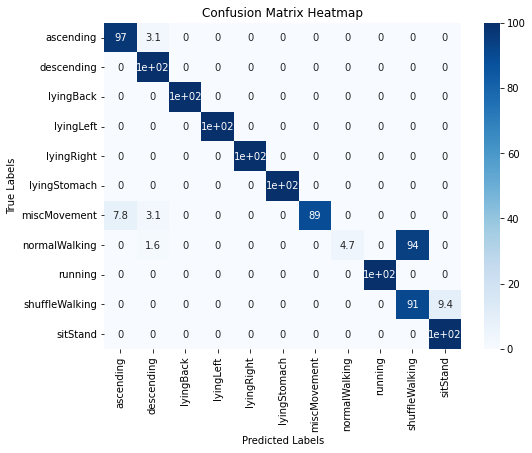

58/71 [0.3680254817008972, 0.9025641083717346] 0.8949291504035561


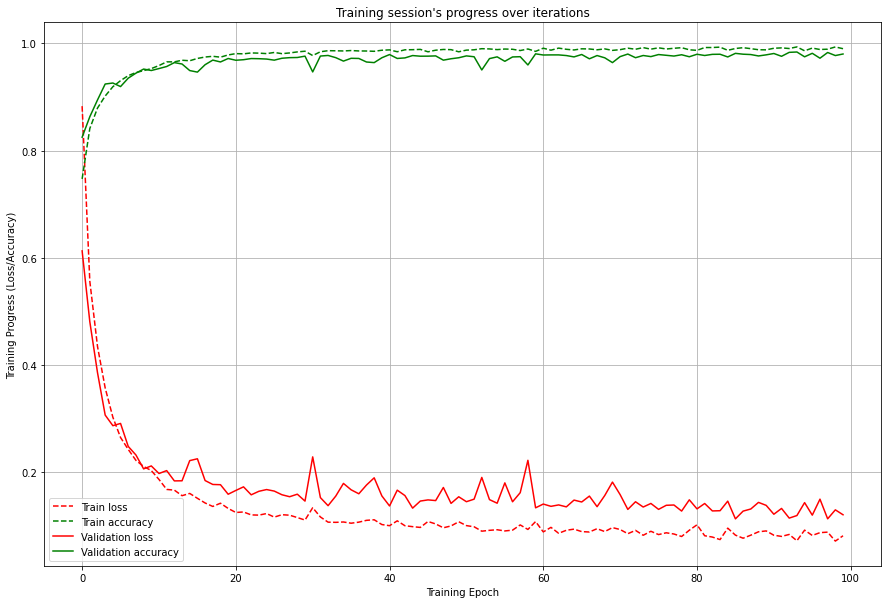

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_59 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_59 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_59 (Dropout)        (None, 512)               0         
                                                                 
 dense_118 (Dense)           (None, 64)                32832     
                                                                 
 dense_119 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0999 - accuracy: 0.9872 - val_loss: 0.1526 - val_accuracy: 0.9738
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9893 - val_loss: 0.1450 - val_accuracy: 0.9770
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0912 - accuracy: 0.9897 - val_loss: 0.1509 - val_accuracy: 0.9760
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1008 - accuracy: 0.9869 - val_loss: 0.1420 - val_accuracy: 0.9769
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0949 - accuracy: 0.9887 - val_loss: 0.1469 - val_accuracy: 0.9714
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0932 - accuracy: 0.9893 - val_loss: 0.2038 - val_accuracy: 0.9586
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0951 - accuracy: 0.9883 - val_loss: 0.1247 - val_ac

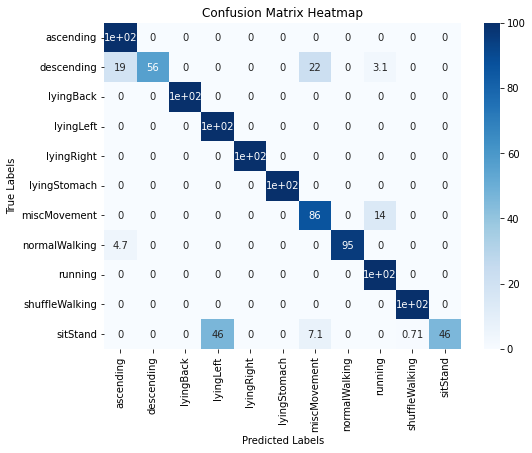

59/71 [2.252037525177002, 0.8512820601463318] 0.8942016988992691


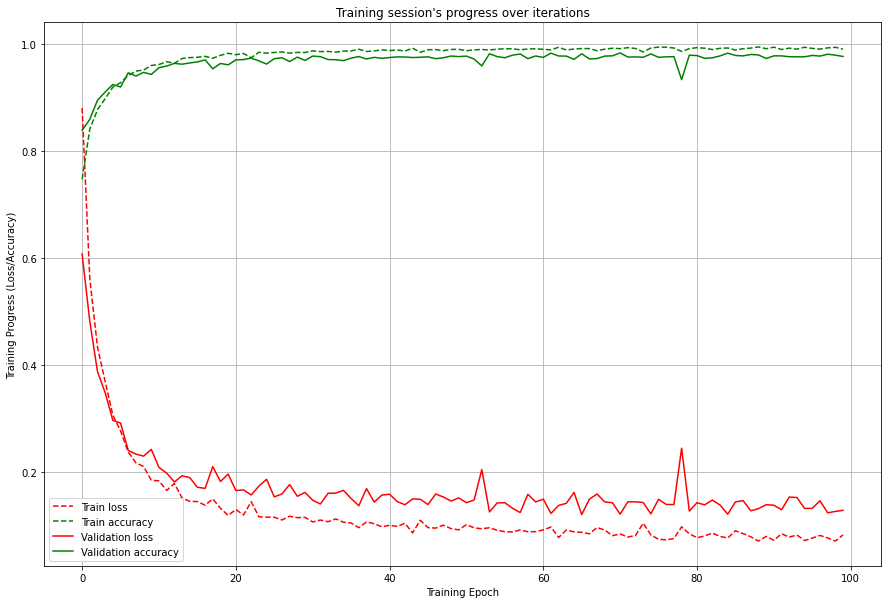

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_60 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_60 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_60 (Dropout)        (None, 512)               0         
                                                                 
 dense_120 (Dense)           (None, 64)                32832     
                                                                 
 dense_121 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1017 - accuracy: 0.9867 - val_loss: 0.1704 - val_accuracy: 0.9725
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1060 - accuracy: 0.9855 - val_loss: 0.1658 - val_accuracy: 0.9723
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0972 - accuracy: 0.9883 - val_loss: 0.1451 - val_accuracy: 0.9764
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0898 - accuracy: 0.9905 - val_loss: 0.1580 - val_accuracy: 0.9752
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0940 - accuracy: 0.9885 - val_loss: 0.1474 - val_accuracy: 0.9794
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0961 - accuracy: 0.9880 - val_loss: 0.1473 - val_accuracy: 0.9777
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0881 - accuracy: 0.9911 - val_loss: 0.1594 - val_ac

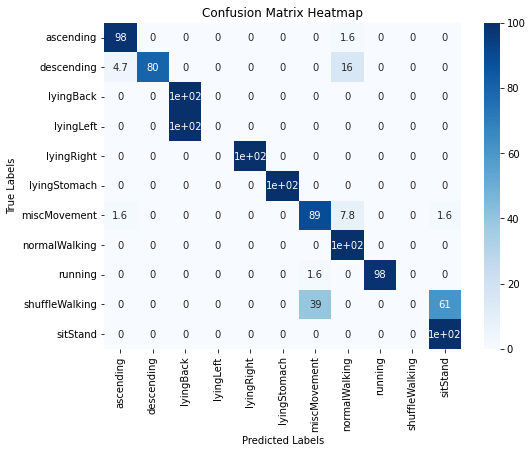

60/71 [2.1668014526367188, 0.807692289352417] 0.8927835118575175


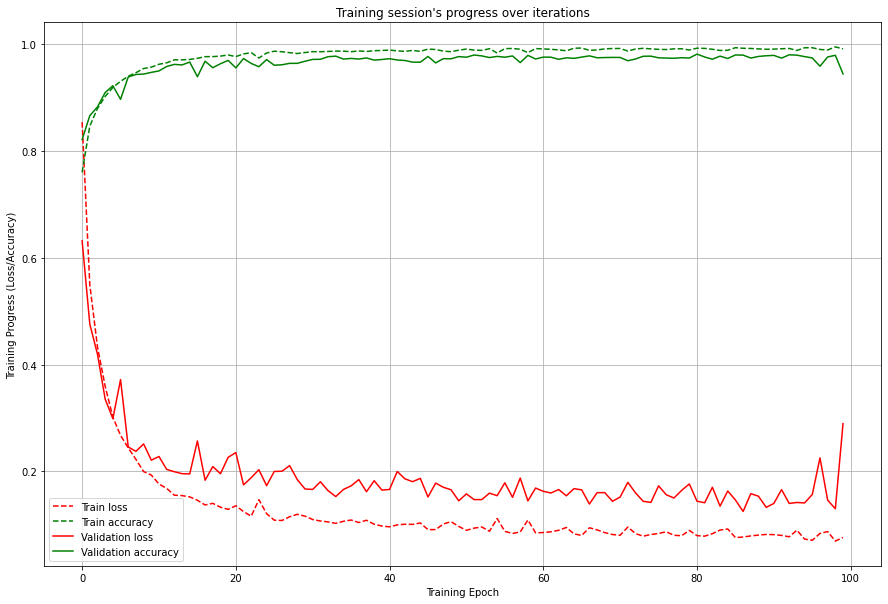

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_61 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_61 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_61 (Dropout)        (None, 512)               0         
                                                                 
 dense_122 (Dense)           (None, 64)                32832     
                                                                 
 dense_123 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1123 - accuracy: 0.9830 - val_loss: 0.1536 - val_accuracy: 0.9782
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0901 - accuracy: 0.9903 - val_loss: 0.1604 - val_accuracy: 0.9742
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0967 - accuracy: 0.9880 - val_loss: 0.1445 - val_accuracy: 0.9744
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0918 - accuracy: 0.9891 - val_loss: 0.1603 - val_accuracy: 0.9686
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0983 - accuracy: 0.9873 - val_loss: 0.1476 - val_accuracy: 0.9741
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1129 - accuracy: 0.9825 - val_loss: 0.1546 - val_accuracy: 0.9759
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0891 - accuracy: 0.9904 - val_loss: 0.1480 - val_ac

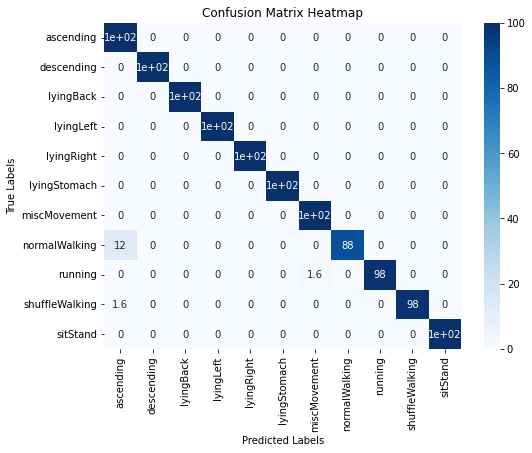

61/71 [0.12298762053251266, 0.9871794581413269] 0.8943060271201595


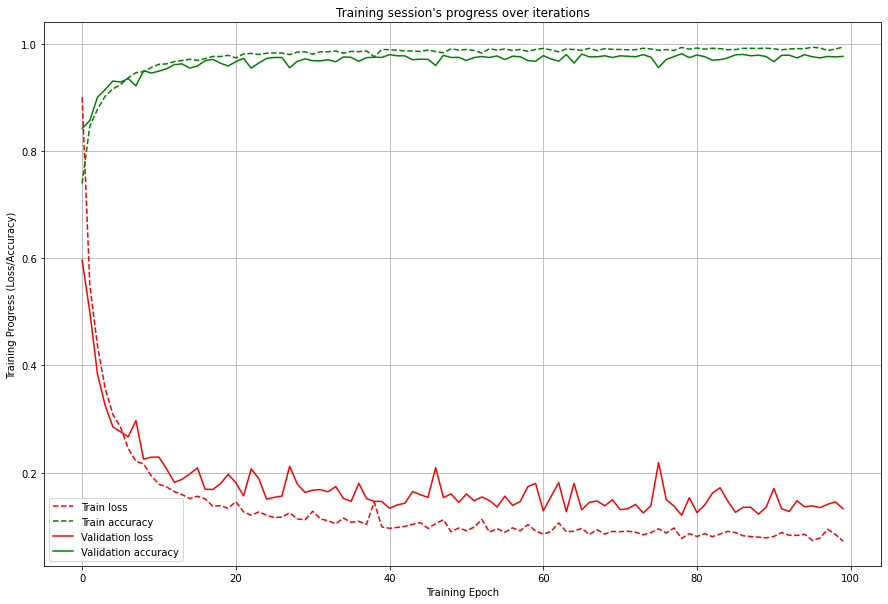

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_62"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_62 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_62 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_62 (Dropout)        (None, 512)               0         
                                                                 
 dense_124 (Dense)           (None, 64)                32832     
                                                                 
 dense_125 (D

Epoch 48/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0956 - accuracy: 0.9882 - val_loss: 0.1598 - val_accuracy: 0.9711
Epoch 49/100
335/335 [==============================] - 4s 13ms/step - loss: 0.1113 - accuracy: 0.9838 - val_loss: 0.1663 - val_accuracy: 0.9746
Epoch 50/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0961 - accuracy: 0.9891 - val_loss: 0.1480 - val_accuracy: 0.9764
Epoch 51/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0913 - accuracy: 0.9905 - val_loss: 0.1770 - val_accuracy: 0.9660
Epoch 52/100
335/335 [==============================] - 4s 13ms/step - loss: 0.1042 - accuracy: 0.9861 - val_loss: 0.1586 - val_accuracy: 0.9758
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0905 - accuracy: 0.9904 - val_loss: 0.1495 - val_accuracy: 0.9750
Epoch 54/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0958 - accuracy: 0.9881 - val_loss: 0.1658 - val_ac

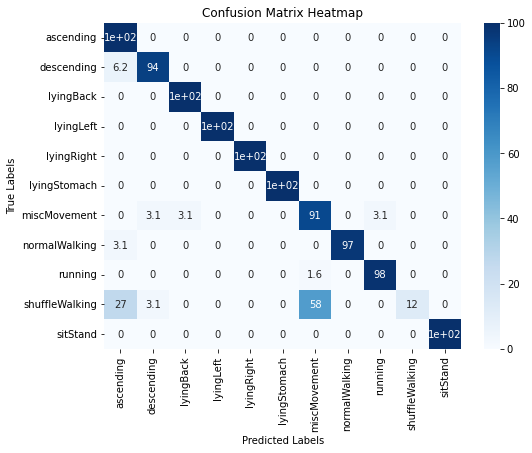

62/71 [0.6790794730186462, 0.9115384817123413] 0.8945795581454322


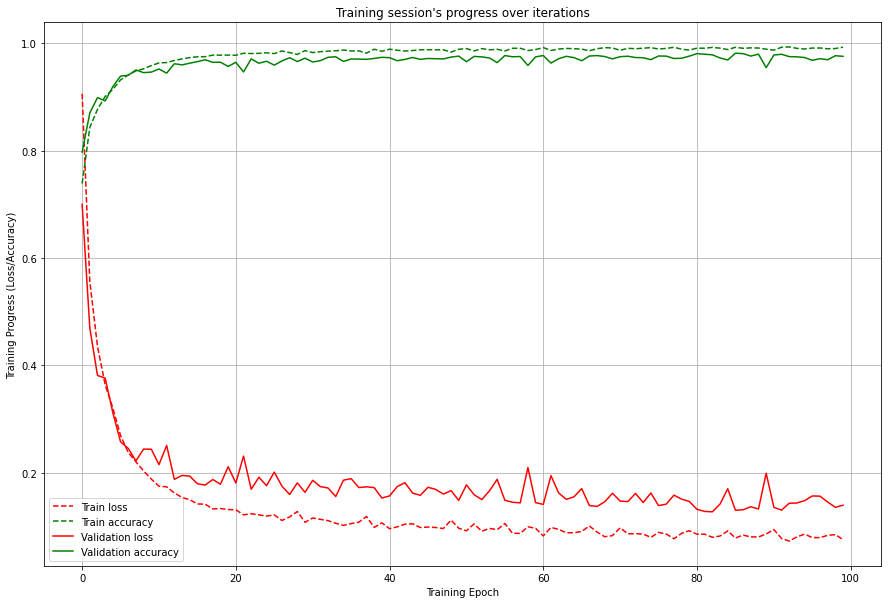

 ..after sliding and reshaping, train data: inputs (53532, 3, 125), targets (53532, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_63 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_63 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_63 (Dropout)        (None, 512)               0         
                                                                 
 dense_126 (Dense)           (None, 64)                32832     
                                                                 
 dense_127 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0955 - accuracy: 0.9886 - val_loss: 0.1713 - val_accuracy: 0.9719
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1166 - accuracy: 0.9828 - val_loss: 0.1987 - val_accuracy: 0.9605
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1013 - accuracy: 0.9874 - val_loss: 0.1452 - val_accuracy: 0.9770
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0872 - accuracy: 0.9910 - val_loss: 0.1537 - val_accuracy: 0.9758
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0954 - accuracy: 0.9887 - val_loss: 0.1500 - val_accuracy: 0.9752
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0941 - accuracy: 0.9883 - val_loss: 0.1518 - val_accuracy: 0.9764
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0978 - accuracy: 0.9872 - val_loss: 0.1587 - val_ac

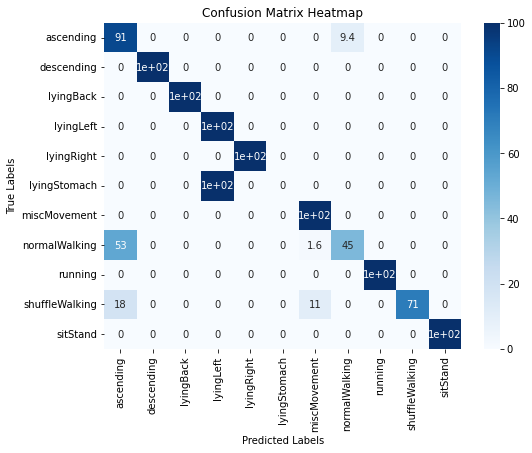

63/71 [0.4620923101902008, 0.8410256505012512] 0.8937427783384919


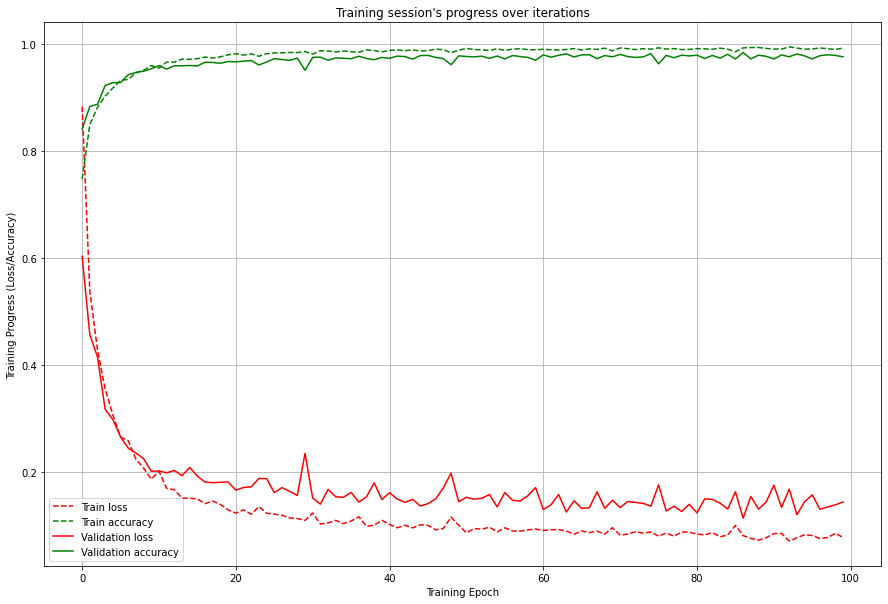

 ..after sliding and reshaping, train data: inputs (53747, 3, 125), targets (53747, 11)
 ..after sliding and reshaping, test data : inputs (580, 3, 125), targets (580, 11)
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_64 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_64 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_64 (Dropout)        (None, 512)               0         
                                                                 
 dense_128 (Dense)           (None, 64)                32832     
                                                                 
 dense_129 (D

Epoch 48/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1003 - accuracy: 0.9874 - val_loss: 0.1566 - val_accuracy: 0.9756
Epoch 49/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0970 - accuracy: 0.9881 - val_loss: 0.1308 - val_accuracy: 0.9780
Epoch 50/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0944 - accuracy: 0.9893 - val_loss: 0.2394 - val_accuracy: 0.9547
Epoch 51/100
336/336 [==============================] - 4s 12ms/step - loss: 0.1042 - accuracy: 0.9862 - val_loss: 0.1268 - val_accuracy: 0.9806
Epoch 52/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0883 - accuracy: 0.9907 - val_loss: 0.1277 - val_accuracy: 0.9790
Epoch 53/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0885 - accuracy: 0.9902 - val_loss: 0.1345 - val_accuracy: 0.9771
Epoch 54/100
336/336 [==============================] - 4s 12ms/step - loss: 0.0926 - accuracy: 0.9886 - val_loss: 0.1511 - val_ac

/tmp/ipykernel_1515363/3992885760.py:25: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100


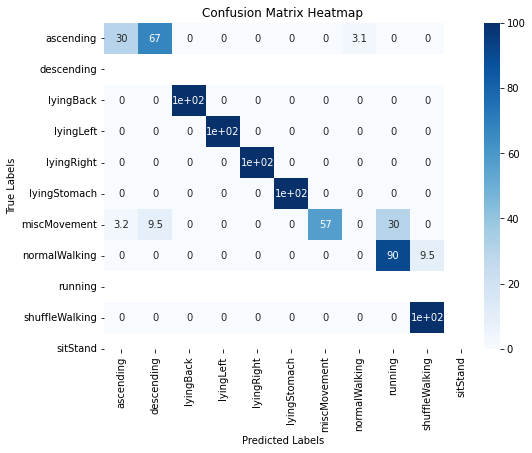

64/71 [2.289872407913208, 0.767241358757019] 0.8917966026526231


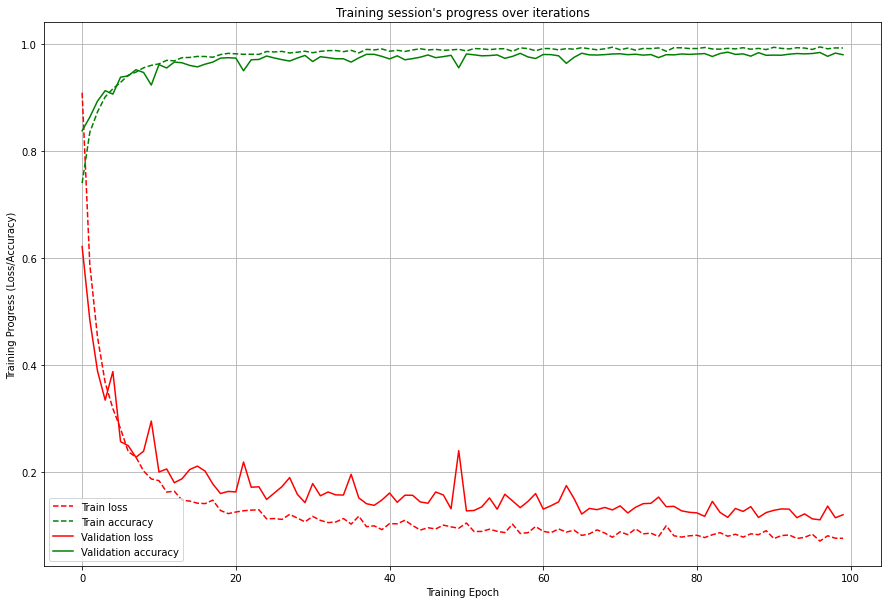

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_65 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_65 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_65 (Dropout)        (None, 512)               0         
                                                                 
 dense_130 (Dense)           (None, 64)                32832     
                                                                 
 dense_131 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1039 - accuracy: 0.9848 - val_loss: 0.1432 - val_accuracy: 0.9746
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0874 - accuracy: 0.9904 - val_loss: 0.1576 - val_accuracy: 0.9663
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1131 - accuracy: 0.9828 - val_loss: 0.1492 - val_accuracy: 0.9747
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0928 - accuracy: 0.9891 - val_loss: 0.1565 - val_accuracy: 0.9692
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0863 - accuracy: 0.9908 - val_loss: 0.1423 - val_accuracy: 0.9742
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0982 - accuracy: 0.9867 - val_loss: 0.1358 - val_accuracy: 0.9772
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0893 - accuracy: 0.9893 - val_loss: 0.1503 - val_ac

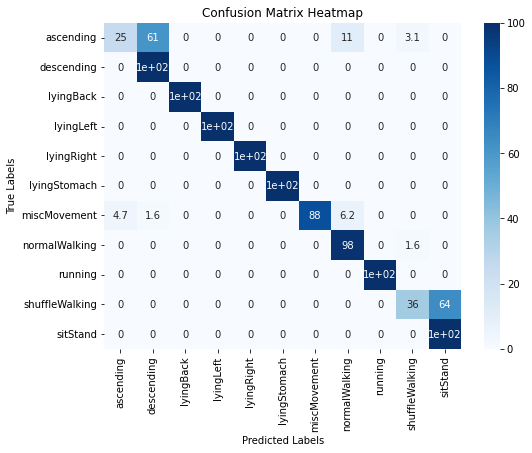

65/71 [0.529509961605072, 0.8743589520454407] 0.8915323958252416


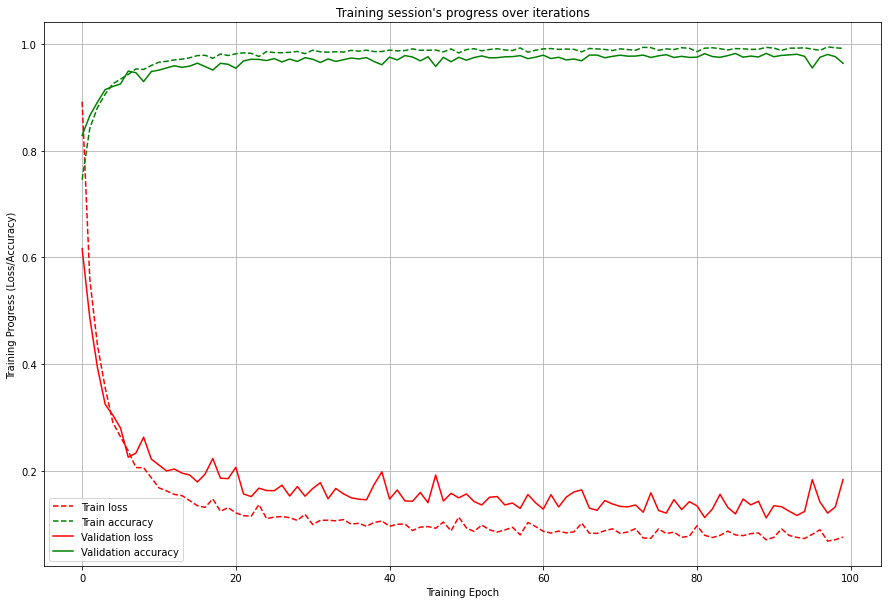

 ..after sliding and reshaping, train data: inputs (53534, 3, 125), targets (53534, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_66 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_66 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_66 (Dropout)        (None, 512)               0         
                                                                 
 dense_132 (Dense)           (None, 64)                32832     
                                                                 
 dense_133 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1034 - accuracy: 0.9853 - val_loss: 0.1466 - val_accuracy: 0.9753
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0986 - accuracy: 0.9877 - val_loss: 0.1496 - val_accuracy: 0.9758
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9889 - val_loss: 0.1541 - val_accuracy: 0.9713
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1022 - accuracy: 0.9861 - val_loss: 0.1516 - val_accuracy: 0.9739
Epoch 52/100
335/335 [==============================] - 4s 13ms/step - loss: 0.0930 - accuracy: 0.9894 - val_loss: 0.1368 - val_accuracy: 0.9770
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0937 - accuracy: 0.9889 - val_loss: 0.1629 - val_accuracy: 0.9699
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1117 - accuracy: 0.9825 - val_loss: 0.1579 - val_ac

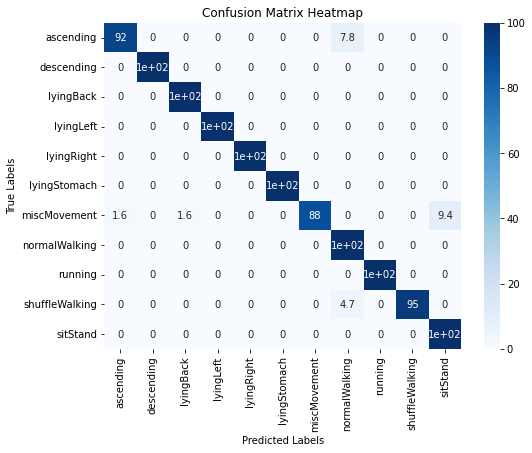

66/71 [0.1334623545408249, 0.9794871807098389] 0.8928451538085938


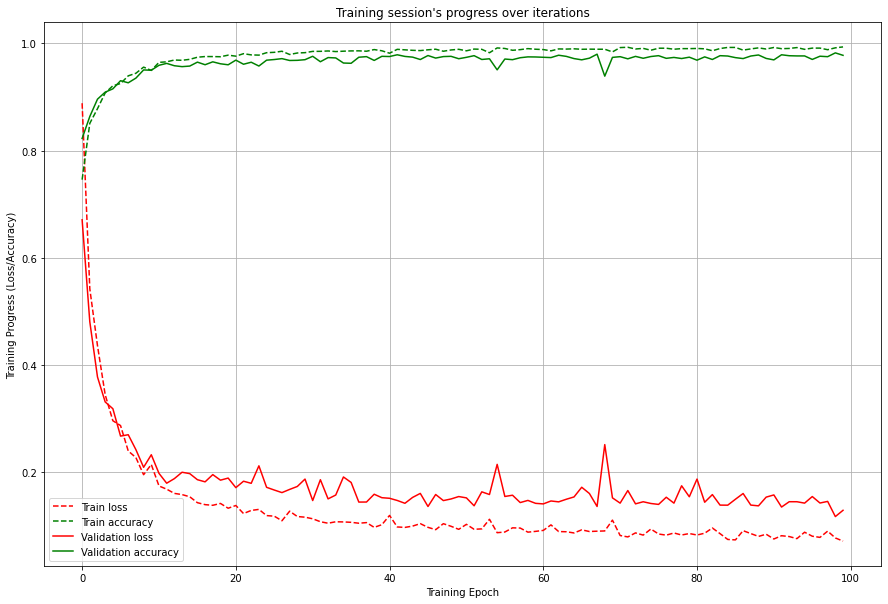

 ..after sliding and reshaping, train data: inputs (53533, 3, 125), targets (53533, 11)
 ..after sliding and reshaping, test data : inputs (777, 3, 125), targets (777, 11)
Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_67 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_67 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_67 (Dropout)        (None, 512)               0         
                                                                 
 dense_134 (Dense)           (None, 64)                32832     
                                                                 
 dense_135 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0927 - accuracy: 0.9891 - val_loss: 0.1451 - val_accuracy: 0.9781
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1019 - accuracy: 0.9863 - val_loss: 0.1699 - val_accuracy: 0.9696
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1011 - accuracy: 0.9876 - val_loss: 0.1416 - val_accuracy: 0.9780
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0957 - accuracy: 0.9892 - val_loss: 0.1595 - val_accuracy: 0.9719
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0923 - accuracy: 0.9894 - val_loss: 0.1314 - val_accuracy: 0.9804
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0944 - accuracy: 0.9881 - val_loss: 0.1359 - val_accuracy: 0.9791
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0880 - accuracy: 0.9909 - val_loss: 0.1468 - val_ac

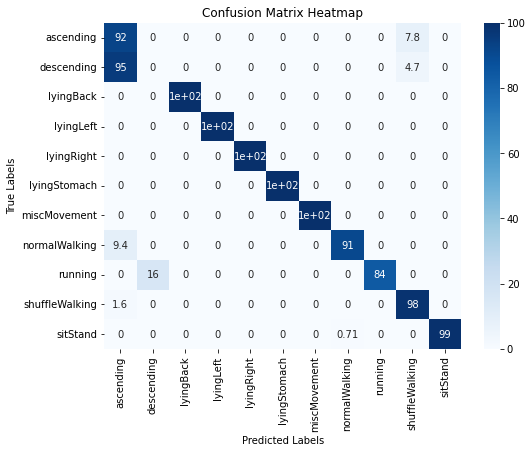

67/71 [1.011481761932373, 0.8880308866500854] 0.8927743557621451


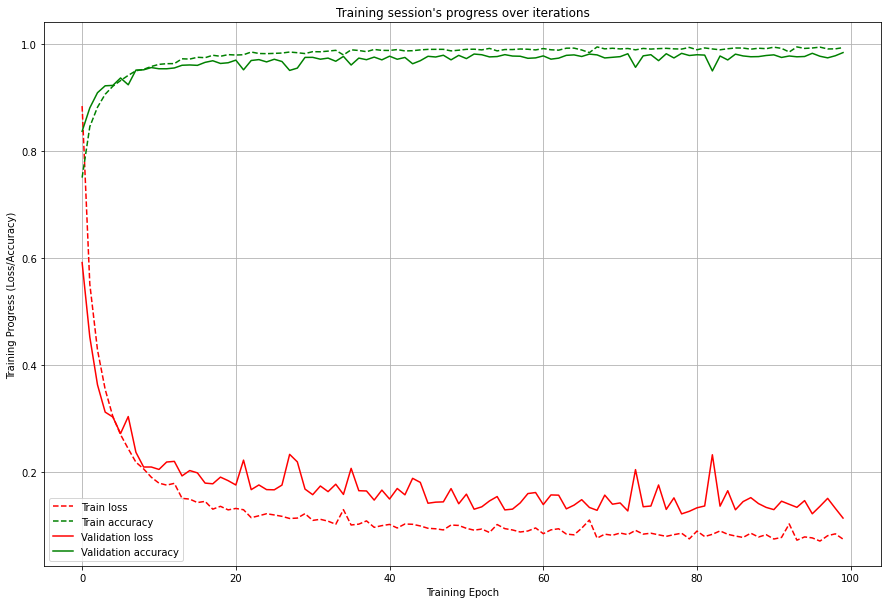

 ..after sliding and reshaping, train data: inputs (53526, 3, 125), targets (53526, 11)
 ..after sliding and reshaping, test data : inputs (777, 3, 125), targets (777, 11)
Model: "sequential_68"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_68 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_68 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_68 (Dropout)        (None, 512)               0         
                                                                 
 dense_136 (Dense)           (None, 64)                32832     
                                                                 
 dense_137 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0915 - accuracy: 0.9897 - val_loss: 0.1737 - val_accuracy: 0.9711
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0976 - accuracy: 0.9872 - val_loss: 0.1916 - val_accuracy: 0.9673
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0944 - accuracy: 0.9888 - val_loss: 0.1468 - val_accuracy: 0.9765
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0941 - accuracy: 0.9892 - val_loss: 0.1559 - val_accuracy: 0.9724
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0920 - accuracy: 0.9895 - val_loss: 0.1473 - val_accuracy: 0.9768
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0994 - accuracy: 0.9874 - val_loss: 0.1415 - val_accuracy: 0.9752
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0920 - accuracy: 0.9897 - val_loss: 0.1806 - val_ac

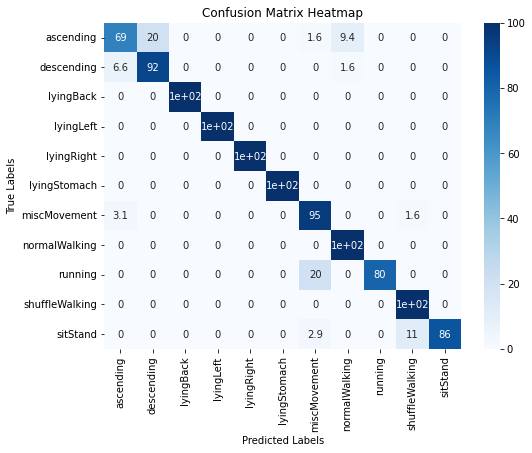

68/71 [0.5255230069160461, 0.9214929342269897] 0.8931905670442443


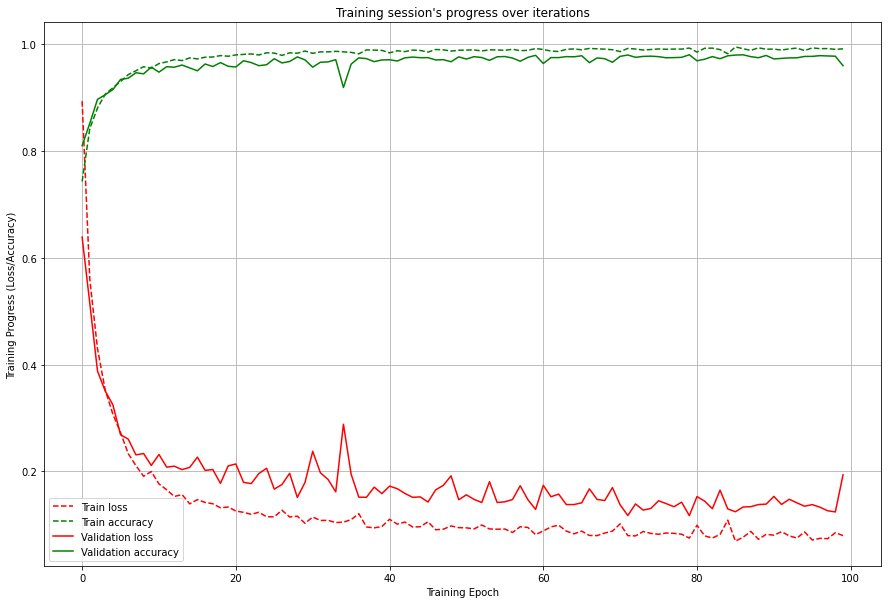

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_69 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_69 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_69 (Dropout)        (None, 512)               0         
                                                                 
 dense_138 (Dense)           (None, 64)                32832     
                                                                 
 dense_139 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9897 - val_loss: 0.1289 - val_accuracy: 0.9793
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0888 - accuracy: 0.9904 - val_loss: 0.1398 - val_accuracy: 0.9759
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0968 - accuracy: 0.9879 - val_loss: 0.1574 - val_accuracy: 0.9710
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0997 - accuracy: 0.9871 - val_loss: 0.1445 - val_accuracy: 0.9764
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0998 - accuracy: 0.9868 - val_loss: 0.1334 - val_accuracy: 0.9794
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0935 - accuracy: 0.9894 - val_loss: 0.1462 - val_accuracy: 0.9763
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0890 - accuracy: 0.9904 - val_loss: 0.1305 - val_ac

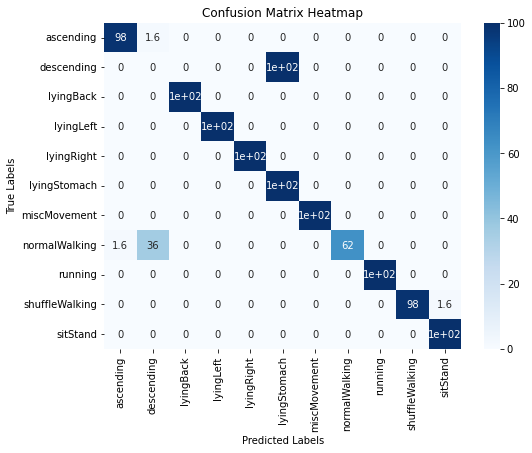

69/71 [2.8194756507873535, 0.8846153616905212] 0.8930680641106197


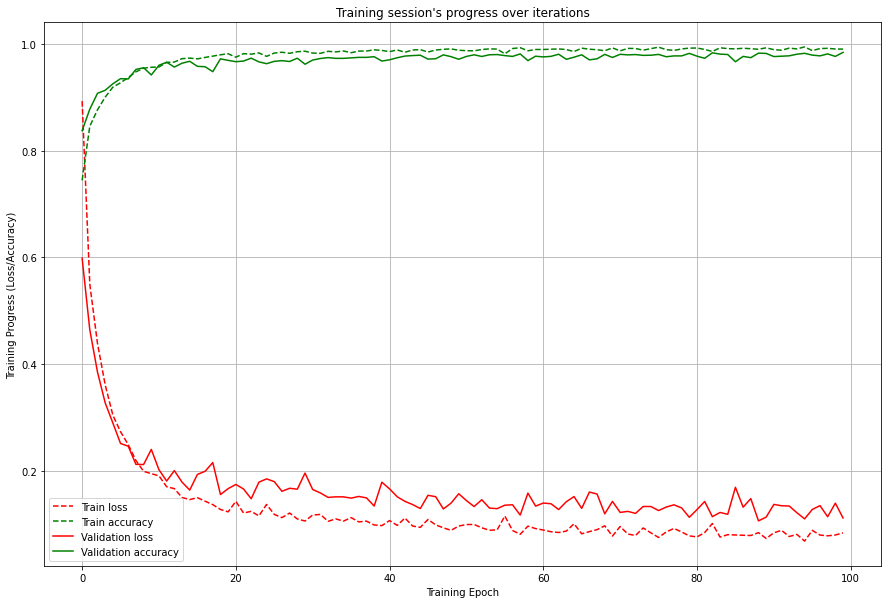

 ..after sliding and reshaping, train data: inputs (53523, 3, 125), targets (53523, 11)
 ..after sliding and reshaping, test data : inputs (780, 3, 125), targets (780, 11)
Model: "sequential_70"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_70 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_70 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_70 (Dropout)        (None, 512)               0         
                                                                 
 dense_140 (Dense)           (None, 64)                32832     
                                                                 
 dense_141 (D

Epoch 48/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0890 - accuracy: 0.9914 - val_loss: 0.1734 - val_accuracy: 0.9696
Epoch 49/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0937 - accuracy: 0.9883 - val_loss: 0.1454 - val_accuracy: 0.9765
Epoch 50/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0929 - accuracy: 0.9895 - val_loss: 0.1474 - val_accuracy: 0.9753
Epoch 51/100
335/335 [==============================] - 4s 12ms/step - loss: 0.1063 - accuracy: 0.9859 - val_loss: 0.1801 - val_accuracy: 0.9652
Epoch 52/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0973 - accuracy: 0.9880 - val_loss: 0.1729 - val_accuracy: 0.9666
Epoch 53/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0893 - accuracy: 0.9908 - val_loss: 0.1616 - val_accuracy: 0.9723
Epoch 54/100
335/335 [==============================] - 4s 12ms/step - loss: 0.0950 - accuracy: 0.9883 - val_loss: 0.1591 - val_ac

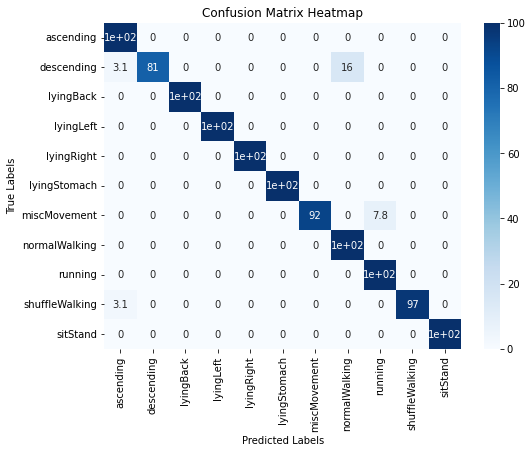

70/71 [0.14183437824249268, 0.9756410121917725] 0.8942310633793683


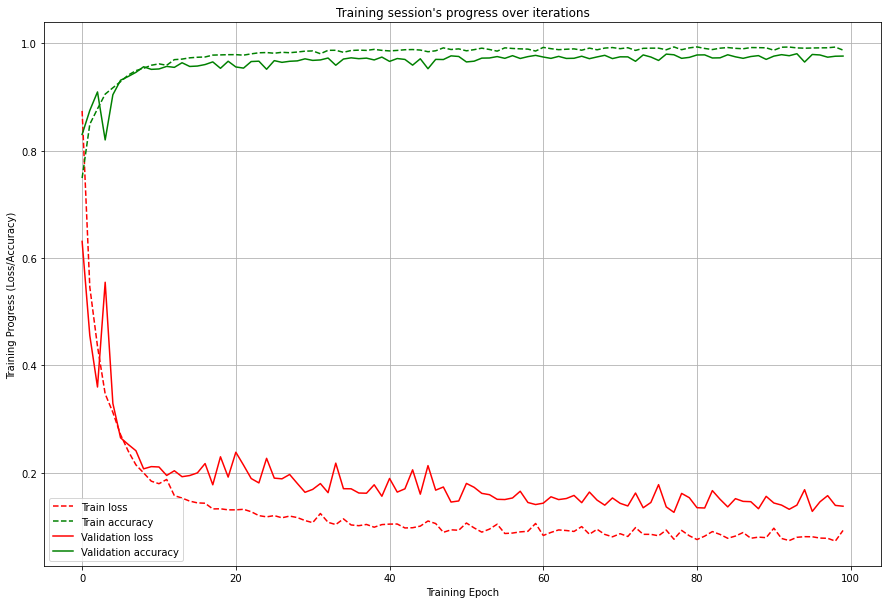

In [9]:
accuracies = []
histories = []

for i,student in enumerate(students):
    train_dataset = breatheNormalDataset[breatheNormalDataset.file_id != student]
    test_dataset = breatheNormalDataset[breatheNormalDataset.file_id == student]

    X_train, y_train = sliding_window(train_dataset, 'activity_label', 11)
    X_test, y_test = sliding_window(test_dataset, 'activity_label', 11)

    print(" ..after sliding and reshaping, train data: inputs {0}, targets {1}".format(X_train.shape, y_train.shape))
    print(" ..after sliding and reshaping, test data : inputs {0}, targets {1}".format(X_test.shape, y_test.shape))

    model = build_model(X_train)
    
#     early_stopping = EarlyStopping(monitor='val_loss', patience=5, restore_best_weights=True)

    history = model.fit(X_train, y_train, epochs = 100, validation_split = 0.20, batch_size = batch_size, verbose=1)#, callbacks=[early_stopping])
    accuracy = model.evaluate(X_test, y_test, verbose=0)
    
    pred_y = list(map(np.argmax, model.predict(X_test)))
    true_y = list(map(np.argmax, y_test))
    
    cm = confusion_matrix(true_y, pred_y)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=activity_label_dict, yticklabels=activity_label_dict)
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title("Confusion Matrix Heatmap")
    plt.show()

    accuracies.append(accuracy[1])
    histories.append(history)

    print(f'{i}/{len(students)}', accuracy, np.average(accuracies))

    plt.figure(figsize=(15,10))
    plt.plot(np.array(history.history['loss']), "r--", label = "Train loss")
    plt.plot(np.array(history.history['accuracy']), "g--", label = "Train accuracy")
    plt.plot(np.array(history.history['val_loss']), "r-", label = "Validation loss")
    plt.plot(np.array(history.history['val_accuracy']), "g-", label = "Validation accuracy")
    plt.title("Training session's progress over iterations")
    plt.legend(loc='lower left')
    plt.ylabel('Training Progress (Loss/Accuracy)')
    plt.xlabel('Training Epoch')
    # plt.ylim(0)
    plt.grid()
    plt.show()

In [75]:
np.average(accuracies)

0.9217240211258472

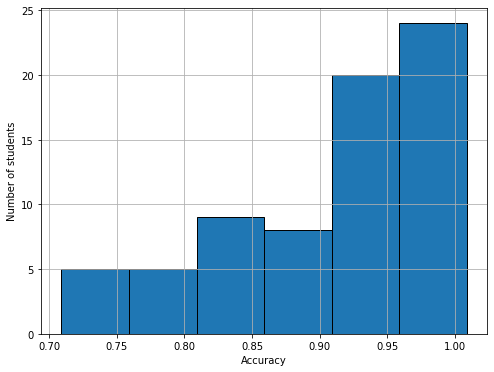

In [73]:
plt.figure(figsize=(8,6))
plt.hist(accuracies, bins=np.arange(min(accuracies), max(accuracies) + 0.05, 0.05), edgecolor='black')
plt.xlabel('Accuracy')
plt.ylabel('Number of students')
plt.grid()
plt.savefig('acc_spread_1.pdf')
plt.show()

In [20]:
train_loss = []
train_acc = []
val_loss = []
val_acc = []

for history in histories:
    if len(train_loss) == 0:
        train_loss = np.array(history.history['loss'])
        train_acc = np.array(history.history['loss'])
        val_loss = np.array(history.history['val_loss'])
        val_acc = np.array(history.history['val_accuracy'])
    else:
        train_loss = train_loss + np.array(history.history['loss'])
        train_acc = train_acc + np.array(history.history['accuracy'])
        val_loss = val_loss + np.array(history.history['val_loss'])
        val_acc = val_acc + np.array(history.history['val_accuracy'])

train_loss = train_loss/len(histories)
train_acc = train_acc/len(histories)
val_loss = val_loss/len(histories)
val_acc = val_acc/len(histories)

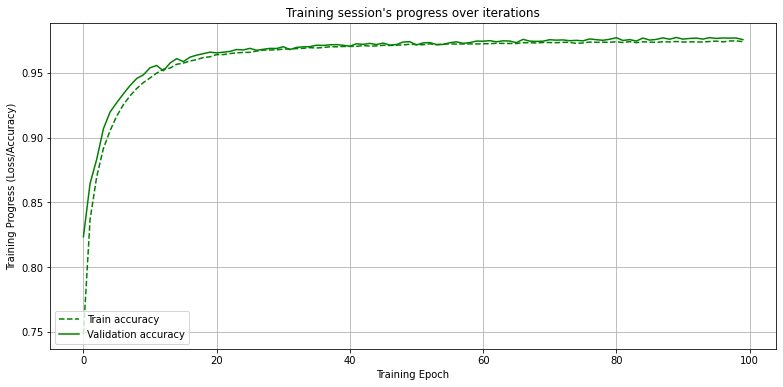

In [21]:
plt.figure(figsize=(13,6))
# plt.plot(train_loss, "r--", label = "Train loss")
plt.plot(train_acc, "g--", label = "Train accuracy")
# plt.plot(val_loss, "r-", label = "Validation loss")
plt.plot(val_acc, "g-", label = "Validation accuracy")
plt.title("Training session's progress over iterations")
plt.legend(loc='lower left')
plt.ylabel('Training Progress (Loss/Accuracy)')
plt.xlabel('Training Epoch')
# plt.ylim(0)
plt.grid()
# plt.savefig('avg_loo_acc_1.pdf')

plt.show()

# TASK 2/3 HELPERS

In [6]:
def build_model_activities(Xtrn):
    output_dim = 5
    epochs = 100
    dropout_rate = 0.3

    input_shape=(SLIDING_WINDOW_LENGTH, SENSOR_CHANNELS)

    # LSTM parameters
    n_neurons_lstm = 256
    n_neurons = 64

    # optimization parameters
    lr = 0.001
    decay = 1e-6

    normalizer = Normalization()
    normalizer.adapt(Xtrn)

    model = Sequential()
    model.add(normalizer)
    model.add(Bidirectional(LSTM(units = n_neurons_lstm, activation='relu',
                                 kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)), input_shape=(3,125)))
    model.add(Dropout(dropout_rate))
    model.add(Dense(n_neurons, activation='relu', kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)))
    model.add(Dense(output_dim, activation='softmax', kernel_regularizer=l2(0.0002), bias_regularizer=l2(0.0002)))
    adam = Adam(learning_rate=lr, weight_decay=decay)
    model.compile(loss='categorical_crossentropy', optimizer=adam, metrics=['accuracy'])
    model.summary()
    
    return model

In [7]:
def sliding_window(X, n_output):
    step = 10
    segments = []
    act_labels = []
    sub_labels = []

    for i in range(0, len(X)-SLIDING_WINDOW_LENGTH, step):
        xs = X['accel_x'].values[i: i+SLIDING_WINDOW_LENGTH]
        ys = X['accel_y'].values[i: i+SLIDING_WINDOW_LENGTH]
        zs = X['accel_z'].values[i: i+SLIDING_WINDOW_LENGTH]
        
        d_act = Counter(X['activity_label'][i: i+SLIDING_WINDOW_LENGTH])
        d_sub = Counter(X['sub_activity_label'][i: i+SLIDING_WINDOW_LENGTH])

        if len(d_act)==1 and len(d_sub)==1:
            label_act = list(d_act.keys())[0]
            label_act = [0]*label_act+[1]+[0]*(5-label_act-1)
            act_labels.append(label_act)
            
            label_sub = list(d_sub.keys())[0]
            label_sub = [0]*label_sub+[1]+[0]*(n_output-label_sub-1)
            sub_labels.append(label_sub)
            
            segments.append([xs, ys, zs])
            

    reshaped_segments = np.asarray(segments)
    random_indices = np.random.permutation(len(reshaped_segments))
    
    act_segments = reshaped_segments
    reshaped_segments = reshaped_segments.reshape(-1, SLIDING_WINDOW_LENGTH, SENSOR_CHANNELS)
    act_labels = np.asarray(act_labels)
    sub_labels = np.asarray(sub_labels)

    return act_segments[random_indices], reshaped_segments[random_indices], act_labels[random_indices], sub_labels[random_indices]

# Task 2

In [6]:
SENSOR_CHANNELS = 3
SLIDING_WINDOW_LENGTH = 125

In [33]:
task2Dataset = dataset[dataset['activity'].isin(stationary_dict)].copy()
task2Dataset = task2Dataset[task2Dataset.sub_activity_label != 3]
task2Dataset['activity_label'] = task2Dataset['activity'].replace(stationary_dict)
students = task2Dataset.file_id.unique()
task2Dataset

,timestamp,accel_x,accel_y,accel_z,gyro_x,gyro_y,gyro_z,file_id,class,activity,sub_activity,activity_label,sub_activity_label
0,1697605965,-0.596436,-0.181213,0.870056,0.468750,-0.296875,0.015625,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
1,1697606005,-0.593994,-0.189026,0.880310,0.937500,-0.390625,-0.125000,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
2,1697606045,-0.591064,-0.172668,0.883484,1.125000,-0.500000,-0.140625,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
3,1697606085,-0.580322,-0.176819,0.875671,-0.234375,-0.781250,0.031250,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
4,1697606125,-0.598145,-0.189758,0.882263,0.421875,-1.031250,-0.031250,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,1697636165,-0.170898,-0.940979,0.119324,7.390625,-7.250000,-1.765625,98,sitStand_hyperventilating,sitStand,hyperventilating,4,2
756,1697636205,-0.153809,-0.949524,0.121521,20.218750,0.171875,-2.187500,98,sitStand_hyperventilating,sitStand,hyperventilating,4,2
757,1697636245,-0.188965,-0.937073,0.094666,7.968750,-16.953125,-0.421875,98,sitStand_hyperventilating,sitStand,hyperventilating,4,2
758,1697636285,-0.133789,-0.999573,0.073181,2.015625,-10.078125,1.562500,98,sitStand_hyperventilating,sitStand,hyperventilating,4,2


In [37]:
y = list(task2Dataset.activity_label)
class_labels = np.unique(y)
class_weights = compute_class_weight('balanced', class_labels, y)
class_weights_dict_act = {class_label: weight for class_label, weight in zip(class_labels, class_weights)}
class_weights_dict_act

{0: 1.2137093555804717,
 1: 1.1987499452553603,
 2: 1.200567701186157,
 3: 1.1969526403578368,
 4: 0.5975561301027011}

In [48]:
def build_model2():
    model = Sequential()
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(125, 3)))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.3))
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.3))
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.3))
    model.add(Flatten())
    model.add(Dense(units=64, activation='relu'))
    model.add(Dense(units=3, activation='softmax'))
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.summary()
    
    return model



Model: "sequential_9"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_7 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_7 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_13 (Dropout)        (None, 512)               0         
                                                                 
 dense_18 (Dense)            (None, 64)                32832     
                                                                 
 dense_19 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 81549

495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9659 - val_loss: 0.0880 - val_accuracy: 0.9665
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0890 - accuracy: 0.9658 - val_loss: 0.0792 - val_accuracy: 0.9672
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0889 - accuracy: 0.9651 - val_loss: 0.0926 - val_accuracy: 0.9642
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0894 - accuracy: 0.9654 - val_loss: 0.0753 - val_accuracy: 0.9703
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0906 - accuracy: 0.9648 - val_loss: 0.0630 - val_accuracy: 0.9754
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0877 - accuracy: 0.9656 - val_loss: 0.0607 - val_accuracy: 0.9764
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0852 - accuracy: 0.9675 - val_loss: 0.0590 - val_accuracy: 0.976

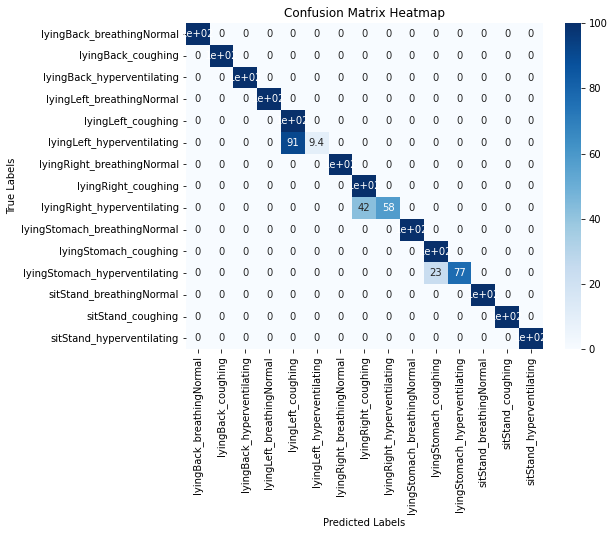

0/71 0.9131944444444444 0.9131944444444444


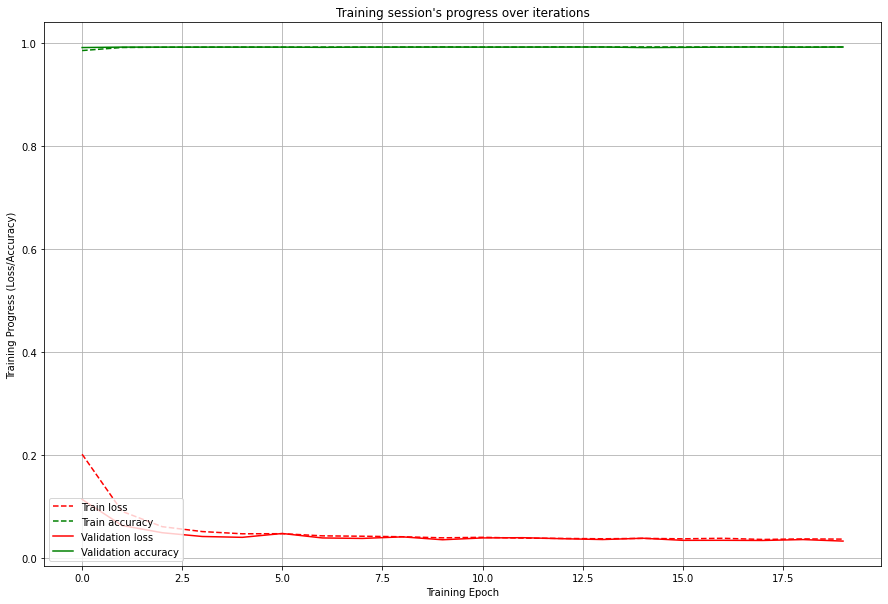

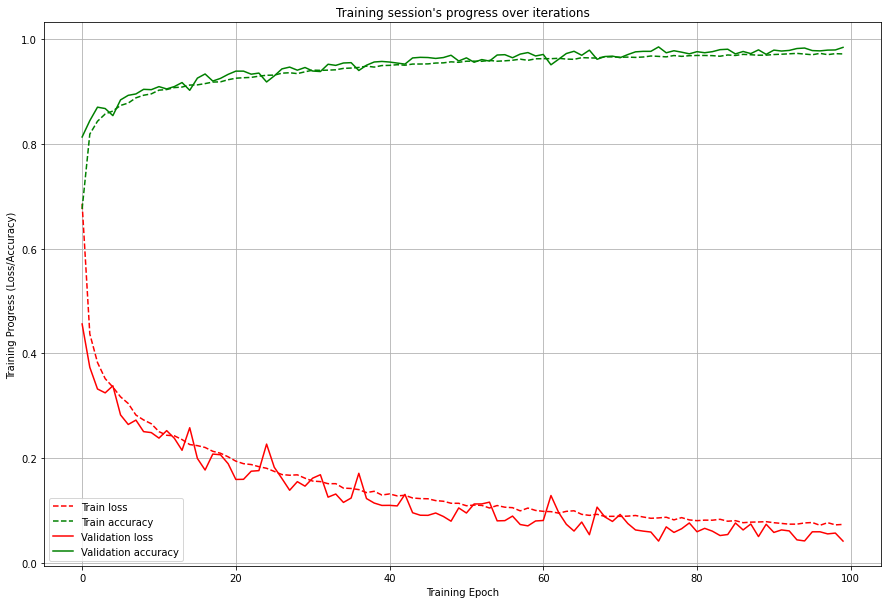

Model: "sequential_11"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_8 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_8 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_17 (Dropout)        (None, 512)               0         
                                                                 
 dense_22 (Dense)            (None, 64)                32832     
                                                                 
 dense_23 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0909 - accuracy: 0.9644 - val_loss: 0.0652 - val_accuracy: 0.9747
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0922 - accuracy: 0.9649 - val_loss: 0.0865 - val_accuracy: 0.9678
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0919 - accuracy: 0.9649 - val_loss: 0.0682 - val_accuracy: 0.9745
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0920 - accuracy: 0.9647 - val_loss: 0.0796 - val_accuracy: 0.9671
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0899 - accuracy: 0.9653 - val_loss: 0.0498 - val_accuracy: 0.9828
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0921 - accuracy: 0.9639 - val_loss: 0.0660 - val_accuracy: 0.9741
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0882 - accuracy: 0.9659 - val_loss: 0.0703 - val_accuracy: 0.973

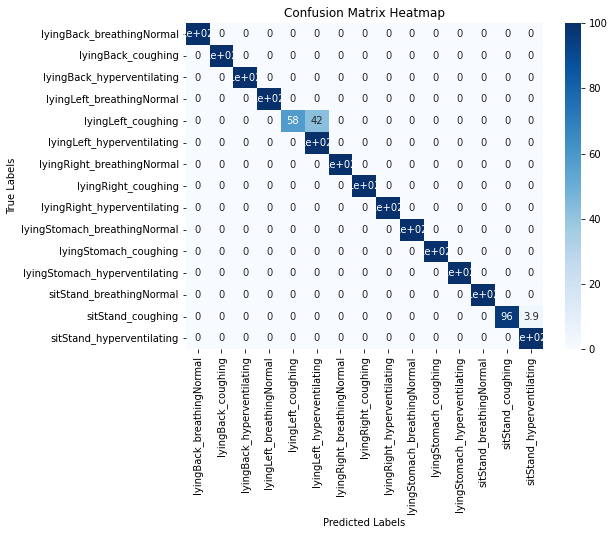

1/71 0.9722222222222222 0.9427083333333333


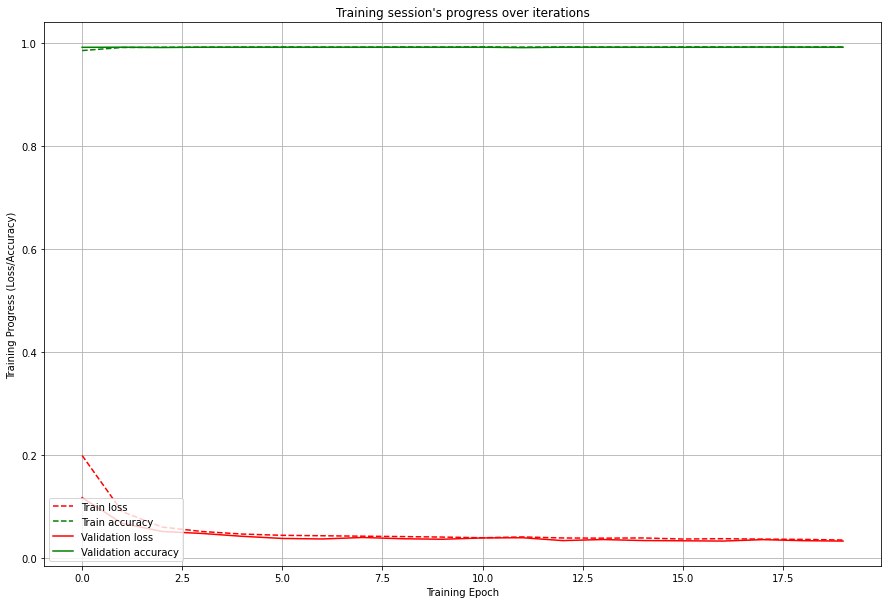

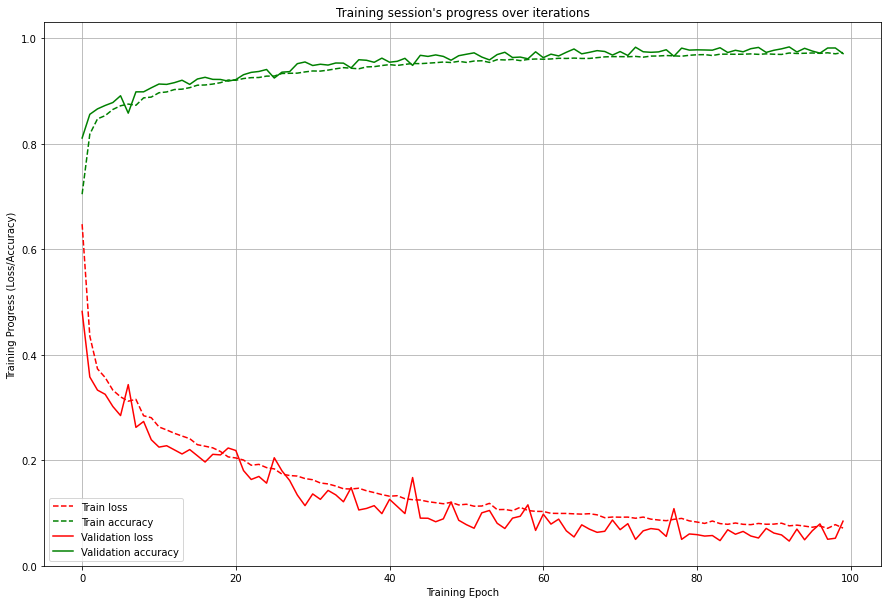

Model: "sequential_13"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_9 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_9 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_21 (Dropout)        (None, 512)               0         
                                                                 
 dense_26 (Dense)            (None, 64)                32832     
                                                                 
 dense_27 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0919 - accuracy: 0.9642 - val_loss: 0.1101 - val_accuracy: 0.9602
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0893 - accuracy: 0.9650 - val_loss: 0.1218 - val_accuracy: 0.9568
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0903 - accuracy: 0.9645 - val_loss: 0.0958 - val_accuracy: 0.9661
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0878 - accuracy: 0.9659 - val_loss: 0.0928 - val_accuracy: 0.9668
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0879 - accuracy: 0.9655 - val_loss: 0.0828 - val_accuracy: 0.9684
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0861 - accuracy: 0.9670 - val_loss: 0.0866 - val_accuracy: 0.9672
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0890 - accuracy: 0.9661 - val_loss: 0.0913 - val_accuracy: 0.968

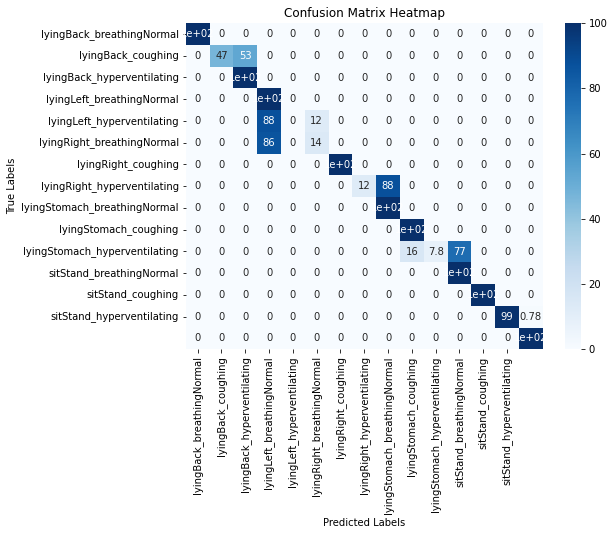

2/71 0.7664930555555556 0.8839699074074074


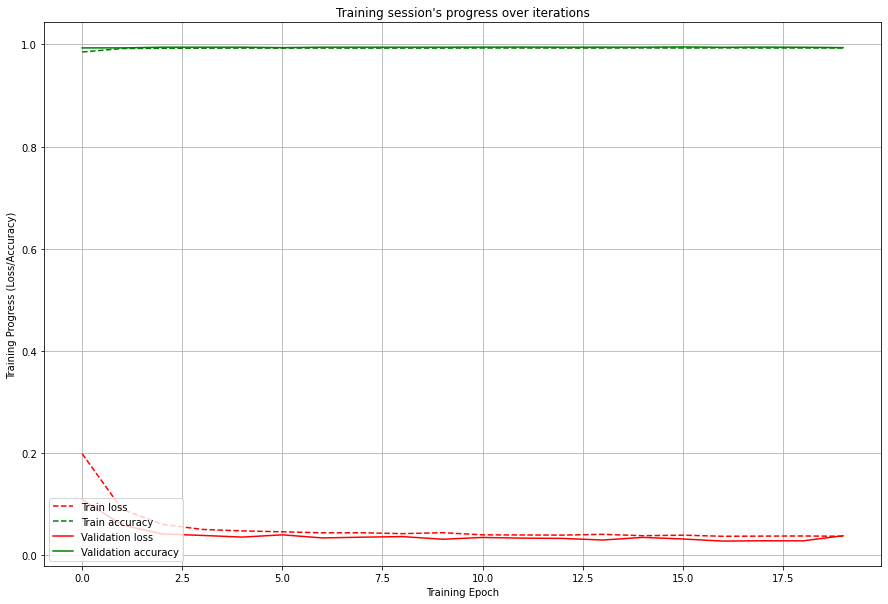

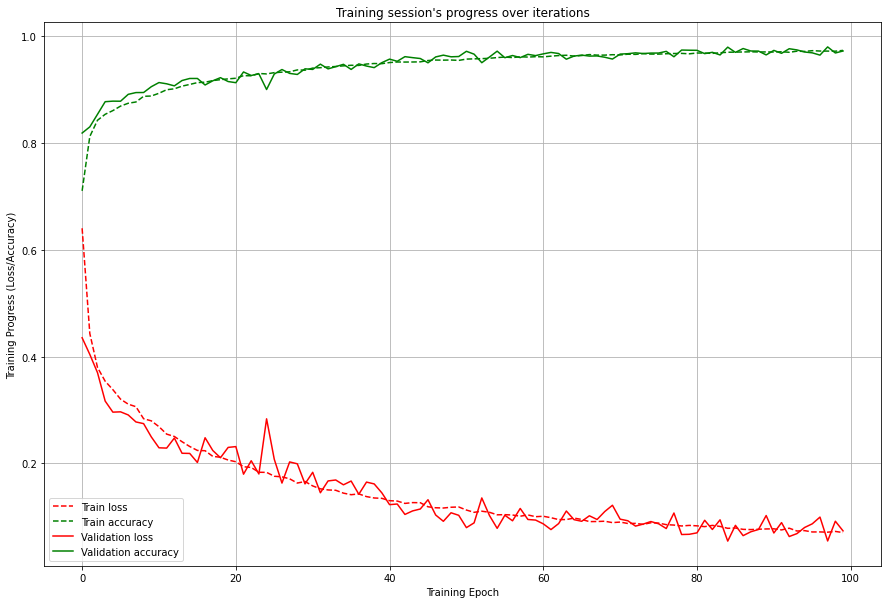

Model: "sequential_15"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_10 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_10 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_25 (Dropout)        (None, 512)               0         
                                                                 
 dense_30 (Dense)            (None, 64)                32832     
                                                                 
 dense_31 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0876 - accuracy: 0.9669 - val_loss: 0.0730 - val_accuracy: 0.9730
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0874 - accuracy: 0.9664 - val_loss: 0.0710 - val_accuracy: 0.9725
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0883 - accuracy: 0.9658 - val_loss: 0.0829 - val_accuracy: 0.9665
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0869 - accuracy: 0.9659 - val_loss: 0.1044 - val_accuracy: 0.9640
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0858 - accuracy: 0.9663 - val_loss: 0.0659 - val_accuracy: 0.9734
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0838 - accuracy: 0.9678 - val_loss: 0.0734 - val_accuracy: 0.9737
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0818 - accuracy: 0.9684 - val_loss: 0.0999 - val_accuracy: 0.959

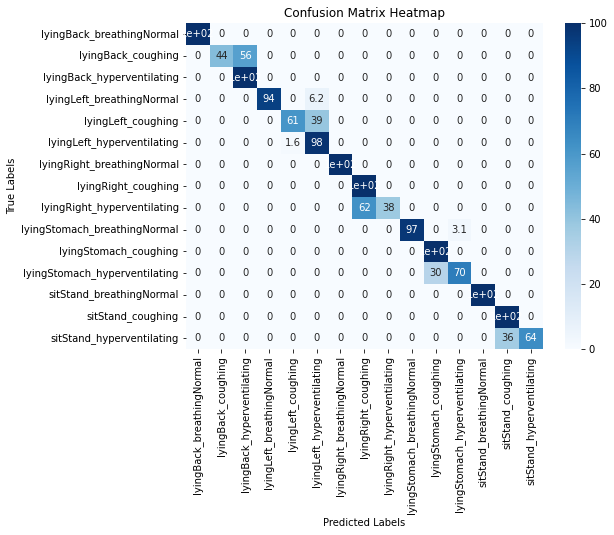

3/71 0.8498263888888888 0.8754340277777778


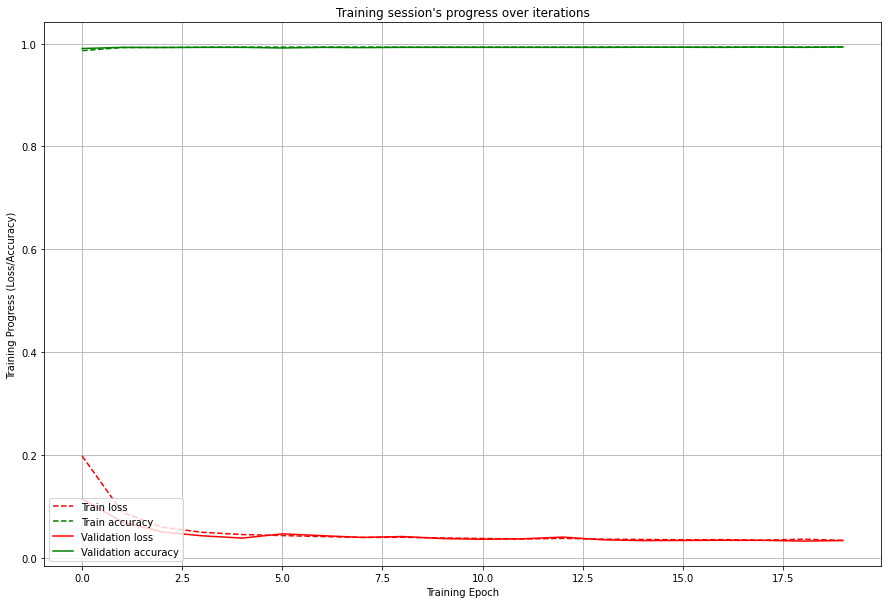

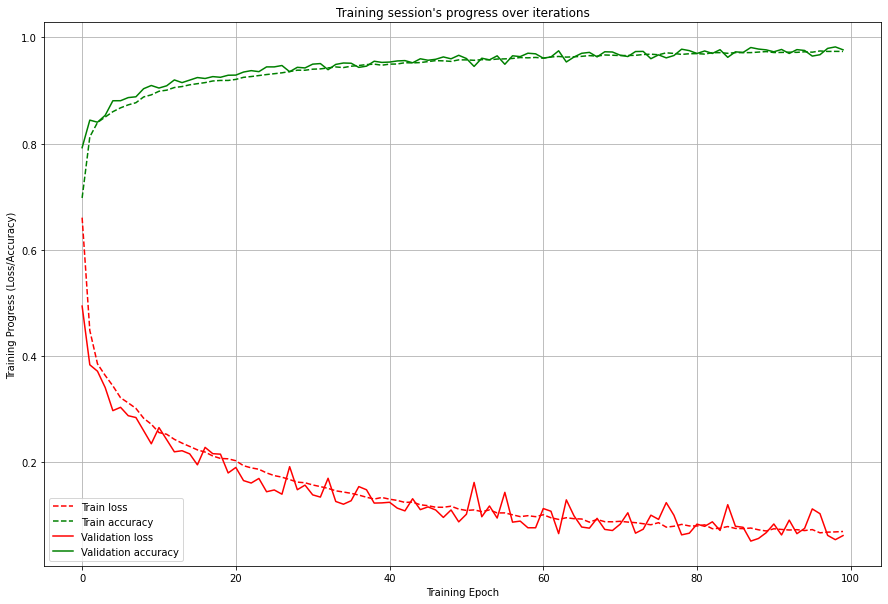

Model: "sequential_17"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_11 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_11 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_29 (Dropout)        (None, 512)               0         
                                                                 
 dense_34 (Dense)            (None, 64)                32832     
                                                                 
 dense_35 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

494/494 [==============================] - 5s 10ms/step - loss: 0.0960 - accuracy: 0.9629 - val_loss: 0.0783 - val_accuracy: 0.9695
Epoch 70/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0937 - accuracy: 0.9641 - val_loss: 0.0803 - val_accuracy: 0.9701
Epoch 71/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0923 - accuracy: 0.9644 - val_loss: 0.1102 - val_accuracy: 0.9565
Epoch 72/100
494/494 [==============================] - 5s 10ms/step - loss: 0.0916 - accuracy: 0.9638 - val_loss: 0.0704 - val_accuracy: 0.9719
Epoch 73/100
494/494 [==============================] - 5s 10ms/step - loss: 0.0906 - accuracy: 0.9645 - val_loss: 0.0737 - val_accuracy: 0.9714
Epoch 74/100
494/494 [==============================] - 5s 10ms/step - loss: 0.0896 - accuracy: 0.9657 - val_loss: 0.0804 - val_accuracy: 0.9696
Epoch 75/100
494/494 [==============================] - 5s 10ms/step - loss: 0.0890 - accuracy: 0.9655 - val_loss: 0.0756 - val_accuracy: 0.968

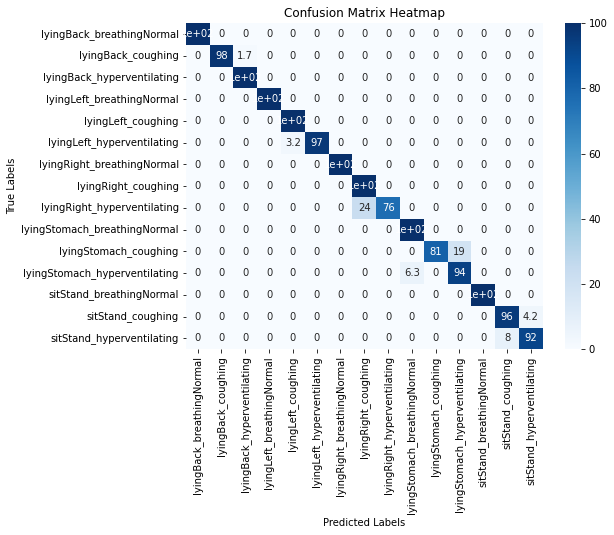

4/71 0.9560931899641577 0.8915658602150538


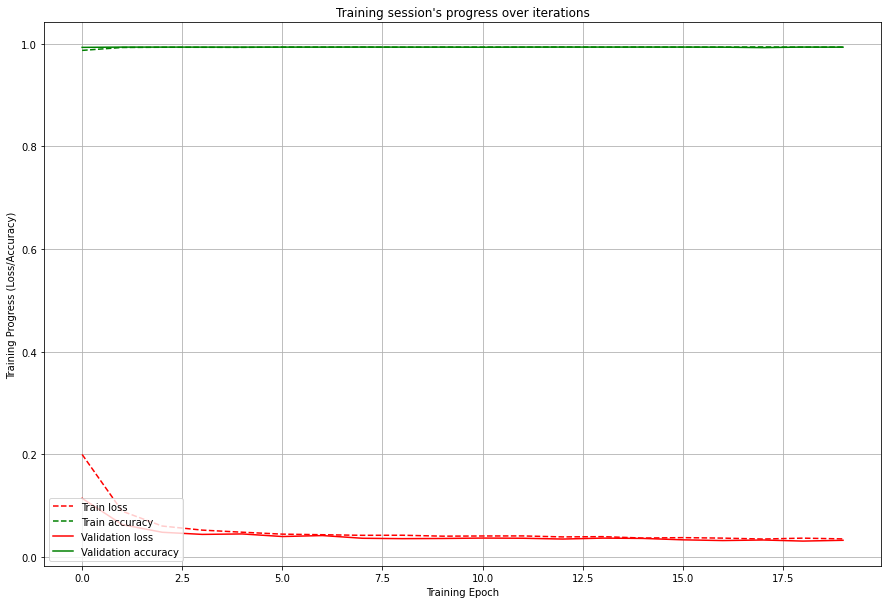

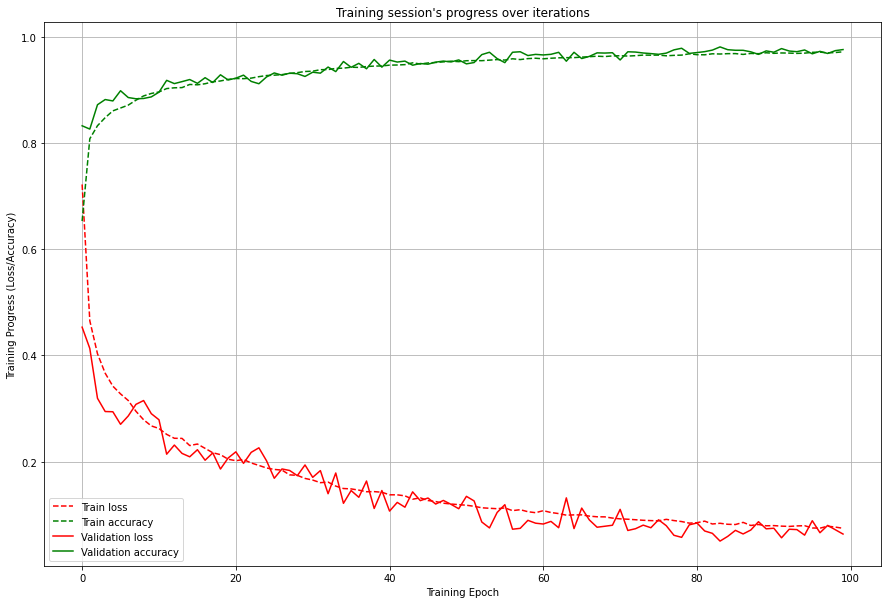

Model: "sequential_19"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_12 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_12 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_33 (Dropout)        (None, 512)               0         
                                                                 
 dense_38 (Dense)            (None, 64)                32832     
                                                                 
 dense_39 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

496/496 [==============================] - 5s 10ms/step - loss: 0.0903 - accuracy: 0.9652 - val_loss: 0.0791 - val_accuracy: 0.9686
Epoch 70/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0913 - accuracy: 0.9644 - val_loss: 0.1085 - val_accuracy: 0.9613
Epoch 71/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0873 - accuracy: 0.9667 - val_loss: 0.0727 - val_accuracy: 0.9715
Epoch 72/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0873 - accuracy: 0.9663 - val_loss: 0.0863 - val_accuracy: 0.9696
Epoch 73/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0885 - accuracy: 0.9662 - val_loss: 0.0880 - val_accuracy: 0.9655
Epoch 74/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0859 - accuracy: 0.9665 - val_loss: 0.0830 - val_accuracy: 0.9682
Epoch 75/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0841 - accuracy: 0.9677 - val_loss: 0.1014 - val_accuracy: 0.966

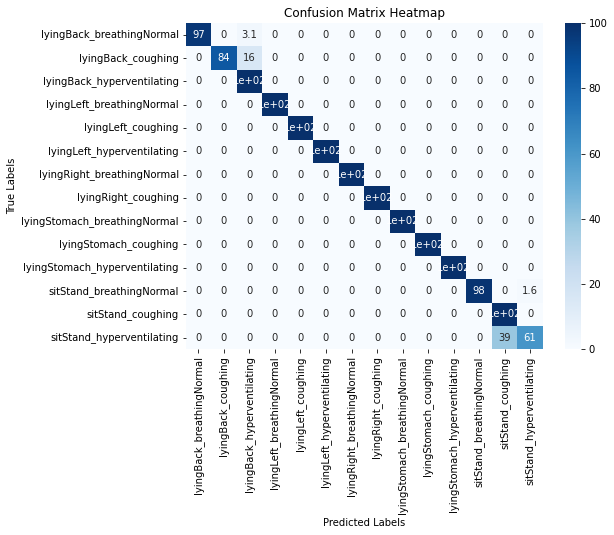

5/71 0.9434865900383141 0.9002193151855972


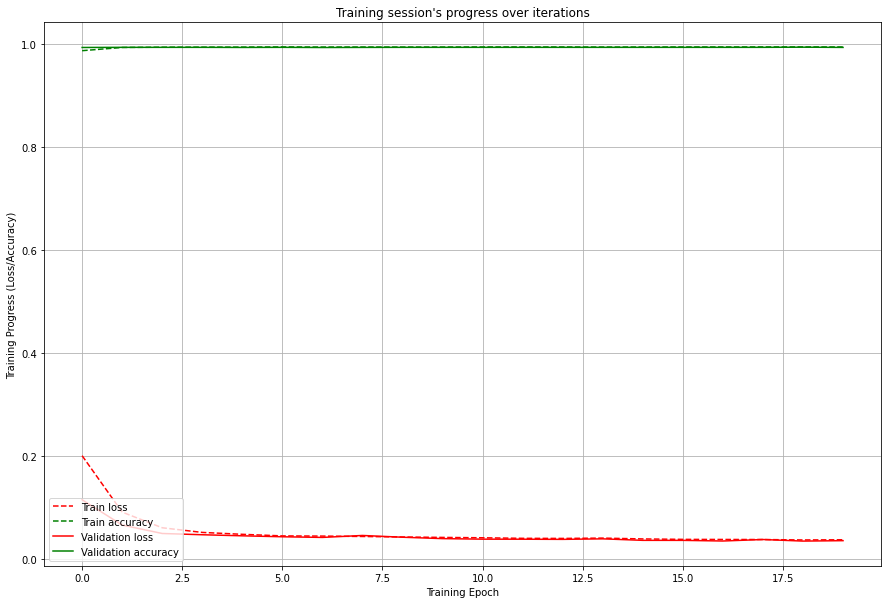

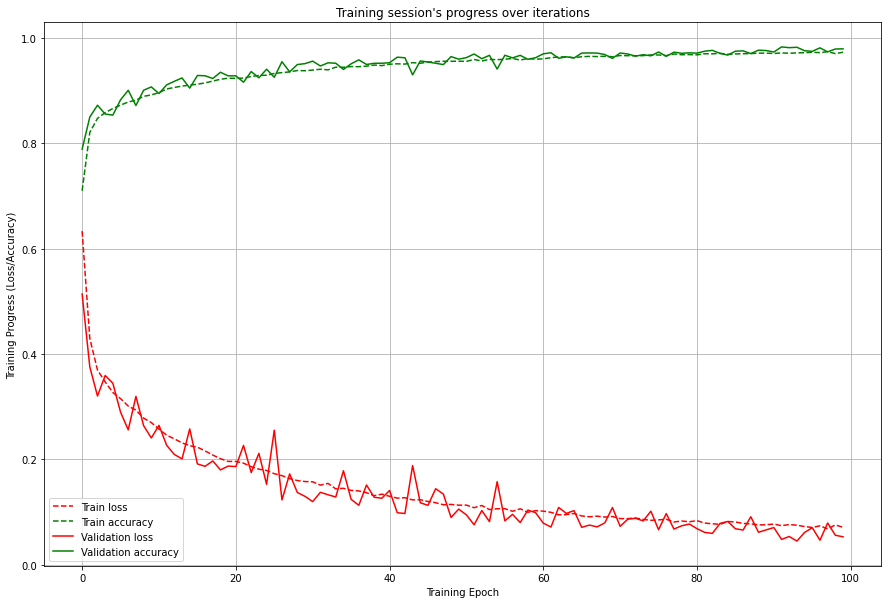

Model: "sequential_21"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_13 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_13 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_37 (Dropout)        (None, 512)               0         
                                                                 
 dense_42 (Dense)            (None, 64)                32832     
                                                                 
 dense_43 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9665 - val_loss: 0.0759 - val_accuracy: 0.9709
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0887 - accuracy: 0.9655 - val_loss: 0.0909 - val_accuracy: 0.9650
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0896 - accuracy: 0.9659 - val_loss: 0.0755 - val_accuracy: 0.9693
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0883 - accuracy: 0.9667 - val_loss: 0.0790 - val_accuracy: 0.9688
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9668 - val_loss: 0.0583 - val_accuracy: 0.9781
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0883 - accuracy: 0.9655 - val_loss: 0.0987 - val_accuracy: 0.9634
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0853 - accuracy: 0.9673 - val_loss: 0.0636 - val_accuracy: 0.974

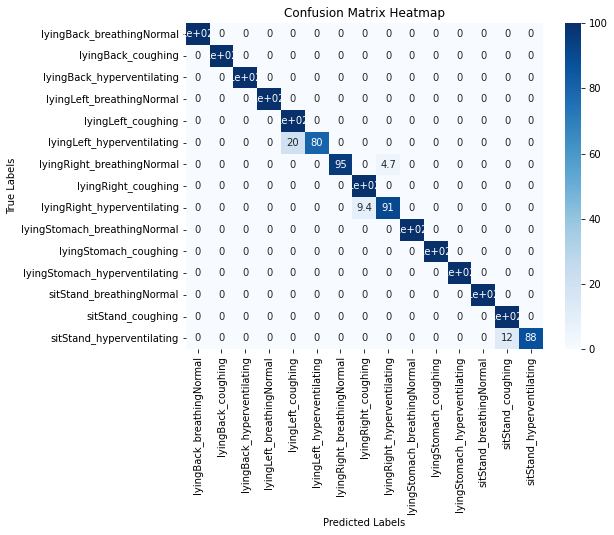

6/71 0.9669852302345786 0.9097573030497373


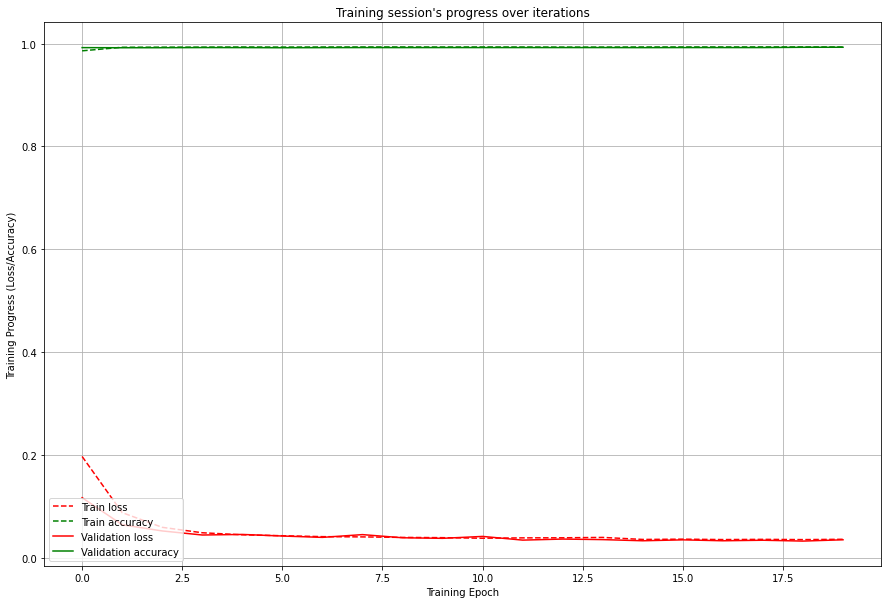

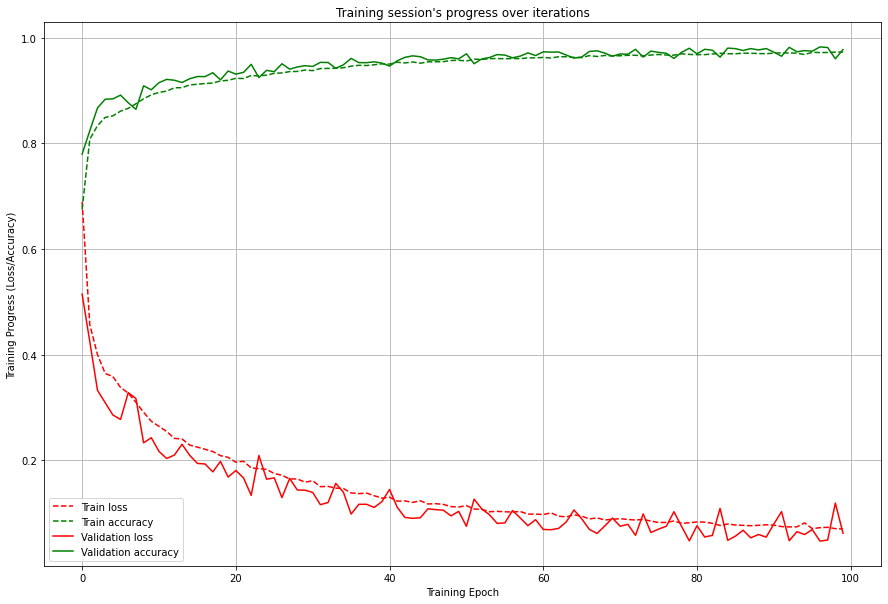

Model: "sequential_23"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_14 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_14 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_41 (Dropout)        (None, 512)               0         
                                                                 
 dense_46 (Dense)            (None, 64)                32832     
                                                                 
 dense_47 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0926 - accuracy: 0.9650 - val_loss: 0.0974 - val_accuracy: 0.9630
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0920 - accuracy: 0.9643 - val_loss: 0.1354 - val_accuracy: 0.9567
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0943 - accuracy: 0.9628 - val_loss: 0.1425 - val_accuracy: 0.9514
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0882 - accuracy: 0.9651 - val_loss: 0.0880 - val_accuracy: 0.9664
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0836 - accuracy: 0.9671 - val_loss: 0.0784 - val_accuracy: 0.9703
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0915 - accuracy: 0.9649 - val_loss: 0.0752 - val_accuracy: 0.9713
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0890 - accuracy: 0.9655 - val_loss: 0.0679 - val_accuracy: 0.972

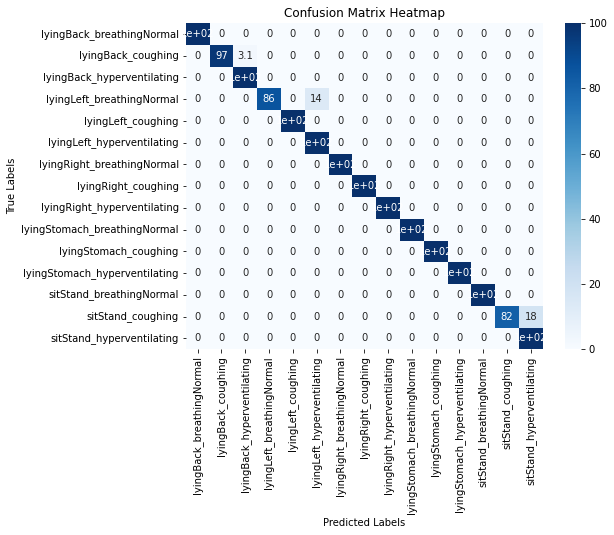

7/71 0.9703138252756573 0.9173268683279773


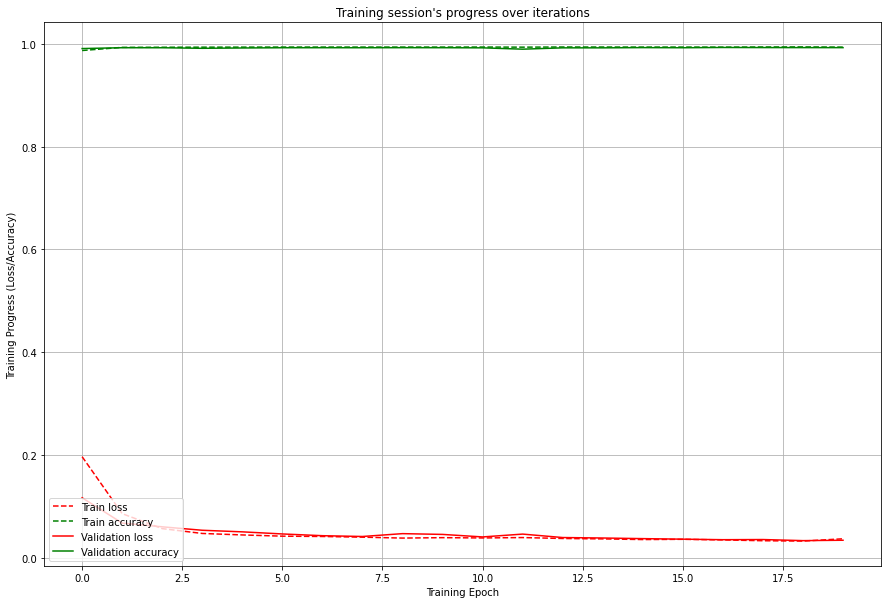

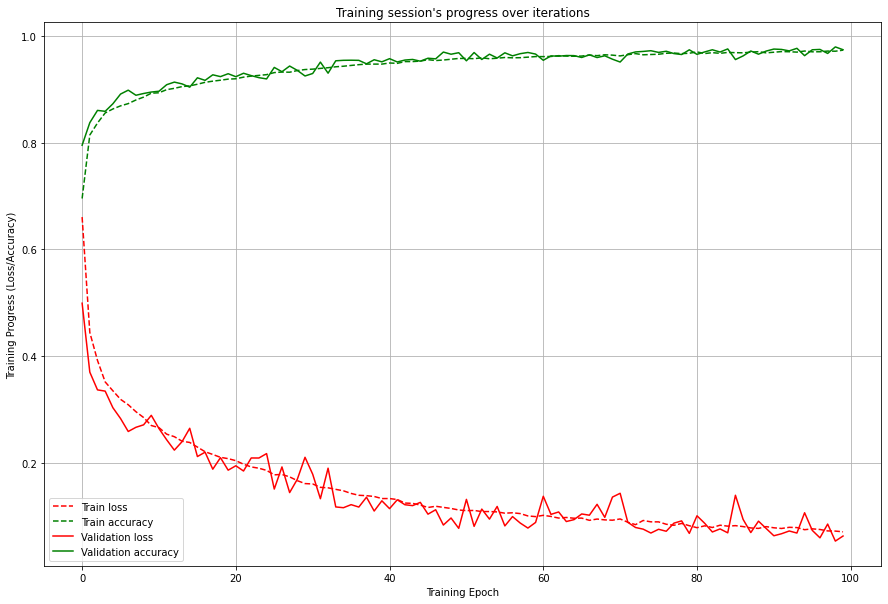

Model: "sequential_25"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_15 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_15 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_45 (Dropout)        (None, 512)               0         
                                                                 
 dense_50 (Dense)            (None, 64)                32832     
                                                                 
 dense_51 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0907 - accuracy: 0.9651 - val_loss: 0.0656 - val_accuracy: 0.9739
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0901 - accuracy: 0.9642 - val_loss: 0.0667 - val_accuracy: 0.9736
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0880 - accuracy: 0.9665 - val_loss: 0.0884 - val_accuracy: 0.9663
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0895 - accuracy: 0.9660 - val_loss: 0.0559 - val_accuracy: 0.9763
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0874 - accuracy: 0.9667 - val_loss: 0.0614 - val_accuracy: 0.9759
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0865 - accuracy: 0.9664 - val_loss: 0.0644 - val_accuracy: 0.9747
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0886 - accuracy: 0.9660 - val_loss: 0.0701 - val_accuracy: 0.971

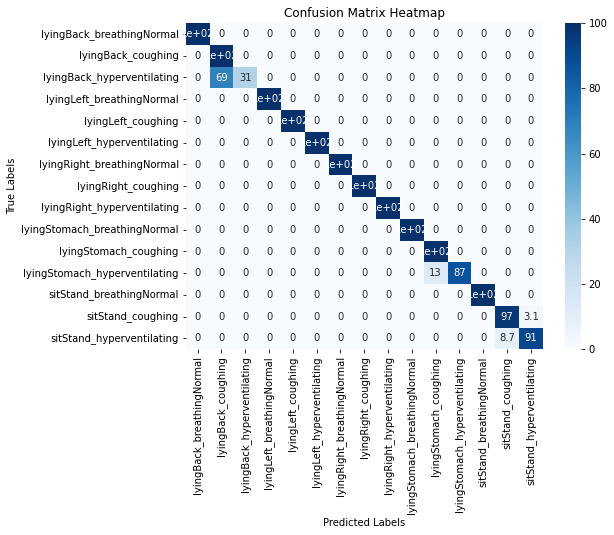

8/71 0.9409691629955947 0.9199537899577126


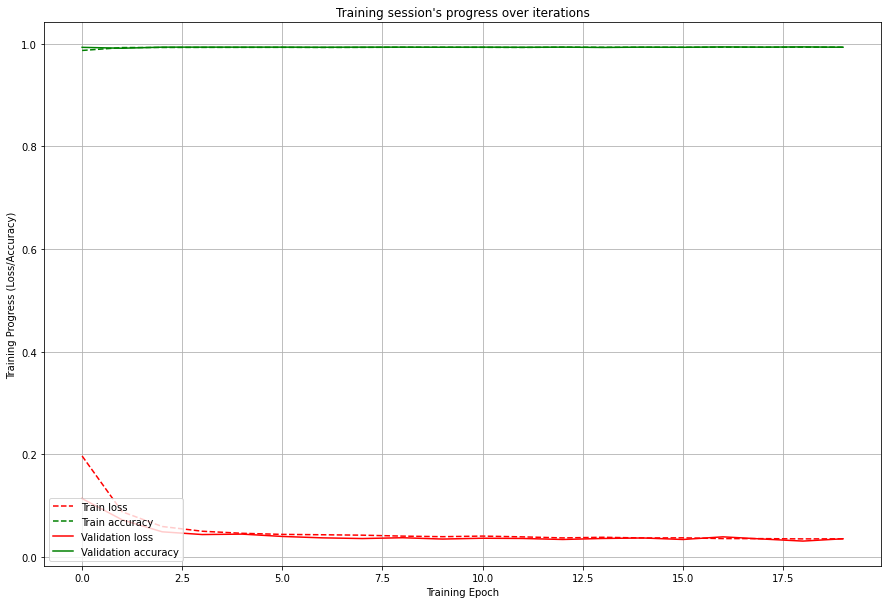

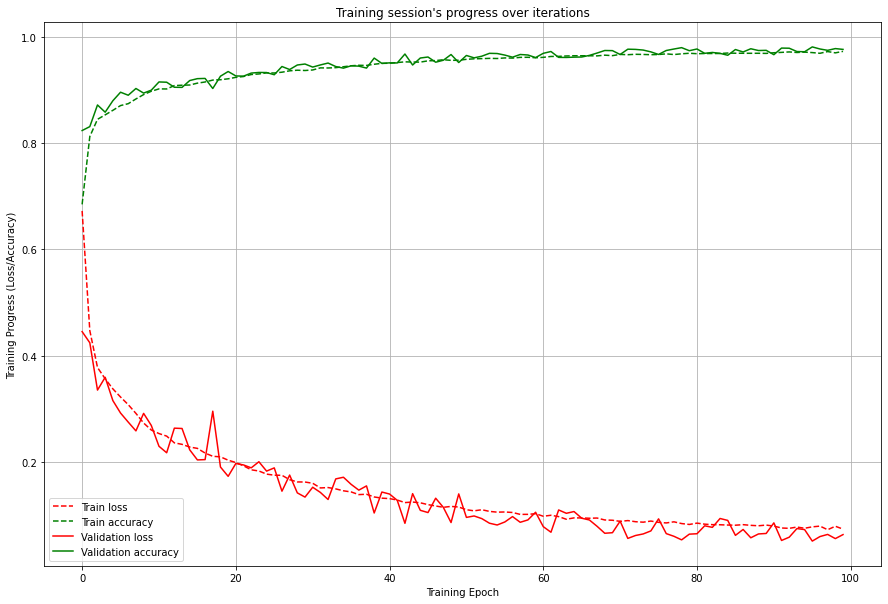

Model: "sequential_27"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_16 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_16 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_49 (Dropout)        (None, 512)               0         
                                                                 
 dense_54 (Dense)            (None, 64)                32832     
                                                                 
 dense_55 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0920 - accuracy: 0.9641 - val_loss: 0.0725 - val_accuracy: 0.9719
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0944 - accuracy: 0.9638 - val_loss: 0.0832 - val_accuracy: 0.9668
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0873 - accuracy: 0.9668 - val_loss: 0.0901 - val_accuracy: 0.9638
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0922 - accuracy: 0.9643 - val_loss: 0.0801 - val_accuracy: 0.9681
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0859 - accuracy: 0.9670 - val_loss: 0.0753 - val_accuracy: 0.9705
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0911 - accuracy: 0.9646 - val_loss: 0.0617 - val_accuracy: 0.9752
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0892 - accuracy: 0.9650 - val_loss: 0.1301 - val_accuracy: 0.954

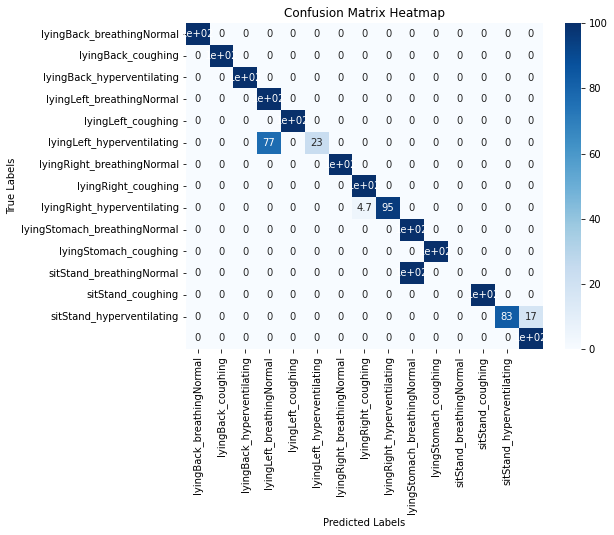

9/71 0.8802083333333334 0.9159792442952748


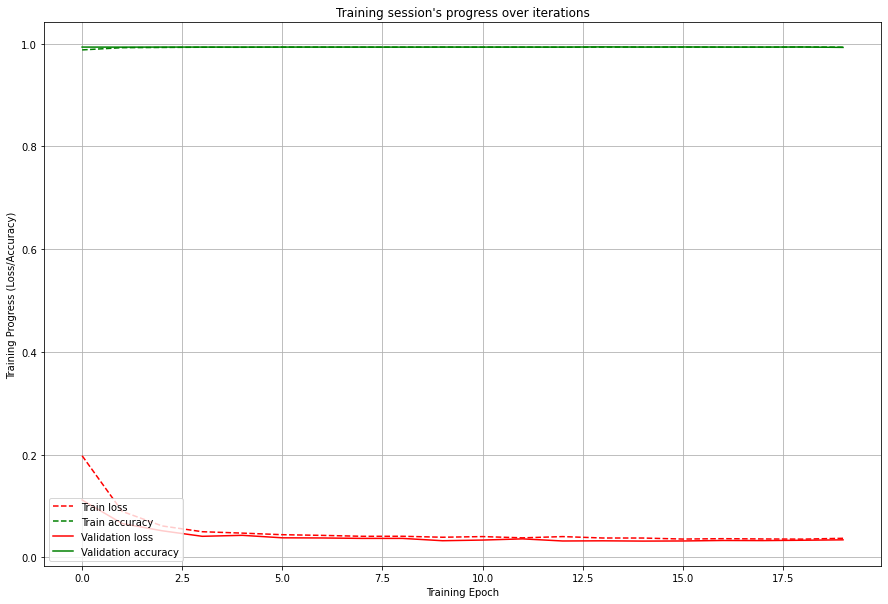

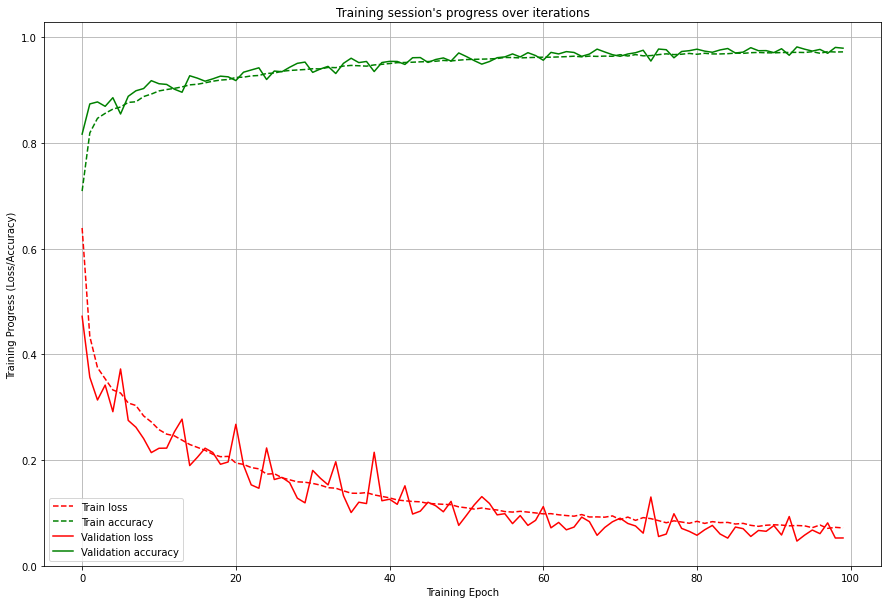

Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_17 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_17 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_53 (Dropout)        (None, 512)               0         
                                                                 
 dense_58 (Dense)            (None, 64)                32832     
                                                                 
 dense_59 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0864 - accuracy: 0.9663 - val_loss: 0.0640 - val_accuracy: 0.9750
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0864 - accuracy: 0.9664 - val_loss: 0.0618 - val_accuracy: 0.9751
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0873 - accuracy: 0.9665 - val_loss: 0.0835 - val_accuracy: 0.9674
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0873 - accuracy: 0.9665 - val_loss: 0.0776 - val_accuracy: 0.9712
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0855 - accuracy: 0.9670 - val_loss: 0.0601 - val_accuracy: 0.9757
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0804 - accuracy: 0.9687 - val_loss: 0.0555 - val_accuracy: 0.9782
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0823 - accuracy: 0.9683 - val_loss: 0.0569 - val_accuracy: 0.977

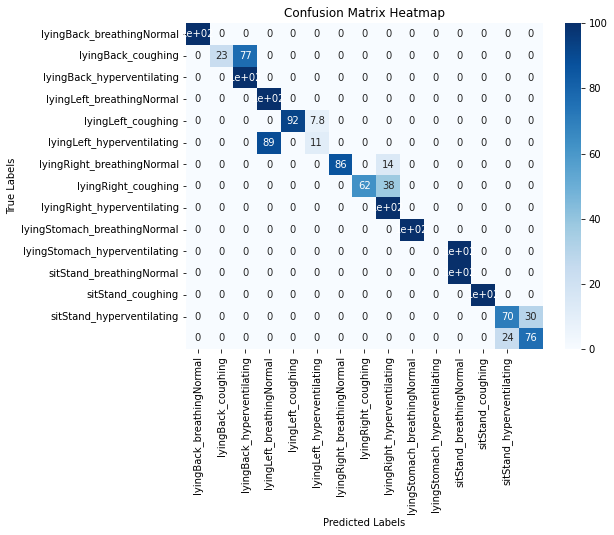

10/71 0.7595486111111112 0.901758277642169


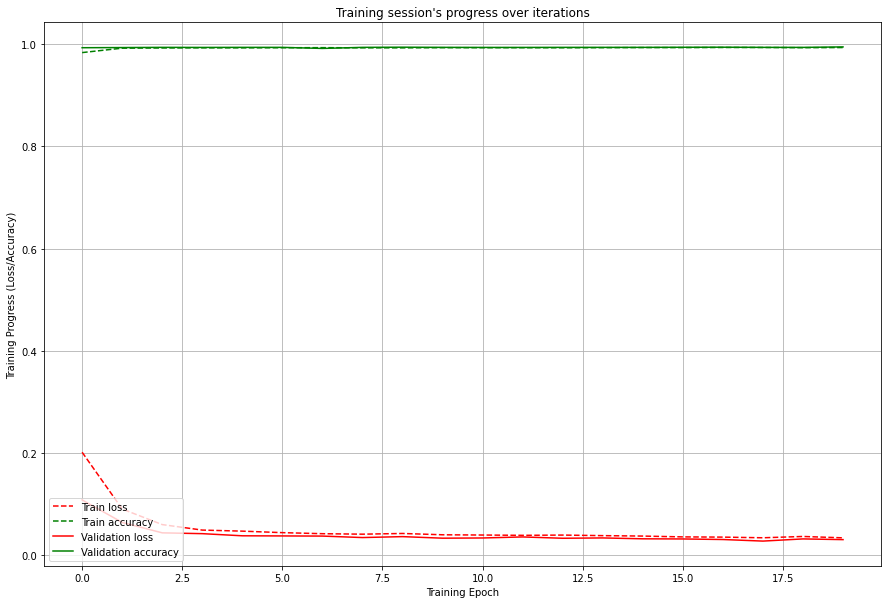

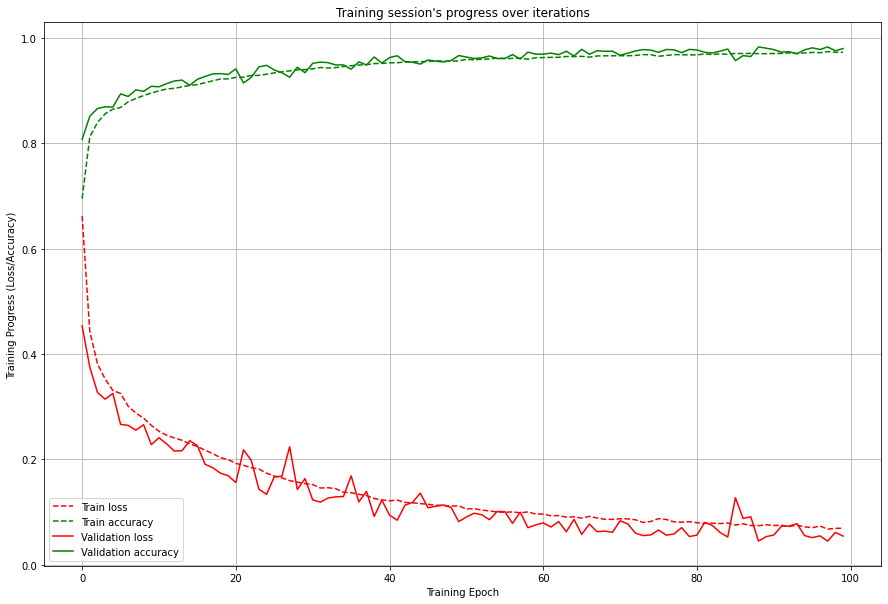

Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_18 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_18 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_57 (Dropout)        (None, 512)               0         
                                                                 
 dense_62 (Dense)            (None, 64)                32832     
                                                                 
 dense_63 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 10ms/step - loss: 0.0898 - accuracy: 0.9652 - val_loss: 0.0586 - val_accuracy: 0.9770
Epoch 70/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0912 - accuracy: 0.9642 - val_loss: 0.0660 - val_accuracy: 0.9747
Epoch 71/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0896 - accuracy: 0.9647 - val_loss: 0.0897 - val_accuracy: 0.9643
Epoch 72/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0906 - accuracy: 0.9655 - val_loss: 0.0818 - val_accuracy: 0.9679
Epoch 73/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9663 - val_loss: 0.0796 - val_accuracy: 0.9707
Epoch 74/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0840 - accuracy: 0.9679 - val_loss: 0.0721 - val_accuracy: 0.9711
Epoch 75/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0871 - accuracy: 0.9660 - val_loss: 0.0667 - val_accuracy: 0.975

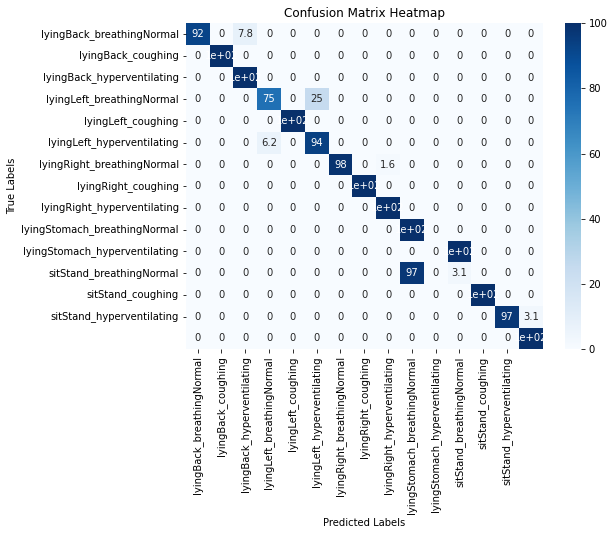

11/71 0.8643478260869565 0.8986407400125679


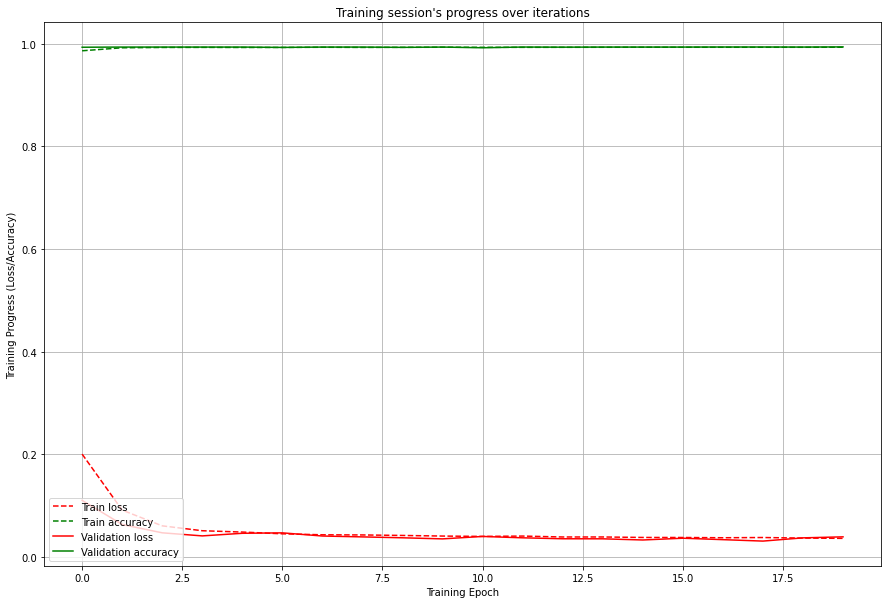

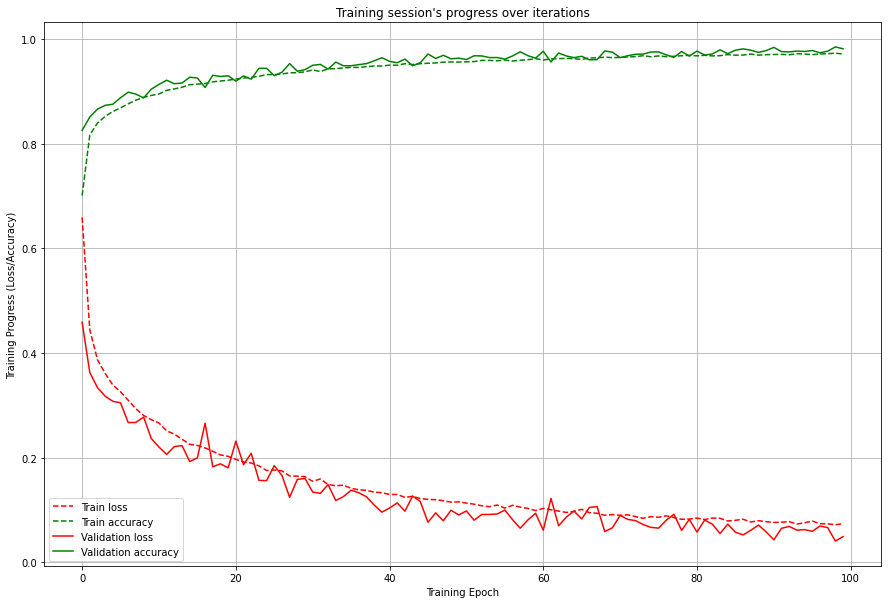

Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_19 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_19 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_61 (Dropout)        (None, 512)               0         
                                                                 
 dense_66 (Dense)            (None, 64)                32832     
                                                                 
 dense_67 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0933 - accuracy: 0.9649 - val_loss: 0.0678 - val_accuracy: 0.9747
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0896 - accuracy: 0.9649 - val_loss: 0.1042 - val_accuracy: 0.9631
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0874 - accuracy: 0.9655 - val_loss: 0.0654 - val_accuracy: 0.9763
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0885 - accuracy: 0.9656 - val_loss: 0.0508 - val_accuracy: 0.9808
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9658 - val_loss: 0.0609 - val_accuracy: 0.9768
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0834 - accuracy: 0.9681 - val_loss: 0.0569 - val_accuracy: 0.9793
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0858 - accuracy: 0.9668 - val_loss: 0.0785 - val_accuracy: 0.971

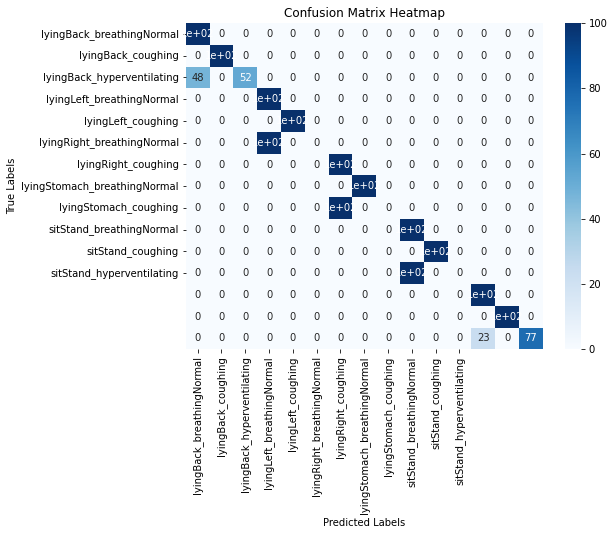

12/71 0.7785588752196837 0.8894036734900383


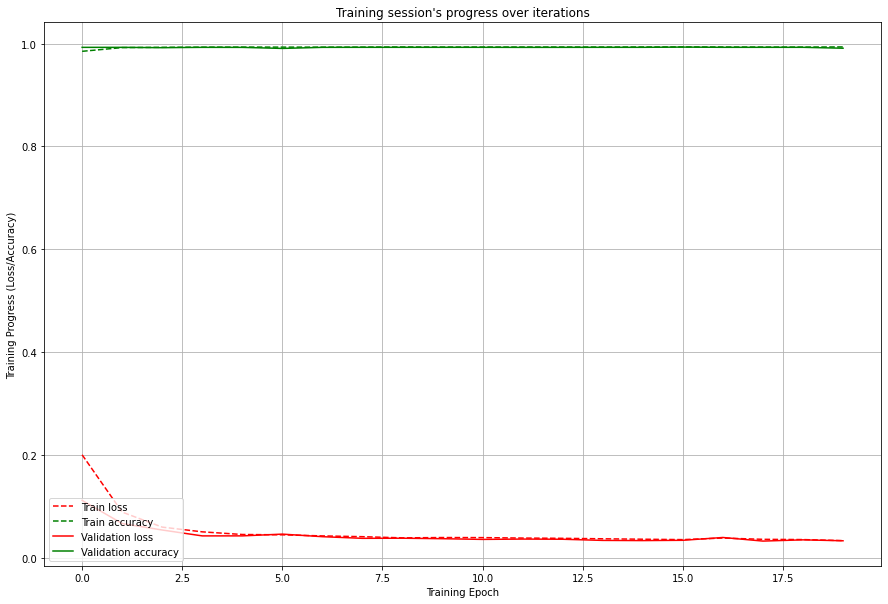

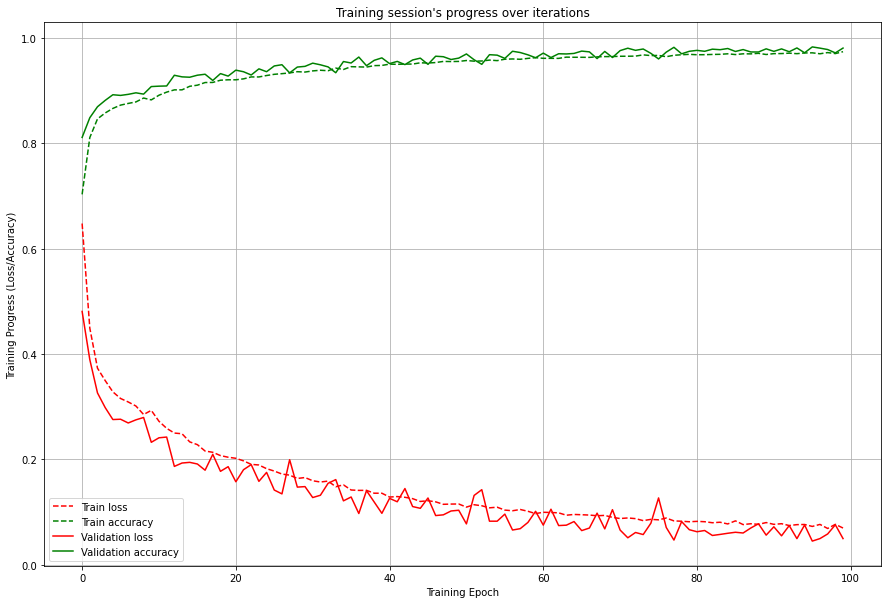

Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_20 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_20 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_65 (Dropout)        (None, 512)               0         
                                                                 
 dense_70 (Dense)            (None, 64)                32832     
                                                                 
 dense_71 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0961 - accuracy: 0.9631 - val_loss: 0.0754 - val_accuracy: 0.9709
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0933 - accuracy: 0.9640 - val_loss: 0.0862 - val_accuracy: 0.9675
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0946 - accuracy: 0.9635 - val_loss: 0.1234 - val_accuracy: 0.9576
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0958 - accuracy: 0.9627 - val_loss: 0.0785 - val_accuracy: 0.9699
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0919 - accuracy: 0.9648 - val_loss: 0.0959 - val_accuracy: 0.9646
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0924 - accuracy: 0.9637 - val_loss: 0.0769 - val_accuracy: 0.9720
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0928 - accuracy: 0.9643 - val_loss: 0.0624 - val_accuracy: 0.976

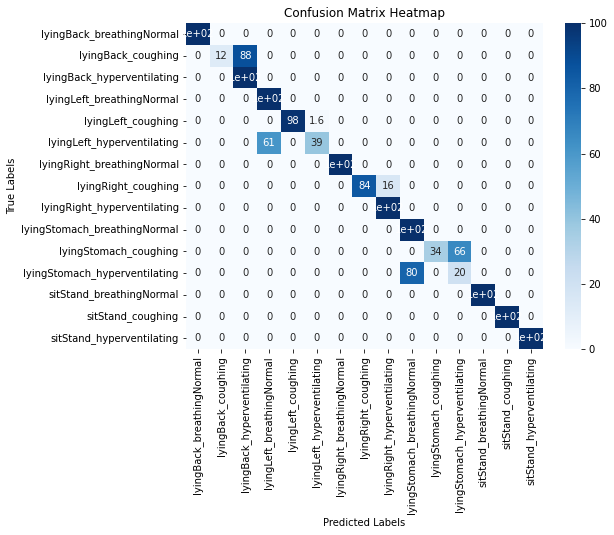

13/71 0.8272569444444444 0.884964621415353


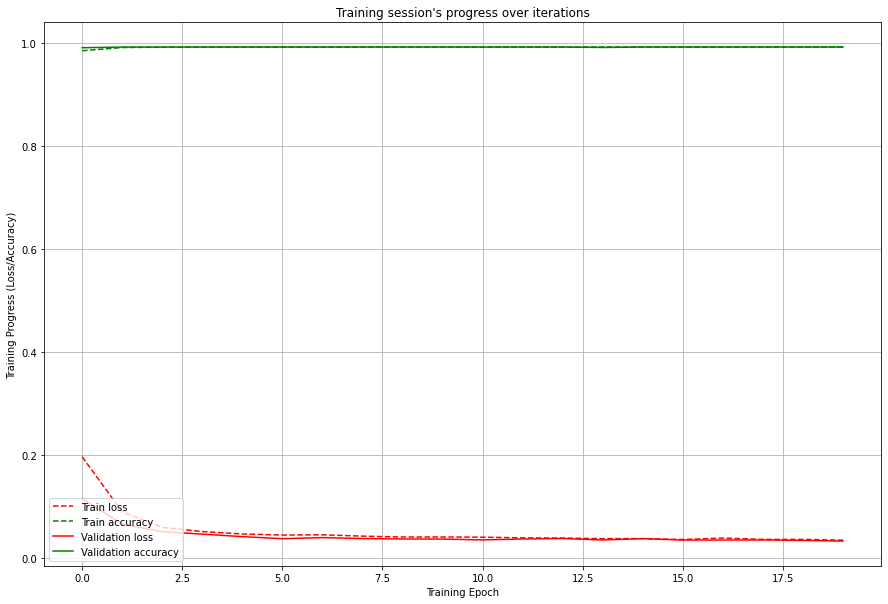

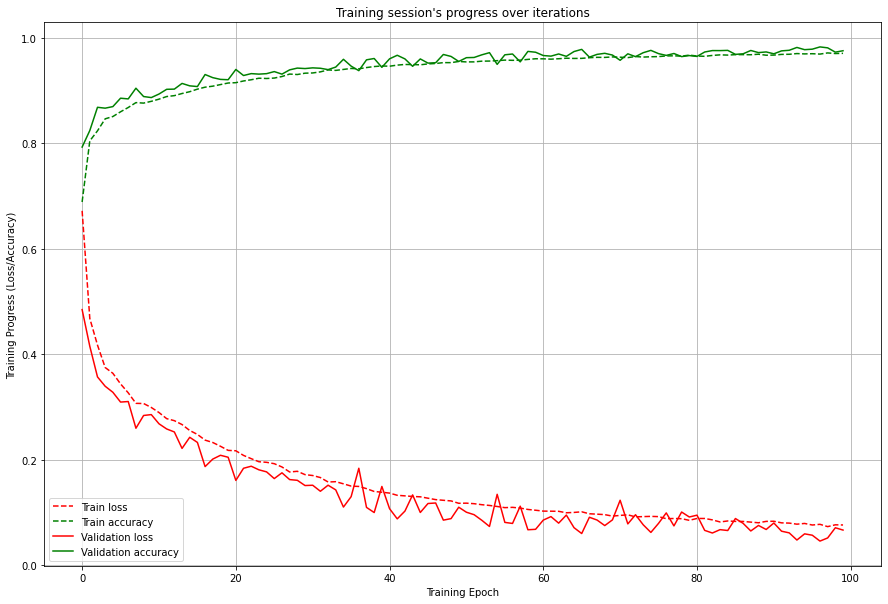

Model: "sequential_37"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_21 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_21 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_69 (Dropout)        (None, 512)               0         
                                                                 
 dense_74 (Dense)            (None, 64)                32832     
                                                                 
 dense_75 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 10ms/step - loss: 0.0886 - accuracy: 0.9659 - val_loss: 0.0811 - val_accuracy: 0.9681
Epoch 70/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0912 - accuracy: 0.9647 - val_loss: 0.0898 - val_accuracy: 0.9664
Epoch 71/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0878 - accuracy: 0.9666 - val_loss: 0.0919 - val_accuracy: 0.9666
Epoch 72/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9664 - val_loss: 0.0754 - val_accuracy: 0.9699
Epoch 73/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0910 - accuracy: 0.9650 - val_loss: 0.0829 - val_accuracy: 0.9675
Epoch 74/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0855 - accuracy: 0.9665 - val_loss: 0.0796 - val_accuracy: 0.9688
Epoch 75/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0885 - accuracy: 0.9658 - val_loss: 0.0771 - val_accuracy: 0.970

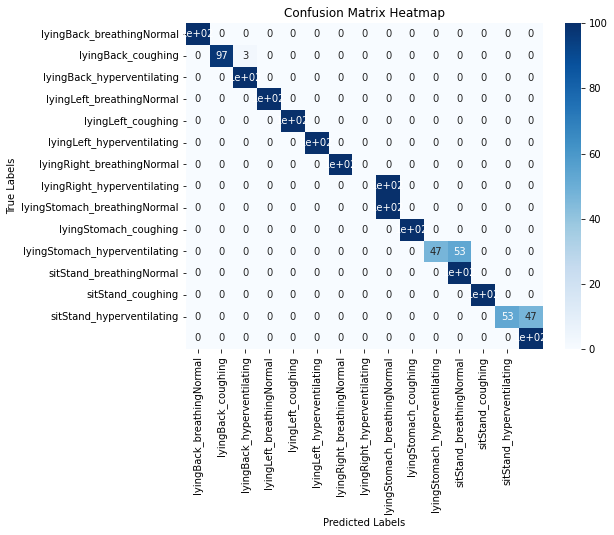

14/71 0.8608470181503889 0.8833567811976888


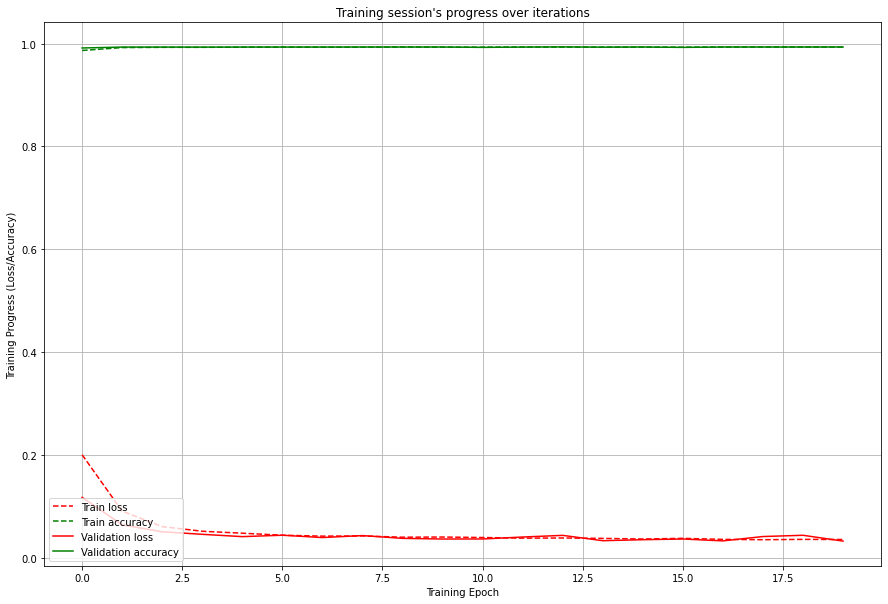

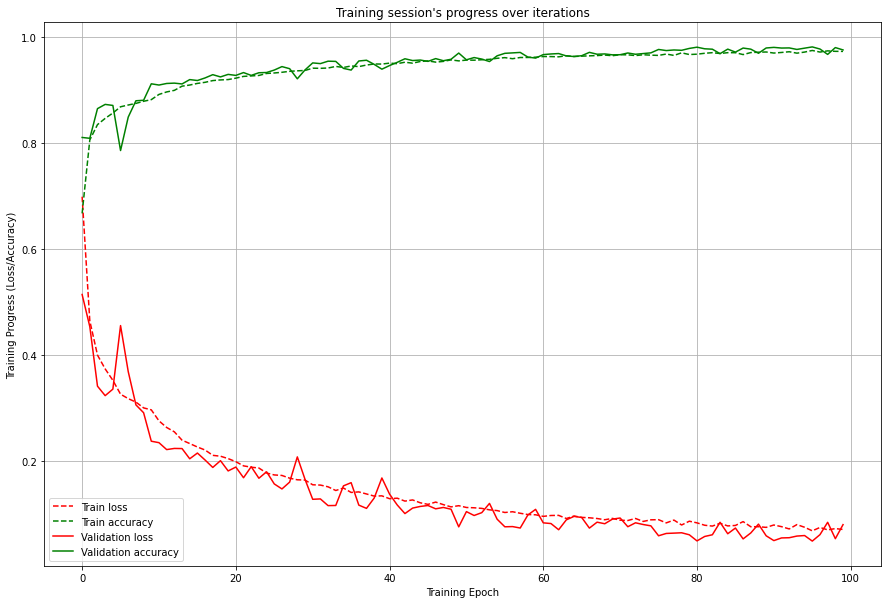

Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_22 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_22 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_73 (Dropout)        (None, 512)               0         
                                                                 
 dense_78 (Dense)            (None, 64)                32832     
                                                                 
 dense_79 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0917 - accuracy: 0.9644 - val_loss: 0.0837 - val_accuracy: 0.9681
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0877 - accuracy: 0.9657 - val_loss: 0.0760 - val_accuracy: 0.9707
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0899 - accuracy: 0.9660 - val_loss: 0.0689 - val_accuracy: 0.9730
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0870 - accuracy: 0.9664 - val_loss: 0.1007 - val_accuracy: 0.9623
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0915 - accuracy: 0.9650 - val_loss: 0.0735 - val_accuracy: 0.9711
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0899 - accuracy: 0.9648 - val_loss: 0.0962 - val_accuracy: 0.9635
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0868 - accuracy: 0.9664 - val_loss: 0.0693 - val_accuracy: 0.973

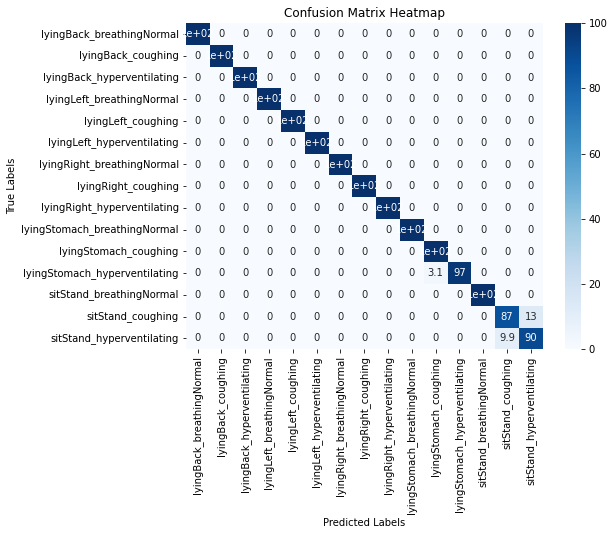

15/71 0.9727195225916454 0.888941952534811


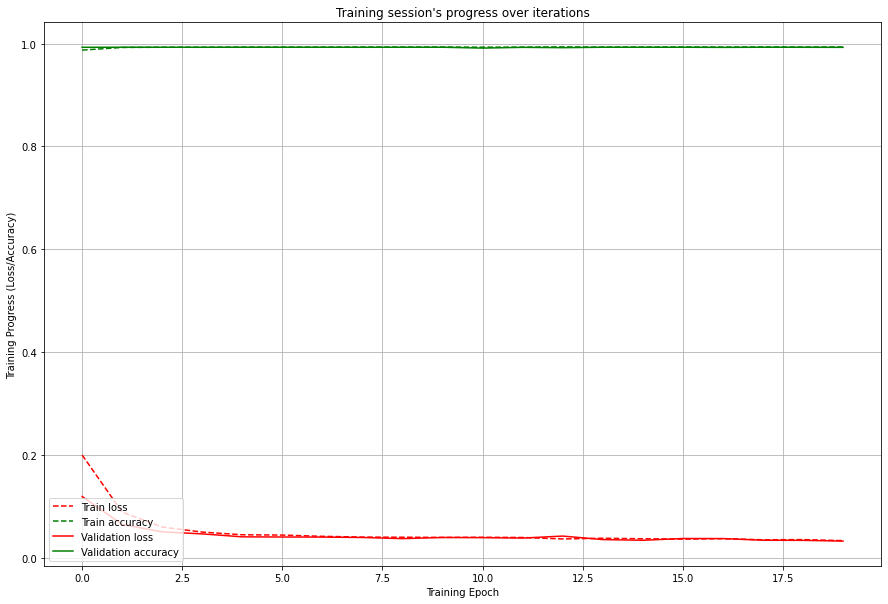

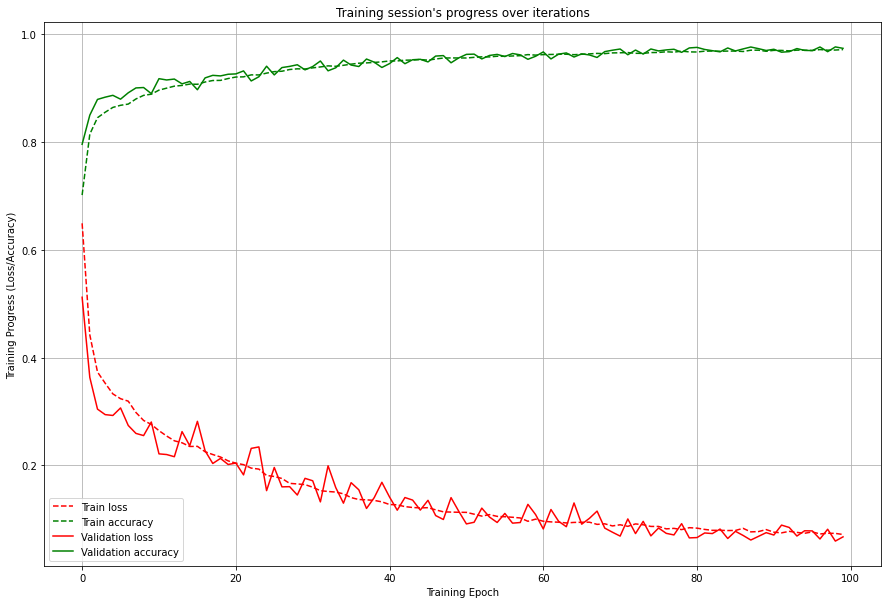

Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_23 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_23 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_77 (Dropout)        (None, 512)               0         
                                                                 
 dense_82 (Dense)            (None, 64)                32832     
                                                                 
 dense_83 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0864 - accuracy: 0.9670 - val_loss: 0.0852 - val_accuracy: 0.9675
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0899 - accuracy: 0.9654 - val_loss: 0.0649 - val_accuracy: 0.9749
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0898 - accuracy: 0.9647 - val_loss: 0.0738 - val_accuracy: 0.9732
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0877 - accuracy: 0.9663 - val_loss: 0.0501 - val_accuracy: 0.9815
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0843 - accuracy: 0.9672 - val_loss: 0.0556 - val_accuracy: 0.9793
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0853 - accuracy: 0.9672 - val_loss: 0.0627 - val_accuracy: 0.9758
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0871 - accuracy: 0.9664 - val_loss: 0.0691 - val_accuracy: 0.974

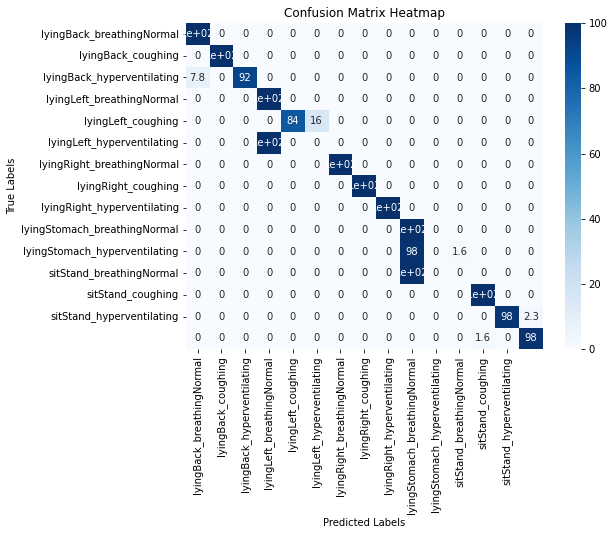

16/71 0.8159722222222222 0.8846496154575999


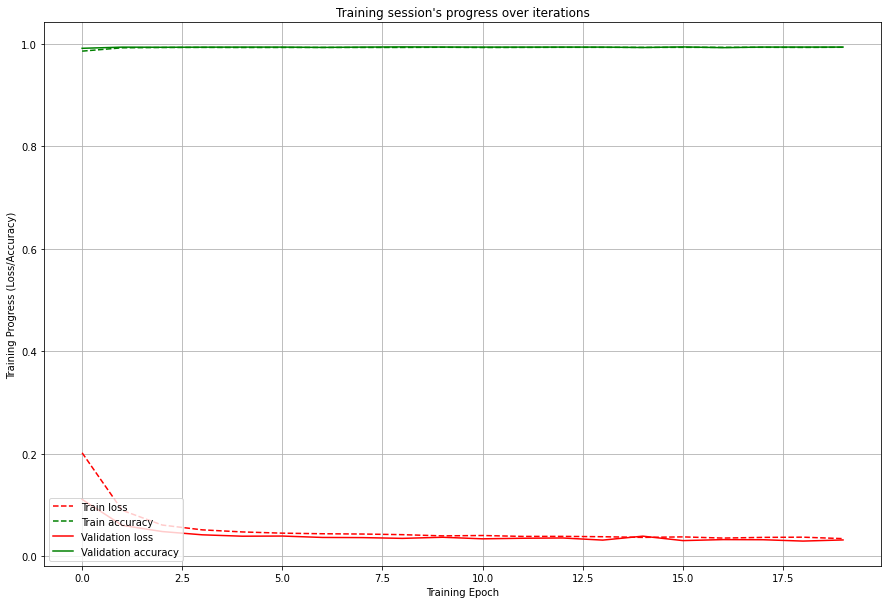

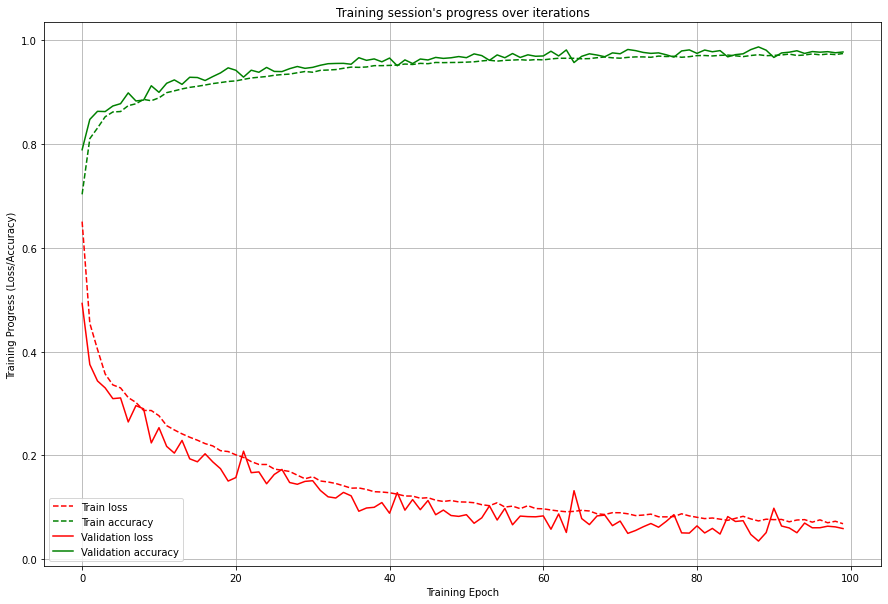

Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_24 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_24 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_81 (Dropout)        (None, 512)               0         
                                                                 
 dense_86 (Dense)            (None, 64)                32832     
                                                                 
 dense_87 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

494/494 [==============================] - 5s 11ms/step - loss: 0.1232 - accuracy: 0.9526 - val_loss: 0.1487 - val_accuracy: 0.9466
Epoch 70/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0966 - accuracy: 0.9629 - val_loss: 0.1348 - val_accuracy: 0.9546
Epoch 71/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0913 - accuracy: 0.9653 - val_loss: 0.0759 - val_accuracy: 0.9698
Epoch 72/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0917 - accuracy: 0.9649 - val_loss: 0.0957 - val_accuracy: 0.9660
Epoch 73/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0910 - accuracy: 0.9653 - val_loss: 0.1125 - val_accuracy: 0.9592
Epoch 74/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0893 - accuracy: 0.9662 - val_loss: 0.1129 - val_accuracy: 0.9585
Epoch 75/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0915 - accuracy: 0.9648 - val_loss: 0.1114 - val_accuracy: 0.960

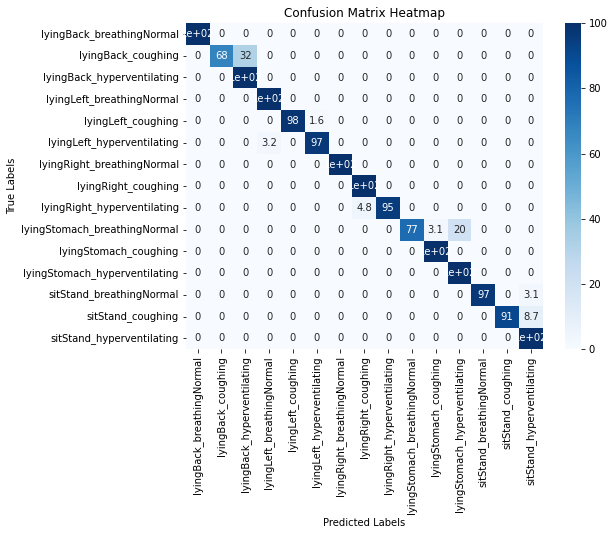

17/71 0.9506607929515418 0.8883169030961522


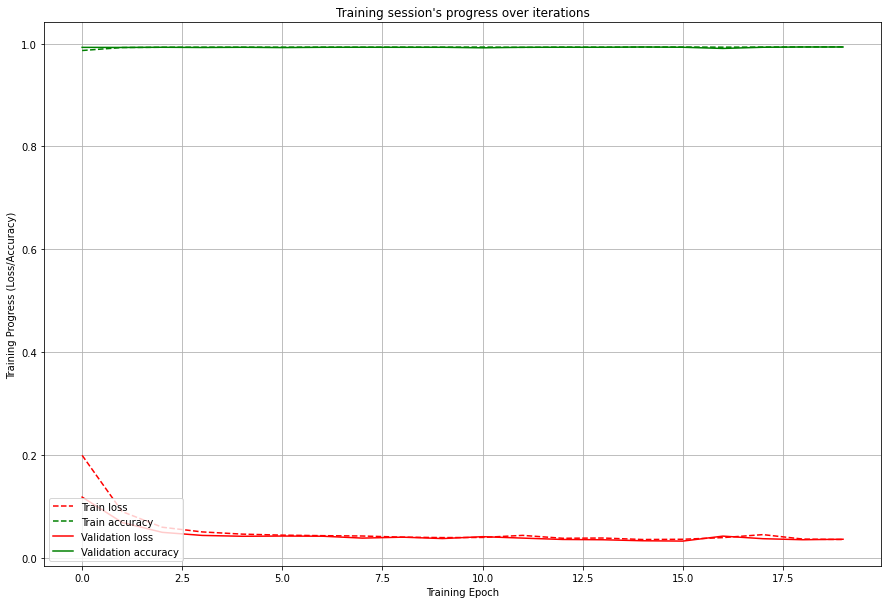

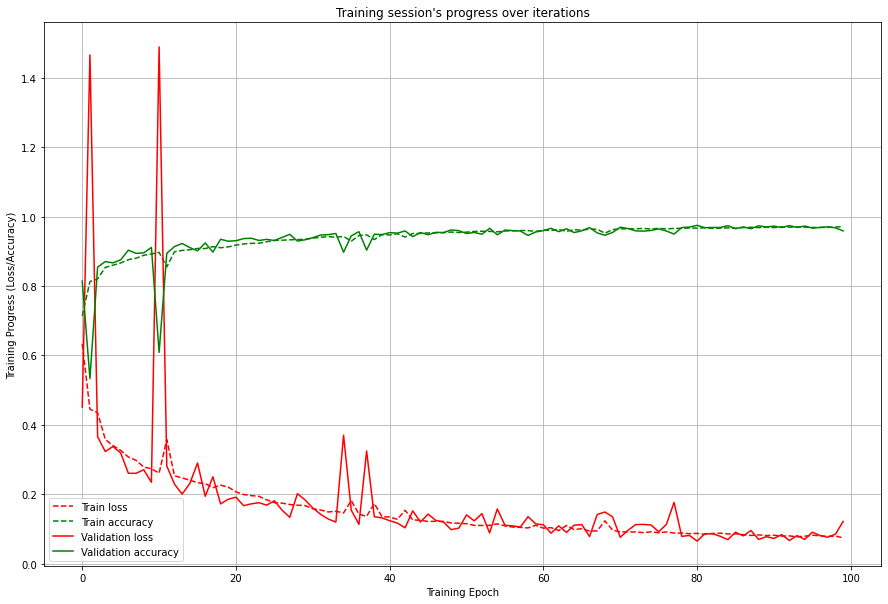

Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_25 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_25 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_85 (Dropout)        (None, 512)               0         
                                                                 
 dense_90 (Dense)            (None, 64)                32832     
                                                                 
 dense_91 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9669 - val_loss: 0.0804 - val_accuracy: 0.9706
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0894 - accuracy: 0.9648 - val_loss: 0.0747 - val_accuracy: 0.9699
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0861 - accuracy: 0.9660 - val_loss: 0.0767 - val_accuracy: 0.9713
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0867 - accuracy: 0.9664 - val_loss: 0.1307 - val_accuracy: 0.9535
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9669 - val_loss: 0.0723 - val_accuracy: 0.9723
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0863 - accuracy: 0.9659 - val_loss: 0.0652 - val_accuracy: 0.9734
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0856 - accuracy: 0.9666 - val_loss: 0.0906 - val_accuracy: 0.964

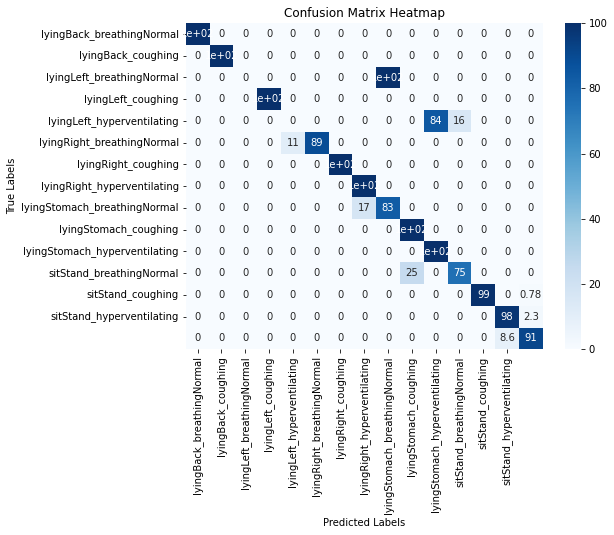

18/71 0.8463541666666666 0.8861083380209162


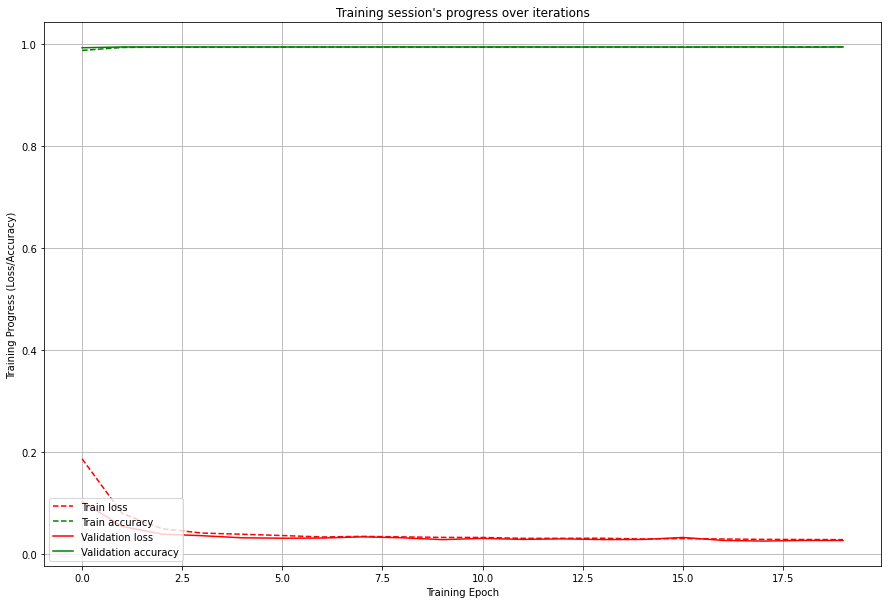

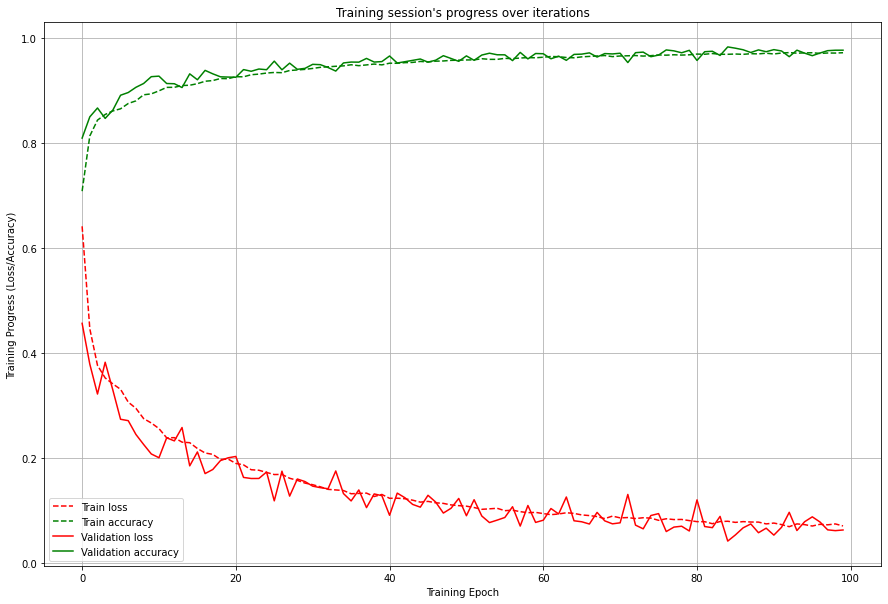

Model: "sequential_47"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_26 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_26 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_89 (Dropout)        (None, 512)               0         
                                                                 
 dense_94 (Dense)            (None, 64)                32832     
                                                                 
 dense_95 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 11ms/step - loss: 0.0875 - accuracy: 0.9664 - val_loss: 0.0811 - val_accuracy: 0.9705
Epoch 70/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0873 - accuracy: 0.9668 - val_loss: 0.0853 - val_accuracy: 0.9700
Epoch 71/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9660 - val_loss: 0.0575 - val_accuracy: 0.9774
Epoch 72/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0831 - accuracy: 0.9680 - val_loss: 0.0898 - val_accuracy: 0.9660
Epoch 73/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0844 - accuracy: 0.9673 - val_loss: 0.0659 - val_accuracy: 0.9754
Epoch 74/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0830 - accuracy: 0.9672 - val_loss: 0.0638 - val_accuracy: 0.9772
Epoch 75/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0827 - accuracy: 0.9682 - val_loss: 0.0551 - val_accuracy: 0.978

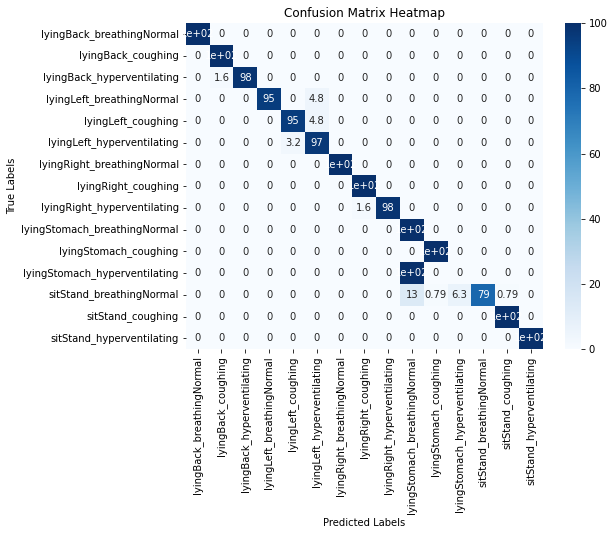

19/71 0.9107939339875112 0.8873426178192458


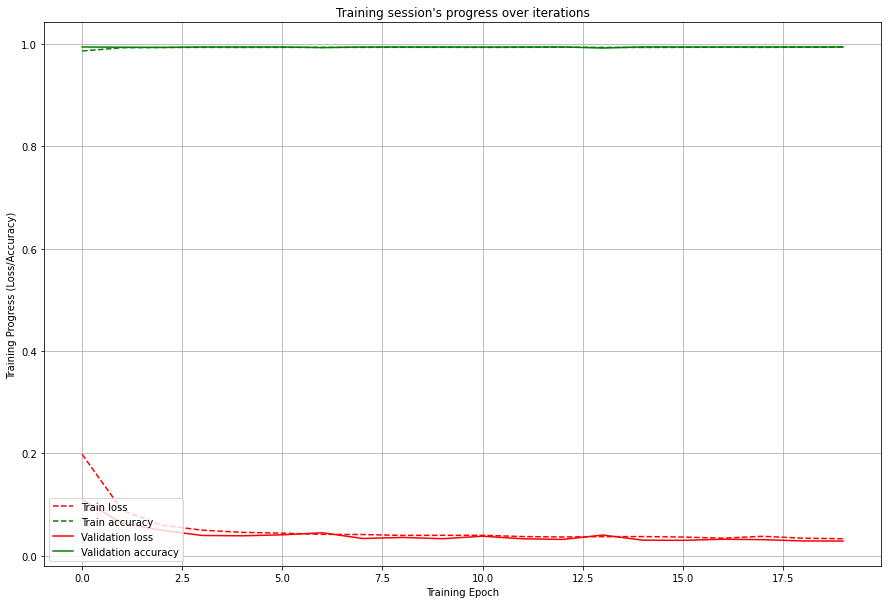

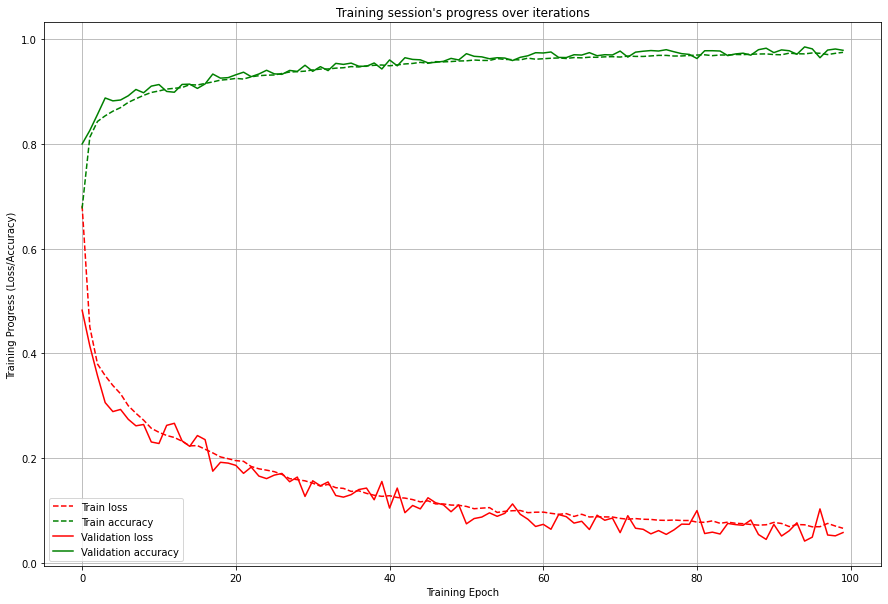

Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_27 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_27 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_93 (Dropout)        (None, 512)               0         
                                                                 
 dense_98 (Dense)            (None, 64)                32832     
                                                                 
 dense_99 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0885 - accuracy: 0.9658 - val_loss: 0.0759 - val_accuracy: 0.9709
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0888 - accuracy: 0.9658 - val_loss: 0.0803 - val_accuracy: 0.9687
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0855 - accuracy: 0.9673 - val_loss: 0.0725 - val_accuracy: 0.9715
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0862 - accuracy: 0.9671 - val_loss: 0.0864 - val_accuracy: 0.9648
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0867 - accuracy: 0.9671 - val_loss: 0.0610 - val_accuracy: 0.9752
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0849 - accuracy: 0.9676 - val_loss: 0.0728 - val_accuracy: 0.9712
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0842 - accuracy: 0.9670 - val_loss: 0.0626 - val_accuracy: 0.974

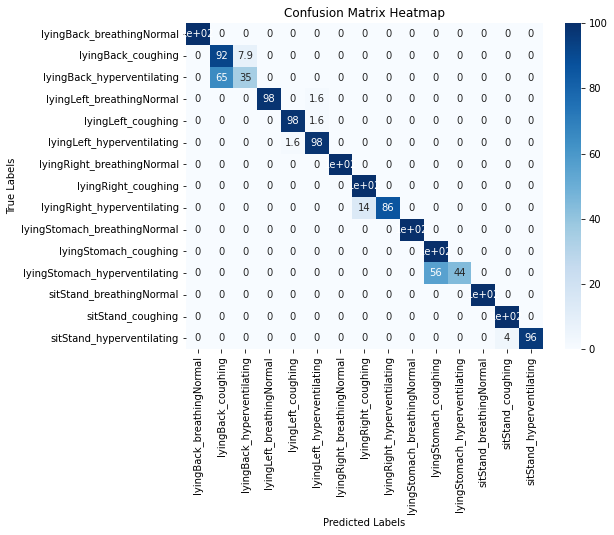

20/71 0.9135802469135802 0.8885920287284998


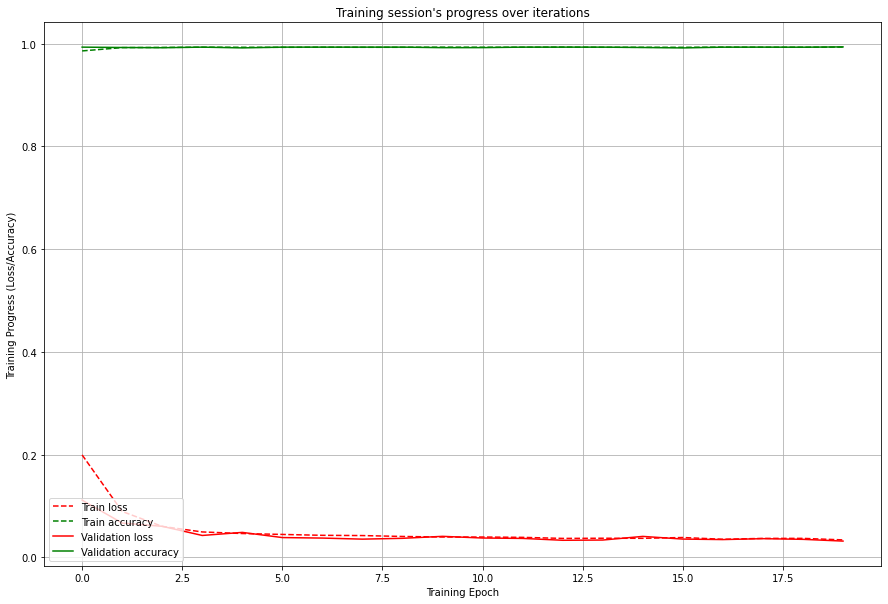

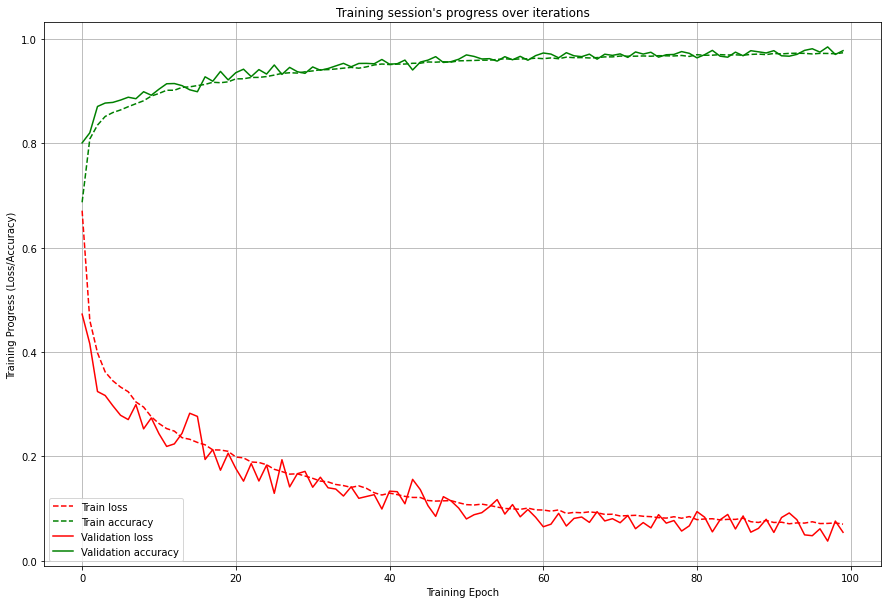

Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_28 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_28 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_97 (Dropout)        (None, 512)               0         
                                                                 
 dense_102 (Dense)           (None, 64)                32832     
                                                                 
 dense_103 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0893 - accuracy: 0.9653 - val_loss: 0.0947 - val_accuracy: 0.9650
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0918 - accuracy: 0.9653 - val_loss: 0.0844 - val_accuracy: 0.9668
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0858 - accuracy: 0.9678 - val_loss: 0.0856 - val_accuracy: 0.9670
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0885 - accuracy: 0.9665 - val_loss: 0.0792 - val_accuracy: 0.9687
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0843 - accuracy: 0.9688 - val_loss: 0.0727 - val_accuracy: 0.9742
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0827 - accuracy: 0.9686 - val_loss: 0.0952 - val_accuracy: 0.9636
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0860 - accuracy: 0.9668 - val_loss: 0.0631 - val_accuracy: 0.975

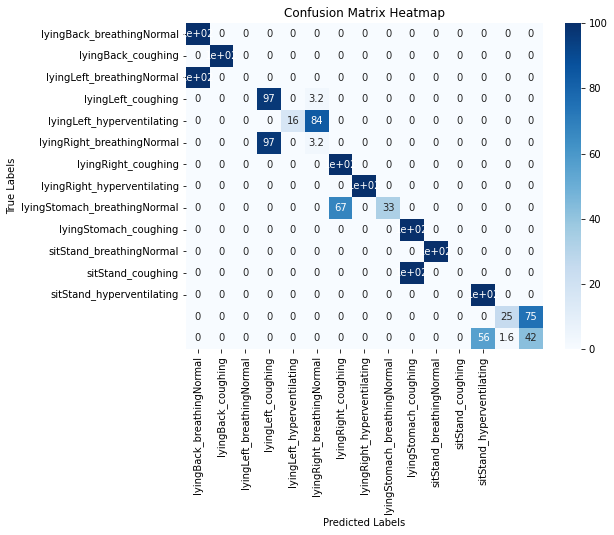

21/71 0.6047535211267606 0.8756902783829662


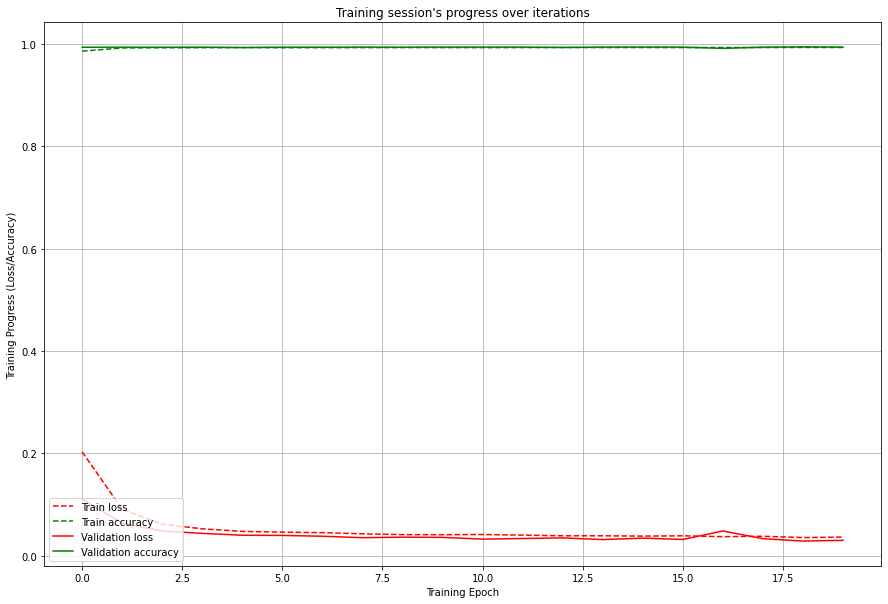

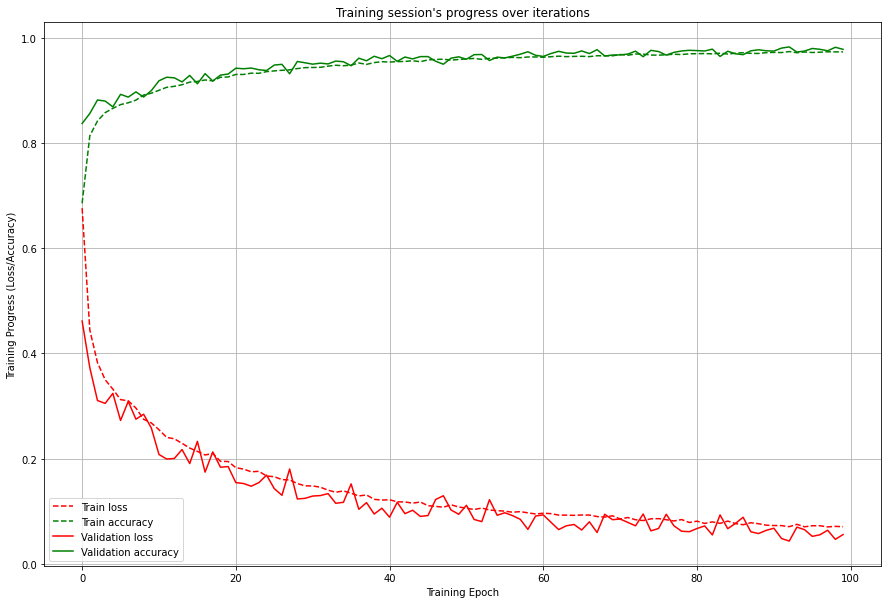

Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_29 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_29 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_101 (Dropout)       (None, 512)               0         
                                                                 
 dense_106 (Dense)           (None, 64)                32832     
                                                                 
 dense_107 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 11ms/step - loss: 0.0830 - accuracy: 0.9686 - val_loss: 0.1138 - val_accuracy: 0.9587
Epoch 70/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0851 - accuracy: 0.9675 - val_loss: 0.0597 - val_accuracy: 0.9751
Epoch 71/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0868 - accuracy: 0.9670 - val_loss: 0.0723 - val_accuracy: 0.9726
Epoch 72/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0854 - accuracy: 0.9675 - val_loss: 0.0635 - val_accuracy: 0.9748
Epoch 73/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0827 - accuracy: 0.9688 - val_loss: 0.1147 - val_accuracy: 0.9565
Epoch 74/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0843 - accuracy: 0.9674 - val_loss: 0.0735 - val_accuracy: 0.9745
Epoch 75/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0814 - accuracy: 0.9690 - val_loss: 0.0873 - val_accuracy: 0.969

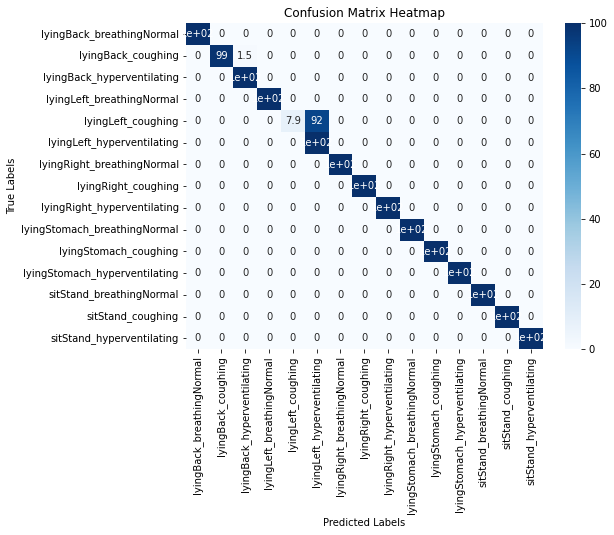

22/71 0.9493996569468267 0.8788950339726993


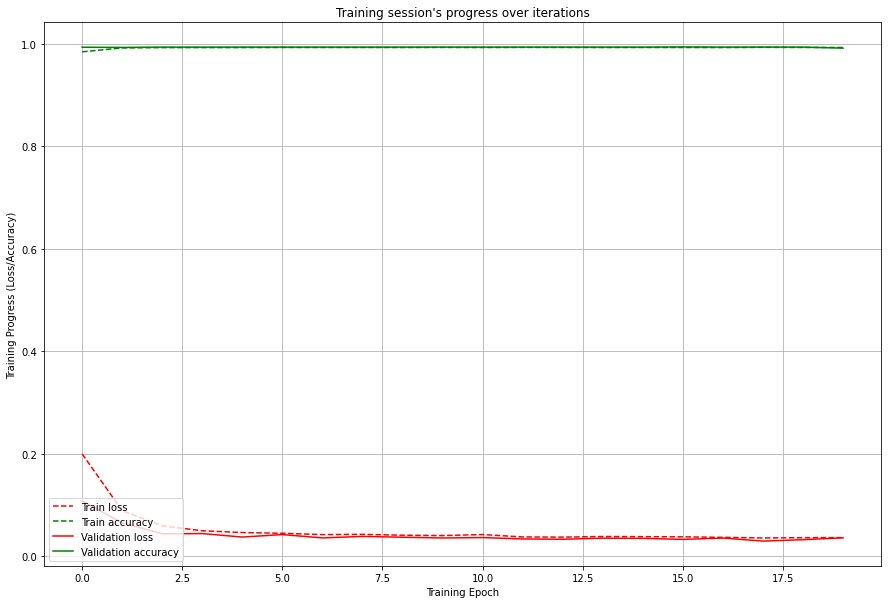

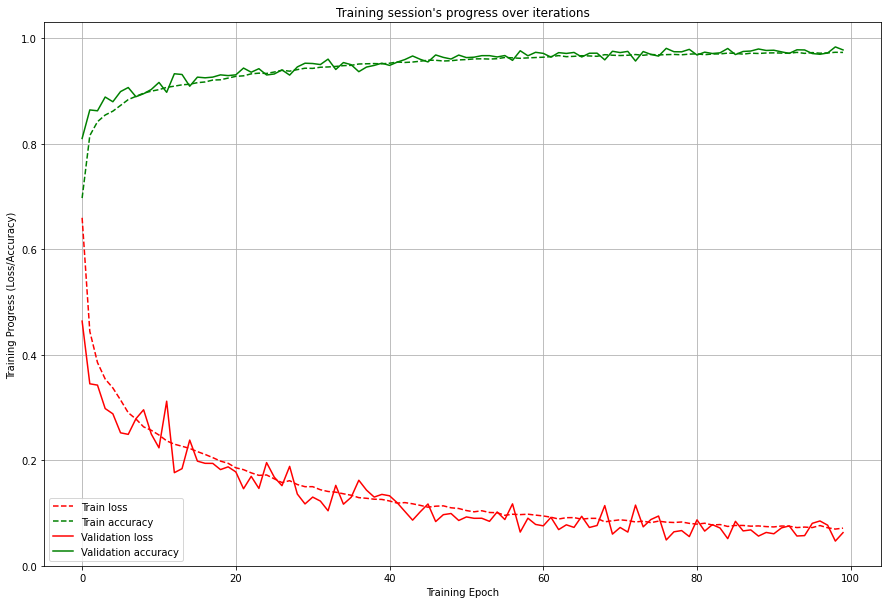

Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_30 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_30 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_105 (Dropout)       (None, 512)               0         
                                                                 
 dense_110 (Dense)           (None, 64)                32832     
                                                                 
 dense_111 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 10ms/step - loss: 0.0922 - accuracy: 0.9654 - val_loss: 0.0854 - val_accuracy: 0.9670
Epoch 70/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0955 - accuracy: 0.9624 - val_loss: 0.0889 - val_accuracy: 0.9685
Epoch 71/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0872 - accuracy: 0.9679 - val_loss: 0.0950 - val_accuracy: 0.9658
Epoch 72/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0890 - accuracy: 0.9659 - val_loss: 0.1042 - val_accuracy: 0.9649
Epoch 73/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0895 - accuracy: 0.9660 - val_loss: 0.0678 - val_accuracy: 0.9767
Epoch 74/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0905 - accuracy: 0.9649 - val_loss: 0.0792 - val_accuracy: 0.9694
Epoch 75/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0881 - accuracy: 0.9661 - val_loss: 0.0873 - val_accuracy: 0.968

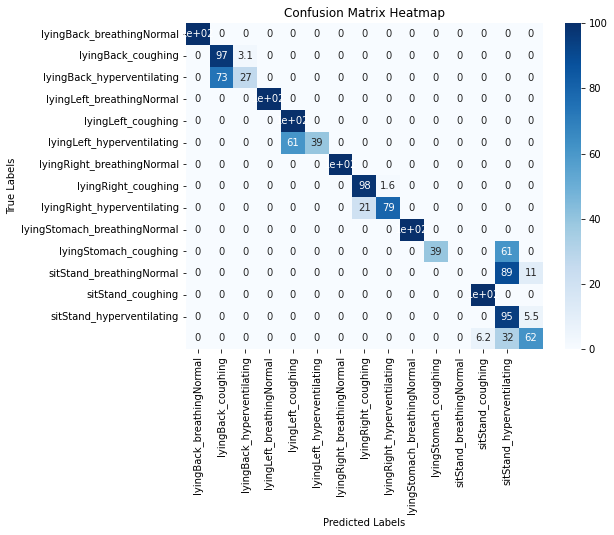

23/71 0.7710526315789473 0.8744016005396263


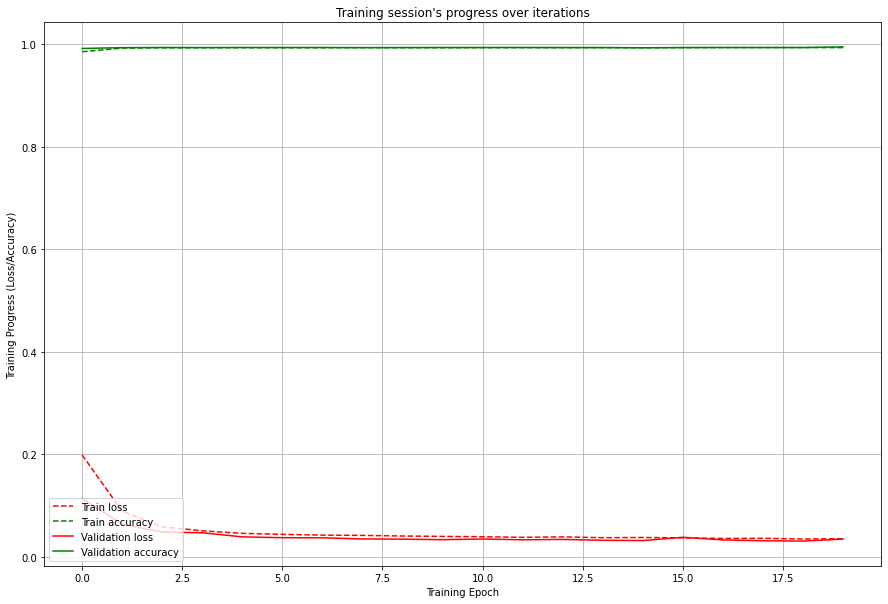

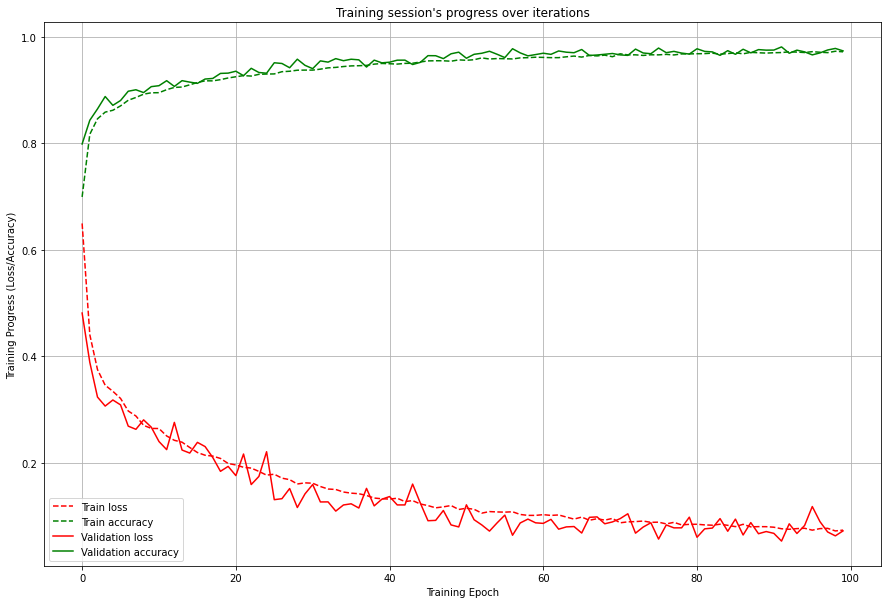

Model: "sequential_57"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_31 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_31 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_109 (Dropout)       (None, 512)               0         
                                                                 
 dense_114 (Dense)           (None, 64)                32832     
                                                                 
 dense_115 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0916 - accuracy: 0.9642 - val_loss: 0.1070 - val_accuracy: 0.9593
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0878 - accuracy: 0.9662 - val_loss: 0.0742 - val_accuracy: 0.9724
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0902 - accuracy: 0.9648 - val_loss: 0.0738 - val_accuracy: 0.9710
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0883 - accuracy: 0.9661 - val_loss: 0.0798 - val_accuracy: 0.9692
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0870 - accuracy: 0.9665 - val_loss: 0.0870 - val_accuracy: 0.9672
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0859 - accuracy: 0.9673 - val_loss: 0.0849 - val_accuracy: 0.9653
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0864 - accuracy: 0.9666 - val_loss: 0.0659 - val_accuracy: 0.976

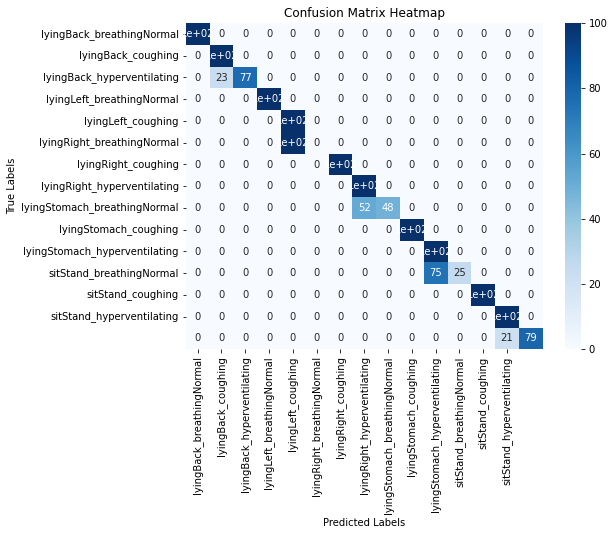

24/71 0.8381201044386423 0.872950340695587


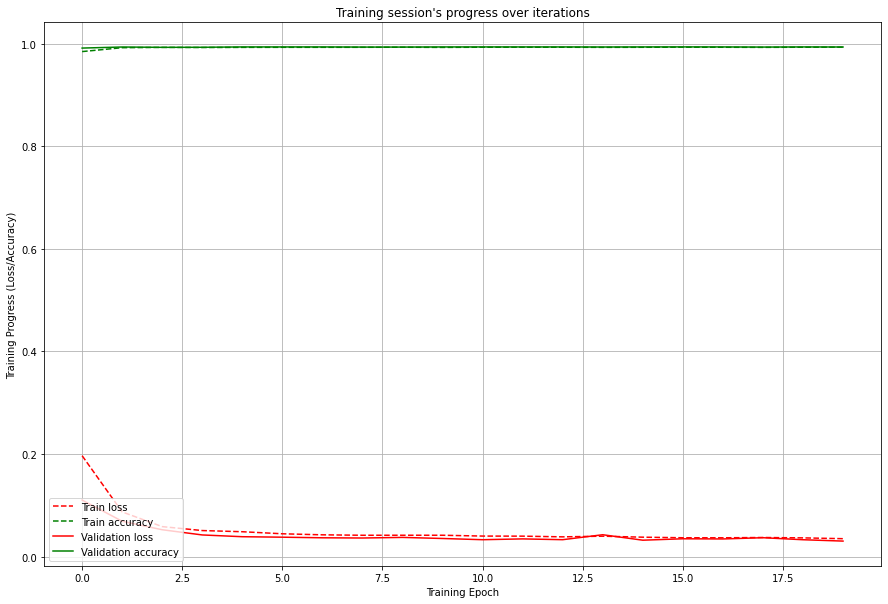

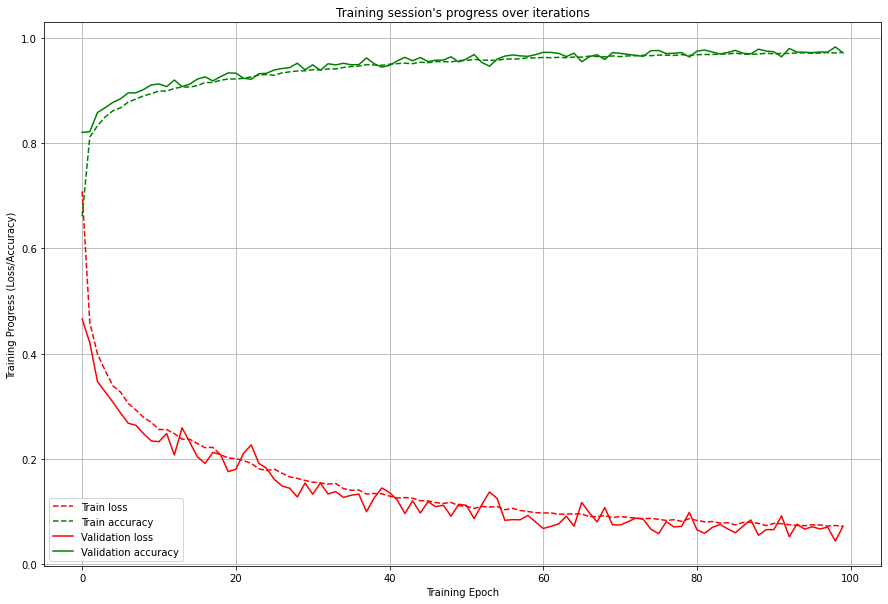

Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_32 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_32 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_113 (Dropout)       (None, 512)               0         
                                                                 
 dense_118 (Dense)           (None, 64)                32832     
                                                                 
 dense_119 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0891 - accuracy: 0.9654 - val_loss: 0.0931 - val_accuracy: 0.9665
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0891 - accuracy: 0.9660 - val_loss: 0.0745 - val_accuracy: 0.9716
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0931 - accuracy: 0.9648 - val_loss: 0.0805 - val_accuracy: 0.9687
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0896 - accuracy: 0.9654 - val_loss: 0.0911 - val_accuracy: 0.9646
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0872 - accuracy: 0.9663 - val_loss: 0.0555 - val_accuracy: 0.9777
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0835 - accuracy: 0.9680 - val_loss: 0.0875 - val_accuracy: 0.9725
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0866 - accuracy: 0.9675 - val_loss: 0.0766 - val_accuracy: 0.976

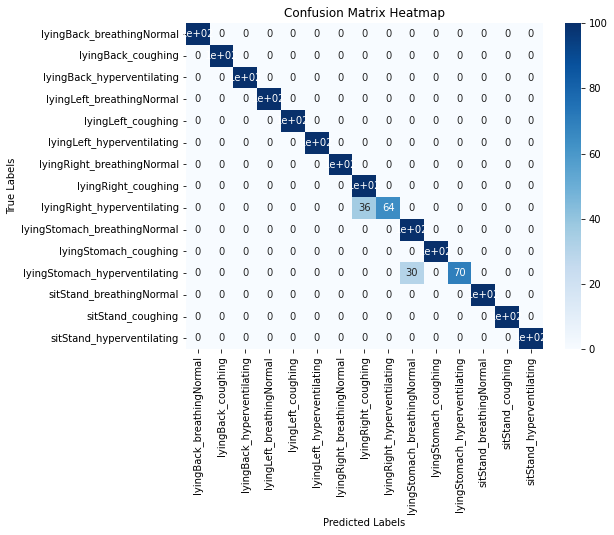

25/71 0.9632867132867133 0.8764248165644765


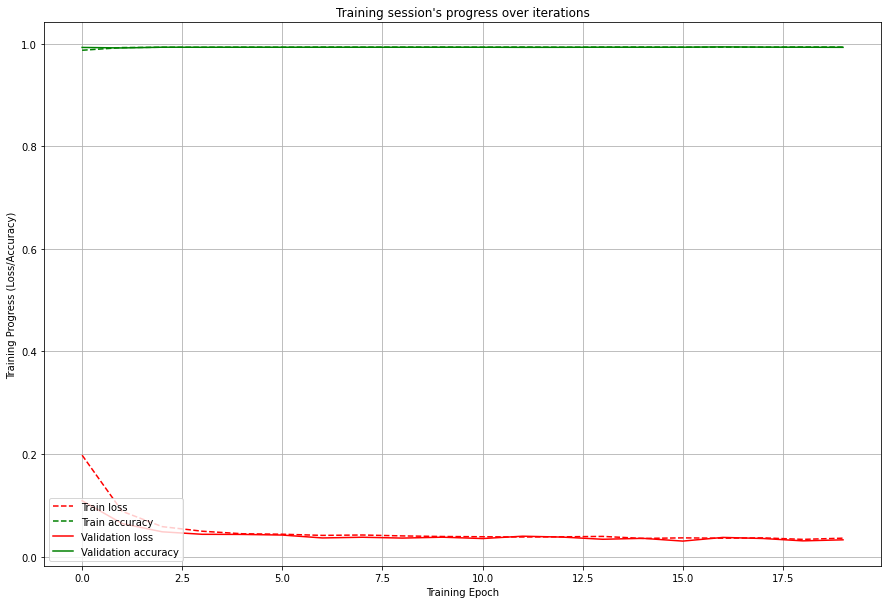

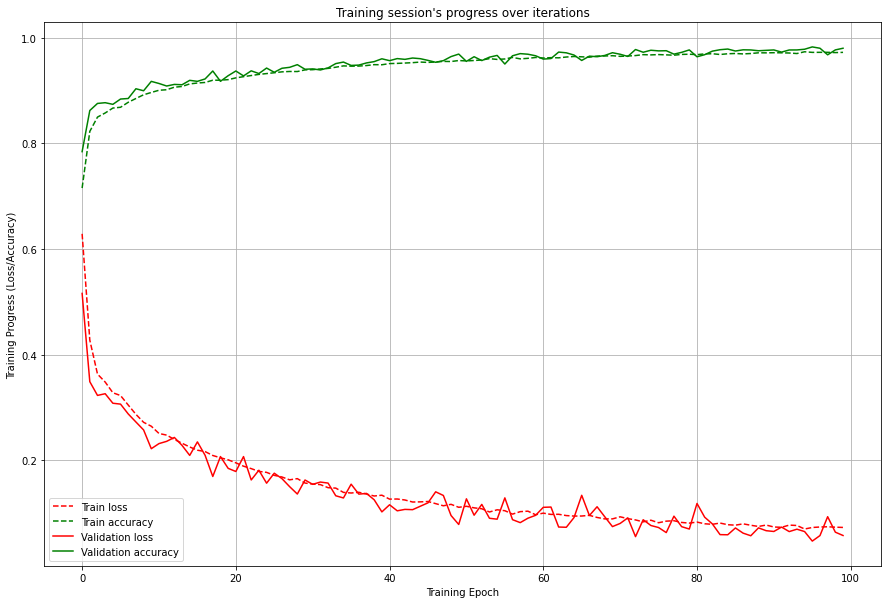

Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_33 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_33 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_117 (Dropout)       (None, 512)               0         
                                                                 
 dense_122 (Dense)           (None, 64)                32832     
                                                                 
 dense_123 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

496/496 [==============================] - 5s 11ms/step - loss: 0.0906 - accuracy: 0.9647 - val_loss: 0.0773 - val_accuracy: 0.9714
Epoch 70/100
496/496 [==============================] - 5s 11ms/step - loss: 0.0848 - accuracy: 0.9681 - val_loss: 0.0644 - val_accuracy: 0.9741
Epoch 71/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0893 - accuracy: 0.9652 - val_loss: 0.0836 - val_accuracy: 0.9677
Epoch 72/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0839 - accuracy: 0.9674 - val_loss: 0.1001 - val_accuracy: 0.9625
Epoch 73/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0907 - accuracy: 0.9639 - val_loss: 0.0709 - val_accuracy: 0.9727
Epoch 74/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0863 - accuracy: 0.9665 - val_loss: 0.0734 - val_accuracy: 0.9721
Epoch 75/100
496/496 [==============================] - 5s 10ms/step - loss: 0.0855 - accuracy: 0.9671 - val_loss: 0.0608 - val_accuracy: 0.977

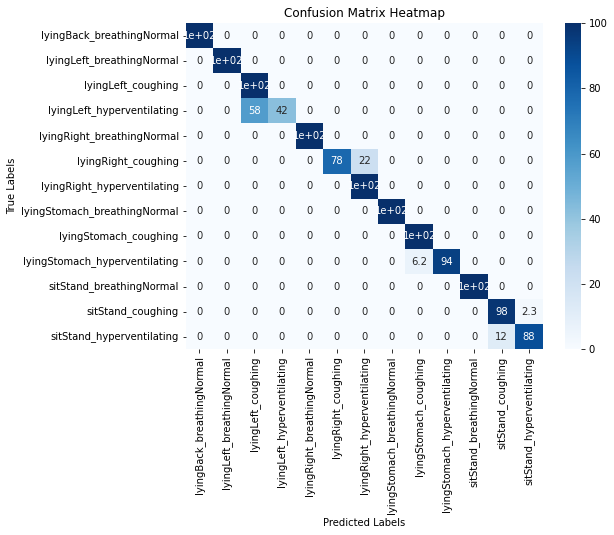

26/71 0.9287109375 0.8783613395620884


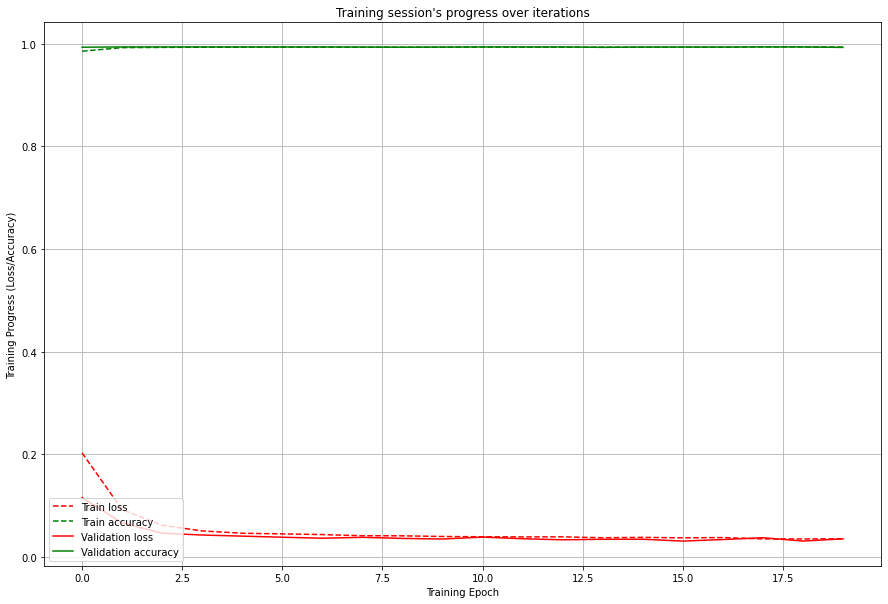

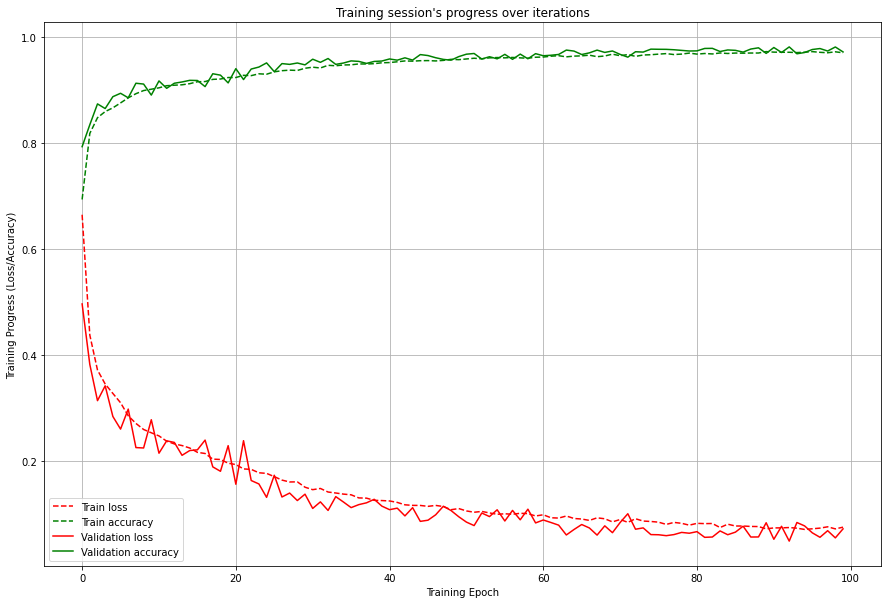

Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_34 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_34 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_121 (Dropout)       (None, 512)               0         
                                                                 
 dense_126 (Dense)           (None, 64)                32832     
                                                                 
 dense_127 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0897 - accuracy: 0.9647 - val_loss: 0.0547 - val_accuracy: 0.9795
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0858 - accuracy: 0.9661 - val_loss: 0.0735 - val_accuracy: 0.9695
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0912 - accuracy: 0.9640 - val_loss: 0.0741 - val_accuracy: 0.9721
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0852 - accuracy: 0.9665 - val_loss: 0.0738 - val_accuracy: 0.9700
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0839 - accuracy: 0.9670 - val_loss: 0.0591 - val_accuracy: 0.9763
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0848 - accuracy: 0.9667 - val_loss: 0.0644 - val_accuracy: 0.9742
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0839 - accuracy: 0.9678 - val_loss: 0.0527 - val_accuracy: 0.979

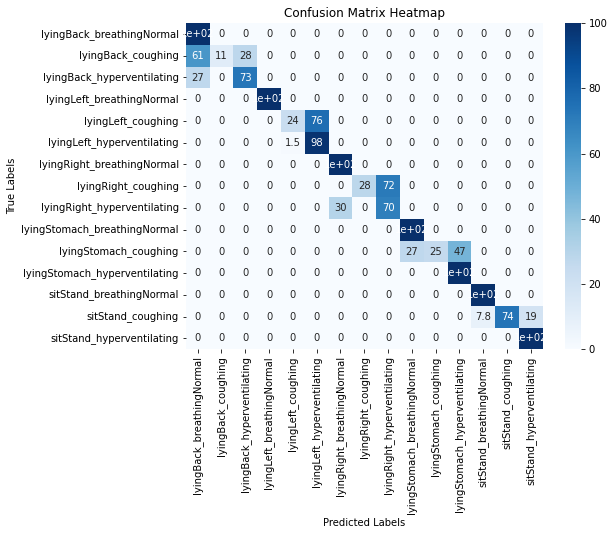

27/71 0.7690956979806848 0.8744589952198955


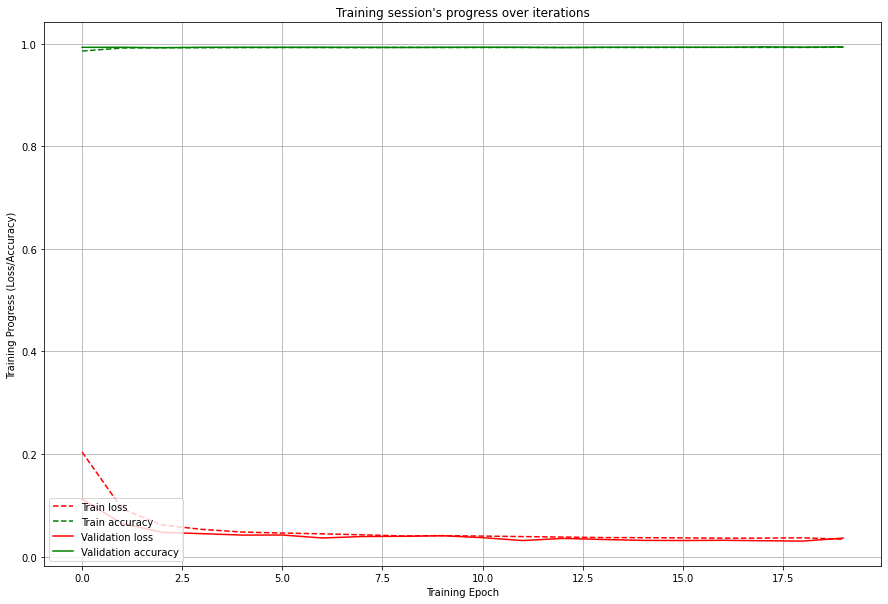

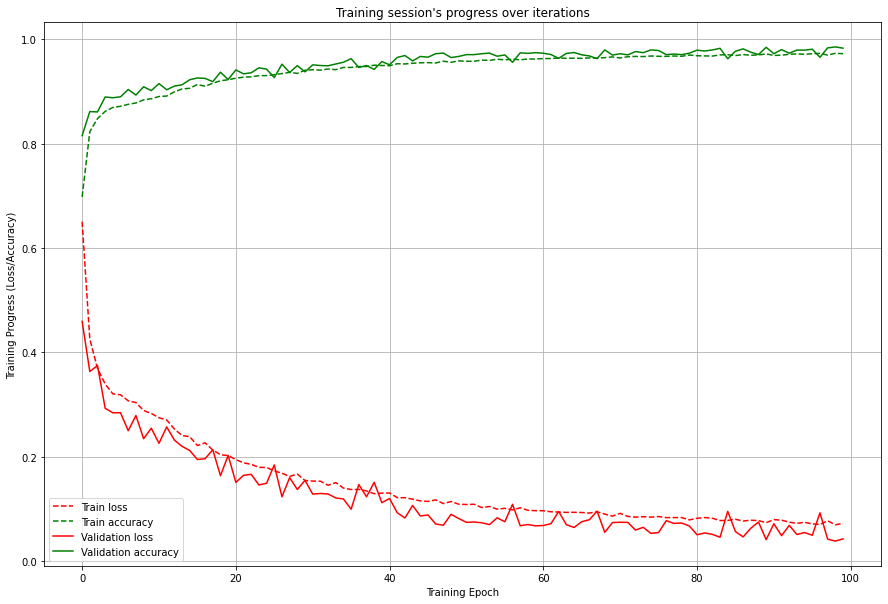

Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_35 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_35 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_125 (Dropout)       (None, 512)               0         
                                                                 
 dense_130 (Dense)           (None, 64)                32832     
                                                                 
 dense_131 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 10ms/step - loss: 0.0865 - accuracy: 0.9671 - val_loss: 0.1076 - val_accuracy: 0.9601
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0940 - accuracy: 0.9637 - val_loss: 0.0752 - val_accuracy: 0.9701
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0904 - accuracy: 0.9650 - val_loss: 0.0935 - val_accuracy: 0.9660
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0890 - accuracy: 0.9660 - val_loss: 0.0845 - val_accuracy: 0.9694
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0876 - accuracy: 0.9663 - val_loss: 0.0781 - val_accuracy: 0.9717
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0877 - accuracy: 0.9662 - val_loss: 0.0780 - val_accuracy: 0.9686
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0874 - accuracy: 0.9665 - val_loss: 0.0633 - val_accuracy: 0.976

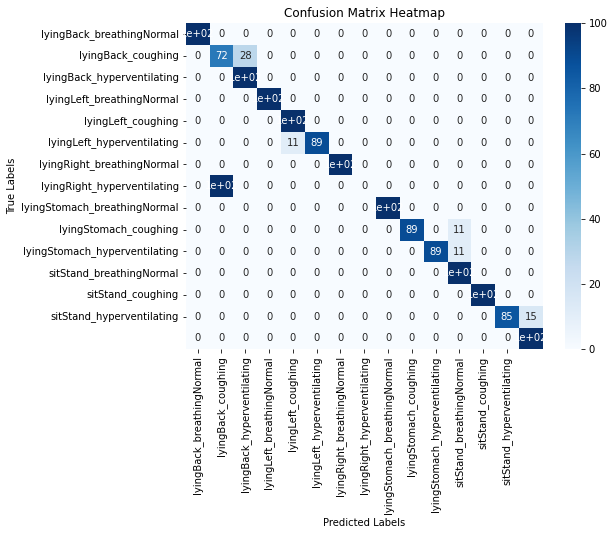

28/71 0.8940972222222222 0.8751361754613549


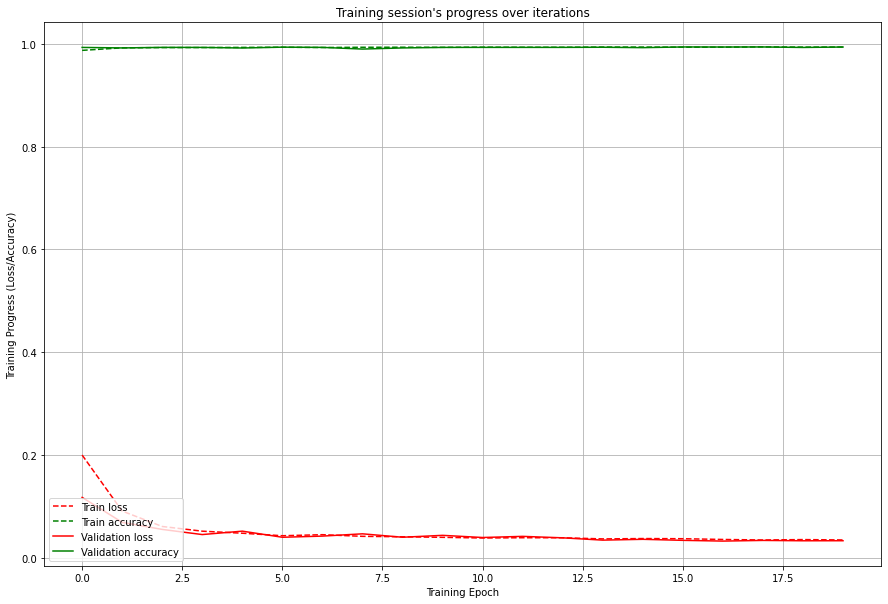

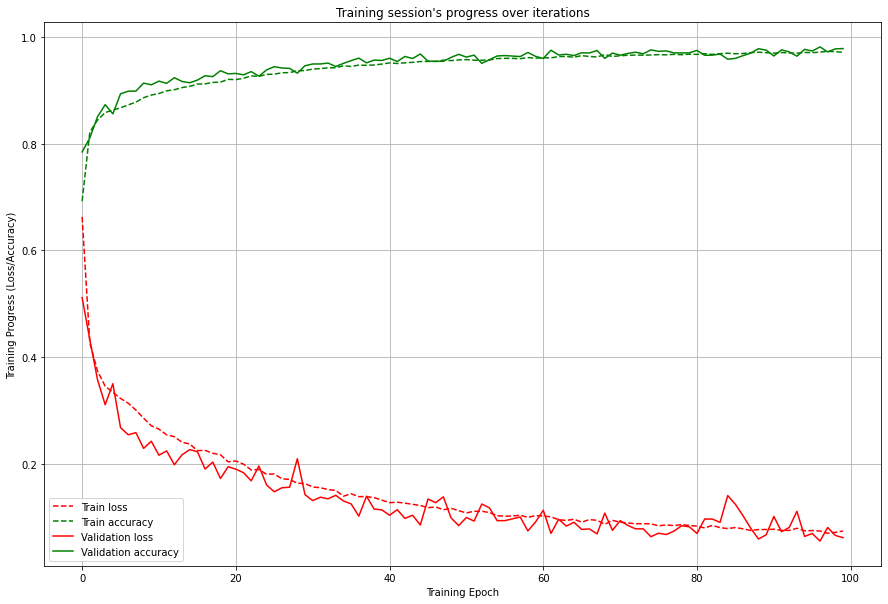

Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_36 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_36 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_129 (Dropout)       (None, 512)               0         
                                                                 
 dense_134 (Dense)           (None, 64)                32832     
                                                                 
 dense_135 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9654 - val_loss: 0.0636 - val_accuracy: 0.9739
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0851 - accuracy: 0.9669 - val_loss: 0.1006 - val_accuracy: 0.9629
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0902 - accuracy: 0.9647 - val_loss: 0.0809 - val_accuracy: 0.9704
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0865 - accuracy: 0.9663 - val_loss: 0.0839 - val_accuracy: 0.9682
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0838 - accuracy: 0.9677 - val_loss: 0.0777 - val_accuracy: 0.9708
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0853 - accuracy: 0.9662 - val_loss: 0.0660 - val_accuracy: 0.9740
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0804 - accuracy: 0.9696 - val_loss: 0.0792 - val_accuracy: 0.969

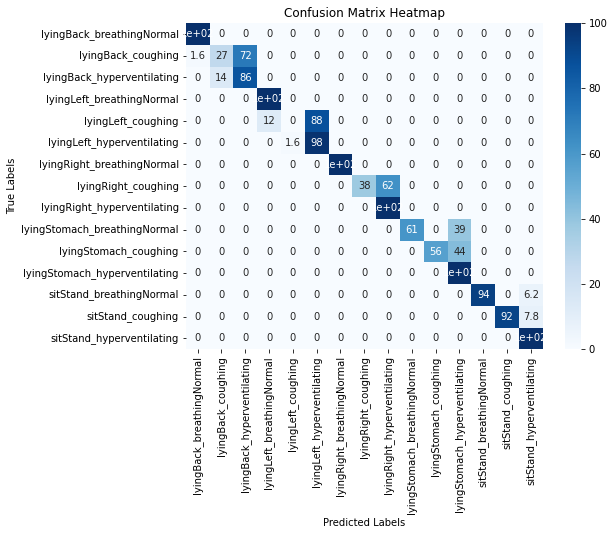

29/71 0.7986111111111112 0.8725853399830135


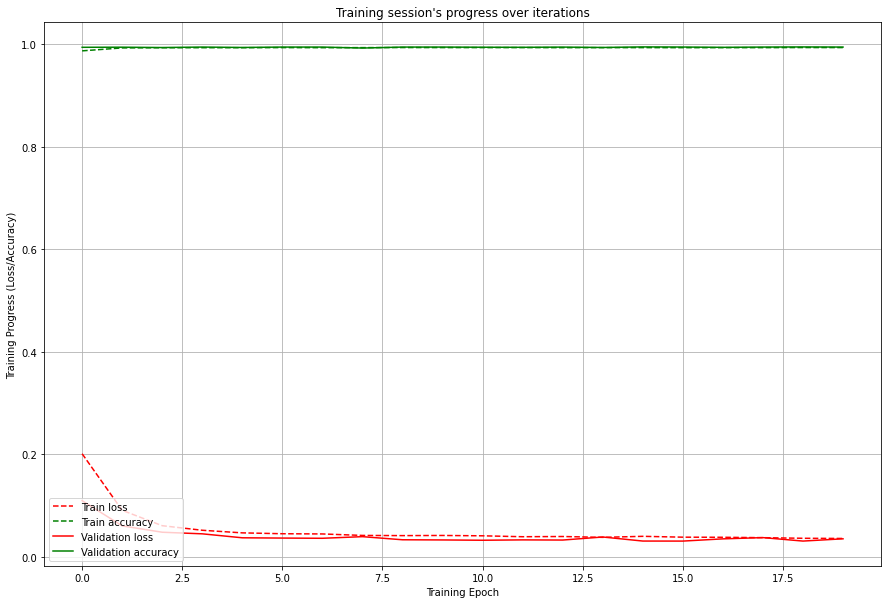

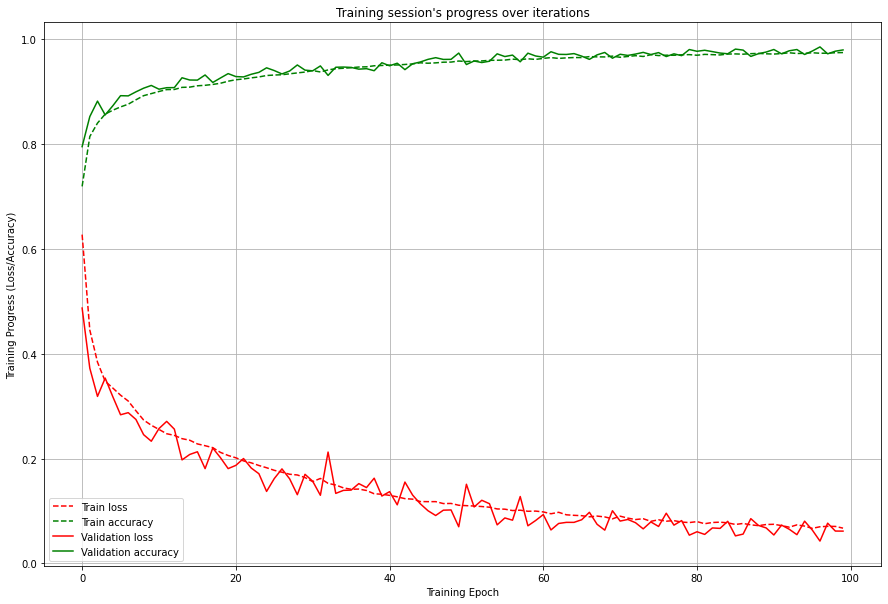

Model: "sequential_69"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_37 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_37 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_133 (Dropout)       (None, 512)               0         
                                                                 
 dense_138 (Dense)           (None, 64)                32832     
                                                                 
 dense_139 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 10ms/step - loss: 0.0910 - accuracy: 0.9649 - val_loss: 0.0775 - val_accuracy: 0.9690
Epoch 70/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0875 - accuracy: 0.9655 - val_loss: 0.0772 - val_accuracy: 0.9709
Epoch 71/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0899 - accuracy: 0.9655 - val_loss: 0.0813 - val_accuracy: 0.9684
Epoch 72/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0894 - accuracy: 0.9654 - val_loss: 0.1251 - val_accuracy: 0.9588
Epoch 73/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0869 - accuracy: 0.9661 - val_loss: 0.0936 - val_accuracy: 0.9649
Epoch 74/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0880 - accuracy: 0.9664 - val_loss: 0.0790 - val_accuracy: 0.9693
Epoch 75/100
493/493 [==============================] - 5s 10ms/step - loss: 0.0829 - accuracy: 0.9681 - val_loss: 0.1231 - val_accuracy: 0.956

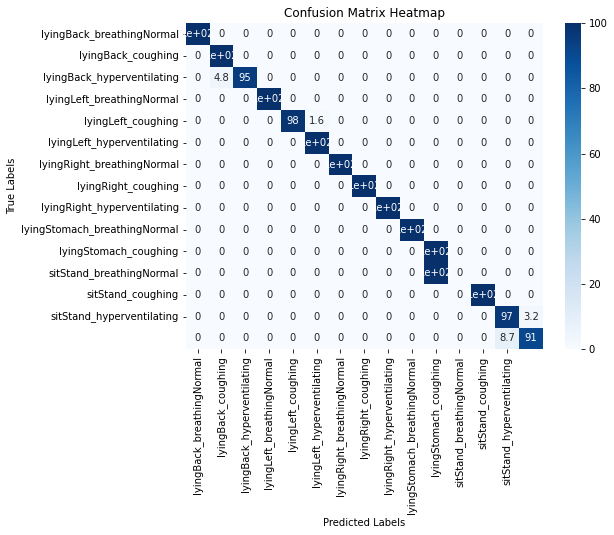

30/71 0.9269565217391305 0.8743392490719204


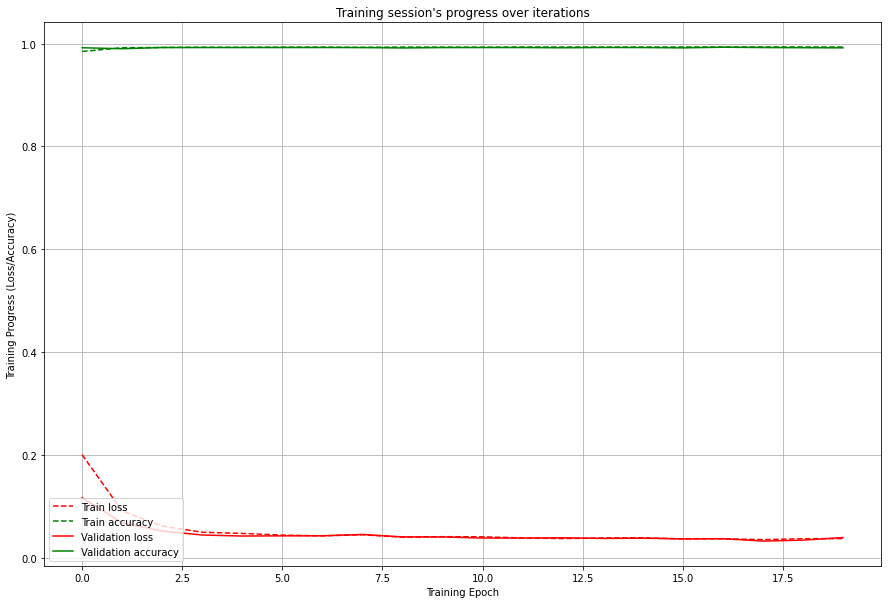

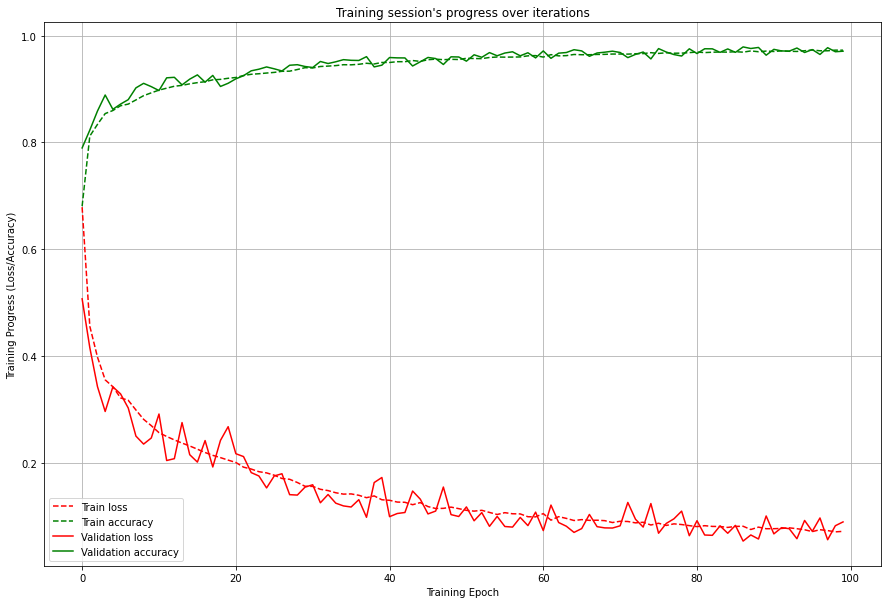

Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_38 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_38 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_137 (Dropout)       (None, 512)               0         
                                                                 
 dense_142 (Dense)           (None, 64)                32832     
                                                                 
 dense_143 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 6s 12ms/step - loss: 0.0890 - accuracy: 0.9658 - val_loss: 0.0692 - val_accuracy: 0.9714
Epoch 70/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0921 - accuracy: 0.9647 - val_loss: 0.0579 - val_accuracy: 0.9790
Epoch 71/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0873 - accuracy: 0.9659 - val_loss: 0.0590 - val_accuracy: 0.9759
Epoch 72/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0863 - accuracy: 0.9667 - val_loss: 0.0672 - val_accuracy: 0.9740
Epoch 73/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0868 - accuracy: 0.9658 - val_loss: 0.0737 - val_accuracy: 0.9697
Epoch 74/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0863 - accuracy: 0.9665 - val_loss: 0.0783 - val_accuracy: 0.9710
Epoch 75/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0858 - accuracy: 0.9667 - val_loss: 0.0680 - val_accuracy: 0.971

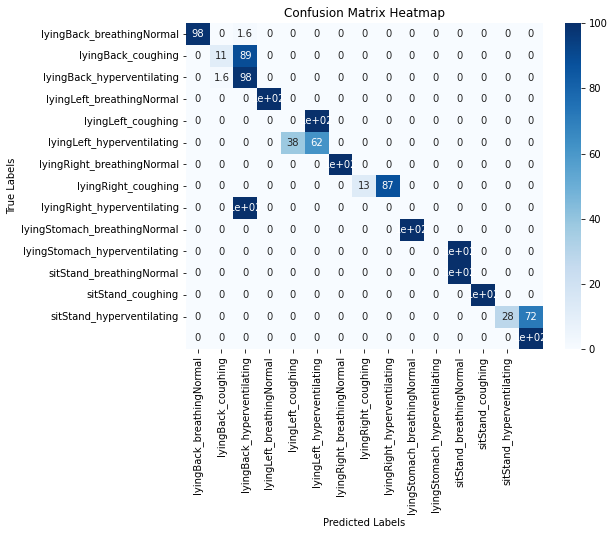

31/71 0.632183908045977 0.8667718946648598


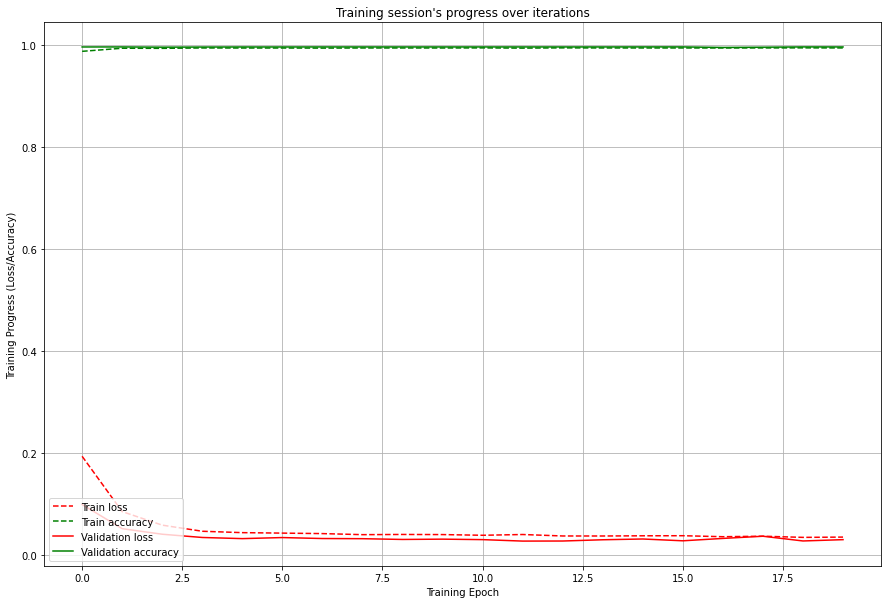

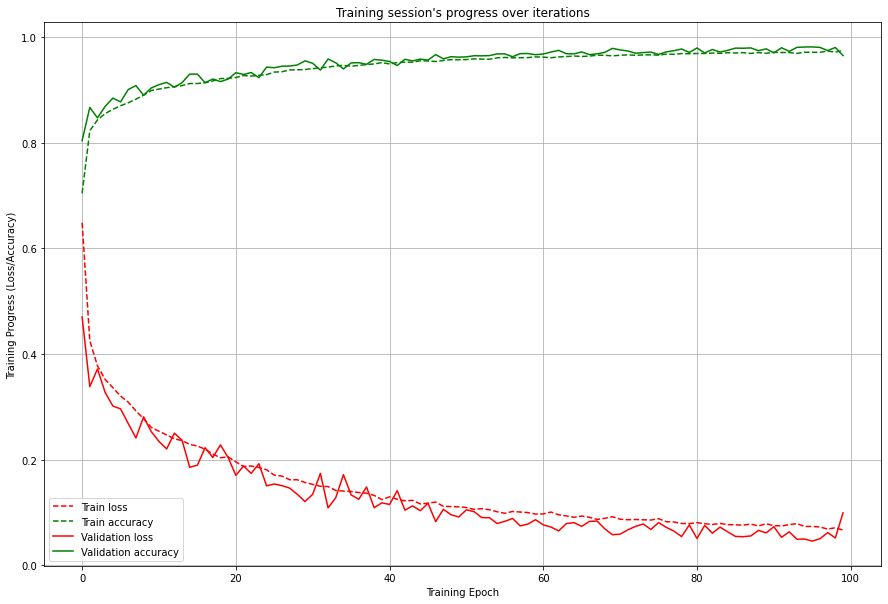

Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_39 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_39 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_141 (Dropout)       (None, 512)               0         
                                                                 
 dense_146 (Dense)           (None, 64)                32832     
                                                                 
 dense_147 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0976 - accuracy: 0.9622 - val_loss: 0.0910 - val_accuracy: 0.9633
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0941 - accuracy: 0.9636 - val_loss: 0.0905 - val_accuracy: 0.9642
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0918 - accuracy: 0.9637 - val_loss: 0.1148 - val_accuracy: 0.9578
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0907 - accuracy: 0.9651 - val_loss: 0.0665 - val_accuracy: 0.9734
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0914 - accuracy: 0.9648 - val_loss: 0.0989 - val_accuracy: 0.9629
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0911 - accuracy: 0.9641 - val_loss: 0.0749 - val_accuracy: 0.9721
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9660 - val_loss: 0.0761 - val_accuracy: 0.971

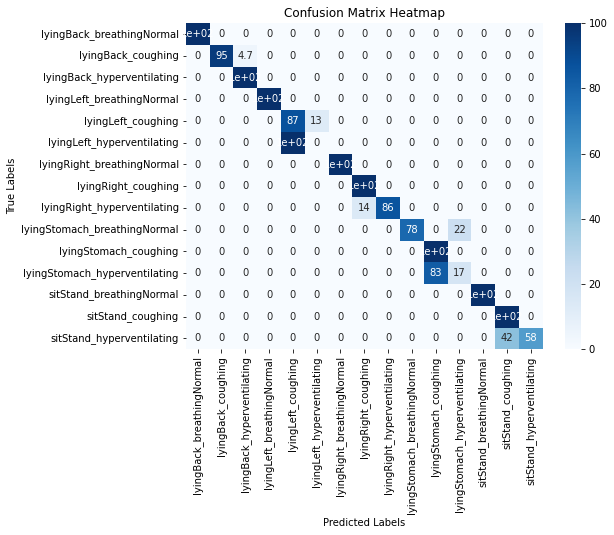

32/71 0.8216783216783217 0.8654054227561769


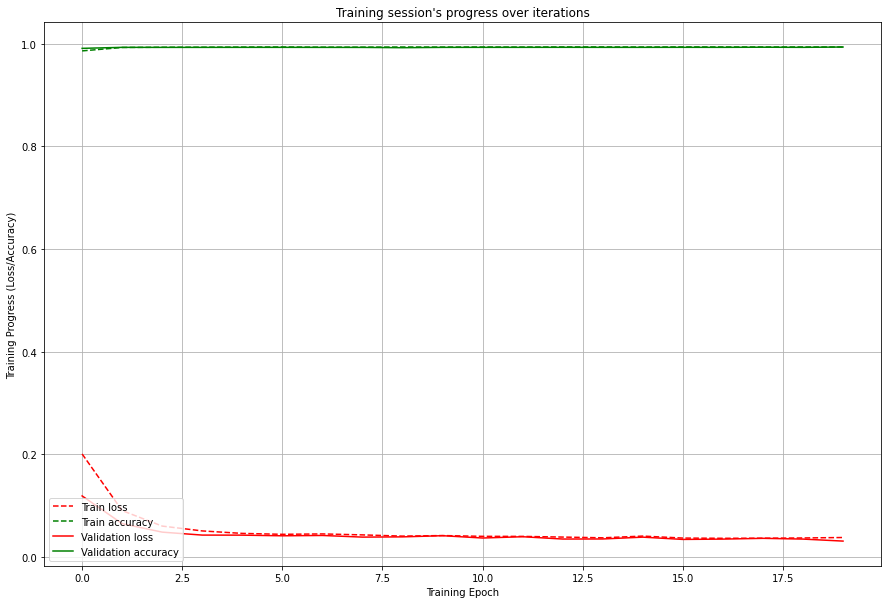

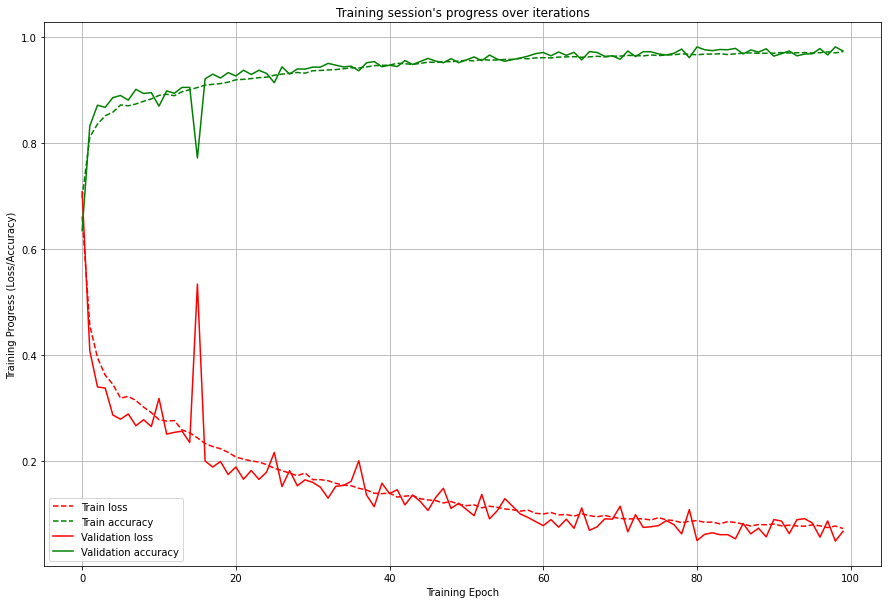

Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_40 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_40 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_145 (Dropout)       (None, 512)               0         
                                                                 
 dense_150 (Dense)           (None, 64)                32832     
                                                                 
 dense_151 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

493/493 [==============================] - 5s 11ms/step - loss: 0.0851 - accuracy: 0.9672 - val_loss: 0.0563 - val_accuracy: 0.9769
Epoch 70/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0886 - accuracy: 0.9659 - val_loss: 0.0846 - val_accuracy: 0.9703
Epoch 71/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0827 - accuracy: 0.9690 - val_loss: 0.0610 - val_accuracy: 0.9768
Epoch 72/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0856 - accuracy: 0.9670 - val_loss: 0.0600 - val_accuracy: 0.9772
Epoch 73/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0844 - accuracy: 0.9675 - val_loss: 0.0502 - val_accuracy: 0.9811
Epoch 74/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0855 - accuracy: 0.9677 - val_loss: 0.0797 - val_accuracy: 0.9694
Epoch 75/100
493/493 [==============================] - 5s 11ms/step - loss: 0.0826 - accuracy: 0.9676 - val_loss: 0.0720 - val_accuracy: 0.973

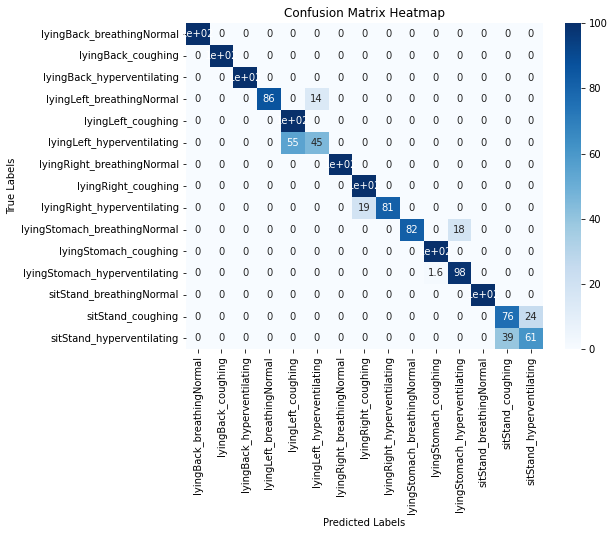

33/71 0.8702090592334495 0.865546706181979


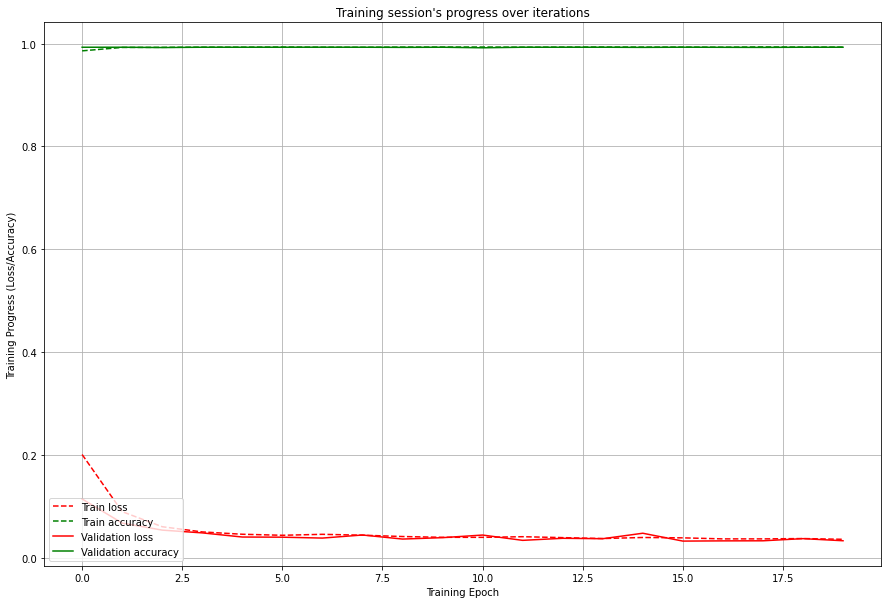

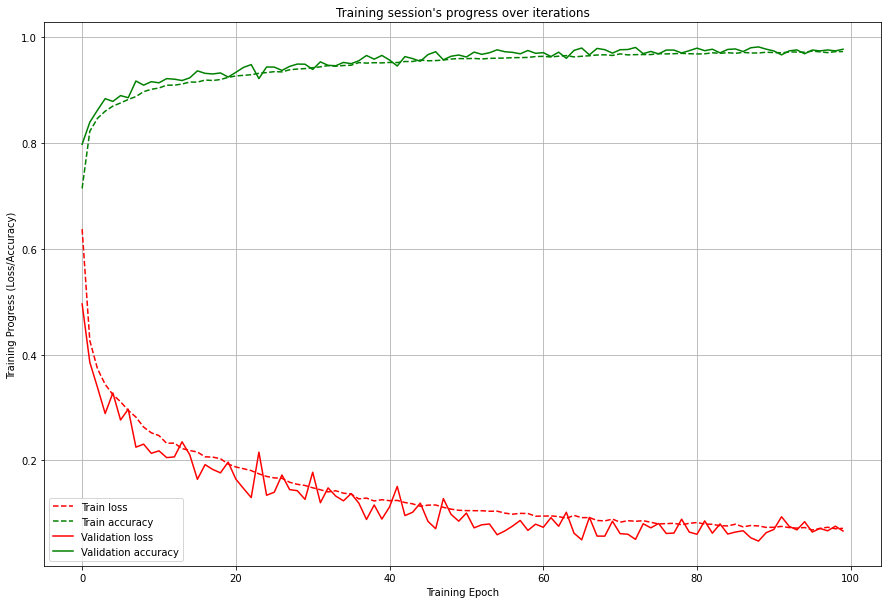

Model: "sequential_77"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_41 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_41 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_149 (Dropout)       (None, 512)               0         
                                                                 
 dense_154 (Dense)           (None, 64)                32832     
                                                                 
 dense_155 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 6s 11ms/step - loss: 0.0851 - accuracy: 0.9674 - val_loss: 0.0678 - val_accuracy: 0.9749
Epoch 70/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0818 - accuracy: 0.9684 - val_loss: 0.0727 - val_accuracy: 0.9733
Epoch 71/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0834 - accuracy: 0.9679 - val_loss: 0.1060 - val_accuracy: 0.9616
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0804 - accuracy: 0.9687 - val_loss: 0.0701 - val_accuracy: 0.9720
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0809 - accuracy: 0.9683 - val_loss: 0.0652 - val_accuracy: 0.9747
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0799 - accuracy: 0.9687 - val_loss: 0.0990 - val_accuracy: 0.9642
Epoch 75/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0786 - accuracy: 0.9693 - val_loss: 0.0828 - val_accuracy: 0.968

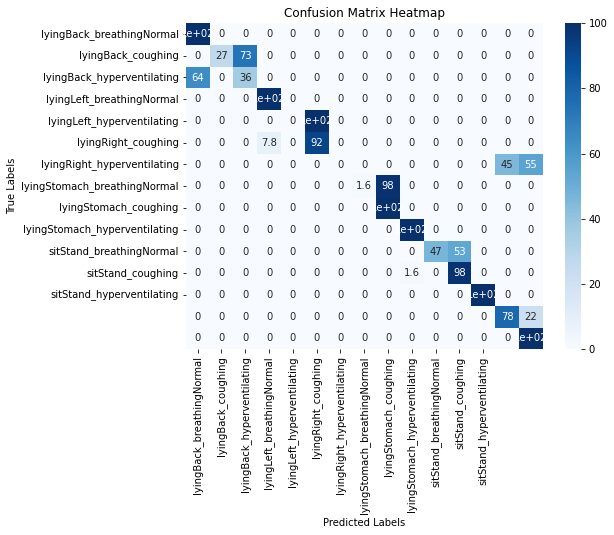

34/71 0.6987847222222222 0.8607820780688431


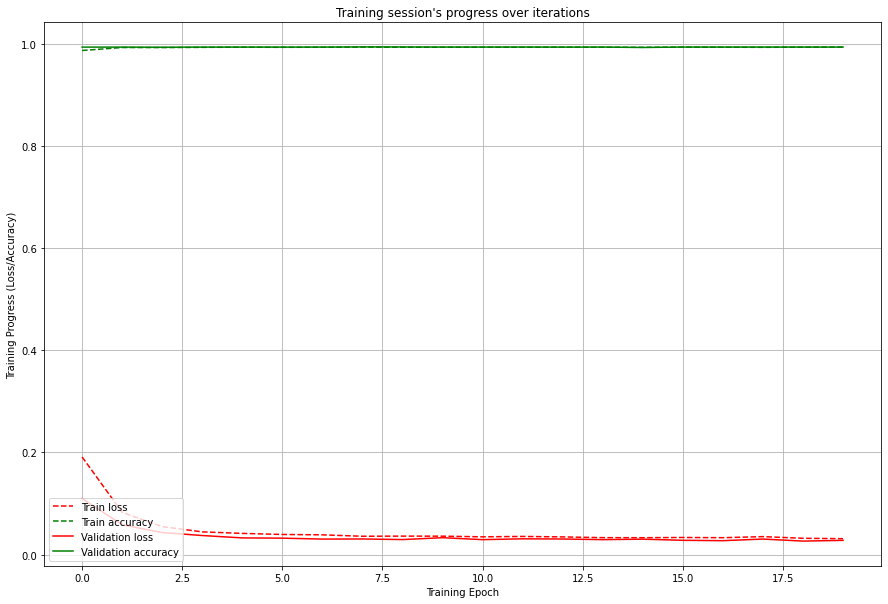

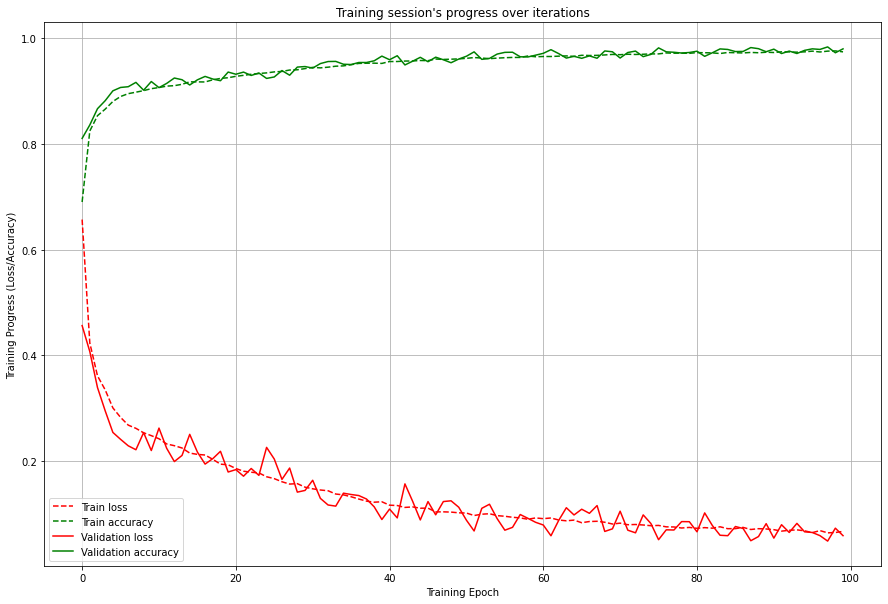

Model: "sequential_79"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_42 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_42 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_153 (Dropout)       (None, 512)               0         
                                                                 
 dense_158 (Dense)           (None, 64)                32832     
                                                                 
 dense_159 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 6s 11ms/step - loss: 0.0895 - accuracy: 0.9652 - val_loss: 0.1029 - val_accuracy: 0.9624
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0862 - accuracy: 0.9661 - val_loss: 0.0838 - val_accuracy: 0.9677
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0846 - accuracy: 0.9670 - val_loss: 0.0709 - val_accuracy: 0.9737
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0855 - accuracy: 0.9673 - val_loss: 0.0806 - val_accuracy: 0.9674
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0894 - accuracy: 0.9654 - val_loss: 0.1155 - val_accuracy: 0.9563
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0840 - accuracy: 0.9680 - val_loss: 0.0703 - val_accuracy: 0.9732
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0880 - accuracy: 0.9658 - val_loss: 0.0750 - val_accuracy: 0.972

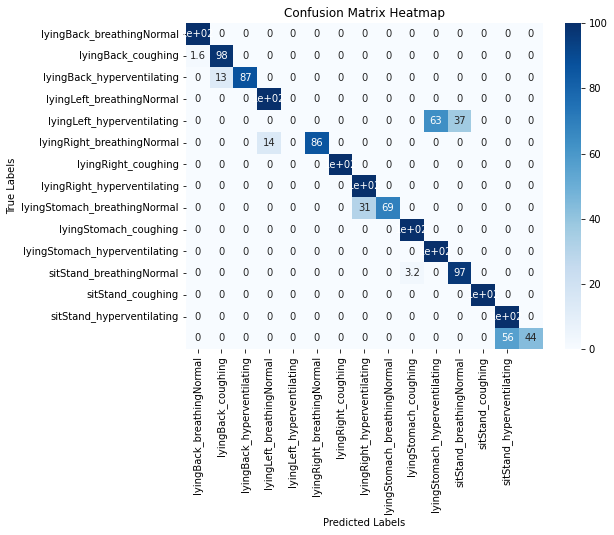

35/71 0.8469026548672567 0.8603965385354657


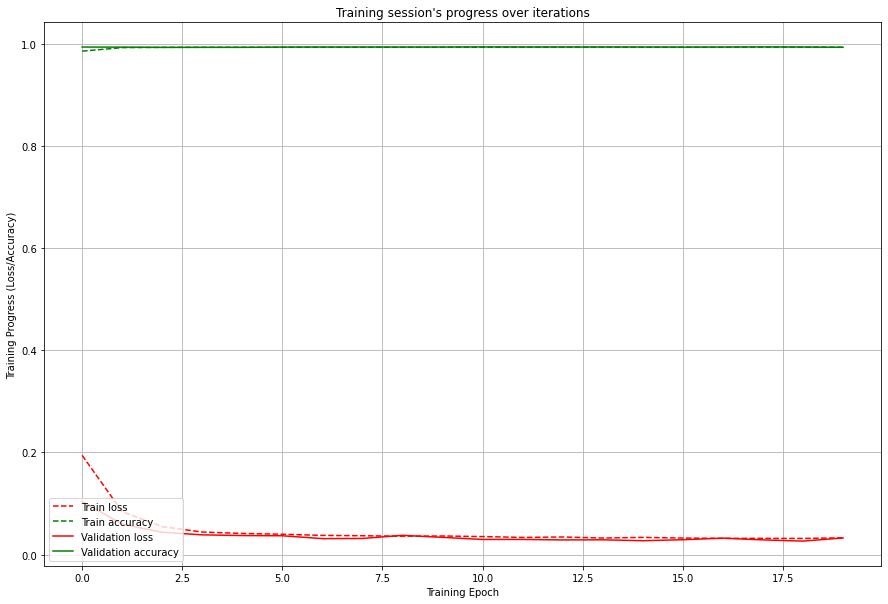

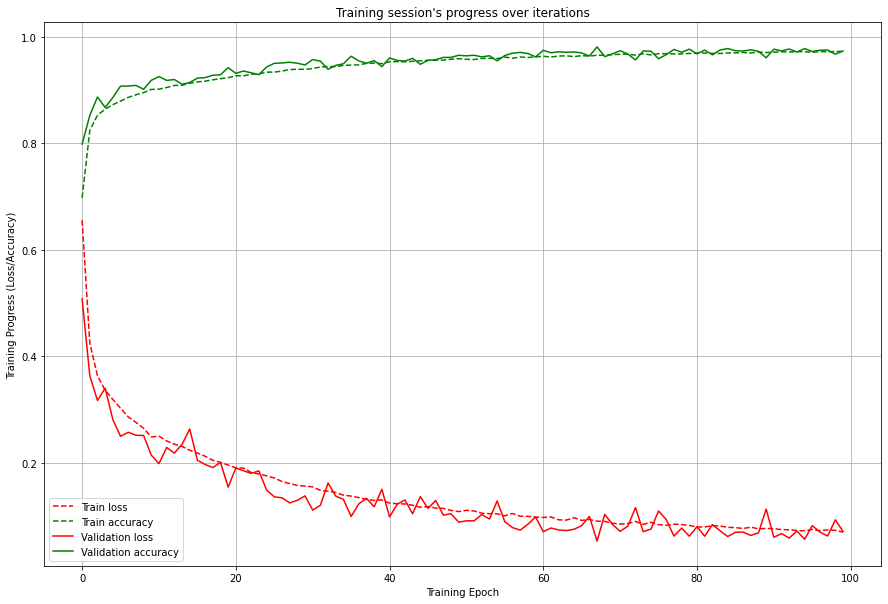

Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_43 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_43 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_157 (Dropout)       (None, 512)               0         
                                                                 
 dense_162 (Dense)           (None, 64)                32832     
                                                                 
 dense_163 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

494/494 [==============================] - 5s 11ms/step - loss: 0.0964 - accuracy: 0.9634 - val_loss: 0.0867 - val_accuracy: 0.9654
Epoch 70/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0946 - accuracy: 0.9639 - val_loss: 0.0782 - val_accuracy: 0.9688
Epoch 71/100
494/494 [==============================] - 5s 11ms/step - loss: 0.1006 - accuracy: 0.9608 - val_loss: 0.0599 - val_accuracy: 0.9783
Epoch 72/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0934 - accuracy: 0.9635 - val_loss: 0.0991 - val_accuracy: 0.9631
Epoch 73/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0912 - accuracy: 0.9652 - val_loss: 0.0557 - val_accuracy: 0.9773
Epoch 74/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0923 - accuracy: 0.9647 - val_loss: 0.0691 - val_accuracy: 0.9726
Epoch 75/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0920 - accuracy: 0.9646 - val_loss: 0.0894 - val_accuracy: 0.962

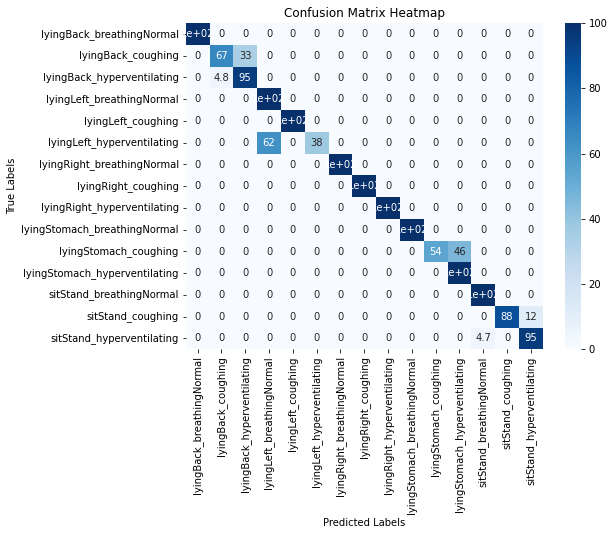

36/71 0.9002671415850401 0.8614741224016704


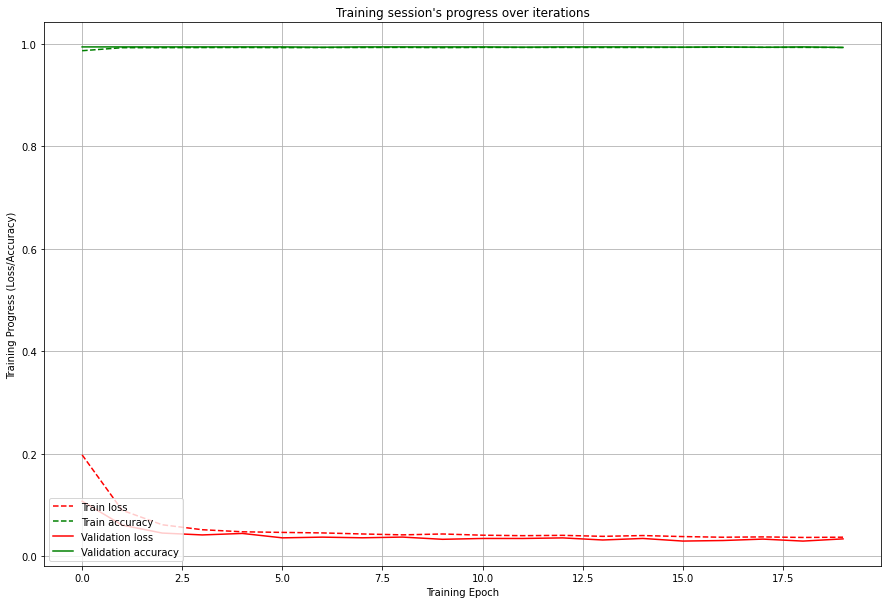

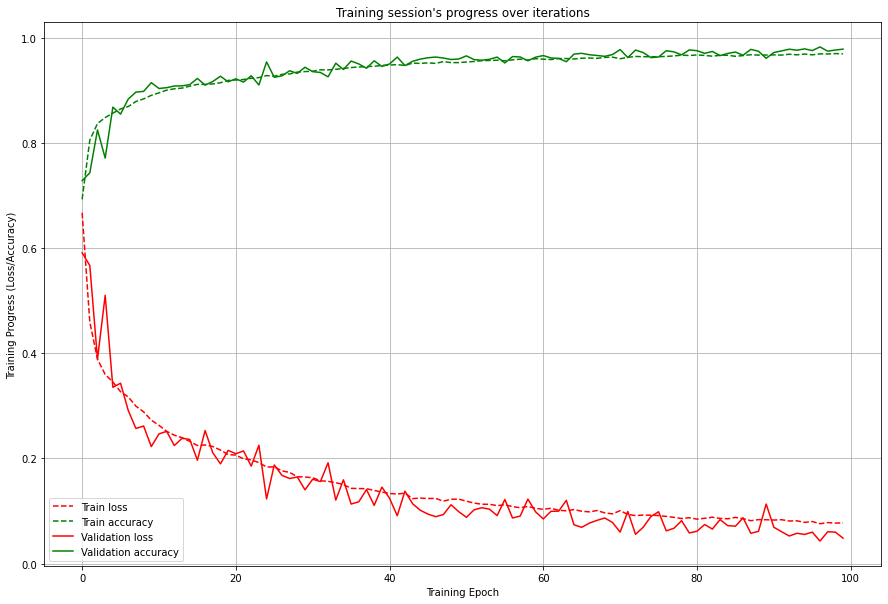

Model: "sequential_83"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_44 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_44 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_161 (Dropout)       (None, 512)               0         
                                                                 
 dense_166 (Dense)           (None, 64)                32832     
                                                                 
 dense_167 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0904 - accuracy: 0.9656 - val_loss: 0.0810 - val_accuracy: 0.9693
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0867 - accuracy: 0.9673 - val_loss: 0.0639 - val_accuracy: 0.9728
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0846 - accuracy: 0.9678 - val_loss: 0.0669 - val_accuracy: 0.9720
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0873 - accuracy: 0.9659 - val_loss: 0.0722 - val_accuracy: 0.9711
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0863 - accuracy: 0.9680 - val_loss: 0.0576 - val_accuracy: 0.9763
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0860 - accuracy: 0.9671 - val_loss: 0.0814 - val_accuracy: 0.9691
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0814 - accuracy: 0.9687 - val_loss: 0.0589 - val_accuracy: 0.975

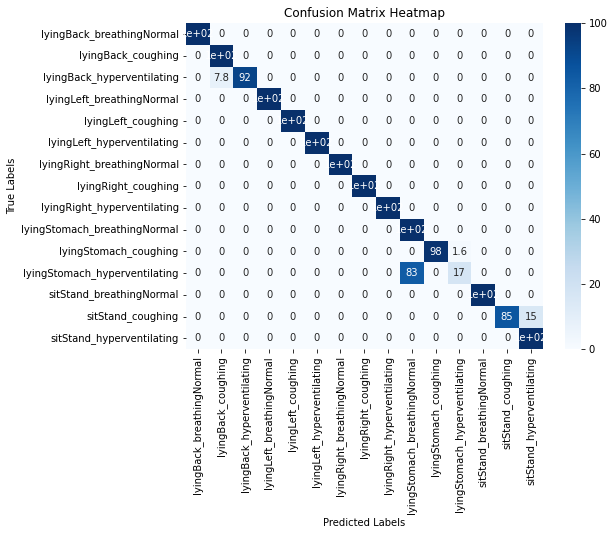

37/71 0.9322916666666666 0.8633377419875914


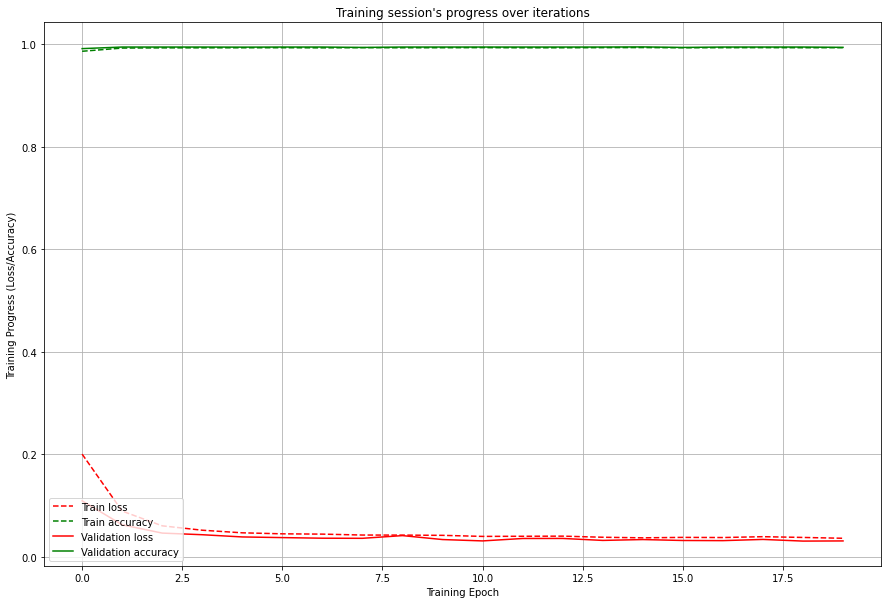

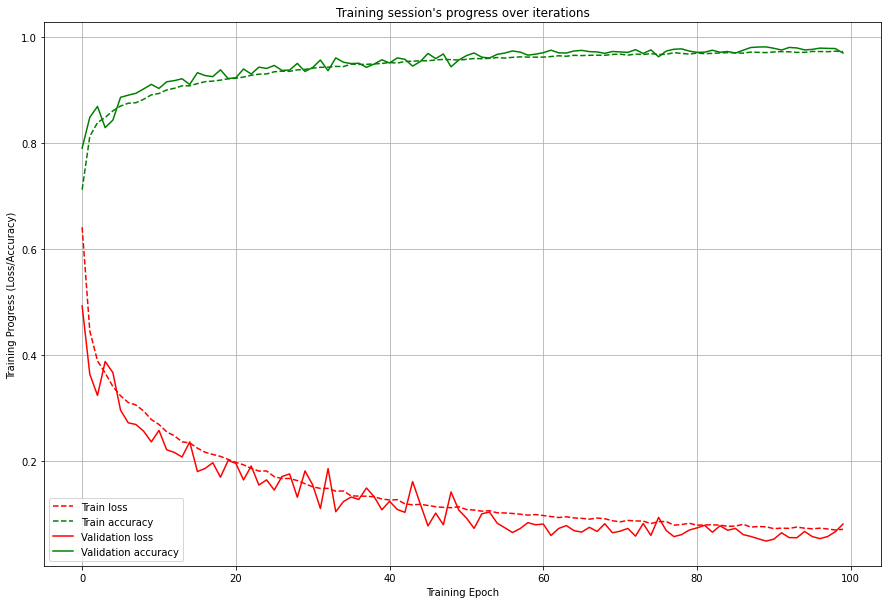

Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_45 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_45 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_165 (Dropout)       (None, 512)               0         
                                                                 
 dense_170 (Dense)           (None, 64)                32832     
                                                                 
 dense_171 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0903 - accuracy: 0.9657 - val_loss: 0.0877 - val_accuracy: 0.9640
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0900 - accuracy: 0.9648 - val_loss: 0.0549 - val_accuracy: 0.9785
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0875 - accuracy: 0.9662 - val_loss: 0.0583 - val_accuracy: 0.9779
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0892 - accuracy: 0.9651 - val_loss: 0.0646 - val_accuracy: 0.9764
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0830 - accuracy: 0.9678 - val_loss: 0.0620 - val_accuracy: 0.9762
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0889 - accuracy: 0.9666 - val_loss: 0.0557 - val_accuracy: 0.9778
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0875 - accuracy: 0.9662 - val_loss: 0.0732 - val_accuracy: 0.970

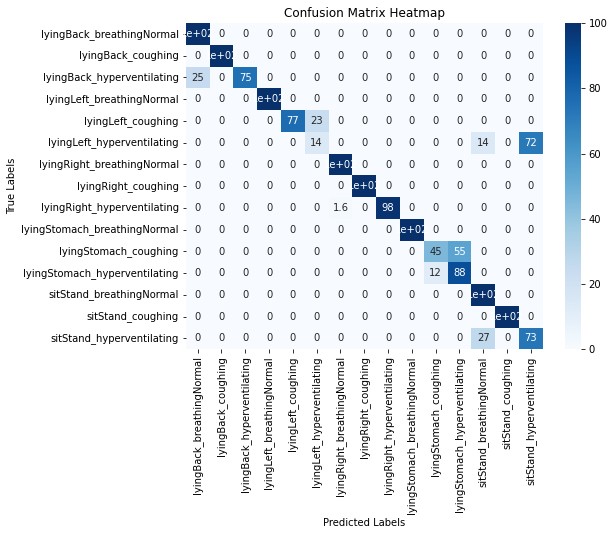

38/71 0.8576449912126538 0.8631917740190033


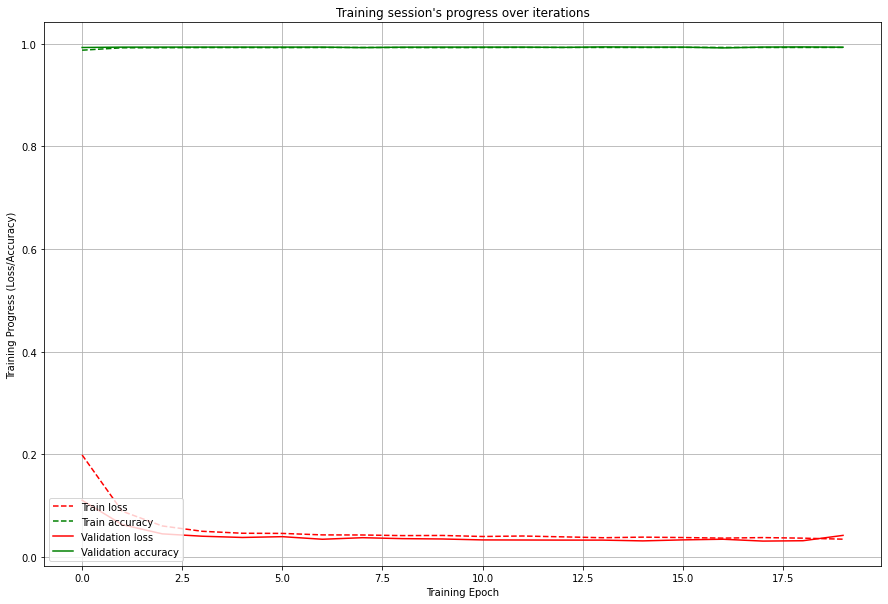

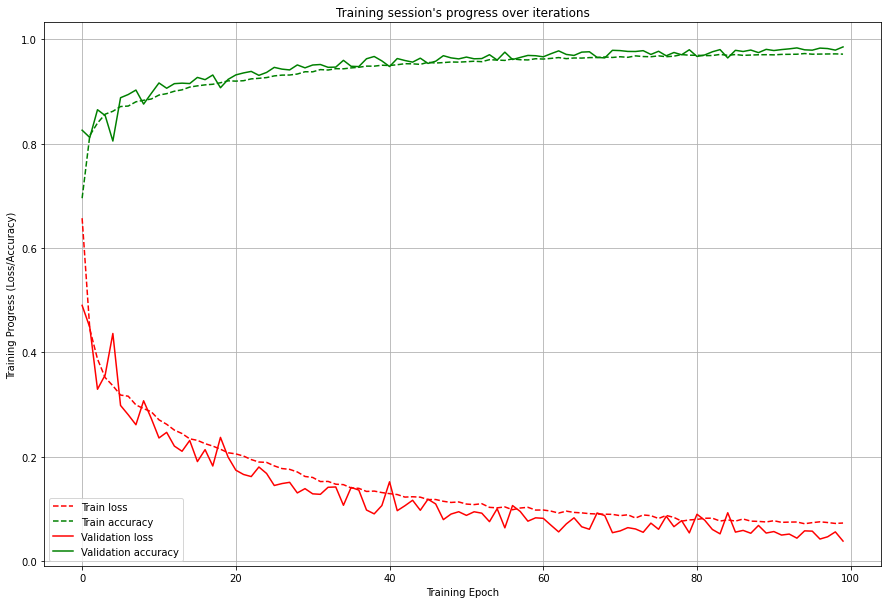

Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_46 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_46 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_169 (Dropout)       (None, 512)               0         
                                                                 
 dense_174 (Dense)           (None, 64)                32832     
                                                                 
 dense_175 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 6s 11ms/step - loss: 0.0880 - accuracy: 0.9658 - val_loss: 0.0756 - val_accuracy: 0.9704
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0877 - accuracy: 0.9658 - val_loss: 0.0630 - val_accuracy: 0.9775
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0862 - accuracy: 0.9669 - val_loss: 0.0577 - val_accuracy: 0.9770
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0820 - accuracy: 0.9688 - val_loss: 0.0771 - val_accuracy: 0.9701
Epoch 73/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0831 - accuracy: 0.9677 - val_loss: 0.0556 - val_accuracy: 0.9789
Epoch 74/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0840 - accuracy: 0.9683 - val_loss: 0.0531 - val_accuracy: 0.9792
Epoch 75/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0870 - accuracy: 0.9665 - val_loss: 0.0535 - val_accuracy: 0.979

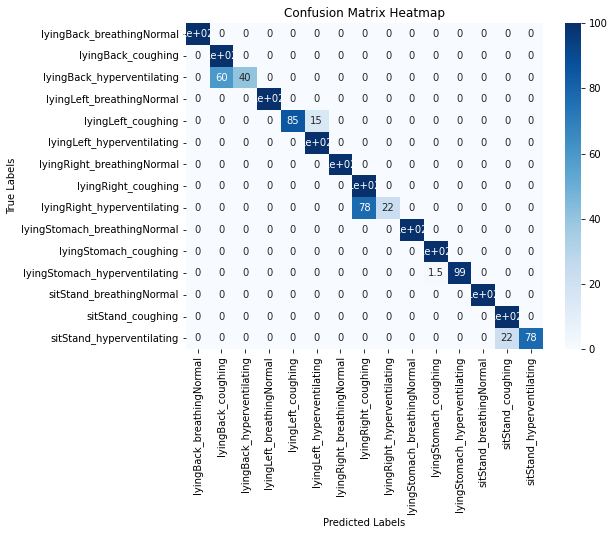

39/71 0.888129803586678 0.8638152247581952


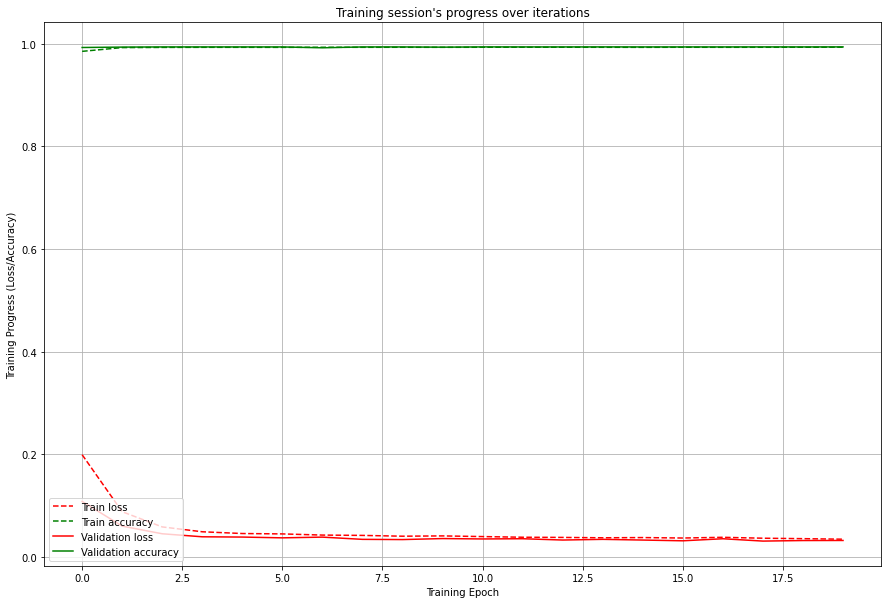

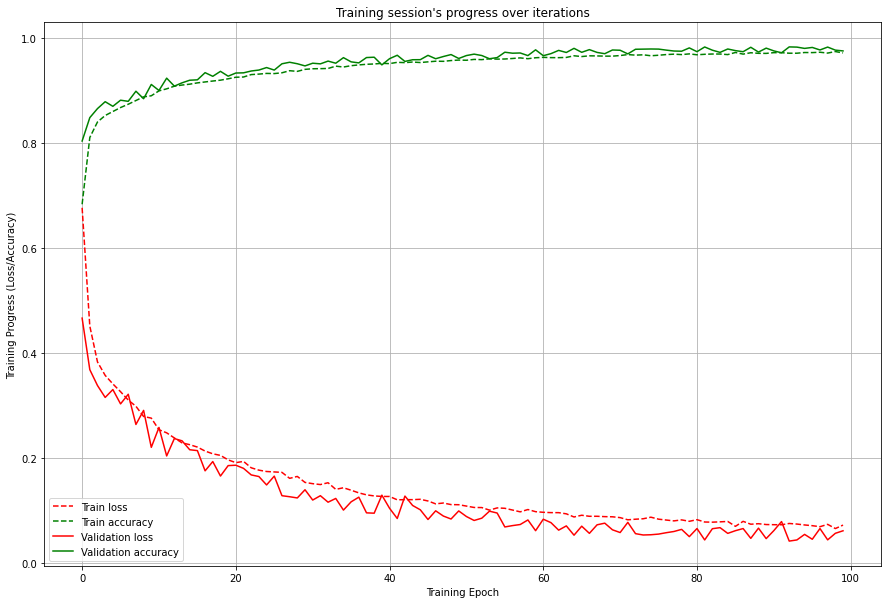

Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_47 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_47 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_173 (Dropout)       (None, 512)               0         
                                                                 
 dense_178 (Dense)           (None, 64)                32832     
                                                                 
 dense_179 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0918 - accuracy: 0.9647 - val_loss: 0.0676 - val_accuracy: 0.9722
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0905 - accuracy: 0.9658 - val_loss: 0.0879 - val_accuracy: 0.9659
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0950 - accuracy: 0.9639 - val_loss: 0.0692 - val_accuracy: 0.9756
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0894 - accuracy: 0.9649 - val_loss: 0.0778 - val_accuracy: 0.9705
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0884 - accuracy: 0.9657 - val_loss: 0.0868 - val_accuracy: 0.9689
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0916 - accuracy: 0.9651 - val_loss: 0.0804 - val_accuracy: 0.9682
Epoch 75/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0922 - accuracy: 0.9637 - val_loss: 0.0764 - val_accuracy: 0.970

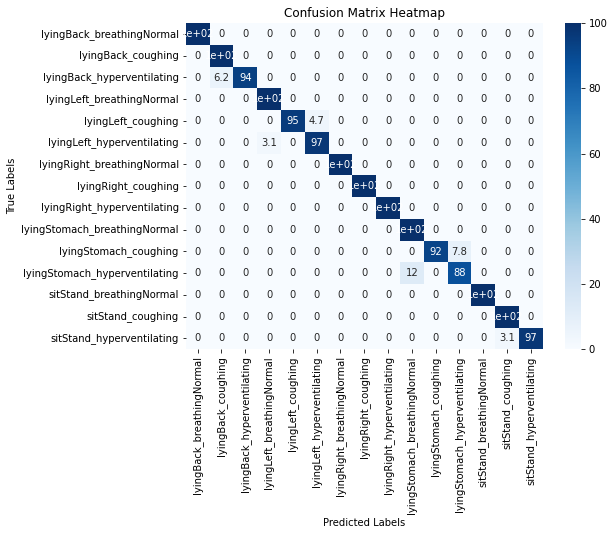

40/71 0.9774305555555556 0.8665863303873991


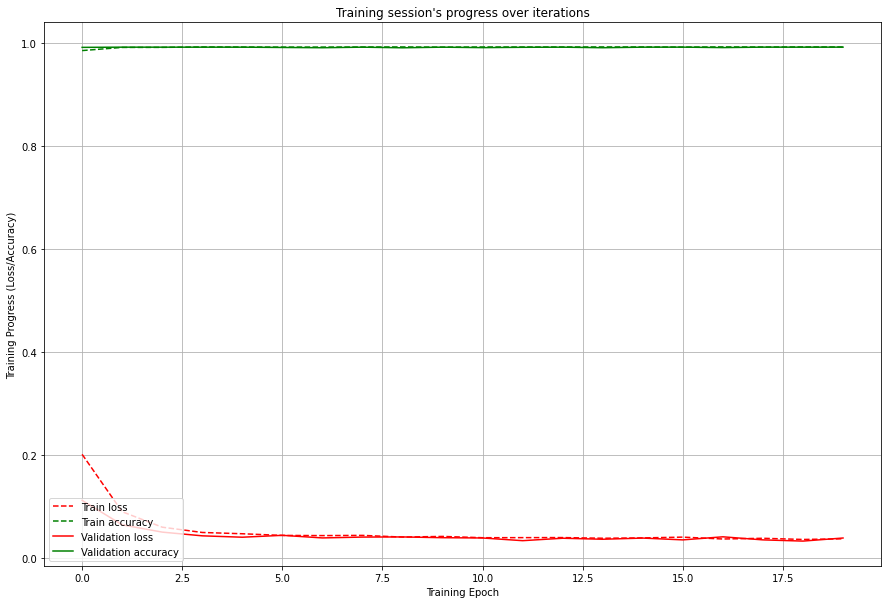

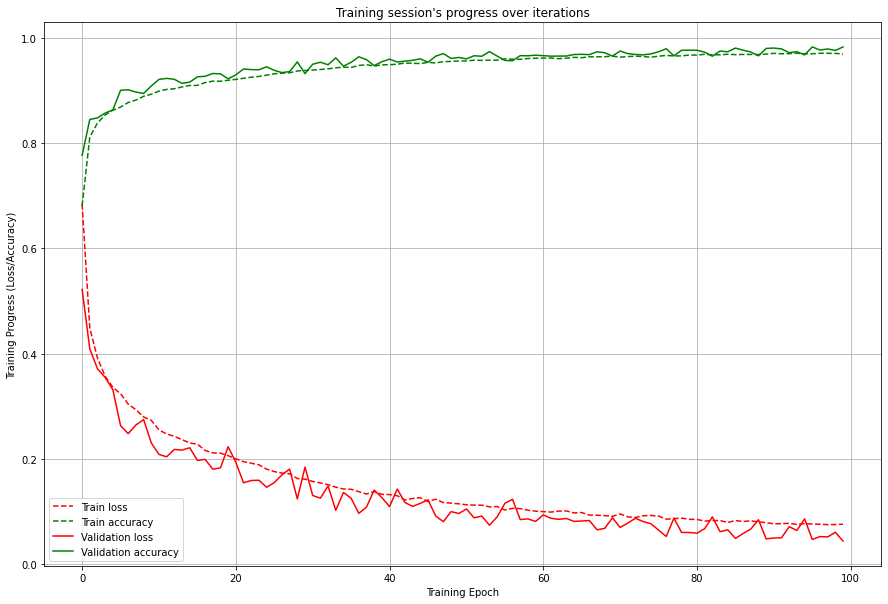

Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_48 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_48 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_177 (Dropout)       (None, 512)               0         
                                                                 
 dense_182 (Dense)           (None, 64)                32832     
                                                                 
 dense_183 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

496/496 [==============================] - 6s 11ms/step - loss: 0.0934 - accuracy: 0.9637 - val_loss: 0.0665 - val_accuracy: 0.9732
Epoch 70/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0874 - accuracy: 0.9663 - val_loss: 0.1495 - val_accuracy: 0.9477
Epoch 71/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0926 - accuracy: 0.9640 - val_loss: 0.0699 - val_accuracy: 0.9716
Epoch 72/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0923 - accuracy: 0.9647 - val_loss: 0.0642 - val_accuracy: 0.9751
Epoch 73/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0865 - accuracy: 0.9667 - val_loss: 0.0592 - val_accuracy: 0.9768
Epoch 74/100
496/496 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9674 - val_loss: 0.0773 - val_accuracy: 0.9683
Epoch 75/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0891 - accuracy: 0.9655 - val_loss: 0.0653 - val_accuracy: 0.975

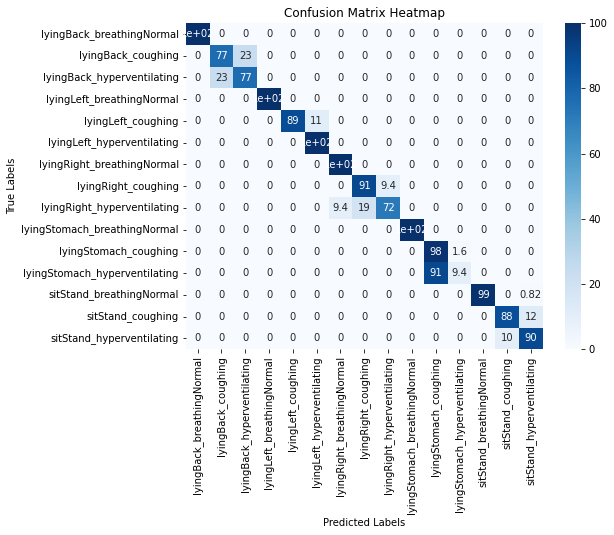

41/71 0.8694127957931639 0.8666536271827745


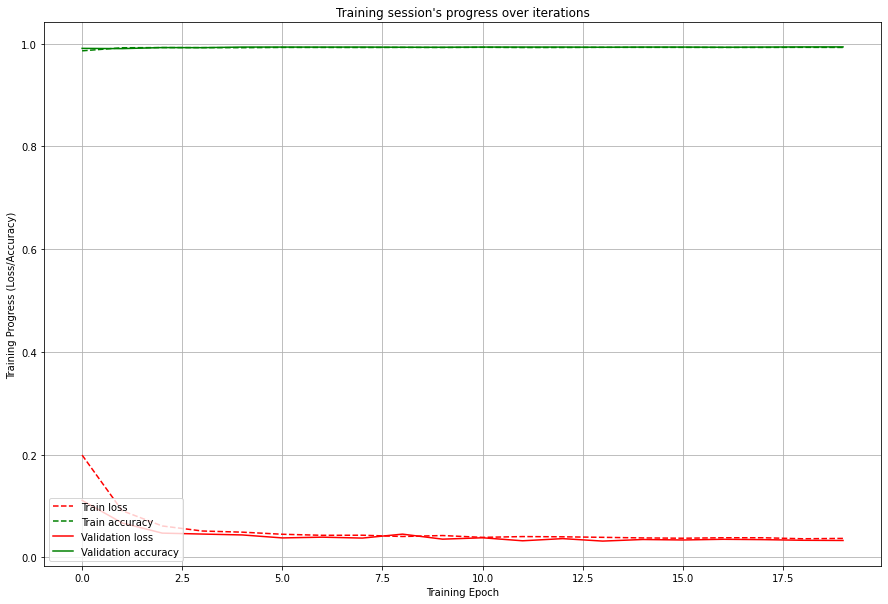

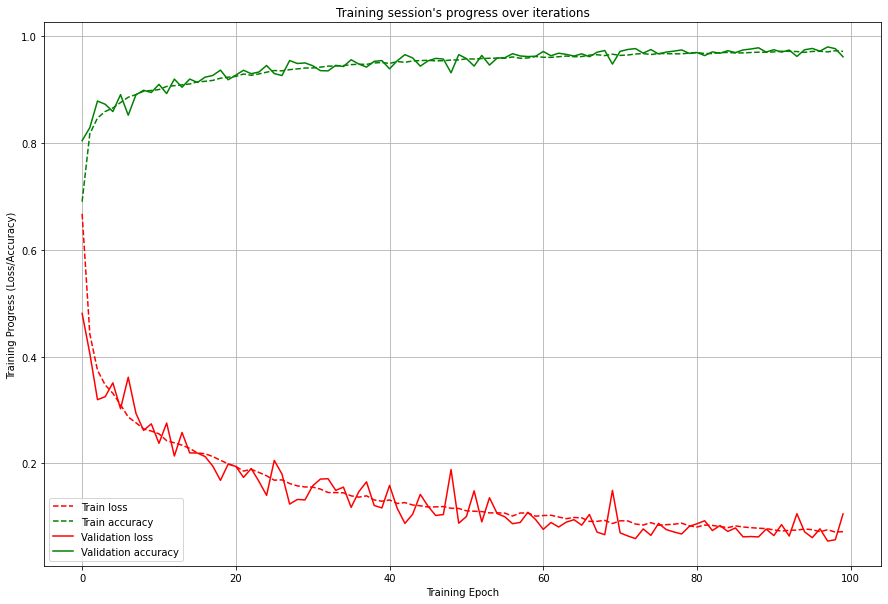

Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_49 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_49 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_181 (Dropout)       (None, 512)               0         
                                                                 
 dense_186 (Dense)           (None, 64)                32832     
                                                                 
 dense_187 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0885 - accuracy: 0.9666 - val_loss: 0.0827 - val_accuracy: 0.9687
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0880 - accuracy: 0.9664 - val_loss: 0.0682 - val_accuracy: 0.9724
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9660 - val_loss: 0.0760 - val_accuracy: 0.9710
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0876 - accuracy: 0.9664 - val_loss: 0.0941 - val_accuracy: 0.9672
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0843 - accuracy: 0.9681 - val_loss: 0.0904 - val_accuracy: 0.9668
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0865 - accuracy: 0.9677 - val_loss: 0.0812 - val_accuracy: 0.9713
Epoch 75/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0831 - accuracy: 0.9682 - val_loss: 0.0758 - val_accuracy: 0.970

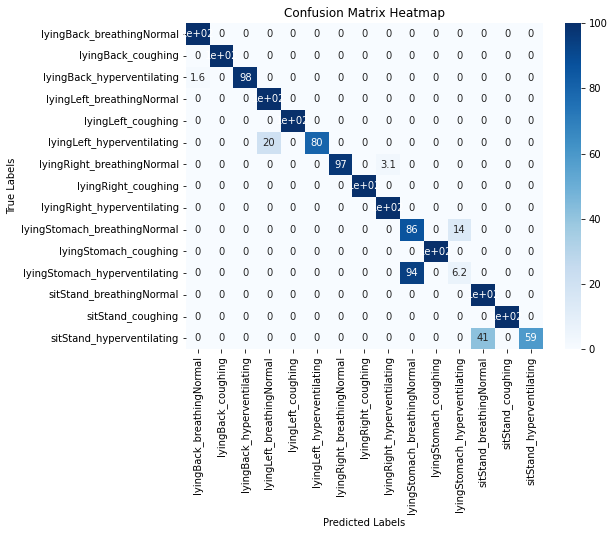

42/71 0.8802083333333334 0.8669688529072062


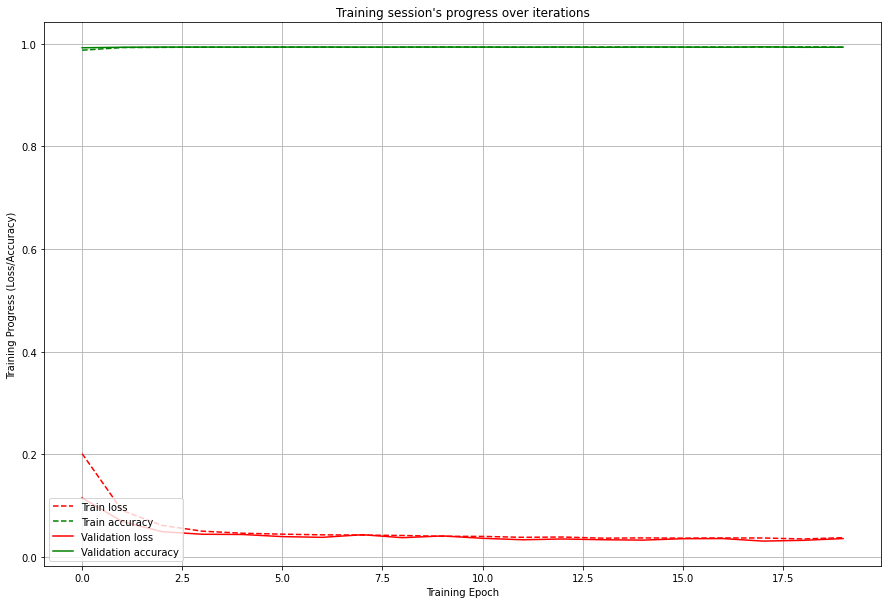

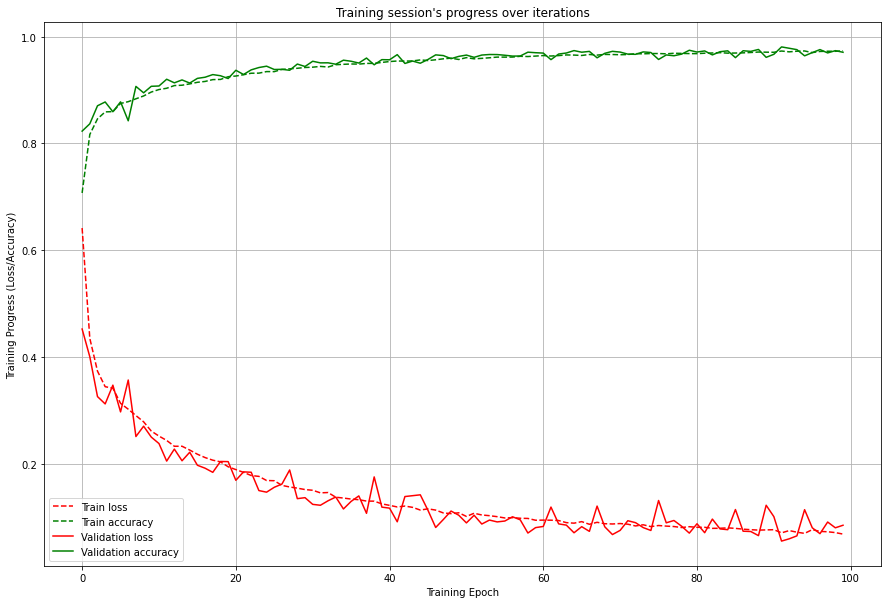

Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_50 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_50 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_185 (Dropout)       (None, 512)               0         
                                                                 
 dense_190 (Dense)           (None, 64)                32832     
                                                                 
 dense_191 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

495/495 [==============================] - 5s 11ms/step - loss: 0.0913 - accuracy: 0.9653 - val_loss: 0.0882 - val_accuracy: 0.9678
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0921 - accuracy: 0.9643 - val_loss: 0.0777 - val_accuracy: 0.9698
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0877 - accuracy: 0.9665 - val_loss: 0.0914 - val_accuracy: 0.9649
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0891 - accuracy: 0.9658 - val_loss: 0.0923 - val_accuracy: 0.9656
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0832 - accuracy: 0.9683 - val_loss: 0.0809 - val_accuracy: 0.9694
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0875 - accuracy: 0.9664 - val_loss: 0.0638 - val_accuracy: 0.9760
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9676 - val_loss: 0.0753 - val_accuracy: 0.969

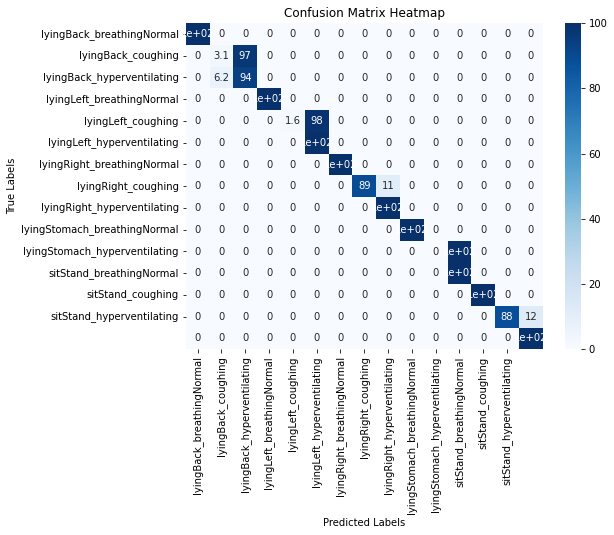

43/71 0.8133680555555556 0.865750652967396


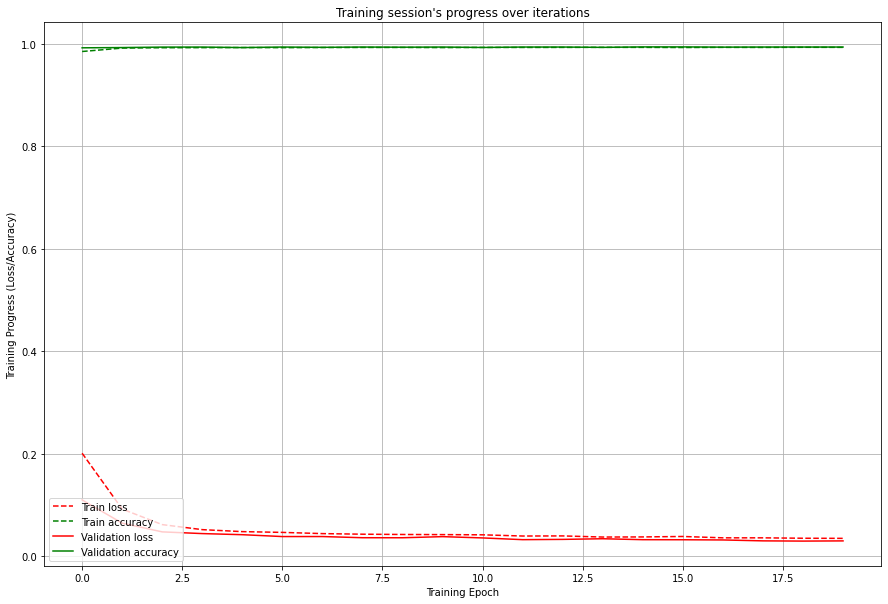

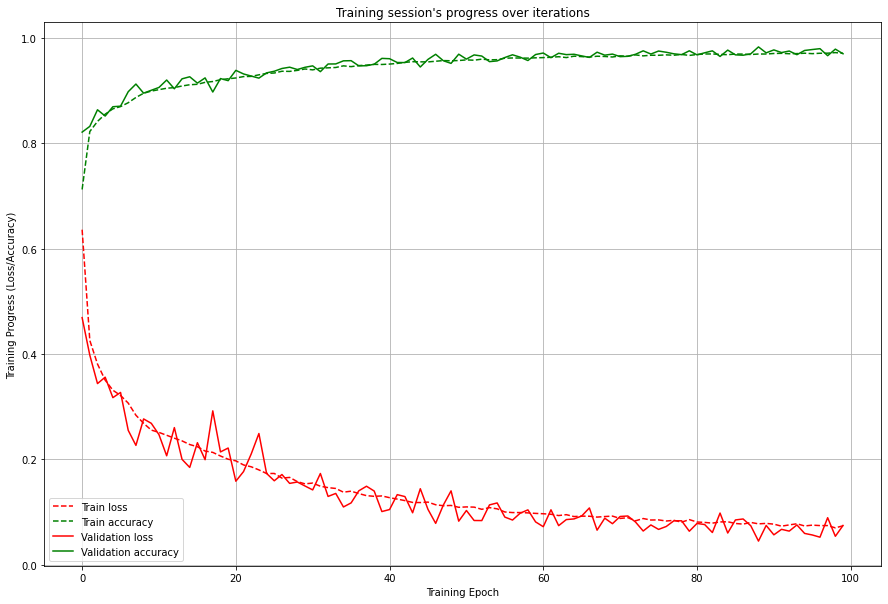

Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_51 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_51 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_189 (Dropout)       (None, 512)               0         
                                                                 
 dense_194 (Dense)           (None, 64)                32832     
                                                                 
 dense_195 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

496/496 [==============================] - 6s 11ms/step - loss: 0.0921 - accuracy: 0.9643 - val_loss: 0.0708 - val_accuracy: 0.9718
Epoch 70/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0921 - accuracy: 0.9643 - val_loss: 0.0926 - val_accuracy: 0.9638
Epoch 71/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0889 - accuracy: 0.9658 - val_loss: 0.0859 - val_accuracy: 0.9665
Epoch 72/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0879 - accuracy: 0.9663 - val_loss: 0.0877 - val_accuracy: 0.9660
Epoch 73/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0864 - accuracy: 0.9664 - val_loss: 0.0772 - val_accuracy: 0.9717
Epoch 74/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0875 - accuracy: 0.9662 - val_loss: 0.0771 - val_accuracy: 0.9693
Epoch 75/100
496/496 [==============================] - 6s 11ms/step - loss: 0.0842 - accuracy: 0.9673 - val_loss: 0.0589 - val_accuracy: 0.978

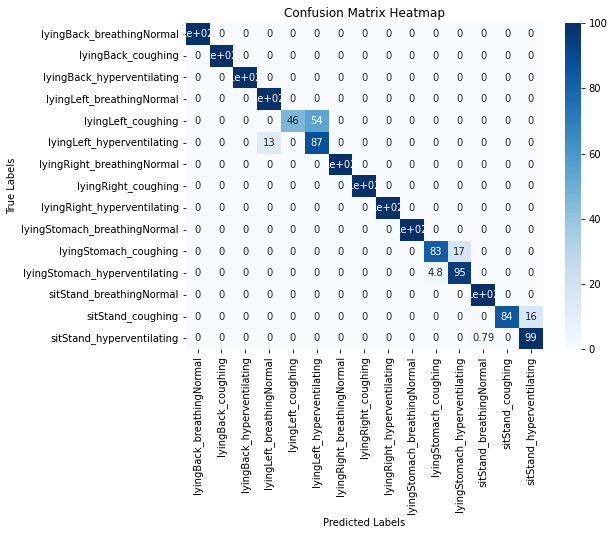

44/71 0.9319186560565871 0.8672210530360447


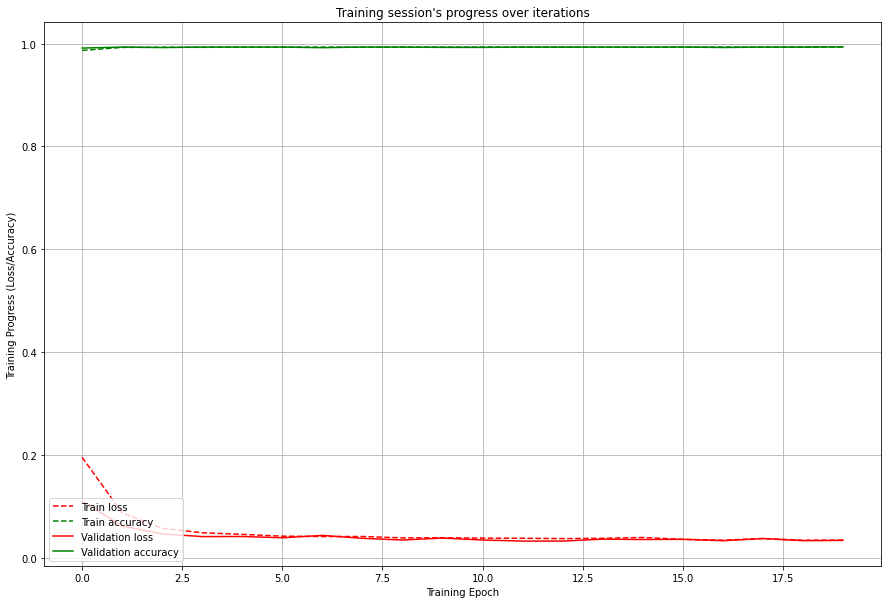

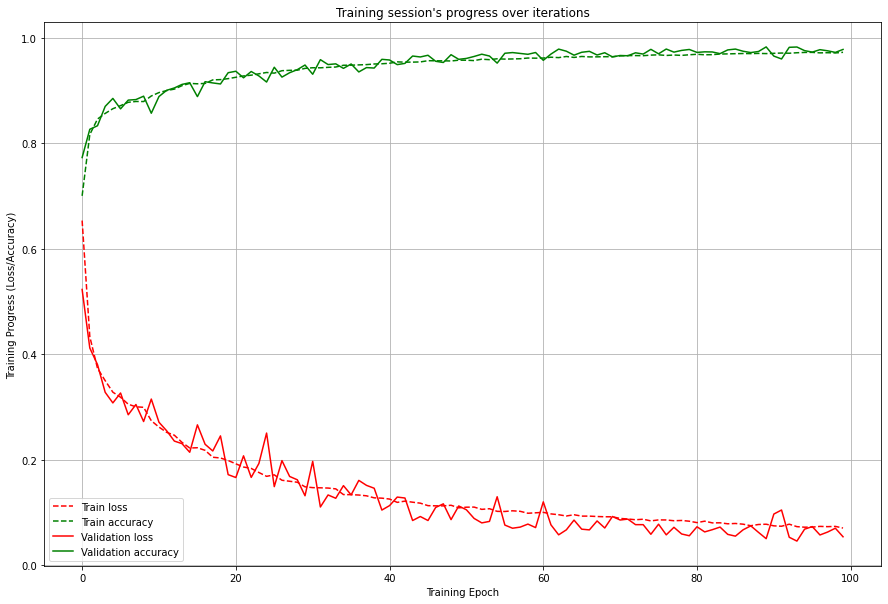

Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_52 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_52 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_193 (Dropout)       (None, 512)               0         
                                                                 
 dense_198 (Dense)           (None, 64)                32832     
                                                                 
 dense_199 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

494/494 [==============================] - 5s 11ms/step - loss: 0.0911 - accuracy: 0.9644 - val_loss: 0.0794 - val_accuracy: 0.9688
Epoch 70/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0919 - accuracy: 0.9657 - val_loss: 0.0810 - val_accuracy: 0.9698
Epoch 71/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0929 - accuracy: 0.9648 - val_loss: 0.0822 - val_accuracy: 0.9690
Epoch 72/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0881 - accuracy: 0.9663 - val_loss: 0.0918 - val_accuracy: 0.9653
Epoch 73/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0901 - accuracy: 0.9655 - val_loss: 0.0577 - val_accuracy: 0.9771
Epoch 74/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0886 - accuracy: 0.9657 - val_loss: 0.0562 - val_accuracy: 0.9782
Epoch 75/100
494/494 [==============================] - 5s 11ms/step - loss: 0.0900 - accuracy: 0.9658 - val_loss: 0.0787 - val_accuracy: 0.970

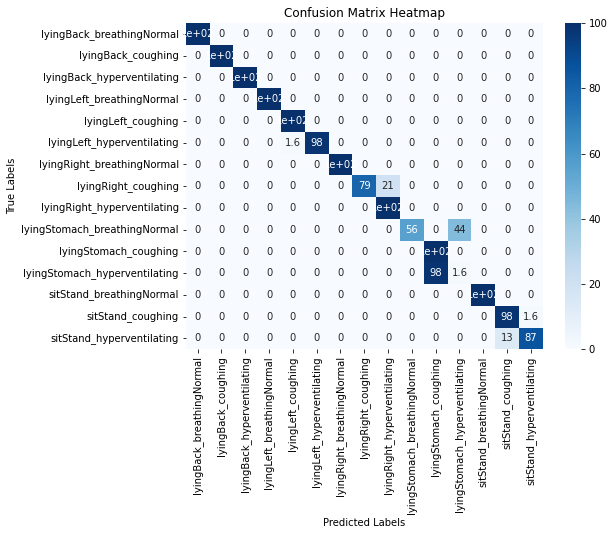

45/71 0.891725352112676 0.8677537551898845


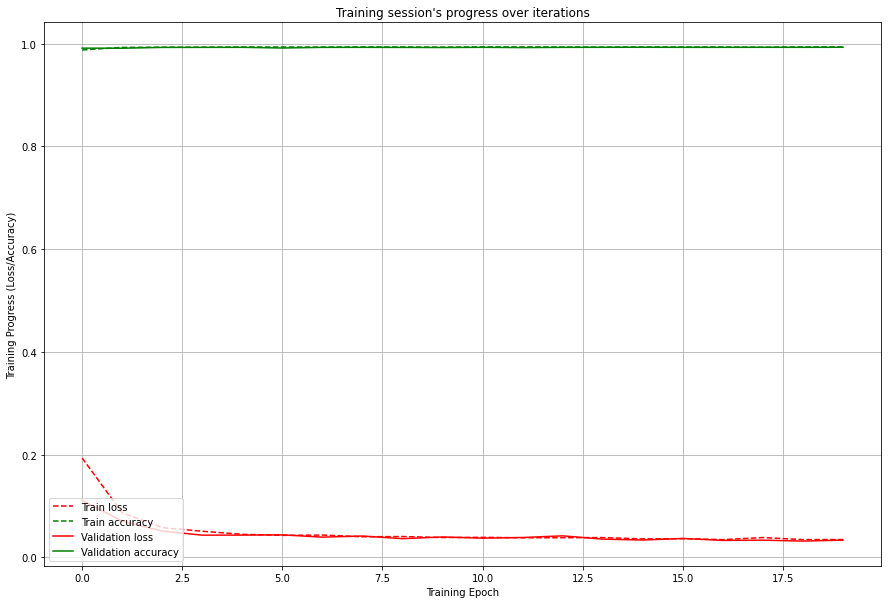

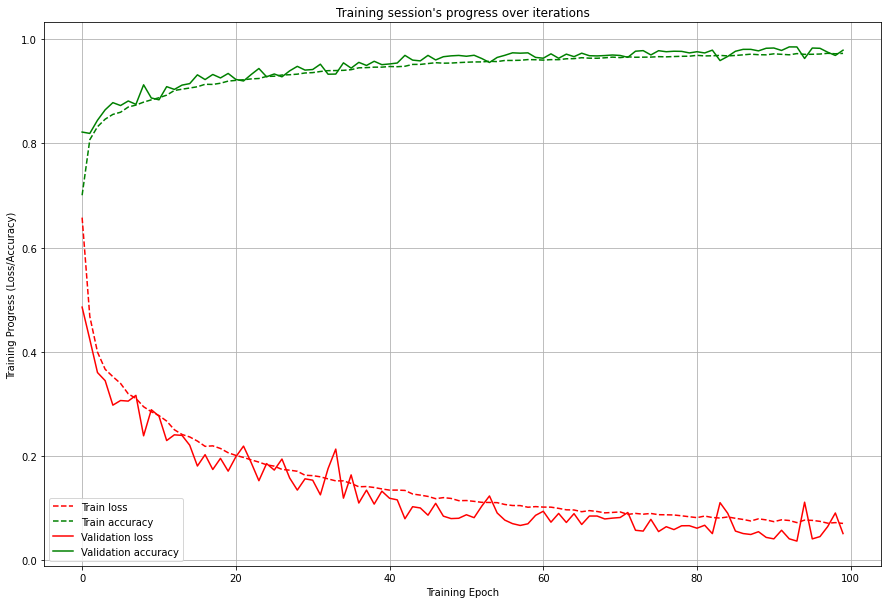

Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_53 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_53 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_197 (Dropout)       (None, 512)               0         
                                                                 
 dense_202 (Dense)           (None, 64)                32832     
                                                                 
 dense_203 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0903 - accuracy: 0.9643 - val_loss: 0.0637 - val_accuracy: 0.9743
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0875 - accuracy: 0.9667 - val_loss: 0.0691 - val_accuracy: 0.9726
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0860 - accuracy: 0.9665 - val_loss: 0.0662 - val_accuracy: 0.9733
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0877 - accuracy: 0.9657 - val_loss: 0.0683 - val_accuracy: 0.9742
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0878 - accuracy: 0.9661 - val_loss: 0.0580 - val_accuracy: 0.9774
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0836 - accuracy: 0.9679 - val_loss: 0.0595 - val_accuracy: 0.9775
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0848 - accuracy: 0.9672 - val_loss: 0.0680 - val_accuracy: 0.974

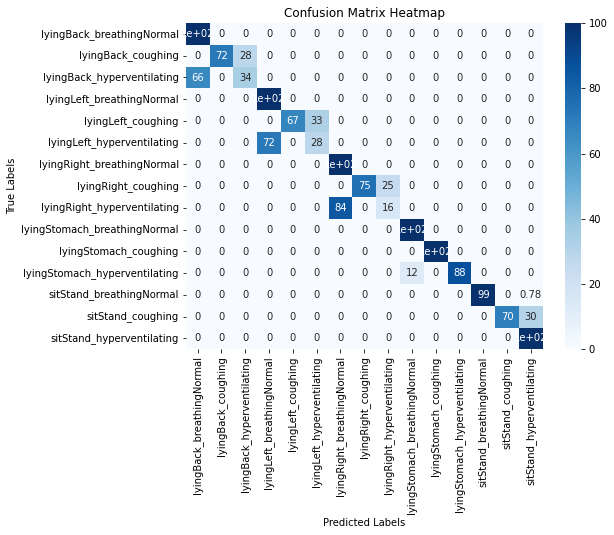

46/71 0.7873263888888888 0.8660425346302888


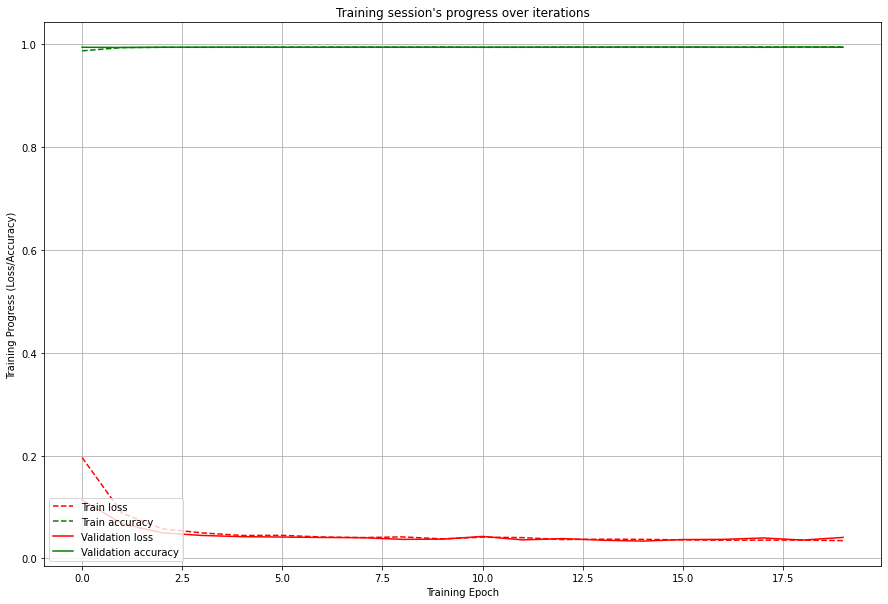

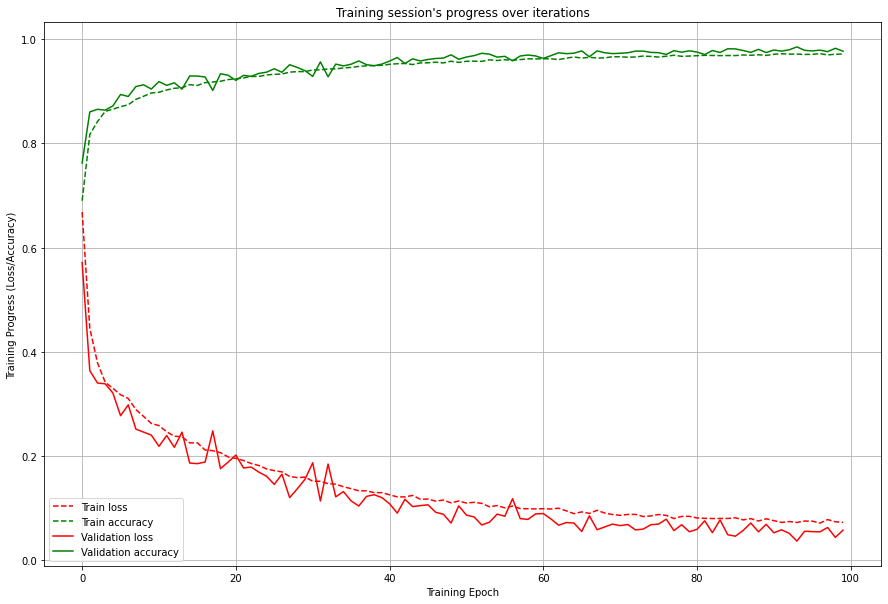

Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_54 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_54 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_201 (Dropout)       (None, 512)               0         
                                                                 
 dense_206 (Dense)           (None, 64)                32832     
                                                                 
 dense_207 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0873 - accuracy: 0.9658 - val_loss: 0.0897 - val_accuracy: 0.9669
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0827 - accuracy: 0.9680 - val_loss: 0.0865 - val_accuracy: 0.9659
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0864 - accuracy: 0.9669 - val_loss: 0.0813 - val_accuracy: 0.9669
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0847 - accuracy: 0.9675 - val_loss: 0.0709 - val_accuracy: 0.9701
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0879 - accuracy: 0.9661 - val_loss: 0.0616 - val_accuracy: 0.9746
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0853 - accuracy: 0.9667 - val_loss: 0.0521 - val_accuracy: 0.9787
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0835 - accuracy: 0.9672 - val_loss: 0.0729 - val_accuracy: 0.970

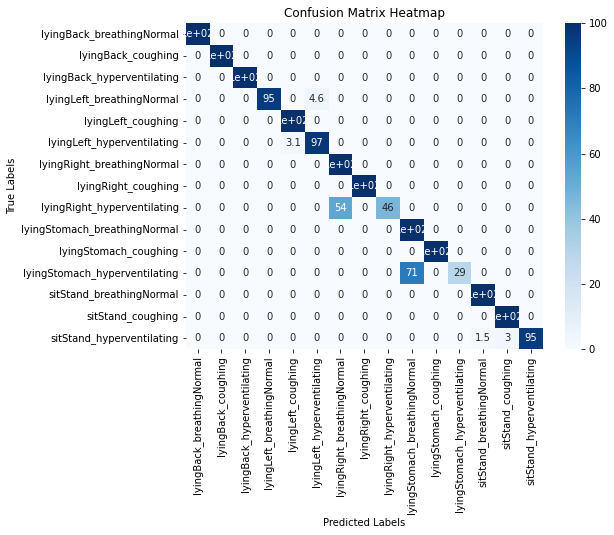

47/71 0.9196891191709845 0.8671601718082197


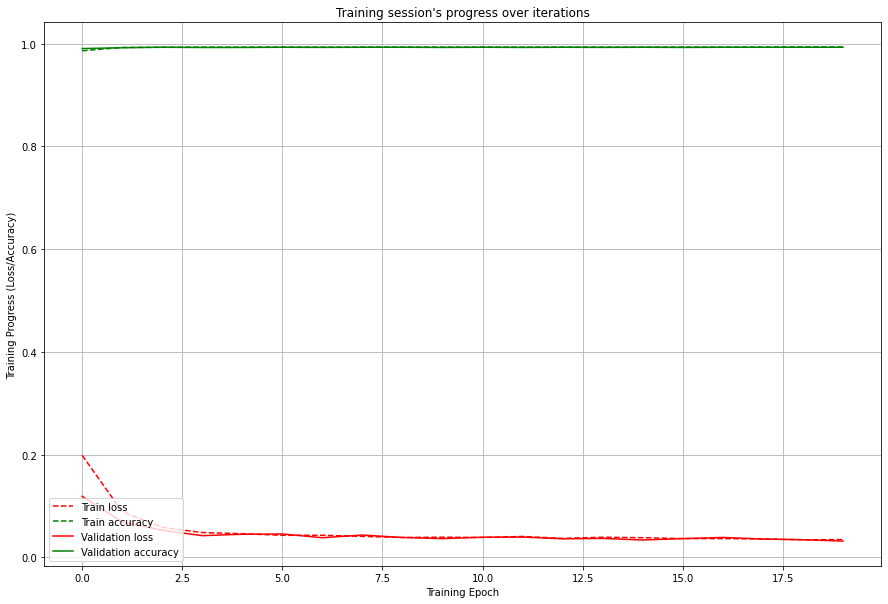

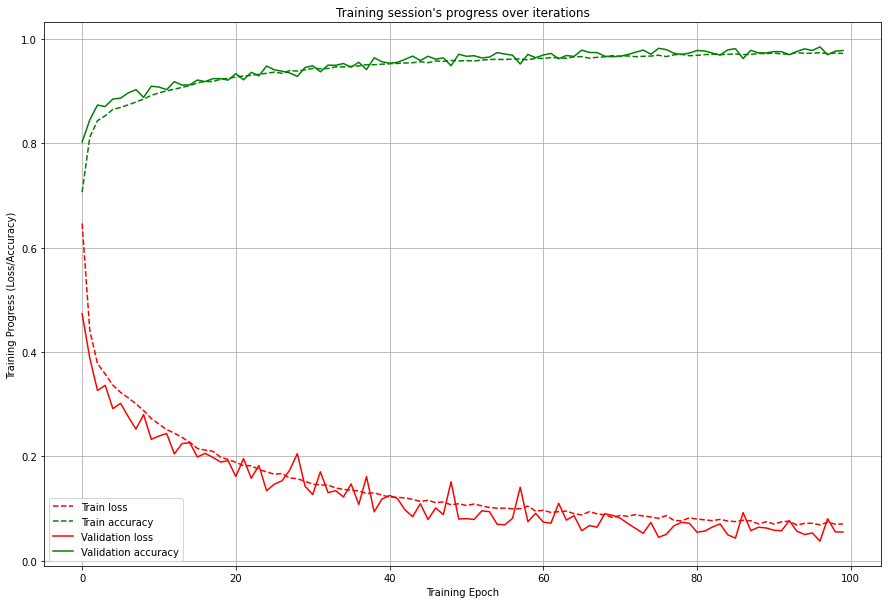

Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_55 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_55 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_205 (Dropout)       (None, 512)               0         
                                                                 
 dense_210 (Dense)           (None, 64)                32832     
                                                                 
 dense_211 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0905 - accuracy: 0.9654 - val_loss: 0.0566 - val_accuracy: 0.9781
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0865 - accuracy: 0.9664 - val_loss: 0.0631 - val_accuracy: 0.9758
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0862 - accuracy: 0.9671 - val_loss: 0.0573 - val_accuracy: 0.9771
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0871 - accuracy: 0.9661 - val_loss: 0.0783 - val_accuracy: 0.9716
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0887 - accuracy: 0.9653 - val_loss: 0.0742 - val_accuracy: 0.9697
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0844 - accuracy: 0.9673 - val_loss: 0.0556 - val_accuracy: 0.9785
Epoch 75/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0872 - accuracy: 0.9662 - val_loss: 0.0666 - val_accuracy: 0.973

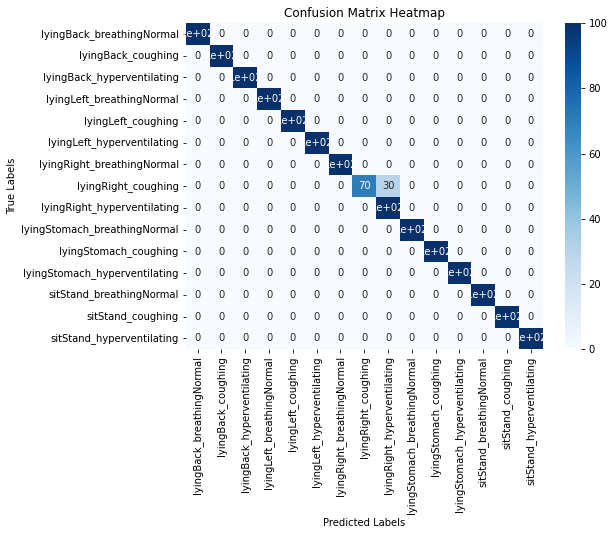

48/71 0.9835069444444444 0.8695345957395711


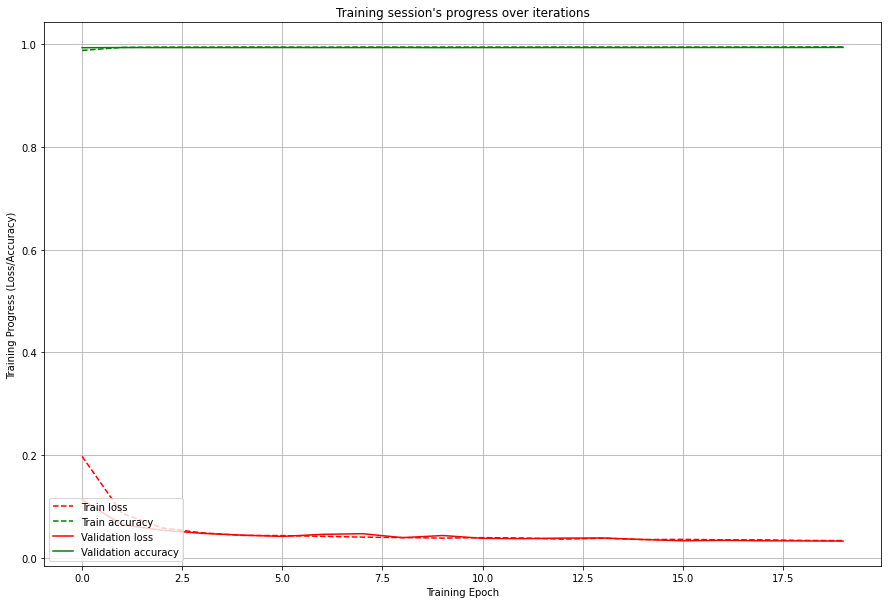

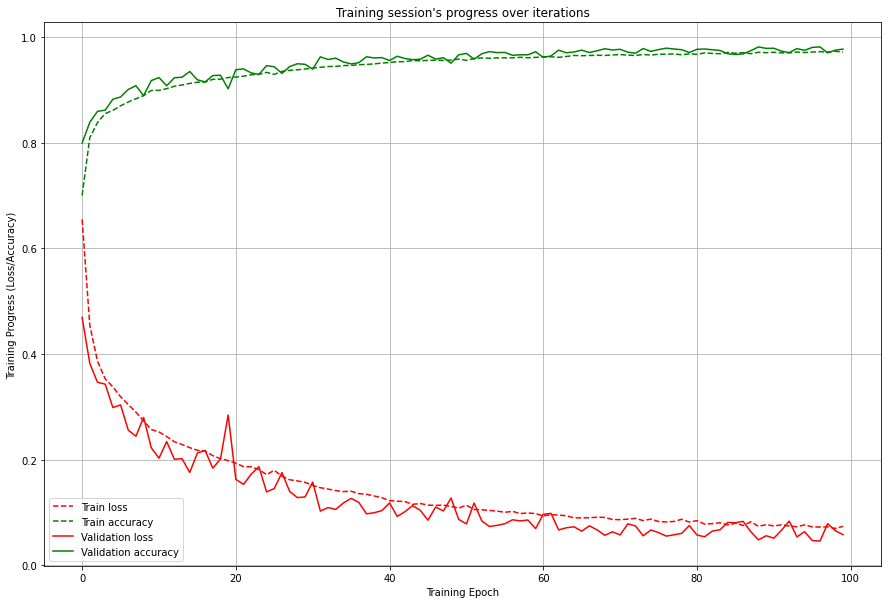

Model: "sequential_107"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_56 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_56 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_209 (Dropout)       (None, 512)               0         
                                                                 
 dense_214 (Dense)           (None, 64)                32832     
                                                                 
 dense_215 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 12ms/step - loss: 0.0875 - accuracy: 0.9660 - val_loss: 0.0558 - val_accuracy: 0.9781
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9660 - val_loss: 0.0621 - val_accuracy: 0.9760
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0900 - accuracy: 0.9646 - val_loss: 0.0702 - val_accuracy: 0.9718
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9669 - val_loss: 0.0806 - val_accuracy: 0.9686
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0857 - accuracy: 0.9670 - val_loss: 0.0772 - val_accuracy: 0.9699
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0865 - accuracy: 0.9668 - val_loss: 0.0542 - val_accuracy: 0.9799
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0863 - accuracy: 0.9660 - val_loss: 0.0847 - val_accuracy: 0.965

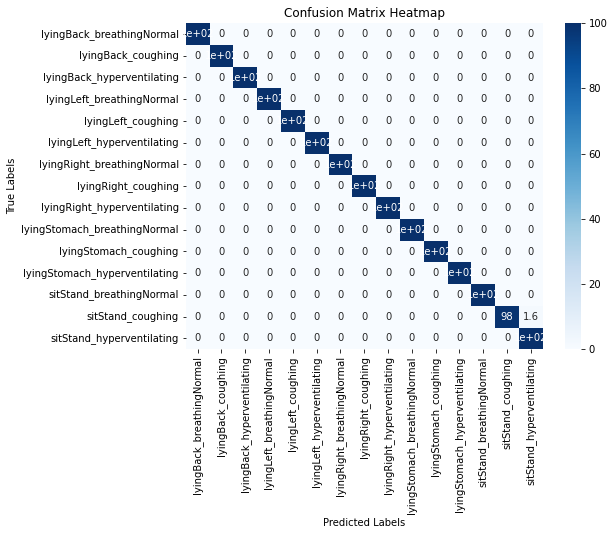

49/71 0.9982638888888888 0.8721091816025575


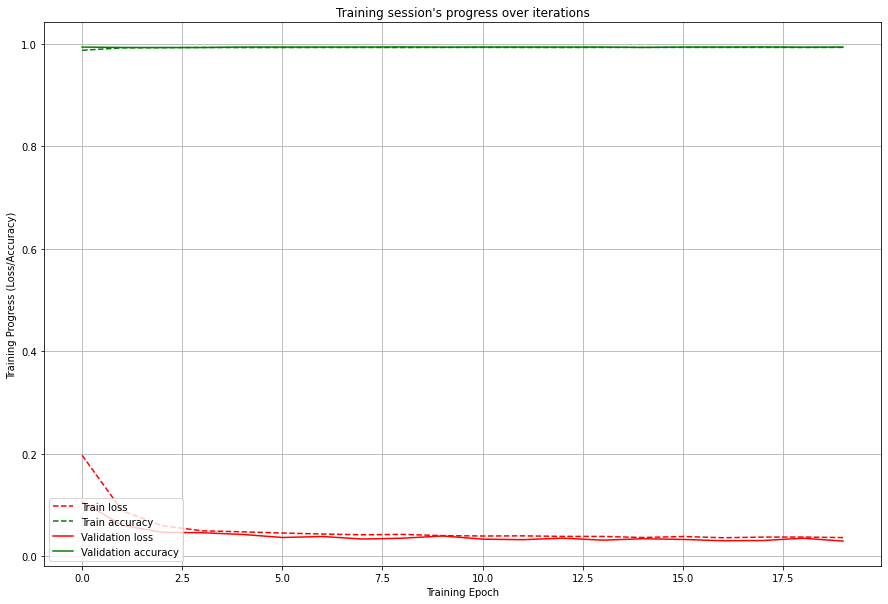

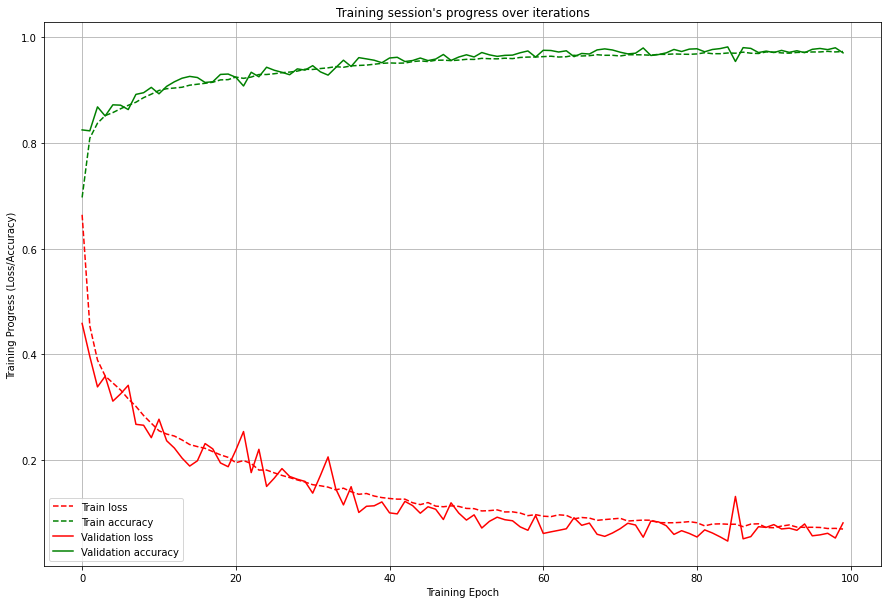

Model: "sequential_109"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_57 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_57 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_213 (Dropout)       (None, 512)               0         
                                                                 
 dense_218 (Dense)           (None, 64)                32832     
                                                                 
 dense_219 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0942 - accuracy: 0.9643 - val_loss: 0.0746 - val_accuracy: 0.9711
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0968 - accuracy: 0.9630 - val_loss: 0.0828 - val_accuracy: 0.9672
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0911 - accuracy: 0.9651 - val_loss: 0.0939 - val_accuracy: 0.9651
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0919 - accuracy: 0.9650 - val_loss: 0.0706 - val_accuracy: 0.9715
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0892 - accuracy: 0.9655 - val_loss: 0.0649 - val_accuracy: 0.9740
Epoch 74/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0906 - accuracy: 0.9645 - val_loss: 0.0755 - val_accuracy: 0.9707
Epoch 75/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0908 - accuracy: 0.9650 - val_loss: 0.0616 - val_accuracy: 0.977

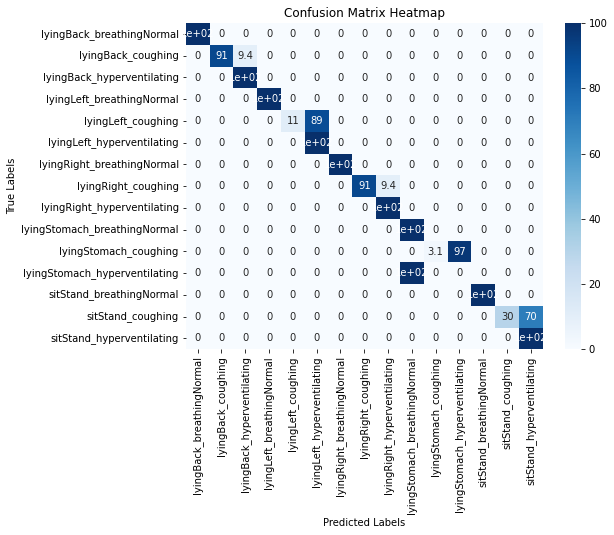

50/71 0.7526041666666666 0.8697659460155791


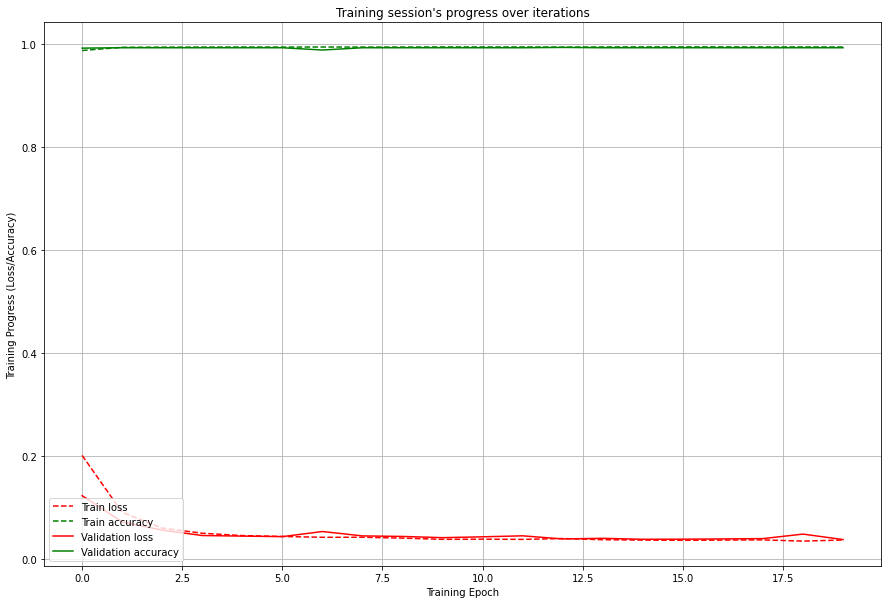

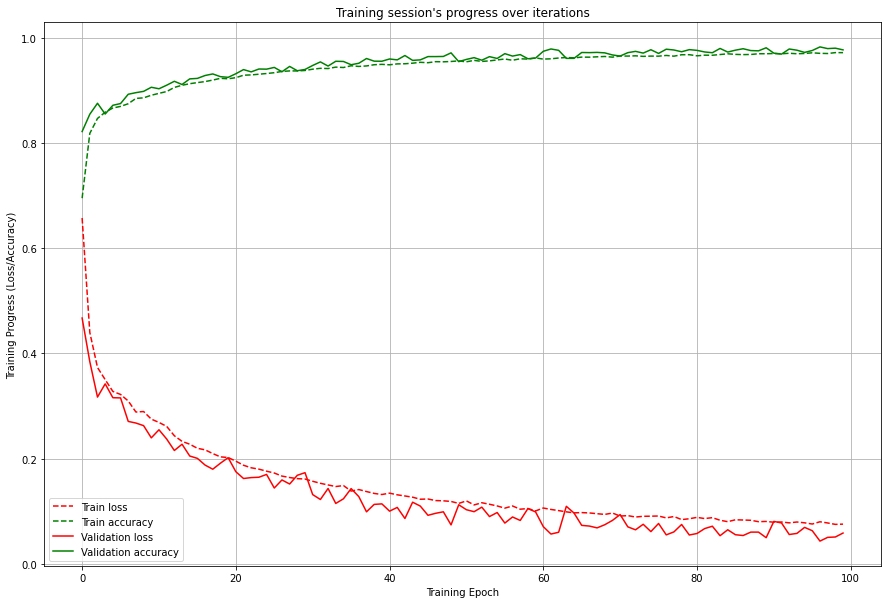

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_58 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_58 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_217 (Dropout)       (None, 512)               0         
                                                                 
 dense_222 (Dense)           (None, 64)                32832     
                                                                 
 dense_223 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0917 - accuracy: 0.9646 - val_loss: 0.1011 - val_accuracy: 0.9654
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0918 - accuracy: 0.9648 - val_loss: 0.0843 - val_accuracy: 0.9695
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0864 - accuracy: 0.9657 - val_loss: 0.0854 - val_accuracy: 0.9736
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0874 - accuracy: 0.9663 - val_loss: 0.0674 - val_accuracy: 0.9763
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0901 - accuracy: 0.9653 - val_loss: 0.0894 - val_accuracy: 0.9680
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0855 - accuracy: 0.9668 - val_loss: 0.0903 - val_accuracy: 0.9665
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0848 - accuracy: 0.9668 - val_loss: 0.0665 - val_accuracy: 0.975

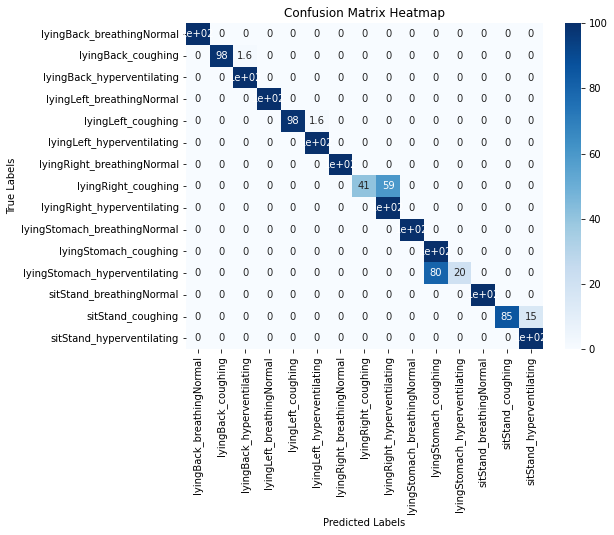

51/71 0.9045138888888888 0.8704341756862196


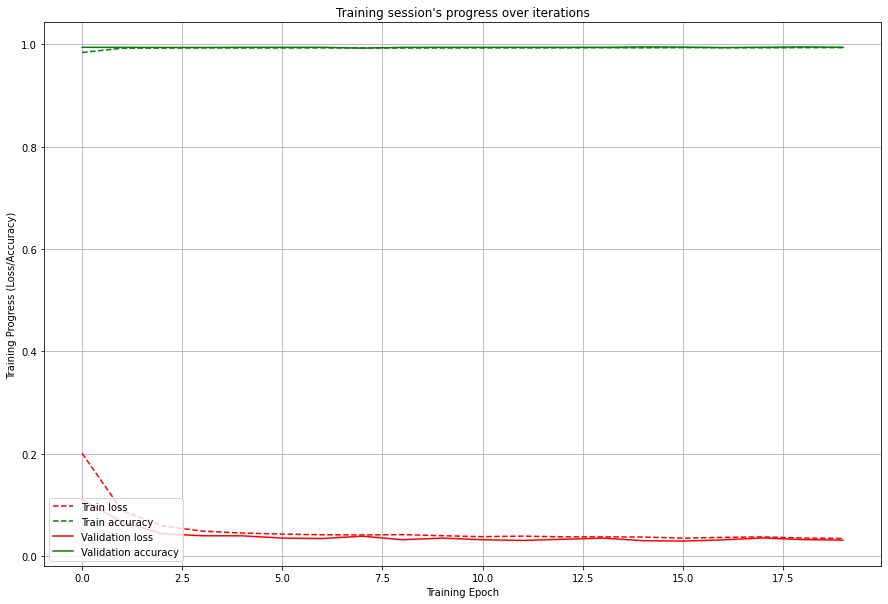

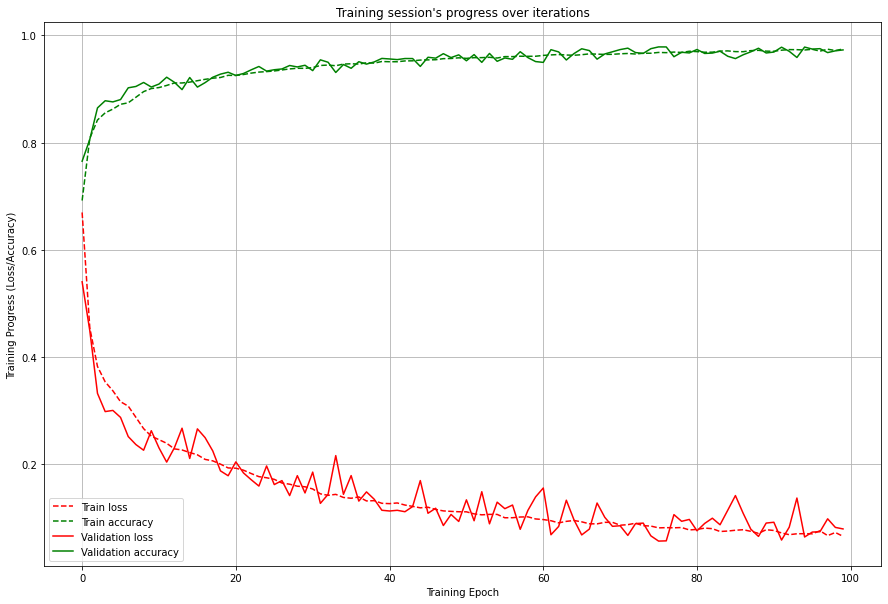

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_59 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_59 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_221 (Dropout)       (None, 512)               0         
                                                                 
 dense_226 (Dense)           (None, 64)                32832     
                                                                 
 dense_227 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0912 - accuracy: 0.9647 - val_loss: 0.0733 - val_accuracy: 0.9711
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0892 - accuracy: 0.9659 - val_loss: 0.1125 - val_accuracy: 0.9585
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0860 - accuracy: 0.9668 - val_loss: 0.0672 - val_accuracy: 0.9750
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0901 - accuracy: 0.9654 - val_loss: 0.0913 - val_accuracy: 0.9647
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0841 - accuracy: 0.9673 - val_loss: 0.0817 - val_accuracy: 0.9700
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0838 - accuracy: 0.9683 - val_loss: 0.0607 - val_accuracy: 0.9781
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0852 - accuracy: 0.9669 - val_loss: 0.0675 - val_accuracy: 0.971

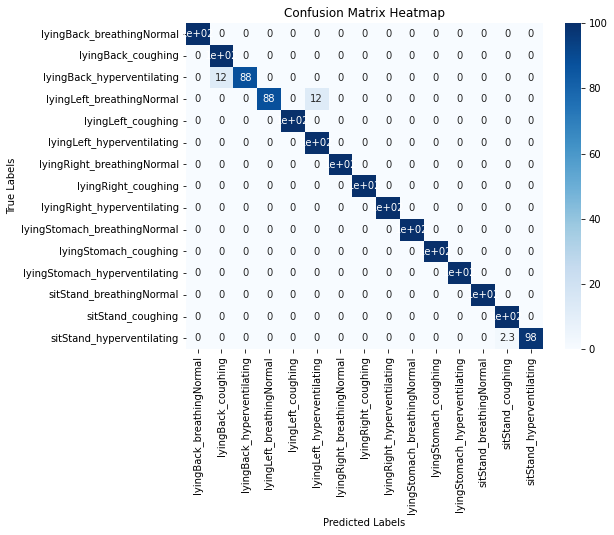

52/71 0.9835069444444444 0.872567624153356


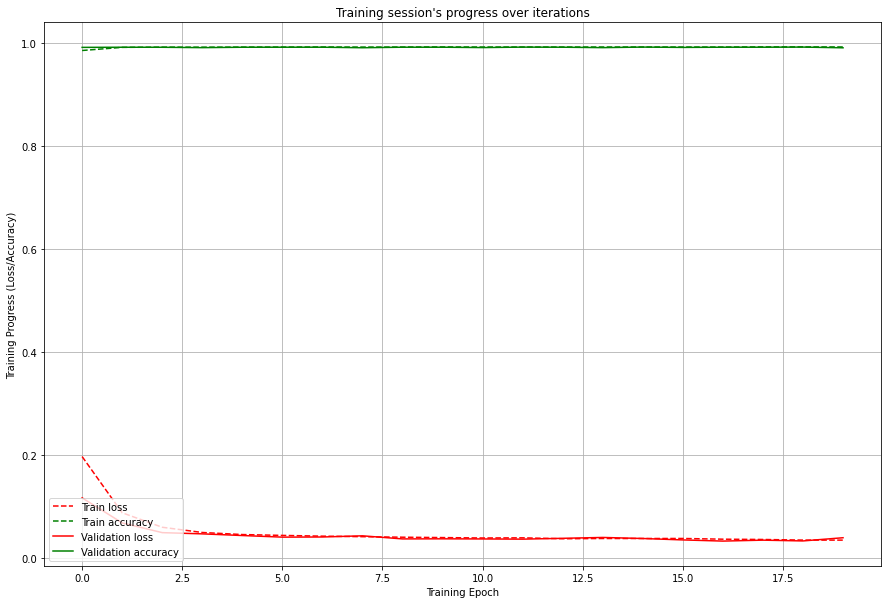

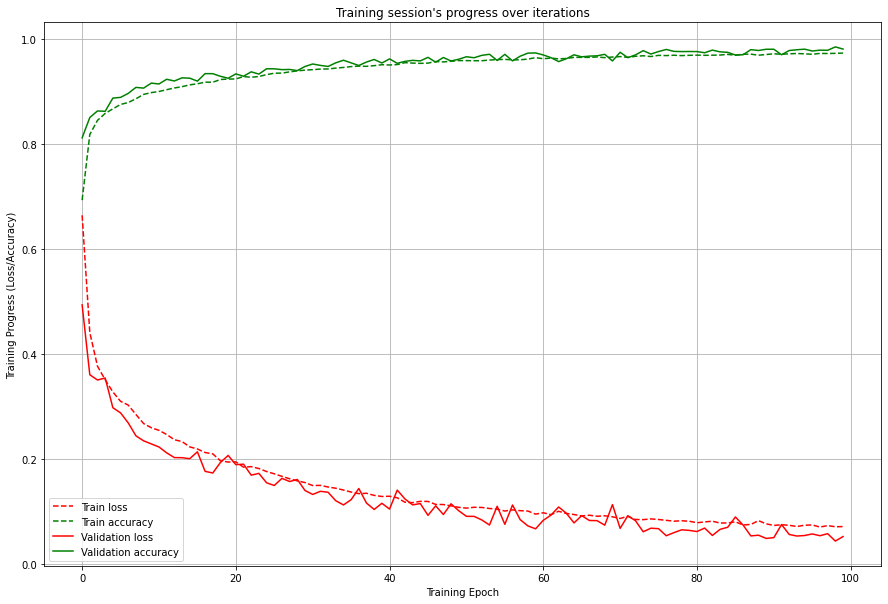

Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_60 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_60 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_225 (Dropout)       (None, 512)               0         
                                                                 
 dense_230 (Dense)           (None, 64)                32832     
                                                                 
 dense_231 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0913 - accuracy: 0.9662 - val_loss: 0.0800 - val_accuracy: 0.9702
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0912 - accuracy: 0.9657 - val_loss: 0.0574 - val_accuracy: 0.9779
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0913 - accuracy: 0.9648 - val_loss: 0.0784 - val_accuracy: 0.9680
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0932 - accuracy: 0.9642 - val_loss: 0.0869 - val_accuracy: 0.9645
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0850 - accuracy: 0.9674 - val_loss: 0.0993 - val_accuracy: 0.9622
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0860 - accuracy: 0.9671 - val_loss: 0.0682 - val_accuracy: 0.9727
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0844 - accuracy: 0.9671 - val_loss: 0.0672 - val_accuracy: 0.973

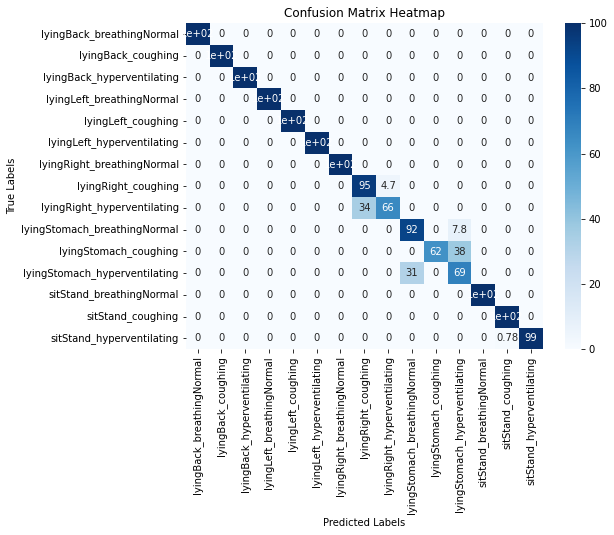

53/71 0.9348958333333334 0.8737218502492815


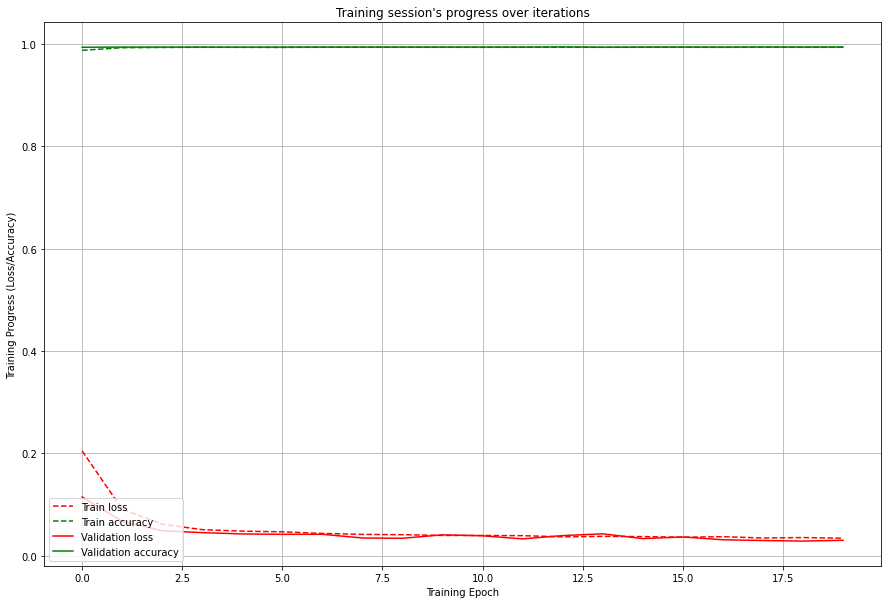

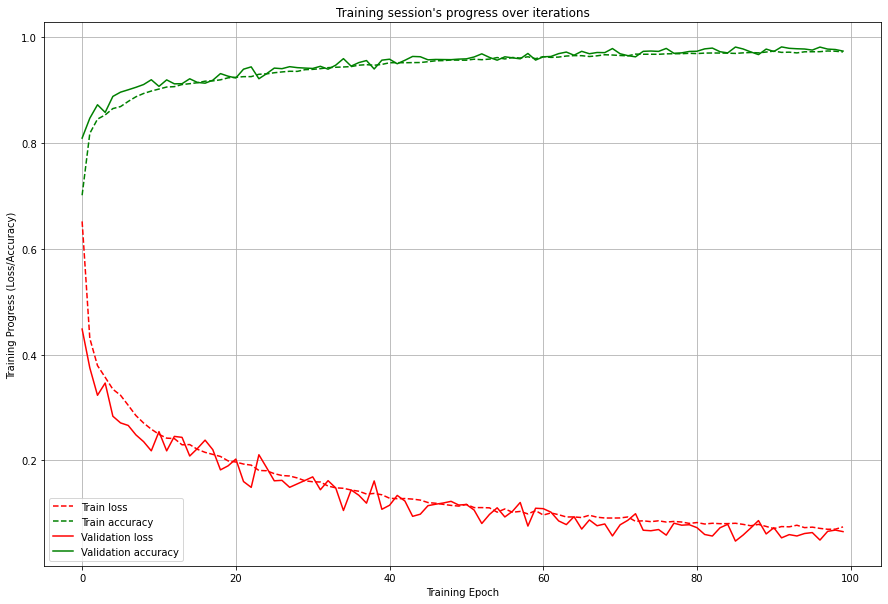

Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_61 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_61 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_229 (Dropout)       (None, 512)               0         
                                                                 
 dense_234 (Dense)           (None, 64)                32832     
                                                                 
 dense_235 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0861 - accuracy: 0.9664 - val_loss: 0.0757 - val_accuracy: 0.9731
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0845 - accuracy: 0.9672 - val_loss: 0.0638 - val_accuracy: 0.9740
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0852 - accuracy: 0.9675 - val_loss: 0.0802 - val_accuracy: 0.9699
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0811 - accuracy: 0.9687 - val_loss: 0.0756 - val_accuracy: 0.9718
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0850 - accuracy: 0.9677 - val_loss: 0.0638 - val_accuracy: 0.9745
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0851 - accuracy: 0.9675 - val_loss: 0.0617 - val_accuracy: 0.9754
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0828 - accuracy: 0.9684 - val_loss: 0.0702 - val_accuracy: 0.974

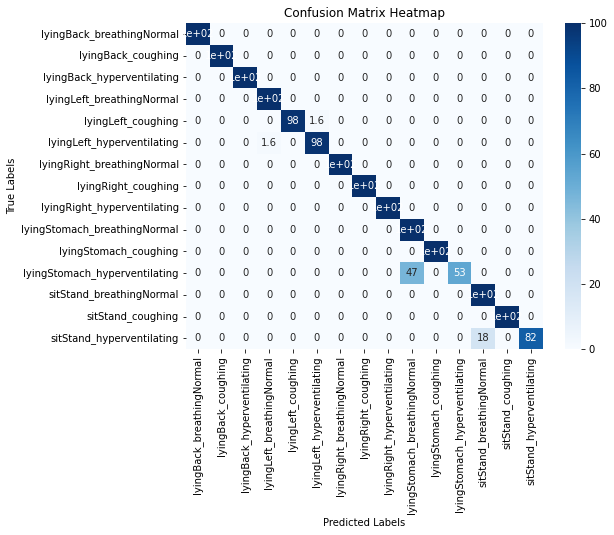

54/71 0.9522569444444444 0.8751497610528299


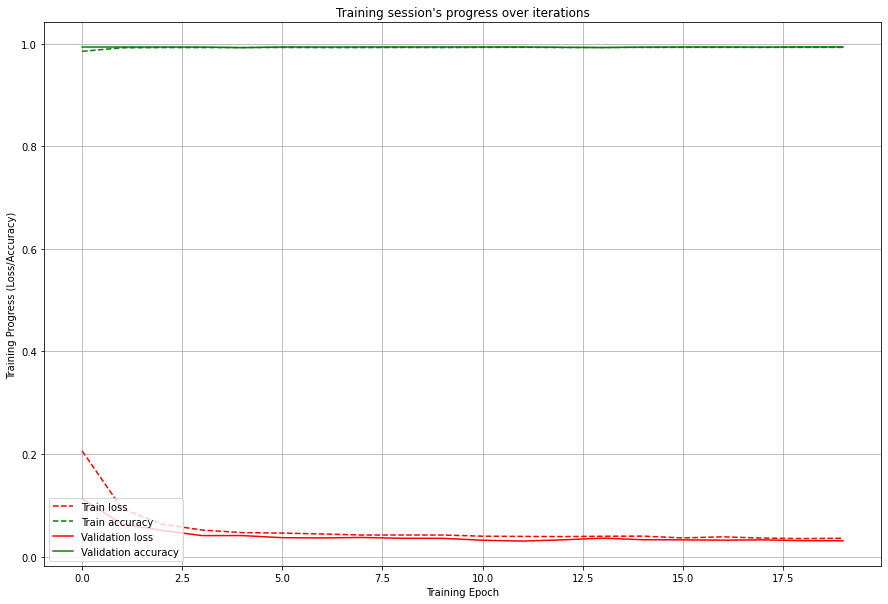

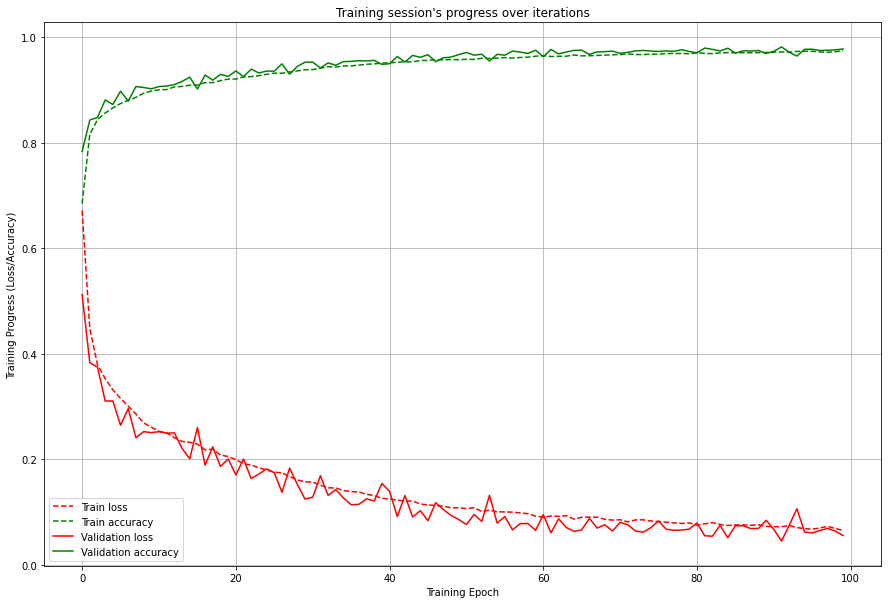

Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_62 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_62 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_233 (Dropout)       (None, 512)               0         
                                                                 
 dense_238 (Dense)           (None, 64)                32832     
                                                                 
 dense_239 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0892 - accuracy: 0.9653 - val_loss: 0.0600 - val_accuracy: 0.9774
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0864 - accuracy: 0.9666 - val_loss: 0.0600 - val_accuracy: 0.9772
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0853 - accuracy: 0.9666 - val_loss: 0.0581 - val_accuracy: 0.9778
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0851 - accuracy: 0.9666 - val_loss: 0.0898 - val_accuracy: 0.9665
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0881 - accuracy: 0.9657 - val_loss: 0.0596 - val_accuracy: 0.9768
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0835 - accuracy: 0.9679 - val_loss: 0.0720 - val_accuracy: 0.9729
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0847 - accuracy: 0.9668 - val_loss: 0.0671 - val_accuracy: 0.975

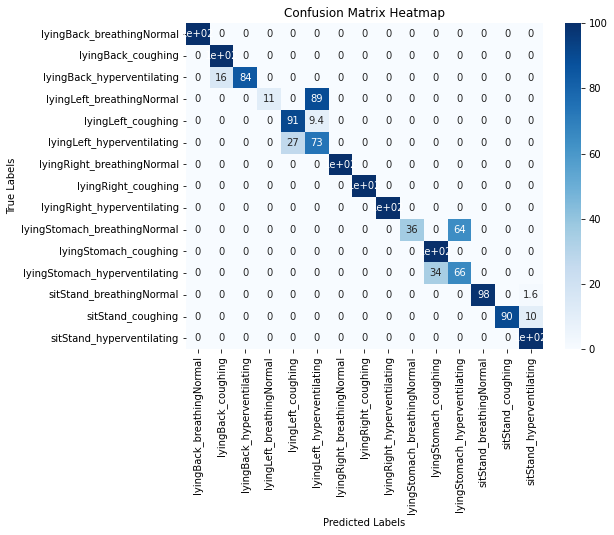

55/71 0.8541666666666666 0.8747750629387916


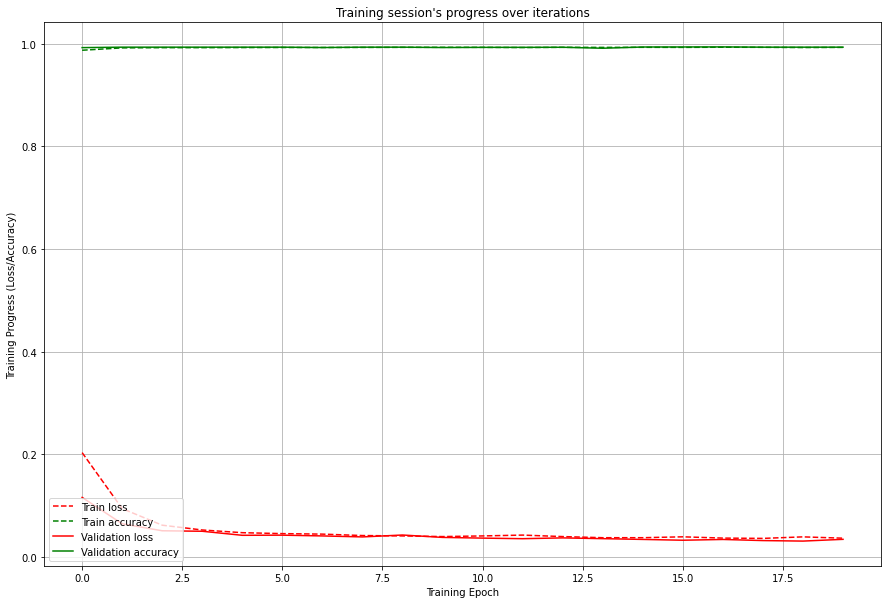

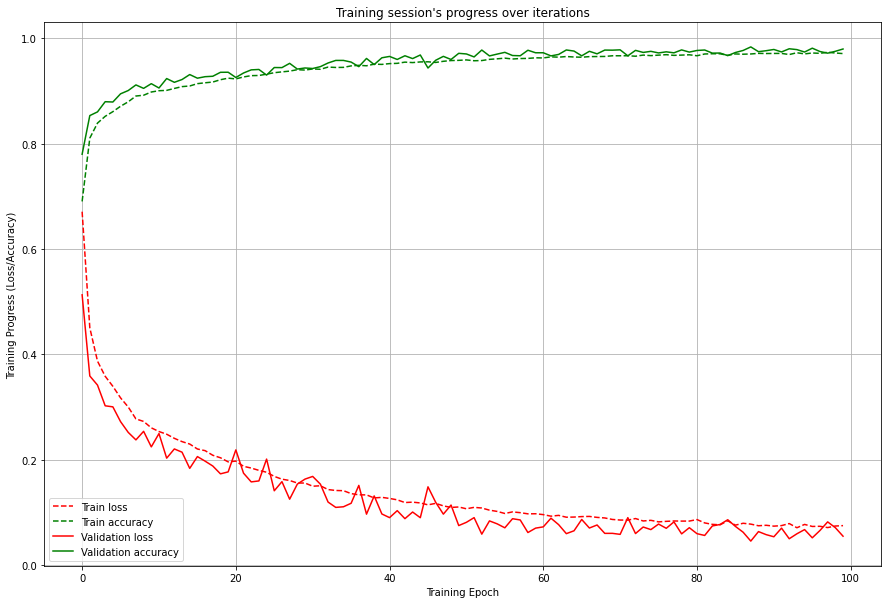

Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_63 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_63 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_237 (Dropout)       (None, 512)               0         
                                                                 
 dense_242 (Dense)           (None, 64)                32832     
                                                                 
 dense_243 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

496/496 [==============================] - 6s 12ms/step - loss: 0.0888 - accuracy: 0.9648 - val_loss: 0.0752 - val_accuracy: 0.9693
Epoch 70/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0850 - accuracy: 0.9671 - val_loss: 0.1167 - val_accuracy: 0.9567
Epoch 71/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0834 - accuracy: 0.9678 - val_loss: 0.0521 - val_accuracy: 0.9801
Epoch 72/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0877 - accuracy: 0.9663 - val_loss: 0.0955 - val_accuracy: 0.9612
Epoch 73/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0826 - accuracy: 0.9678 - val_loss: 0.0737 - val_accuracy: 0.9715
Epoch 74/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0808 - accuracy: 0.9690 - val_loss: 0.0710 - val_accuracy: 0.9712
Epoch 75/100
496/496 [==============================] - 6s 12ms/step - loss: 0.0822 - accuracy: 0.9678 - val_loss: 0.0679 - val_accuracy: 0.972

/tmp/ipykernel_2045461/2173623269.py:33: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100


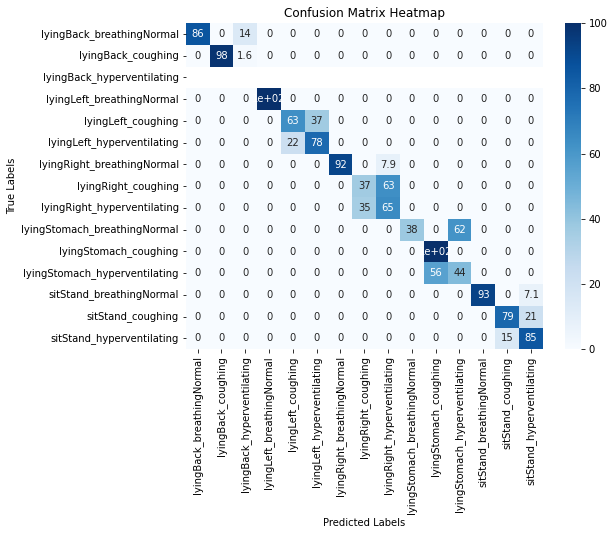

56/71 0.773109243697479 0.8729914520749089


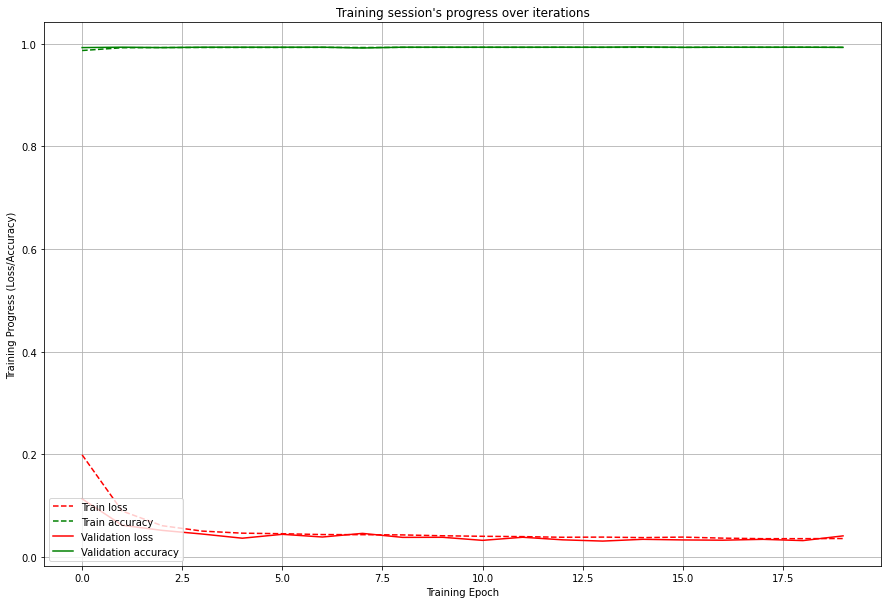

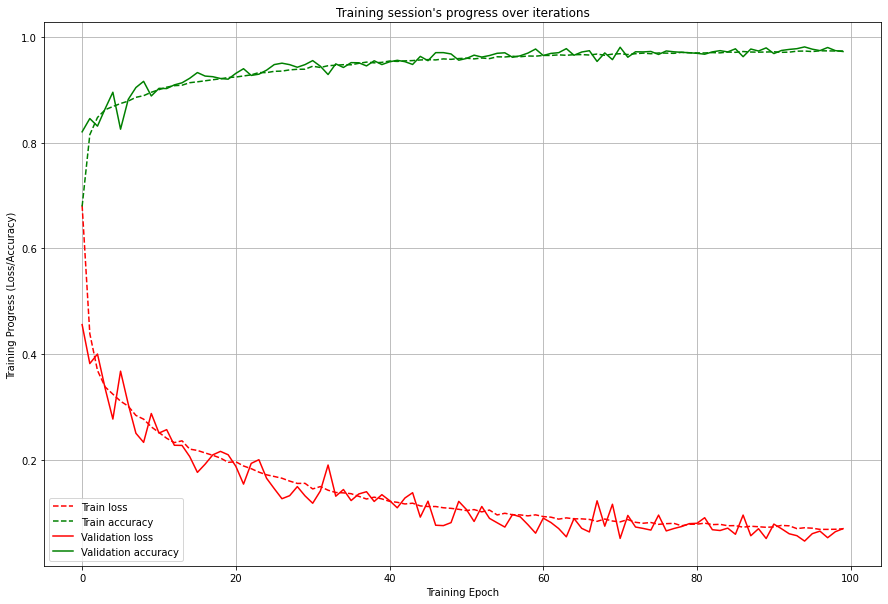

Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_64 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_64 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_241 (Dropout)       (None, 512)               0         
                                                                 
 dense_246 (Dense)           (None, 64)                32832     
                                                                 
 dense_247 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0954 - accuracy: 0.9634 - val_loss: 0.0666 - val_accuracy: 0.9734
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0917 - accuracy: 0.9651 - val_loss: 0.0594 - val_accuracy: 0.9749
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0929 - accuracy: 0.9644 - val_loss: 0.0673 - val_accuracy: 0.9728
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0913 - accuracy: 0.9647 - val_loss: 0.0686 - val_accuracy: 0.9730
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0896 - accuracy: 0.9654 - val_loss: 0.0971 - val_accuracy: 0.9625
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0884 - accuracy: 0.9662 - val_loss: 0.0597 - val_accuracy: 0.9764
Epoch 75/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0895 - accuracy: 0.9660 - val_loss: 0.0602 - val_accuracy: 0.976

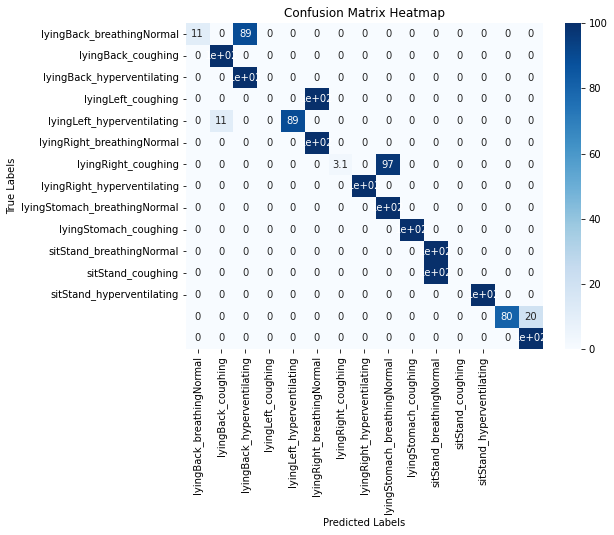

57/71 0.7578125 0.8710056080736174


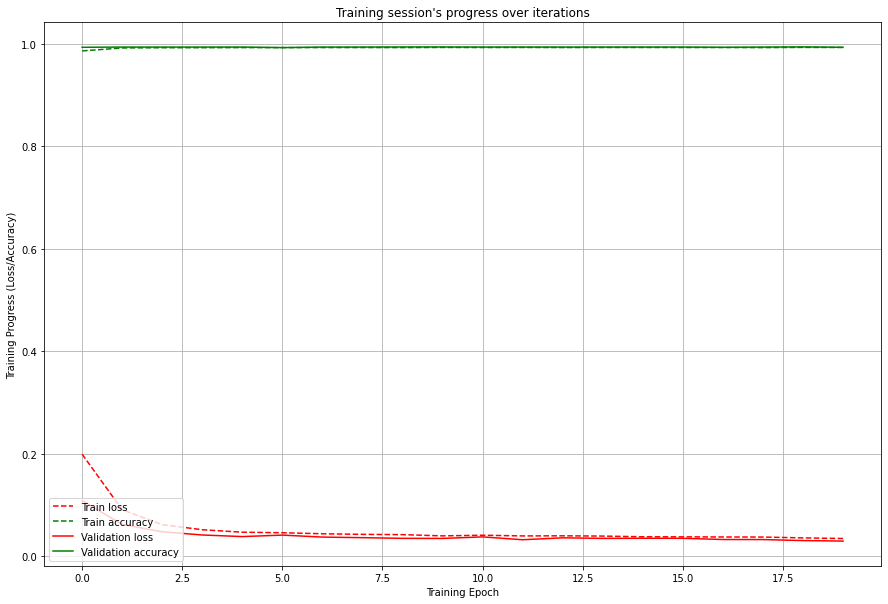

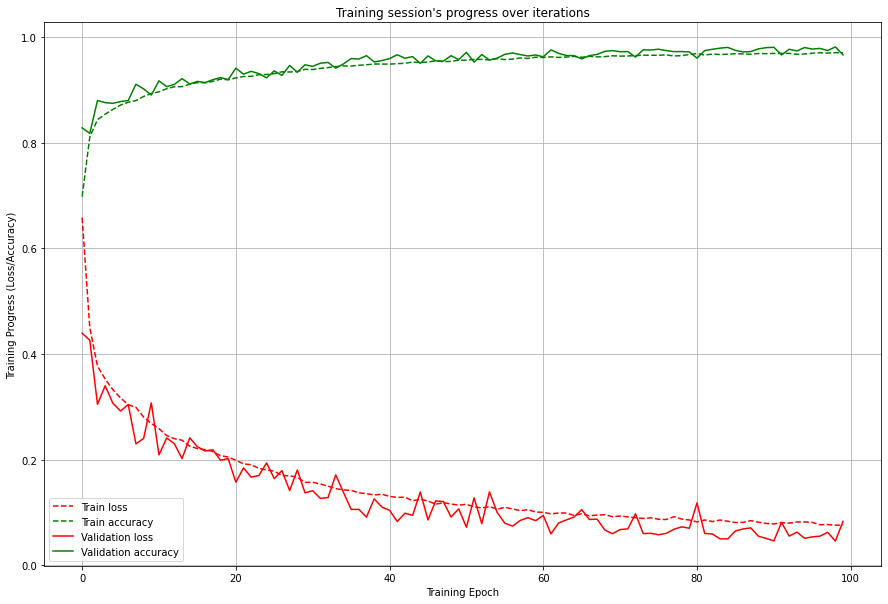

Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_65 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_65 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_245 (Dropout)       (None, 512)               0         
                                                                 
 dense_250 (Dense)           (None, 64)                32832     
                                                                 
 dense_251 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0890 - accuracy: 0.9665 - val_loss: 0.0828 - val_accuracy: 0.9699
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0909 - accuracy: 0.9651 - val_loss: 0.0831 - val_accuracy: 0.9669
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0888 - accuracy: 0.9652 - val_loss: 0.0793 - val_accuracy: 0.9691
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0895 - accuracy: 0.9657 - val_loss: 0.0935 - val_accuracy: 0.9653
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0872 - accuracy: 0.9663 - val_loss: 0.0881 - val_accuracy: 0.9689
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0858 - accuracy: 0.9671 - val_loss: 0.0703 - val_accuracy: 0.9752
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0826 - accuracy: 0.9688 - val_loss: 0.0811 - val_accuracy: 0.972

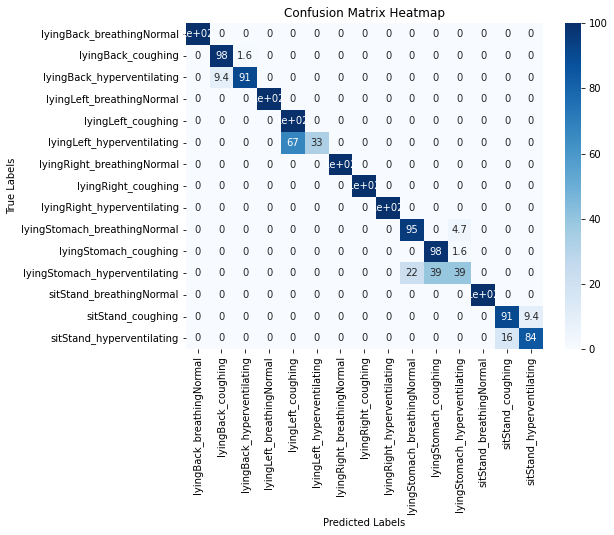

58/71 0.8914930555555556 0.8713528529461926


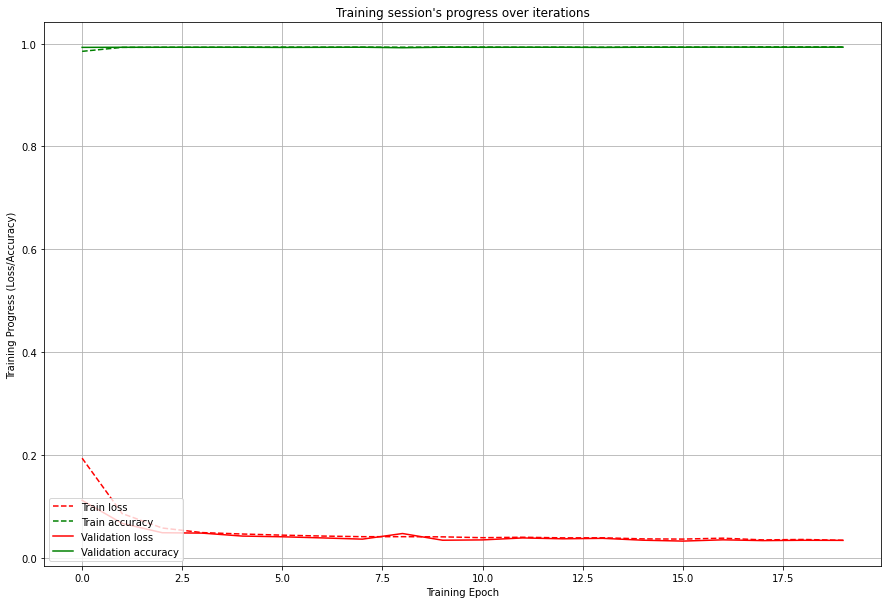

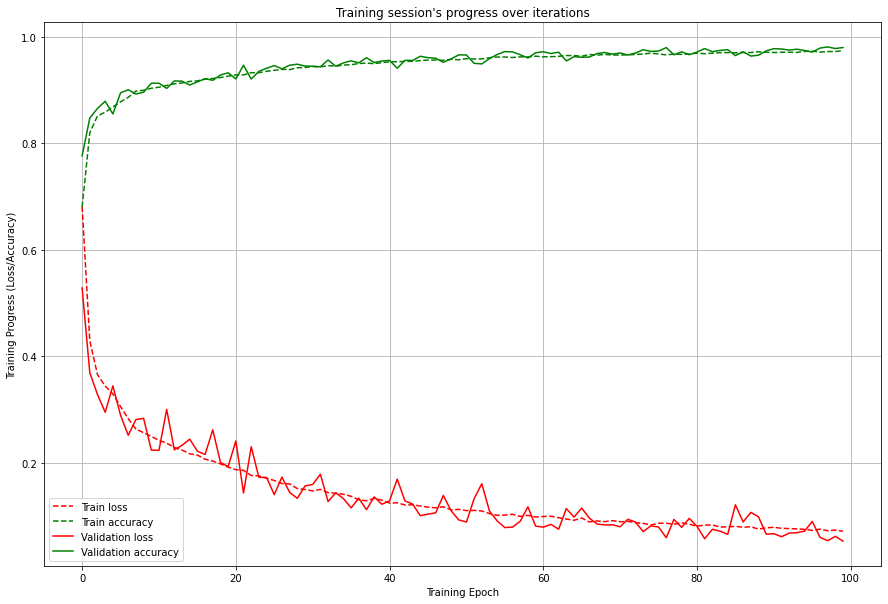

Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_66 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_66 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_249 (Dropout)       (None, 512)               0         
                                                                 
 dense_254 (Dense)           (None, 64)                32832     
                                                                 
 dense_255 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0843 - accuracy: 0.9673 - val_loss: 0.0667 - val_accuracy: 0.9750
Epoch 70/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0855 - accuracy: 0.9668 - val_loss: 0.0767 - val_accuracy: 0.9712
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0832 - accuracy: 0.9672 - val_loss: 0.0548 - val_accuracy: 0.9793
Epoch 72/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0820 - accuracy: 0.9683 - val_loss: 0.0601 - val_accuracy: 0.9764
Epoch 73/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0828 - accuracy: 0.9677 - val_loss: 0.0572 - val_accuracy: 0.9784
Epoch 74/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0839 - accuracy: 0.9678 - val_loss: 0.0453 - val_accuracy: 0.9824
Epoch 75/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0817 - accuracy: 0.9689 - val_loss: 0.0621 - val_accuracy: 0.975

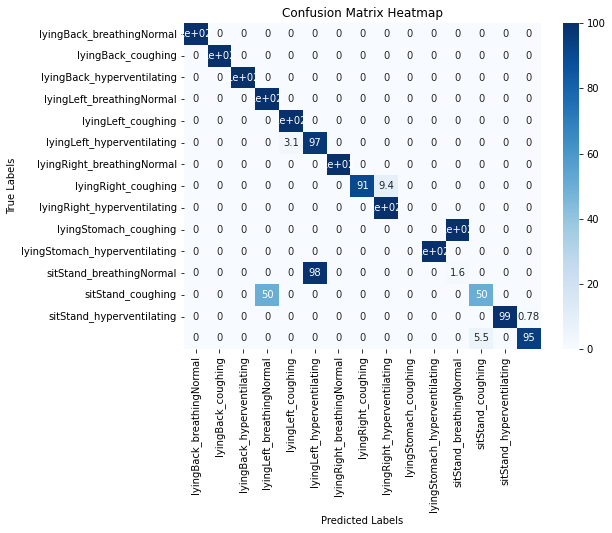

59/71 0.8203125 0.8705021803970894


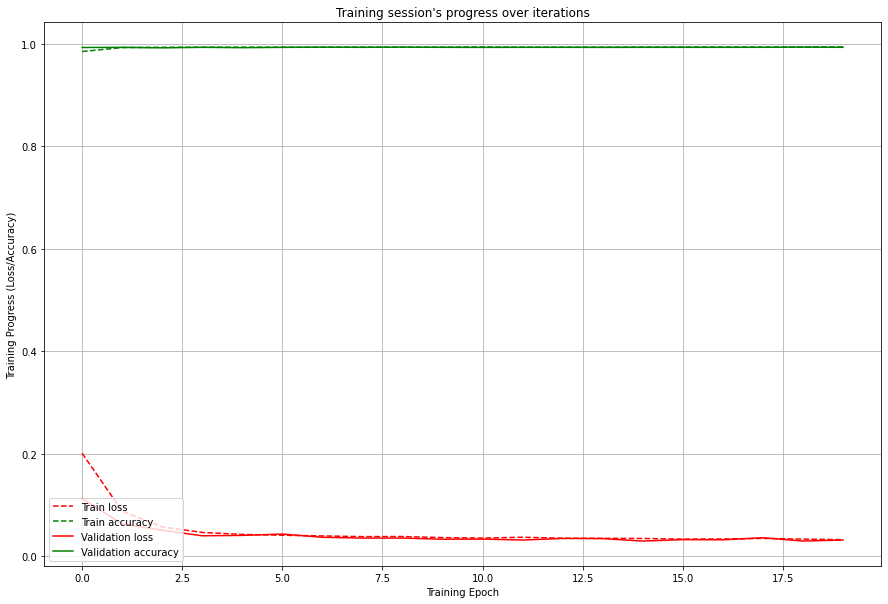

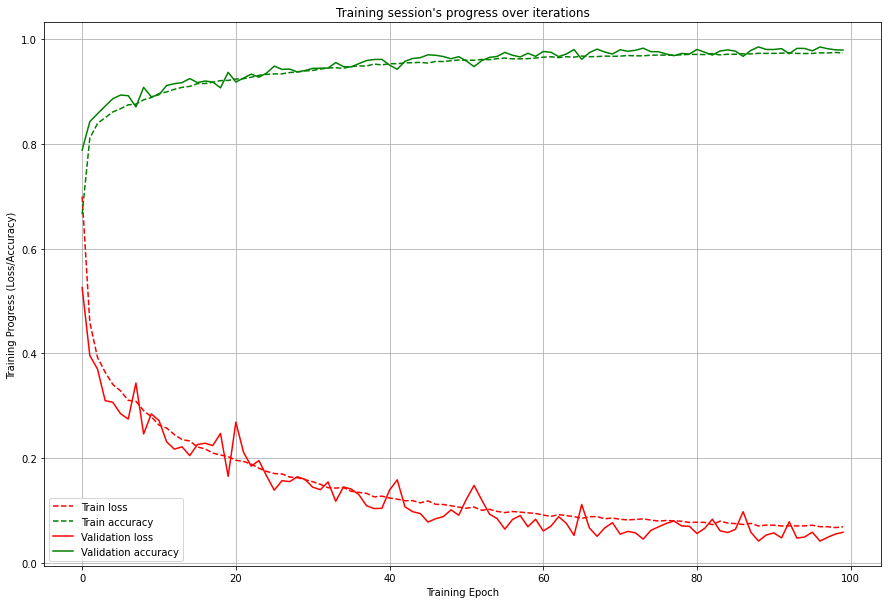

Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_67 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_67 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_253 (Dropout)       (None, 512)               0         
                                                                 
 dense_258 (Dense)           (None, 64)                32832     
                                                                 
 dense_259 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 12ms/step - loss: 0.0811 - accuracy: 0.9688 - val_loss: 0.0669 - val_accuracy: 0.9745
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0811 - accuracy: 0.9683 - val_loss: 0.0711 - val_accuracy: 0.9720
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0807 - accuracy: 0.9688 - val_loss: 0.0629 - val_accuracy: 0.9754
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0781 - accuracy: 0.9698 - val_loss: 0.0721 - val_accuracy: 0.9737
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0748 - accuracy: 0.9709 - val_loss: 0.0480 - val_accuracy: 0.9819
Epoch 74/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0771 - accuracy: 0.9701 - val_loss: 0.0647 - val_accuracy: 0.9767
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0812 - accuracy: 0.9687 - val_loss: 0.0991 - val_accuracy: 0.964

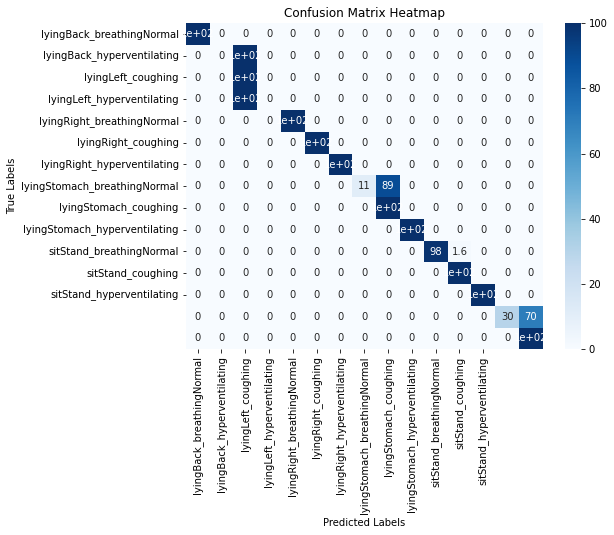

60/71 0.7604166666666666 0.8686974998441316


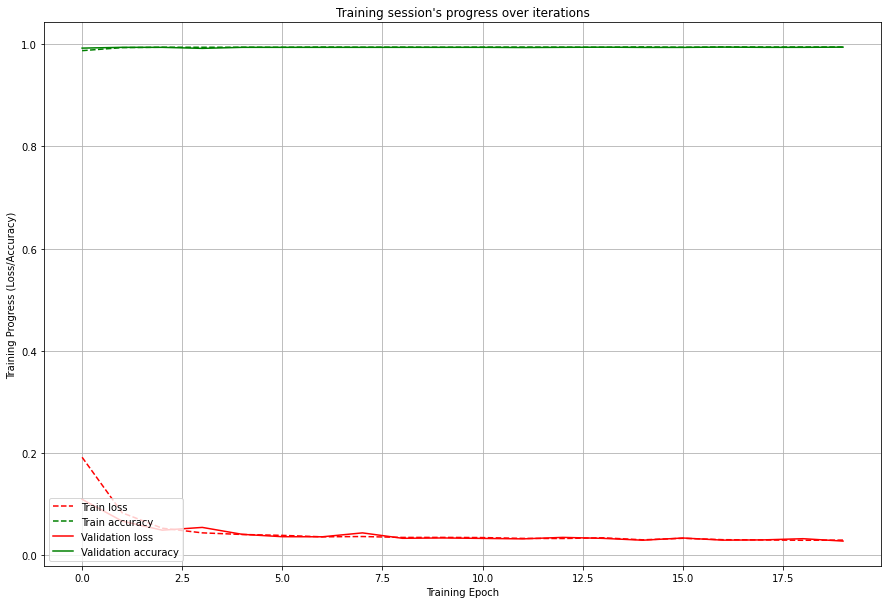

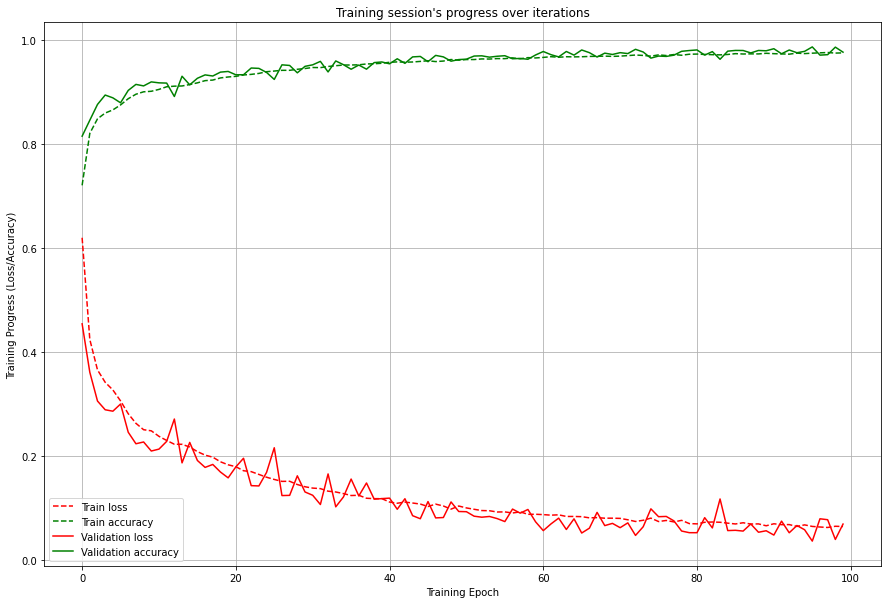

Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_68 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_68 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_257 (Dropout)       (None, 512)               0         
                                                                 
 dense_262 (Dense)           (None, 64)                32832     
                                                                 
 dense_263 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0841 - accuracy: 0.9676 - val_loss: 0.0785 - val_accuracy: 0.9697
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0840 - accuracy: 0.9676 - val_loss: 0.0738 - val_accuracy: 0.9732
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0844 - accuracy: 0.9681 - val_loss: 0.0542 - val_accuracy: 0.9793
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0821 - accuracy: 0.9682 - val_loss: 0.0963 - val_accuracy: 0.9670
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0838 - accuracy: 0.9678 - val_loss: 0.0679 - val_accuracy: 0.9731
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0816 - accuracy: 0.9678 - val_loss: 0.0816 - val_accuracy: 0.9691
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0795 - accuracy: 0.9697 - val_loss: 0.0628 - val_accuracy: 0.975

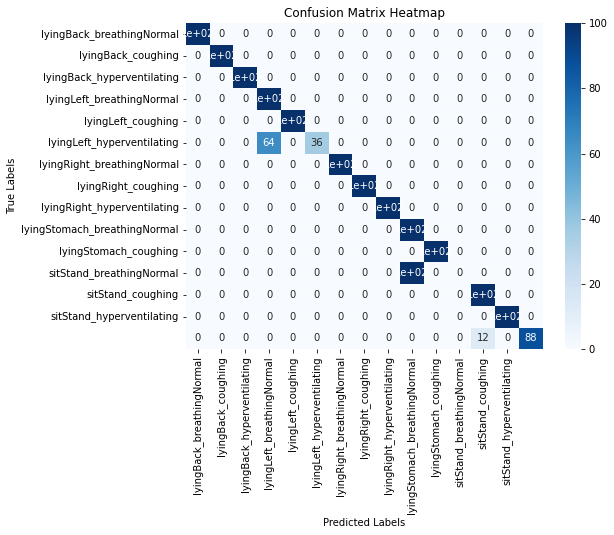

61/71 0.8949652777777778 0.8691211736817711


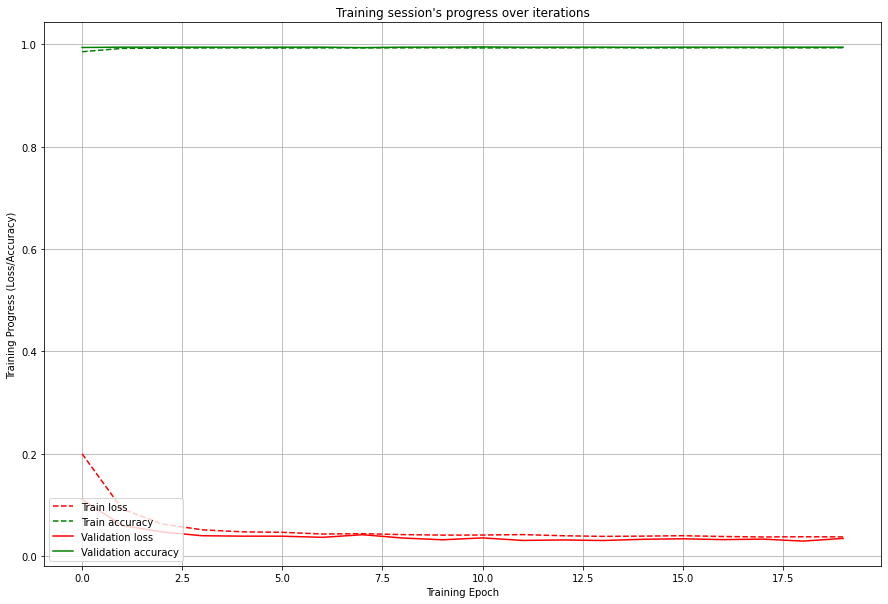

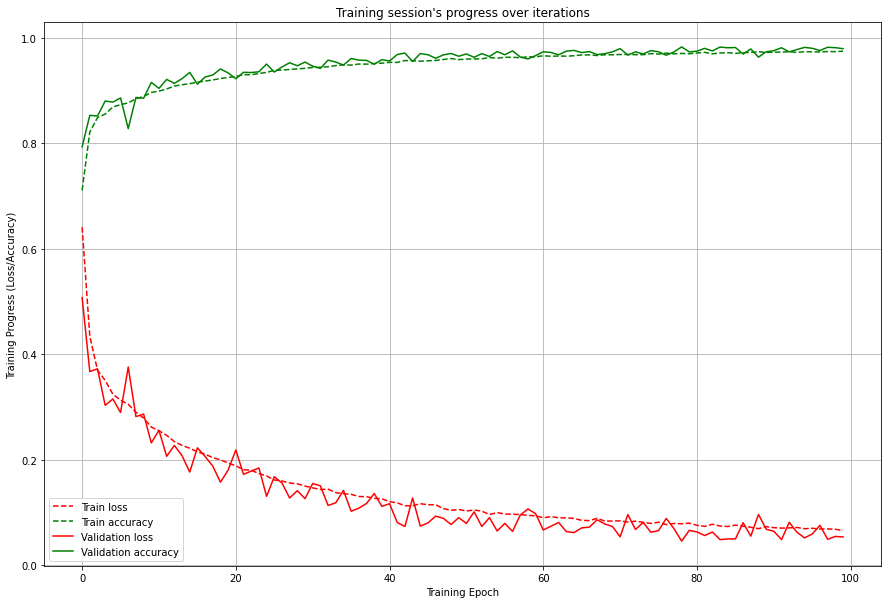

Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_69 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_69 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_261 (Dropout)       (None, 512)               0         
                                                                 
 dense_266 (Dense)           (None, 64)                32832     
                                                                 
 dense_267 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0897 - accuracy: 0.9654 - val_loss: 0.0885 - val_accuracy: 0.9649
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0855 - accuracy: 0.9669 - val_loss: 0.0954 - val_accuracy: 0.9654
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0850 - accuracy: 0.9670 - val_loss: 0.0705 - val_accuracy: 0.9749
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0866 - accuracy: 0.9662 - val_loss: 0.0984 - val_accuracy: 0.9646
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0867 - accuracy: 0.9660 - val_loss: 0.0977 - val_accuracy: 0.9627
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0852 - accuracy: 0.9667 - val_loss: 0.0537 - val_accuracy: 0.9799
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0866 - accuracy: 0.9663 - val_loss: 0.0784 - val_accuracy: 0.968

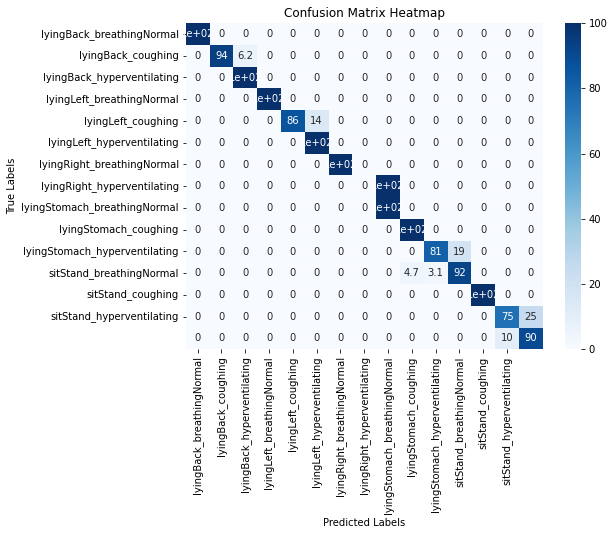

62/71 0.8793402777777778 0.869283381683295


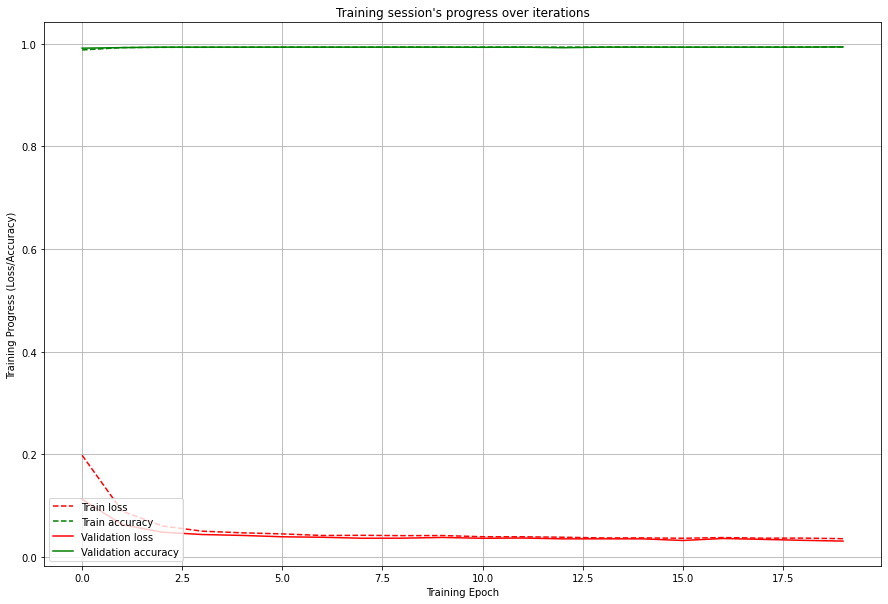

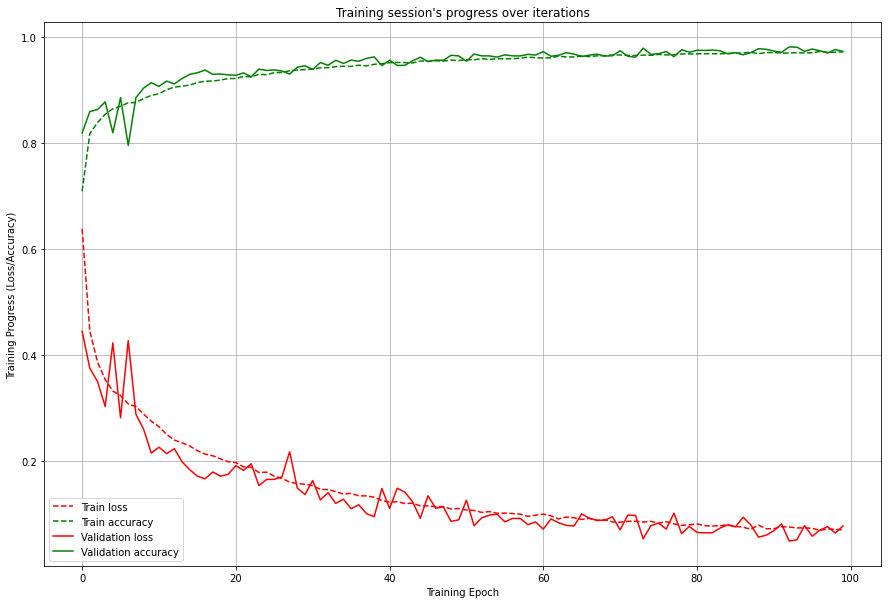

Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_70 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_70 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_265 (Dropout)       (None, 512)               0         
                                                                 
 dense_270 (Dense)           (None, 64)                32832     
                                                                 
 dense_271 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.1007 - accuracy: 0.9609 - val_loss: 0.0750 - val_accuracy: 0.9749
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0977 - accuracy: 0.9625 - val_loss: 0.0950 - val_accuracy: 0.9663
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.1017 - accuracy: 0.9610 - val_loss: 0.0651 - val_accuracy: 0.9749
Epoch 72/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0961 - accuracy: 0.9636 - val_loss: 0.1002 - val_accuracy: 0.9654
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0972 - accuracy: 0.9631 - val_loss: 0.1052 - val_accuracy: 0.9649
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0969 - accuracy: 0.9633 - val_loss: 0.0719 - val_accuracy: 0.9729
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0953 - accuracy: 0.9644 - val_loss: 0.0678 - val_accuracy: 0.973

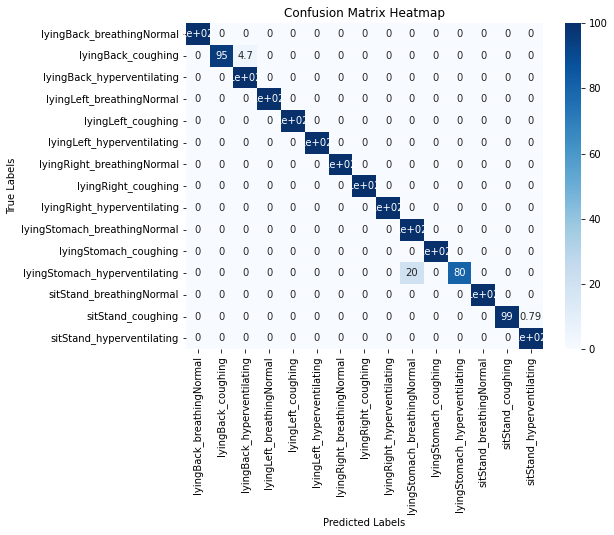

63/71 0.985191637630662 0.8710944481824725


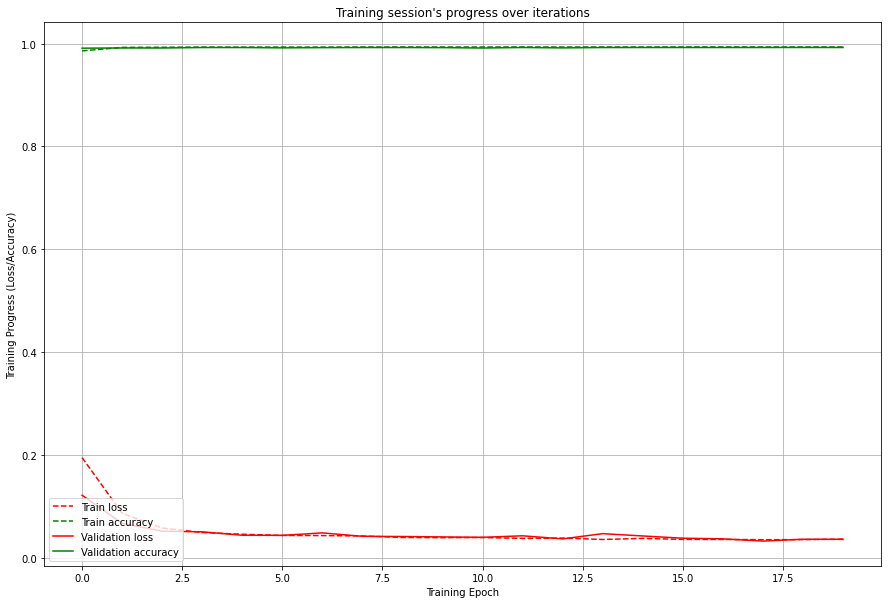

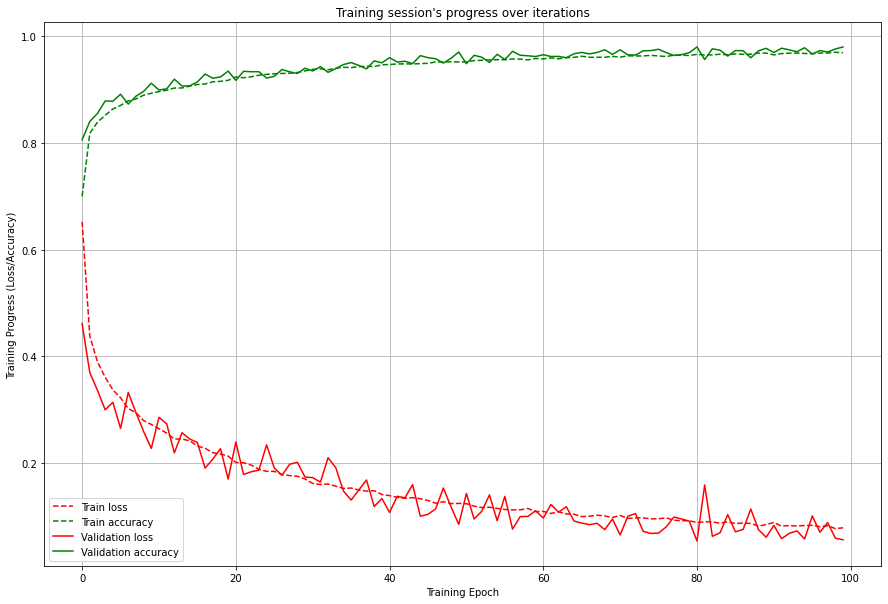

Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_71 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_71 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_269 (Dropout)       (None, 512)               0         
                                                                 
 dense_274 (Dense)           (None, 64)                32832     
                                                                 
 dense_275 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

500/500 [==============================] - 6s 12ms/step - loss: 0.0875 - accuracy: 0.9668 - val_loss: 0.0781 - val_accuracy: 0.9705
Epoch 70/100
500/500 [==============================] - 6s 12ms/step - loss: 0.0931 - accuracy: 0.9640 - val_loss: 0.1130 - val_accuracy: 0.9622
Epoch 71/100
500/500 [==============================] - 6s 12ms/step - loss: 0.0895 - accuracy: 0.9645 - val_loss: 0.0744 - val_accuracy: 0.9716
Epoch 72/100
500/500 [==============================] - 6s 11ms/step - loss: 0.0916 - accuracy: 0.9639 - val_loss: 0.0690 - val_accuracy: 0.9730
Epoch 73/100
500/500 [==============================] - 6s 12ms/step - loss: 0.0846 - accuracy: 0.9668 - val_loss: 0.0646 - val_accuracy: 0.9755
Epoch 74/100
500/500 [==============================] - 6s 11ms/step - loss: 0.0854 - accuracy: 0.9666 - val_loss: 0.0807 - val_accuracy: 0.9708
Epoch 75/100
500/500 [==============================] - 6s 12ms/step - loss: 0.0857 - accuracy: 0.9671 - val_loss: 0.0636 - val_accuracy: 0.976

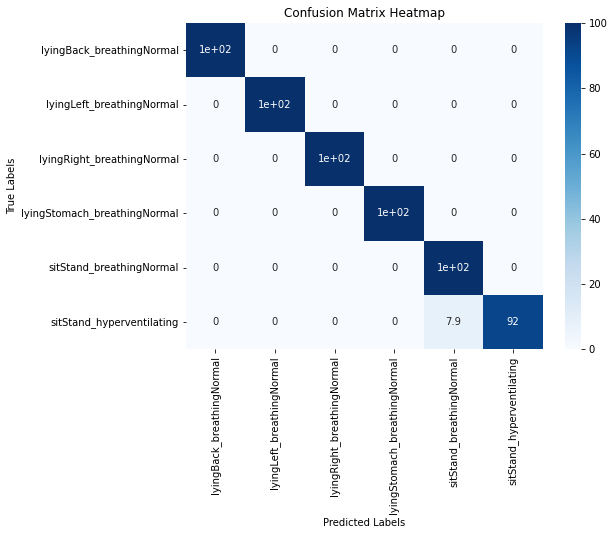

64/71 0.9929906542056075 0.8729697744289823


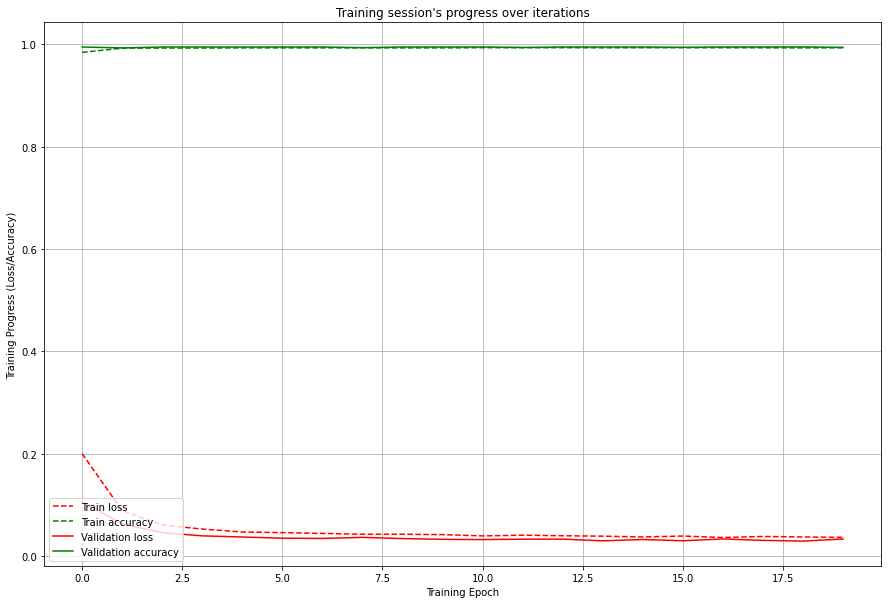

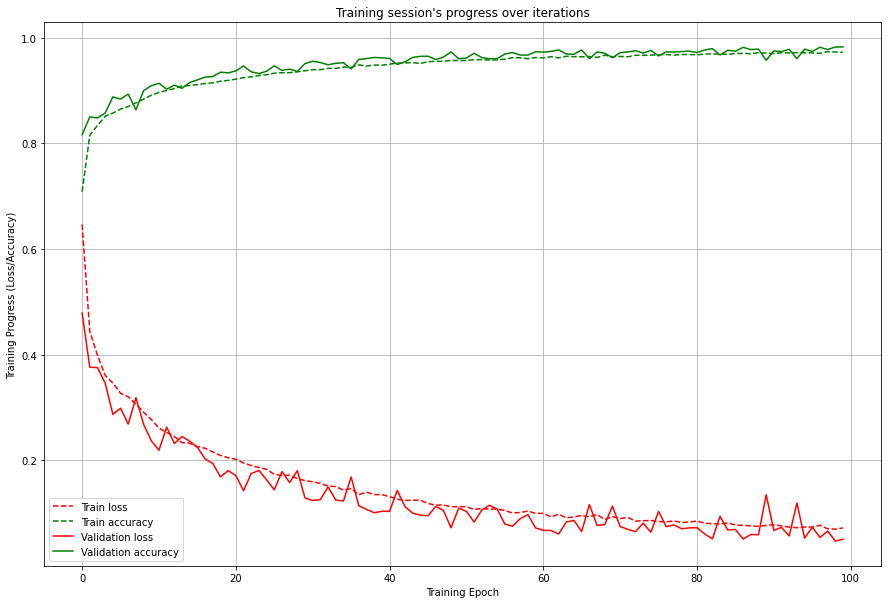

Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_72 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_72 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_273 (Dropout)       (None, 512)               0         
                                                                 
 dense_278 (Dense)           (None, 64)                32832     
                                                                 
 dense_279 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 10ms/step - loss: 0.0960 - accuracy: 0.9622 - val_loss: 0.0761 - val_accuracy: 0.9727
Epoch 70/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0918 - accuracy: 0.9649 - val_loss: 0.1021 - val_accuracy: 0.9615
Epoch 71/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0947 - accuracy: 0.9632 - val_loss: 0.0785 - val_accuracy: 0.9698
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0910 - accuracy: 0.9650 - val_loss: 0.0872 - val_accuracy: 0.9684
Epoch 73/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0933 - accuracy: 0.9645 - val_loss: 0.0873 - val_accuracy: 0.9648
Epoch 74/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0926 - accuracy: 0.9642 - val_loss: 0.0872 - val_accuracy: 0.9674
Epoch 75/100
495/495 [==============================] - 5s 10ms/step - loss: 0.0911 - accuracy: 0.9656 - val_loss: 0.0763 - val_accuracy: 0.969

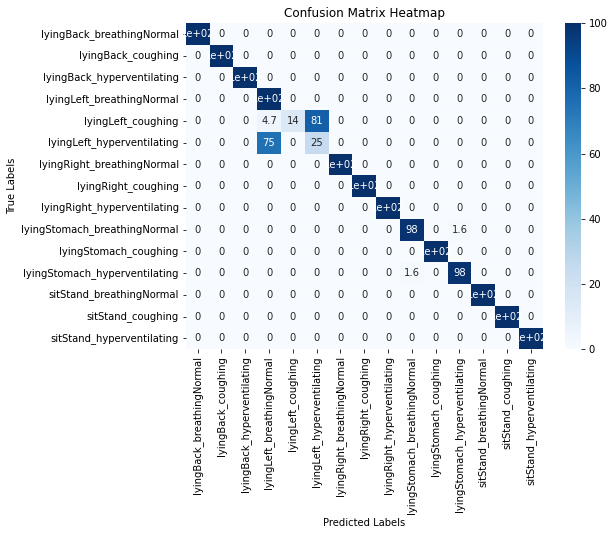

65/71 0.9088541666666666 0.8735134773416744


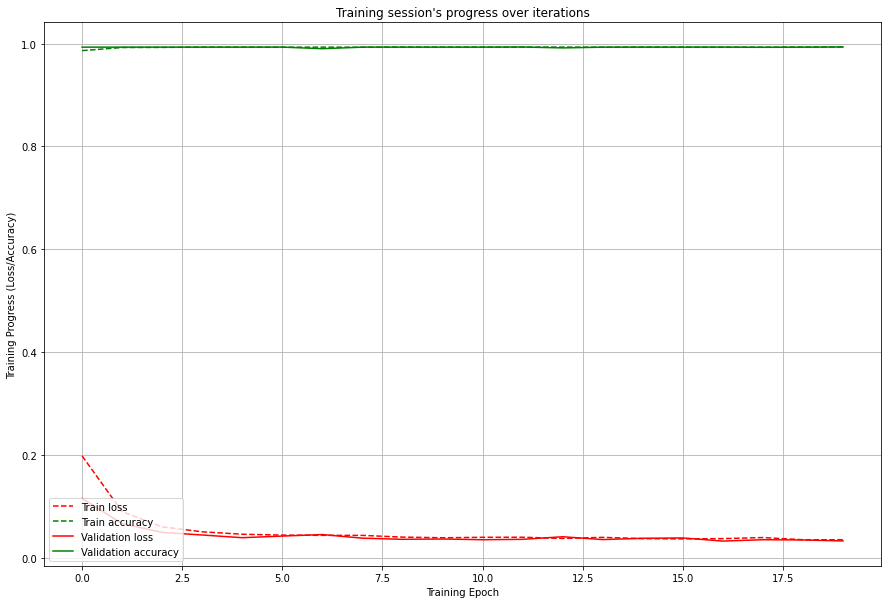

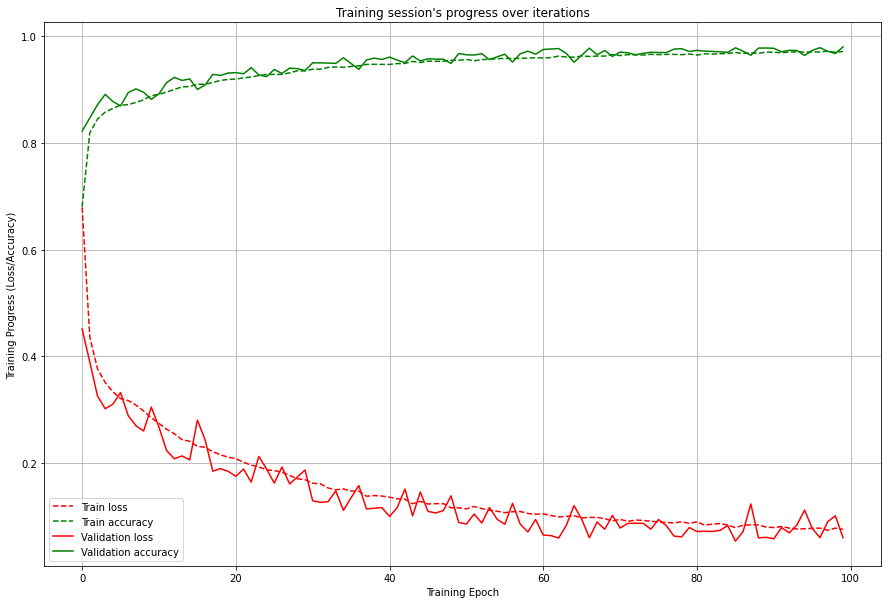

Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_73 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_73 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_277 (Dropout)       (None, 512)               0         
                                                                 
 dense_282 (Dense)           (None, 64)                32832     
                                                                 
 dense_283 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 6s 11ms/step - loss: 0.0847 - accuracy: 0.9679 - val_loss: 0.0917 - val_accuracy: 0.9658
Epoch 70/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0855 - accuracy: 0.9675 - val_loss: 0.0800 - val_accuracy: 0.9704
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0830 - accuracy: 0.9677 - val_loss: 0.0733 - val_accuracy: 0.9736
Epoch 72/100
495/495 [==============================] - 6s 12ms/step - loss: 0.0778 - accuracy: 0.9705 - val_loss: 0.0507 - val_accuracy: 0.9804
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0827 - accuracy: 0.9690 - val_loss: 0.0627 - val_accuracy: 0.9759
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0842 - accuracy: 0.9674 - val_loss: 0.0773 - val_accuracy: 0.9718
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0822 - accuracy: 0.9692 - val_loss: 0.1028 - val_accuracy: 0.963

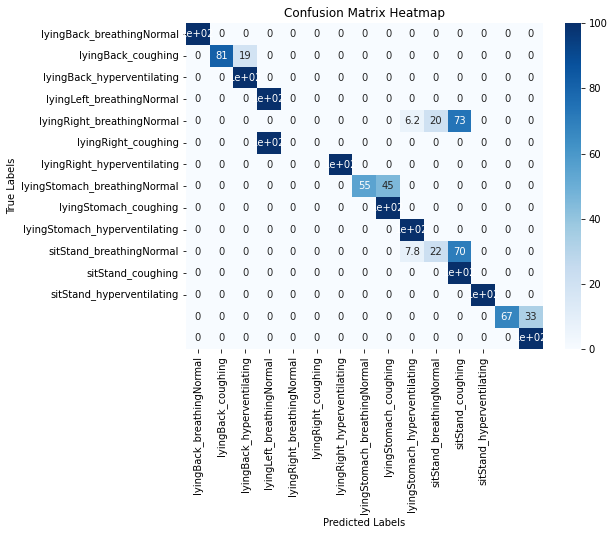

66/71 0.7734375 0.8720198060380673


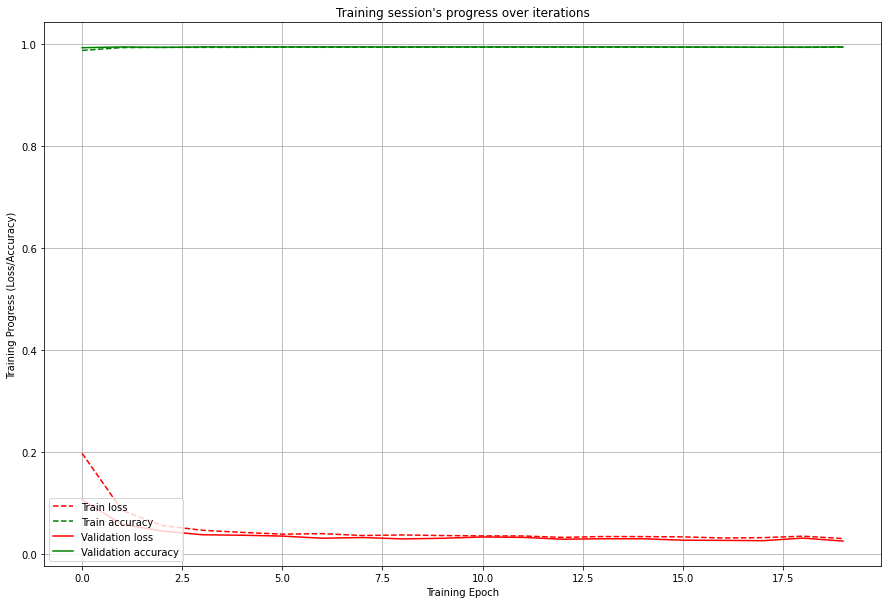

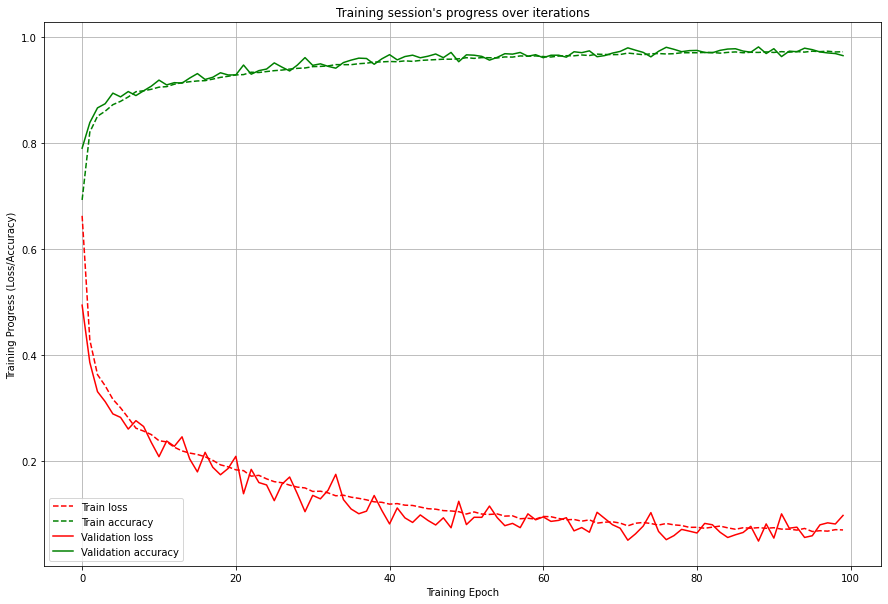

Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_74 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_74 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_281 (Dropout)       (None, 512)               0         
                                                                 
 dense_286 (Dense)           (None, 64)                32832     
                                                                 
 dense_287 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0936 - accuracy: 0.9644 - val_loss: 0.1275 - val_accuracy: 0.9597
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0930 - accuracy: 0.9636 - val_loss: 0.2080 - val_accuracy: 0.9528
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0956 - accuracy: 0.9632 - val_loss: 0.2179 - val_accuracy: 0.9473
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0959 - accuracy: 0.9627 - val_loss: 0.1335 - val_accuracy: 0.9585
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0911 - accuracy: 0.9648 - val_loss: 0.2898 - val_accuracy: 0.9393
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0942 - accuracy: 0.9638 - val_loss: 0.1184 - val_accuracy: 0.9666
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0904 - accuracy: 0.9654 - val_loss: 0.2141 - val_accuracy: 0.949

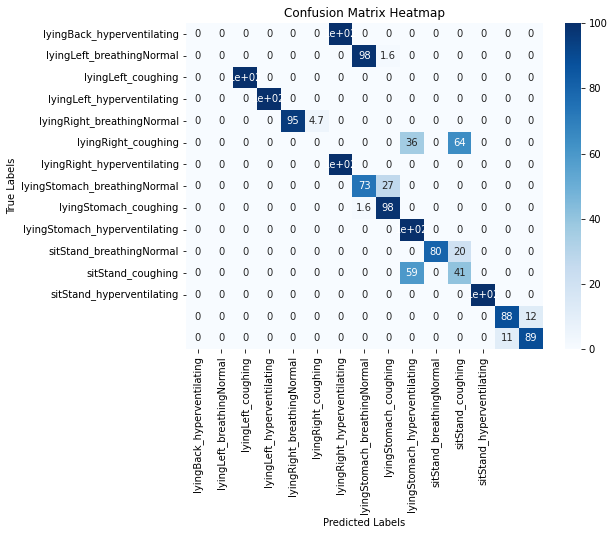

67/71 0.7458369851007888 0.8701641763184015


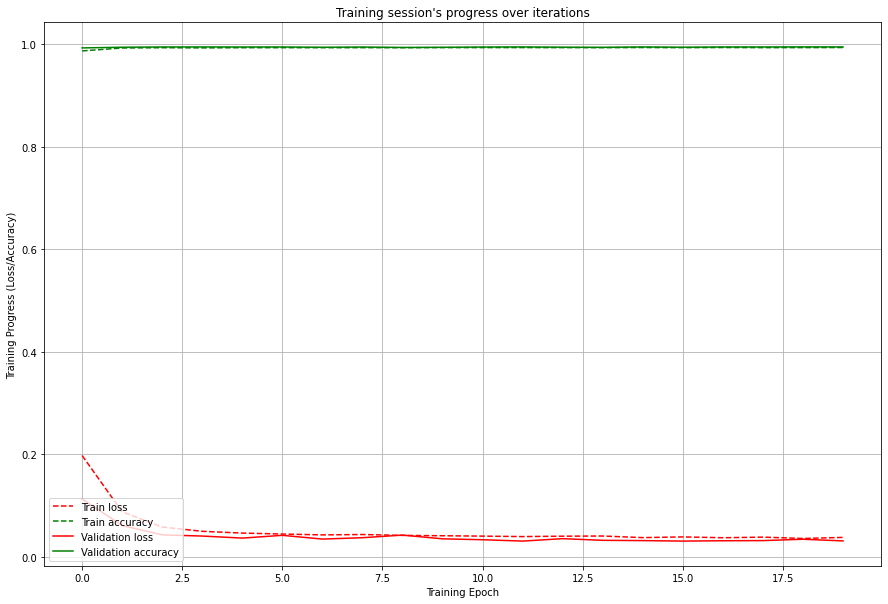

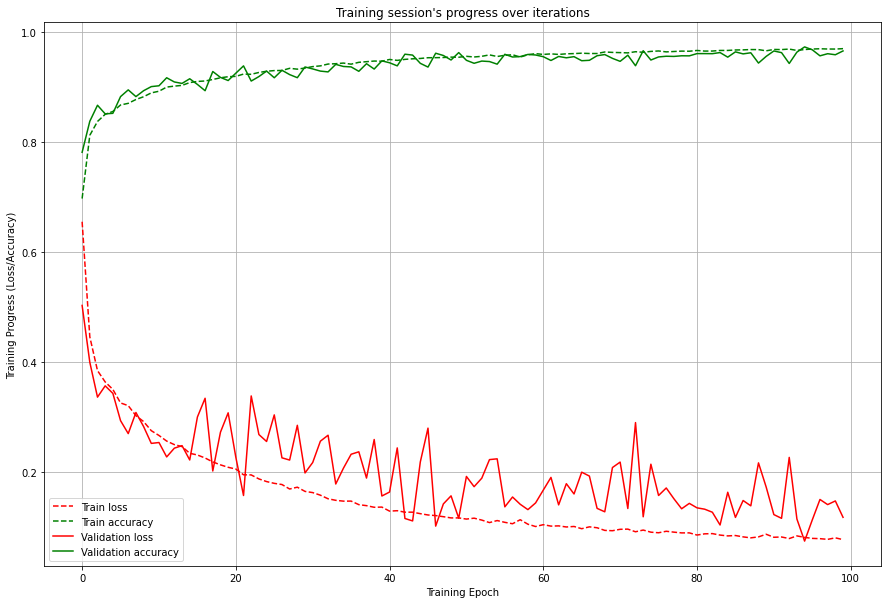

Model: "sequential_145"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_75 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_75 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_285 (Dropout)       (None, 512)               0         
                                                                 
 dense_290 (Dense)           (None, 64)                32832     
                                                                 
 dense_291 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0917 - accuracy: 0.9645 - val_loss: 0.0940 - val_accuracy: 0.9671
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0906 - accuracy: 0.9659 - val_loss: 0.0646 - val_accuracy: 0.9746
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0895 - accuracy: 0.9653 - val_loss: 0.0717 - val_accuracy: 0.9728
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0864 - accuracy: 0.9667 - val_loss: 0.0810 - val_accuracy: 0.9708
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0895 - accuracy: 0.9657 - val_loss: 0.0542 - val_accuracy: 0.9789
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0846 - accuracy: 0.9669 - val_loss: 0.0590 - val_accuracy: 0.9766
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0833 - accuracy: 0.9678 - val_loss: 0.0678 - val_accuracy: 0.973

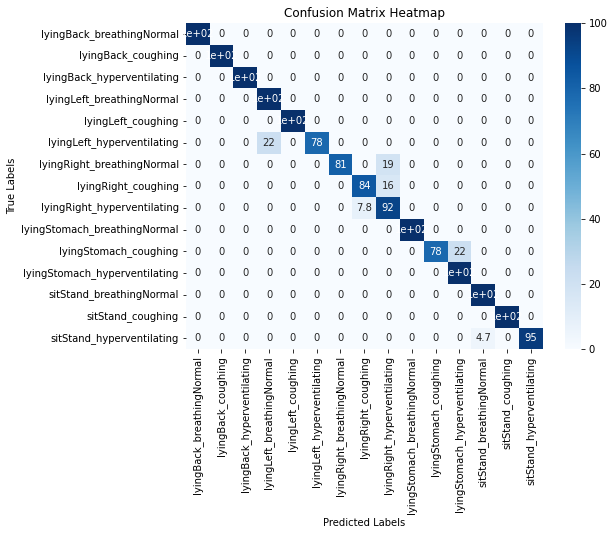

68/71 0.9470486111111112 0.8712784434893103


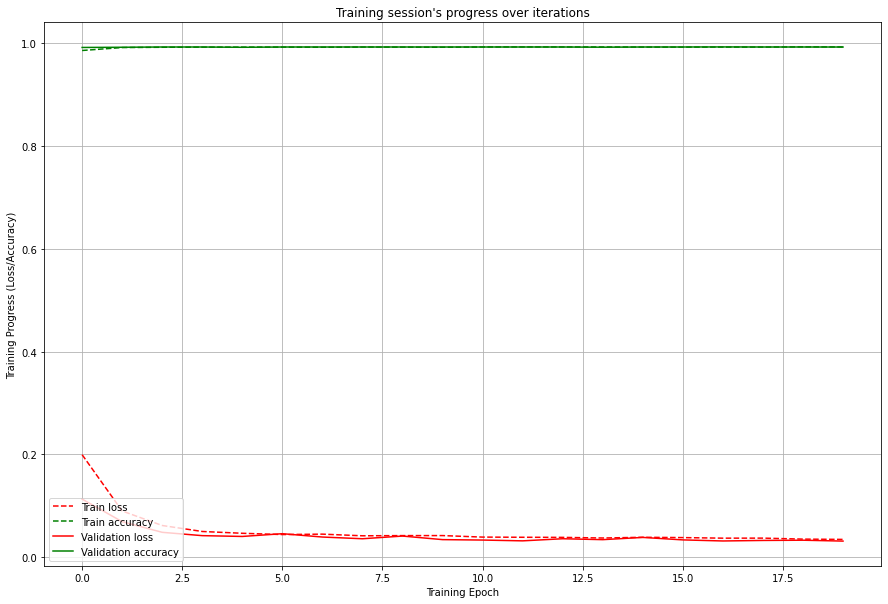

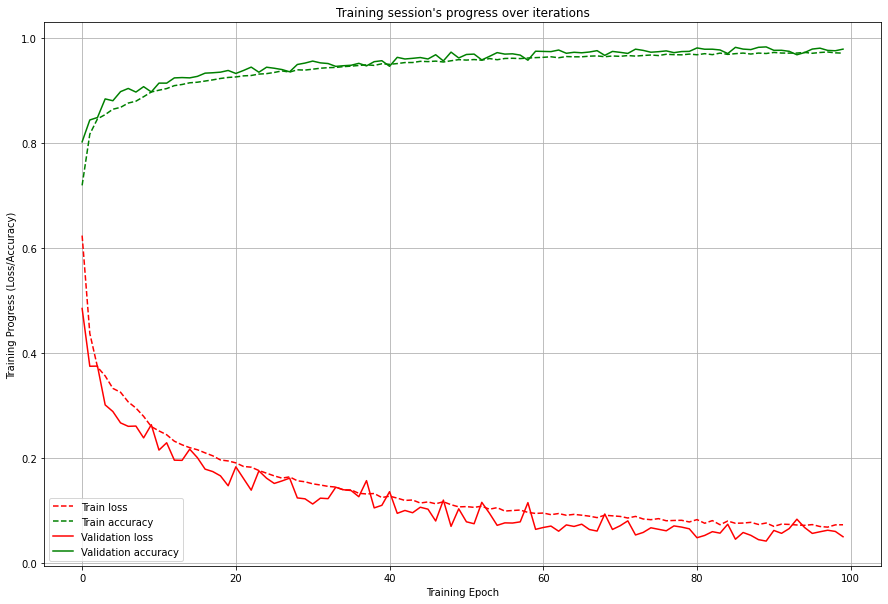

Model: "sequential_147"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_76 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_76 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_289 (Dropout)       (None, 512)               0         
                                                                 
 dense_294 (Dense)           (None, 64)                32832     
                                                                 
 dense_295 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0953 - accuracy: 0.9640 - val_loss: 0.0819 - val_accuracy: 0.9685
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0935 - accuracy: 0.9639 - val_loss: 0.0788 - val_accuracy: 0.9708
Epoch 71/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0931 - accuracy: 0.9642 - val_loss: 0.0820 - val_accuracy: 0.9700
Epoch 72/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0948 - accuracy: 0.9637 - val_loss: 0.0896 - val_accuracy: 0.9682
Epoch 73/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0895 - accuracy: 0.9657 - val_loss: 0.0839 - val_accuracy: 0.9690
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0888 - accuracy: 0.9654 - val_loss: 0.0704 - val_accuracy: 0.9723
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0899 - accuracy: 0.9660 - val_loss: 0.0742 - val_accuracy: 0.972

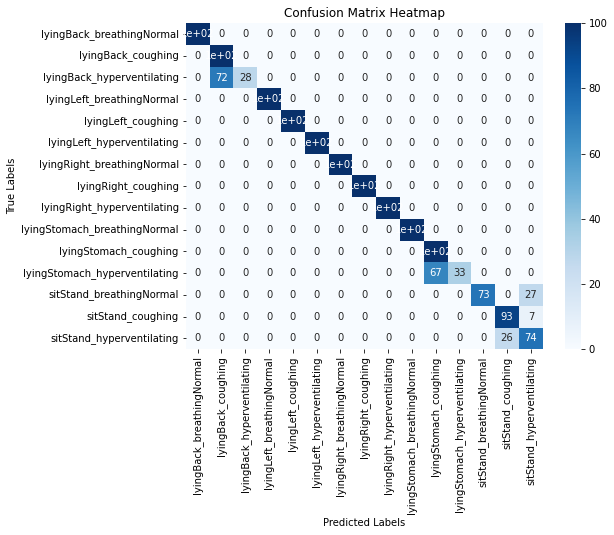

69/71 0.8567708333333334 0.8710711919156535


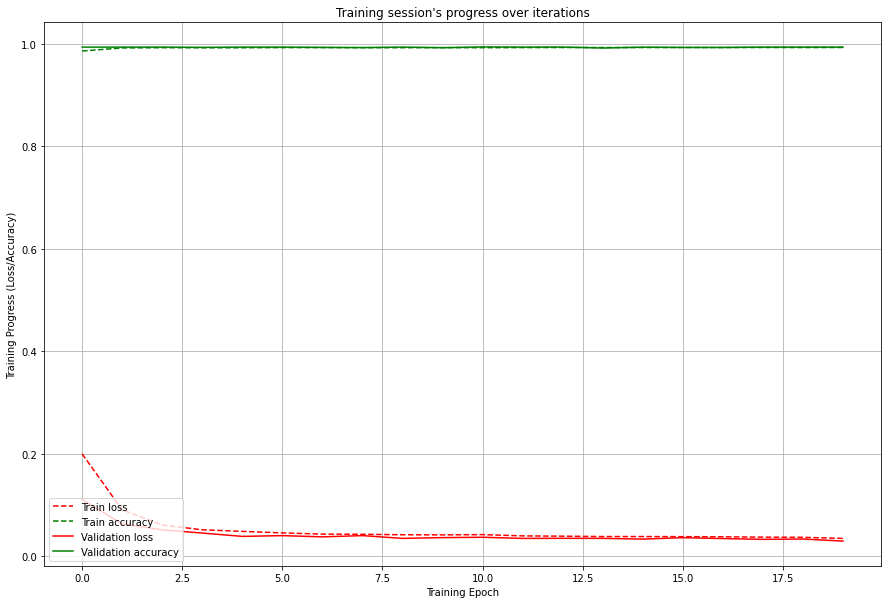

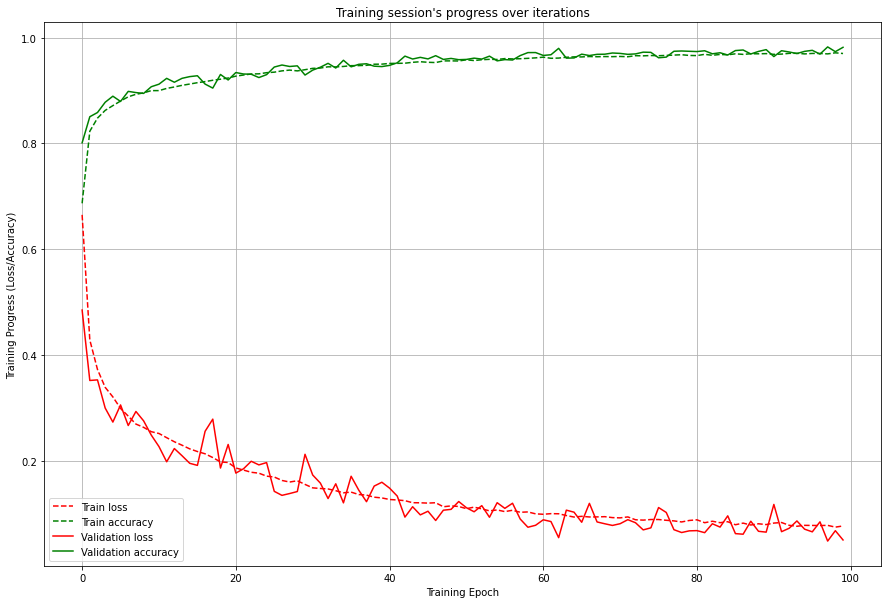

Model: "sequential_149"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_77 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_77 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_293 (Dropout)       (None, 512)               0         
                                                                 
 dense_298 (Dense)           (None, 64)                32832     
                                                                 
 dense_299 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815

495/495 [==============================] - 5s 11ms/step - loss: 0.0889 - accuracy: 0.9658 - val_loss: 0.0678 - val_accuracy: 0.9730
Epoch 70/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0880 - accuracy: 0.9658 - val_loss: 0.0862 - val_accuracy: 0.9697
Epoch 71/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0847 - accuracy: 0.9671 - val_loss: 0.0699 - val_accuracy: 0.9738
Epoch 72/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0877 - accuracy: 0.9651 - val_loss: 0.0716 - val_accuracy: 0.9747
Epoch 73/100
495/495 [==============================] - 6s 11ms/step - loss: 0.0872 - accuracy: 0.9662 - val_loss: 0.0710 - val_accuracy: 0.9736
Epoch 74/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0828 - accuracy: 0.9672 - val_loss: 0.0786 - val_accuracy: 0.9720
Epoch 75/100
495/495 [==============================] - 5s 11ms/step - loss: 0.0844 - accuracy: 0.9680 - val_loss: 0.0680 - val_accuracy: 0.974

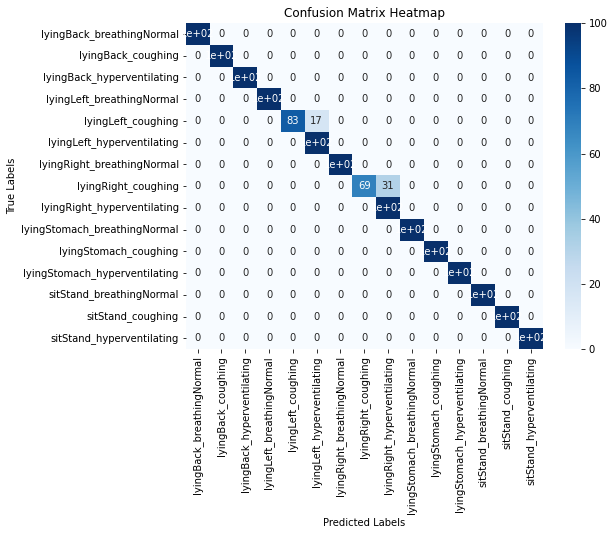

70/71 0.9728308501314636 0.8725044265384114


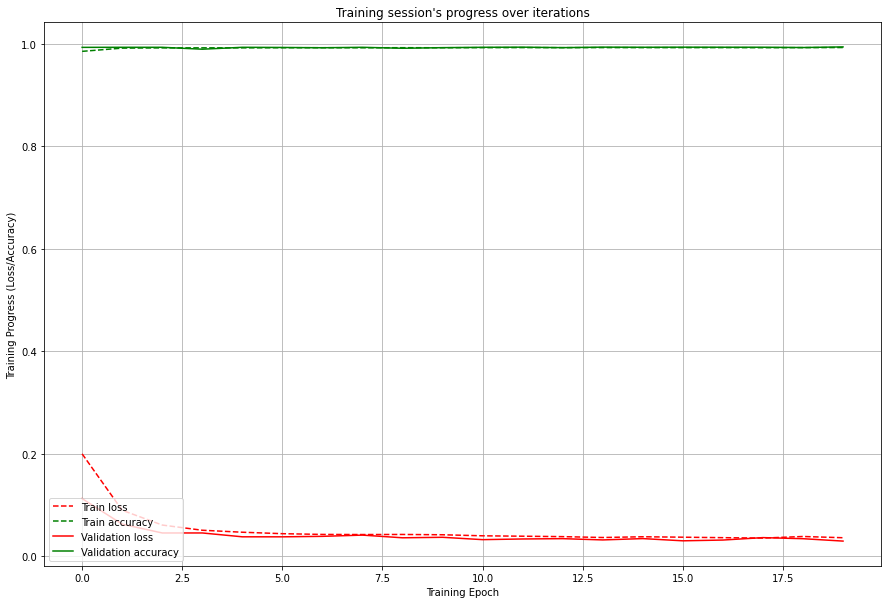

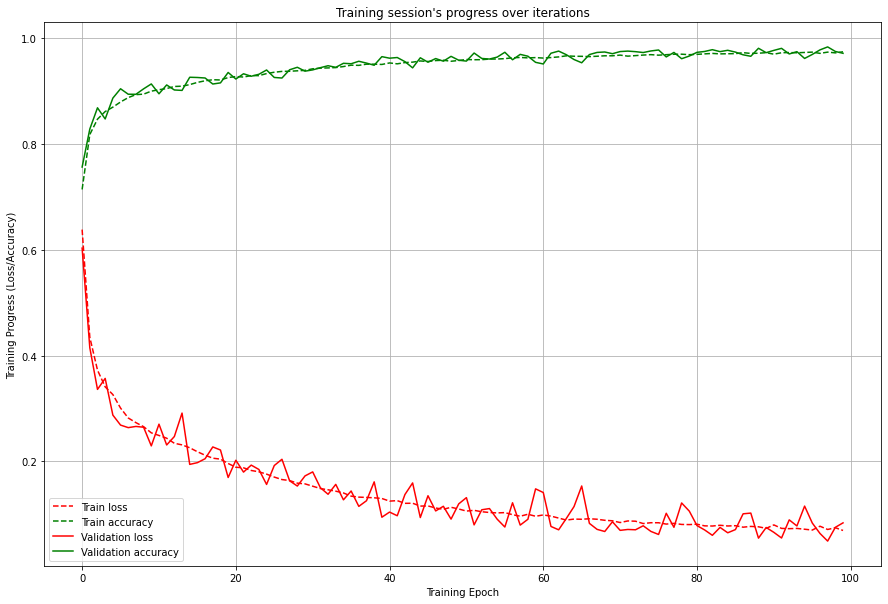

In [51]:
accuracies = []
histories_act = []
histories_sub = []

for i,student in enumerate(students):
    train_dataset = task2Dataset[task2Dataset.file_id != student]
    test_dataset = task2Dataset[task2Dataset.file_id == student]

    Xtrn_act, Xtrn_sub, ytrn_act, ytrn_sub = sliding_window(train_dataset, 3)
    Xtst_act, Xtst_sub, ytst_act, ytst_sub = sliding_window(test_dataset, 3)

#     print(" ..after sliding and reshaping, train data: inputs {0}, targets {1}".format(X_train.shape, y_train.shape))
#     print(" ..after sliding and reshaping, test data : inputs {0}, targets {1}".format(X_test.shape, y_test.shape))

    # ACTIVITIES
    model1 = build_model_activities(Xtrn_act)
    history_act = model1.fit(Xtrn_act, ytrn_act, epochs = 20, validation_split = 0.20, batch_size = 128, verbose=1, class_weight=class_weights_dict_act)
    pred_y_act = list(map(np.argmax, model1.predict(Xtst_act)))
    true_y_act = list(map(np.argmax, ytst_act))
    
    # SUBACTIVITIES
    model2 = build_model2()
    history_sub = model2.fit(Xtrn_sub, ytrn_sub, epochs = 100, validation_split = 0.20, batch_size = 128, verbose=1)#, callbacks=[early_stopping])
    pred_y_sub = list(map(np.argmax, model2.predict(Xtst_sub)))
    true_y_sub = list(map(np.argmax, ytst_sub))
    
    pred_y = list(map(lambda x: f'{label_stationary_dict[x[0]]}_{label_sub_activity_dict[x[1]]}', zip(pred_y_act, pred_y_sub)))
    true_y = list(map(lambda x: f'{label_stationary_dict[x[0]]}_{label_sub_activity_dict[x[1]]}', zip(true_y_act, true_y_sub)))

    labels = np.unique(pred_y)
    
    cm = confusion_matrix(true_y, pred_y)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title("Confusion Matrix Heatmap")
    plt.show()
    
    accuracy = accuracy_score(true_y, pred_y)
    accuracies.append(accuracy)
    histories_act.append(history_act)
    histories_sub.append(history_sub)

    print(f'{i}/{len(students)}', accuracy, np.average(accuracies))

    plt.figure(figsize=(15,10))
    plt.plot(np.array(history_act.history['loss']), "r--", label = "Train loss")
    plt.plot(np.array(history_act.history['accuracy']), "g--", label = "Train accuracy")
    plt.plot(np.array(history_act.history['val_loss']), "r-", label = "Validation loss")
    plt.plot(np.array(history_act.history['val_accuracy']), "g-", label = "Validation accuracy")
    plt.title("Training session's progress over iterations")
    plt.legend(loc='lower left')
    plt.ylabel('Training Progress (Loss/Accuracy)')
    plt.xlabel('Training Epoch')
    # plt.ylim(0)
    plt.grid()
    plt.show()
    
    plt.figure(figsize=(15,10))
    plt.plot(np.array(history_sub.history['loss']), "r--", label = "Train loss")
    plt.plot(np.array(history_sub.history['accuracy']), "g--", label = "Train accuracy")
    plt.plot(np.array(history_sub.history['val_loss']), "r-", label = "Validation loss")
    plt.plot(np.array(history_sub.history['val_accuracy']), "g-", label = "Validation accuracy")
    plt.title("Training session's progress over iterations")
    plt.legend(loc='lower left')
    plt.ylabel('Training Progress (Loss/Accuracy)')
    plt.xlabel('Training Epoch')
    # plt.ylim(0)
    plt.grid()
    plt.show()

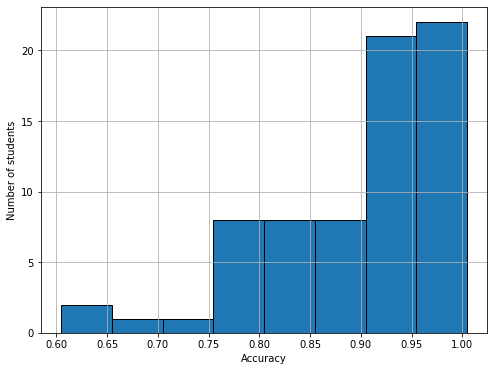

0.9001584758341861

In [75]:
plt.figure(figsize=(8,6))
plt.hist(accuracies, bins=np.arange(min(accuracies), max(accuracies) + 0.05, 0.05), edgecolor='black')
plt.xlabel('Accuracy')
plt.ylabel('Number of students')
plt.grid()
plt.savefig('acc_spread_2.pdf')
plt.show()
np.average(accuracies)

# Task 3

In [8]:
task3Dataset = dataset[dataset['activity'].isin(stationary_dict)].copy()
task3Dataset['activity_label'] = task3Dataset['activity'].replace(stationary_dict)
students = task3Dataset.file_id.unique()
task3Dataset

,timestamp,accel_x,accel_y,accel_z,gyro_x,gyro_y,gyro_z,file_id,class,activity,sub_activity,activity_label,sub_activity_label
0,1697605965,-0.596436,-0.181213,0.870056,0.468750,-0.296875,0.015625,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
1,1697606005,-0.593994,-0.189026,0.880310,0.937500,-0.390625,-0.125000,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
2,1697606045,-0.591064,-0.172668,0.883484,1.125000,-0.500000,-0.140625,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
3,1697606085,-0.580322,-0.176819,0.875671,-0.234375,-0.781250,0.031250,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
4,1697606125,-0.598145,-0.189758,0.882263,0.421875,-1.031250,-0.031250,1,lyingBack_breathingNormal,lyingBack,breathingNormal,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...
755,1697636165,-0.206299,-0.975891,0.181335,0.859375,-1.125000,-0.625000,98,sitStand_other,sitStand,other,4,3
756,1697636205,-0.196289,-0.944153,0.163513,0.812500,0.390625,0.203125,98,sitStand_other,sitStand,other,4,3
757,1697636245,-0.194824,-0.959290,0.168640,1.390625,0.421875,0.312500,98,sitStand_other,sitStand,other,4,3
758,1697636285,-0.191406,-0.976868,0.154480,0.546875,0.859375,-0.406250,98,sitStand_other,sitStand,other,4,3


In [12]:
SENSOR_CHANNELS = 3
SLIDING_WINDOW_LENGTH = 125

In [9]:
y = list(task3Dataset.activity_label)
class_labels = np.unique(y)
class_weights = compute_class_weight('balanced', class_labels, y)
class_weights_dict_act = {class_label: weight for class_label, weight in zip(class_labels, class_weights)}
class_weights_dict_act

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0: 1.2782435230226104,
 1: 1.2674520472725912,
 2: 1.2666103380651437,
 3: 1.2666498299176558,
 4: 0.5406285016195614}

In [10]:
y = list(task3Dataset.sub_activity_label)
class_labels = np.unique(y)
class_weights = compute_class_weight('balanced', class_labels, y)
class_weights_dict_sub = {class_label: weight for class_label, weight in zip(class_labels, class_weights)}
class_weights_dict_sub

IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



{0: 1.5709689494411394,
 1: 1.5986544897040444,
 2: 1.6014071137769117,
 3: 0.4731547782659132}

In [11]:
def build_model3():
    model = Sequential()
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu', input_shape=(125, 3)))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.1))
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.1))
    model.add(Conv1D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling1D(pool_size=2))
    model.add(Dropout(0.1))
    model.add(Flatten())
    model.add(Dense(units=64, activation='relu'))
    model.add(Dense(units=4, activation='softmax'))
    model.compile(optimizer='adam', loss='categorical_crossentropy', metrics=['accuracy'])
    model.summary()
    
    return model

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization (Normalizati  (None, None, 125)         251       
 on)                                                             
                                                                 
 bidirectional (Bidirection  (None, 512)               782336    
 al)                                                             
                                                                 
 dropout (Dropout)           (None, 512)               0         
                                                                 
 dense (Dense)               (None, 64)                32832     
                                                                 
 dense_1 (Dense)             (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 815493 

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4840 - accuracy: 0.7348 - val_loss: 0.8017 - val_accuracy: 0.6754
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4763 - accuracy: 0.7380 - val_loss: 0.6263 - val_accuracy: 0.7200
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4638 - accuracy: 0.7450 - val_loss: 0.5535 - val_accuracy: 0.7560
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4562 - accuracy: 0.7480 - val_loss: 0.5903 - val_accuracy: 0.7404
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4492 - accuracy: 0.7518 - val_loss: 0.6193 - val_accuracy: 0.7315
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4375 - accuracy: 0.7574 - val_loss: 0.6035 - val_accuracy: 0.7344
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4361 - accuracy: 0.7608 - val_loss: 0

1112/1112 [==============================] - 10s 9ms/step - loss: 0.2623 - accuracy: 0.8550 - val_loss: 0.4045 - val_accuracy: 0.8327
Epoch 124/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2627 - accuracy: 0.8561 - val_loss: 0.3043 - val_accuracy: 0.8722
Epoch 125/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2625 - accuracy: 0.8570 - val_loss: 0.3240 - val_accuracy: 0.8636
Epoch 126/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2592 - accuracy: 0.8566 - val_loss: 0.3453 - val_accuracy: 0.8560
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2605 - accuracy: 0.8572 - val_loss: 0.2985 - val_accuracy: 0.8754
Epoch 128/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2596 - accuracy: 0.8565 - val_loss: 0.3043 - val_accuracy: 0.8687
Epoch 129/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2591 - accuracy: 0.8571 - val_loss: 0.3156 

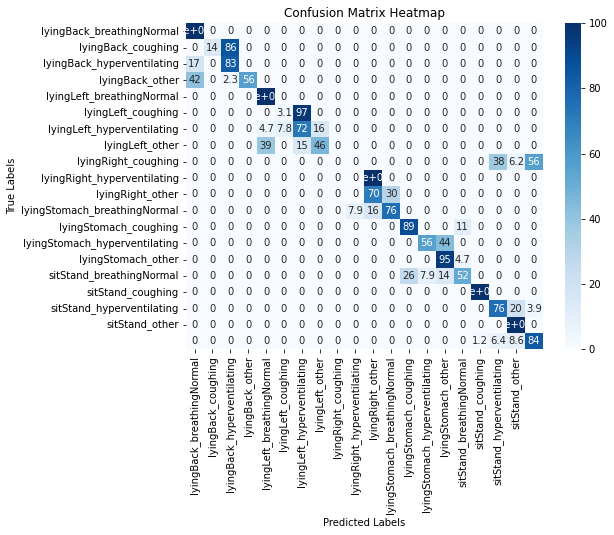

0/71 0.6816770186335404 0.7319062652039854


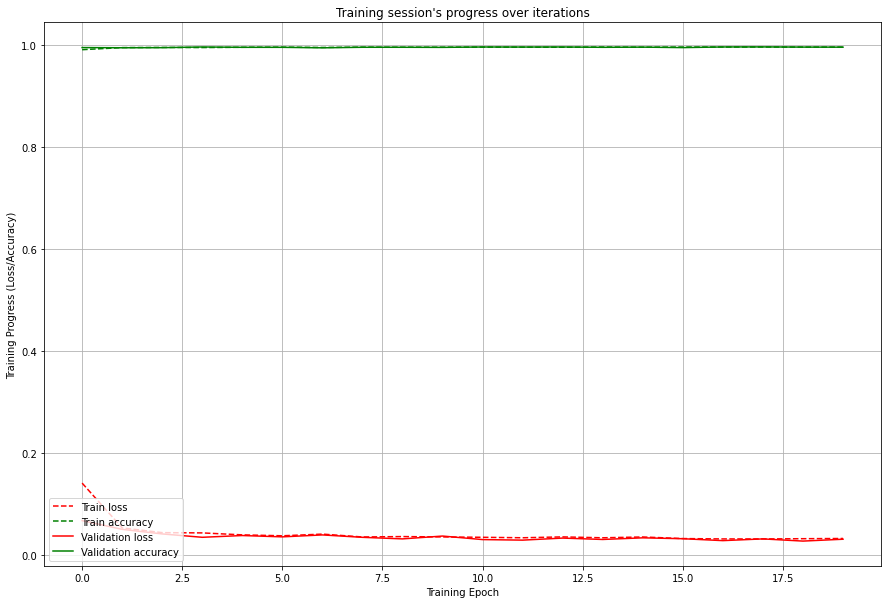

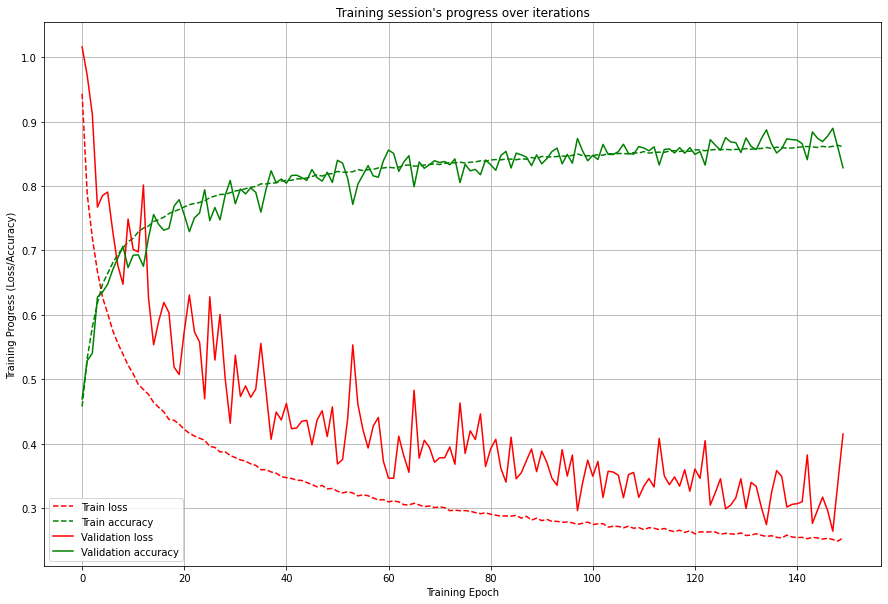

Model: "sequential_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_1 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_1 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_4 (Dropout)         (None, 512)               0         
                                                                 
 dense_4 (Dense)             (None, 64)                32832     
                                                                 
 dense_5 (Dense)             (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 81549

Epoch 13/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4777 - accuracy: 0.7389 - val_loss: 0.6627 - val_accuracy: 0.7203
Epoch 14/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4651 - accuracy: 0.7469 - val_loss: 0.6879 - val_accuracy: 0.7092
Epoch 15/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4546 - accuracy: 0.7526 - val_loss: 0.6475 - val_accuracy: 0.7262
Epoch 16/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4468 - accuracy: 0.7555 - val_loss: 0.6190 - val_accuracy: 0.7287
Epoch 17/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4411 - accuracy: 0.7597 - val_loss: 0.5458 - val_accuracy: 0.7579
Epoch 18/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4343 - accuracy: 0.7628 - val_loss: 0.5328 - val_accuracy: 0.7654
Epoch 19/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4277 - accuracy: 0.7661 - val_

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2650 - accuracy: 0.8560 - val_loss: 0.2880 - val_accuracy: 0.8749
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2661 - accuracy: 0.8546 - val_loss: 0.2975 - val_accuracy: 0.8703
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2663 - accuracy: 0.8537 - val_loss: 0.3484 - val_accuracy: 0.8517
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2610 - accuracy: 0.8561 - val_loss: 0.3025 - val_accuracy: 0.8680
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2587 - accuracy: 0.8588 - val_loss: 0.3376 - val_accuracy: 0.8553
Epoch 128/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2599 - accuracy: 0.8578 - val_loss: 0.3600 - val_accuracy: 0.8499
Epoch 129/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2595 - accuracy: 0.8583 - val_loss: 0.2

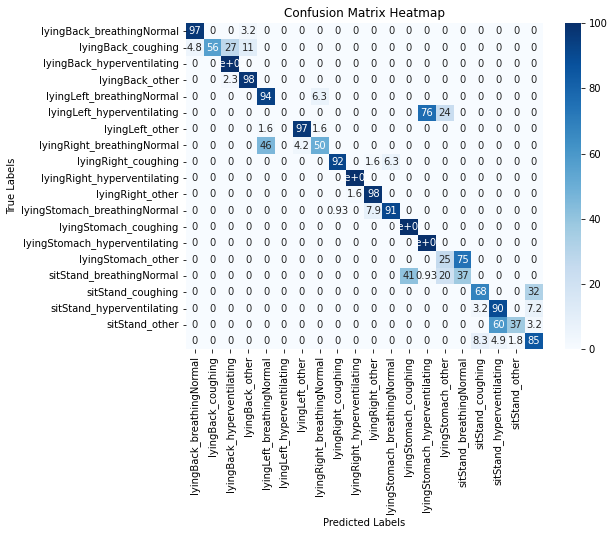

1/71 0.7517702596380803 0.7324738079021024


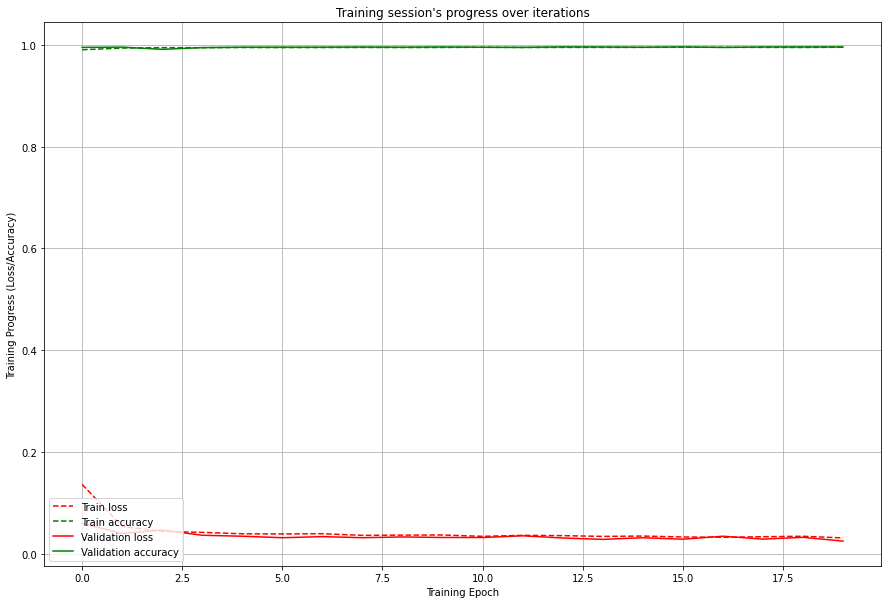

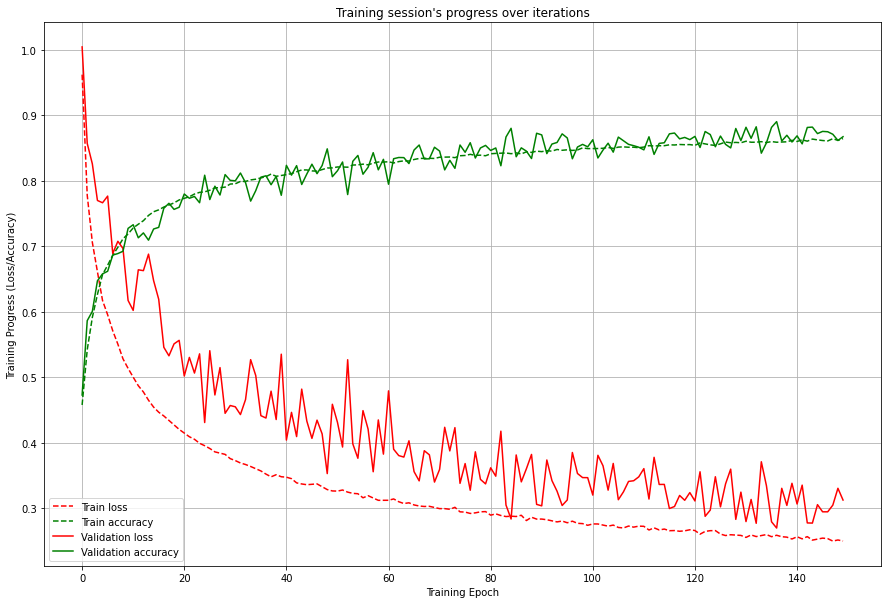

Model: "sequential_4"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_2 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_2 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_8 (Dropout)         (None, 512)               0         
                                                                 
 dense_8 (Dense)             (None, 64)                32832     
                                                                 
 dense_9 (Dense)             (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 81549

Epoch 13/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4835 - accuracy: 0.7375 - val_loss: 0.6049 - val_accuracy: 0.7349
Epoch 14/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4726 - accuracy: 0.7447 - val_loss: 0.5379 - val_accuracy: 0.7668
Epoch 15/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4634 - accuracy: 0.7474 - val_loss: 0.6314 - val_accuracy: 0.7295
Epoch 16/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4509 - accuracy: 0.7540 - val_loss: 0.5606 - val_accuracy: 0.7508
Epoch 17/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4443 - accuracy: 0.7568 - val_loss: 0.6049 - val_accuracy: 0.7419
Epoch 18/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4338 - accuracy: 0.7625 - val_loss: 0.5684 - val_accuracy: 0.7525
Epoch 19/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.4258 - accuracy: 0.7683 - val_

1113/1113 [==============================] - 11s 10ms/step - loss: 0.2566 - accuracy: 0.8587 - val_loss: 0.2832 - val_accuracy: 0.8798
Epoch 124/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2570 - accuracy: 0.8588 - val_loss: 0.3151 - val_accuracy: 0.8632
Epoch 125/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2549 - accuracy: 0.8603 - val_loss: 0.2890 - val_accuracy: 0.8767
Epoch 126/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2553 - accuracy: 0.8599 - val_loss: 0.3157 - val_accuracy: 0.8660
Epoch 127/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2528 - accuracy: 0.8608 - val_loss: 0.3537 - val_accuracy: 0.8481
Epoch 128/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2533 - accuracy: 0.8613 - val_loss: 0.3427 - val_accuracy: 0.8545
Epoch 129/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2528 - accuracy: 0.8611 - val_loss: 0

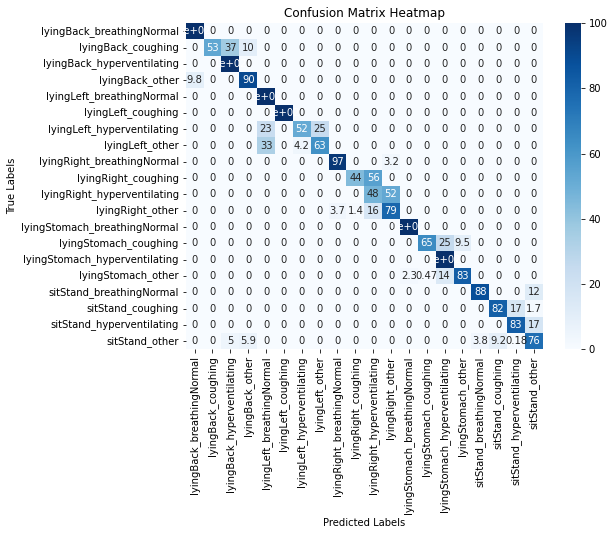

2/71 0.7915839618896388 0.7341157566239783


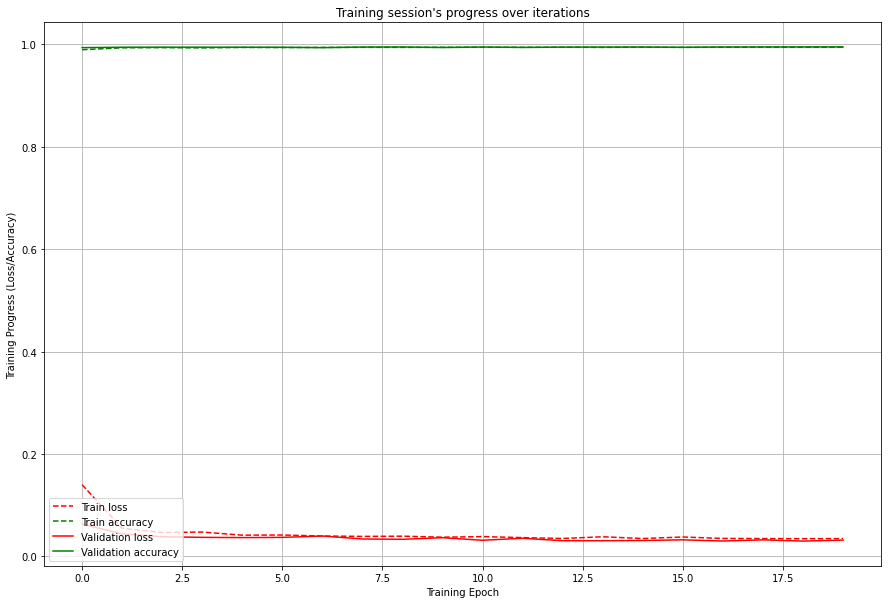

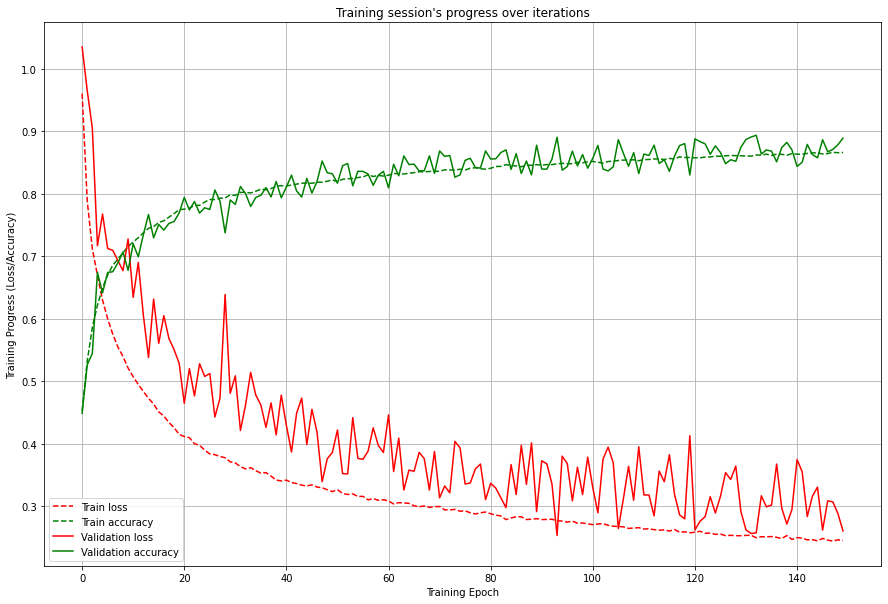

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_3 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_3 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_12 (Dropout)        (None, 512)               0         
                                                                 
 dense_12 (Dense)            (None, 64)                32832     
                                                                 
 dense_13 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 81549

Epoch 13/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4756 - accuracy: 0.7400 - val_loss: 0.5347 - val_accuracy: 0.7645
Epoch 14/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4658 - accuracy: 0.7458 - val_loss: 0.7057 - val_accuracy: 0.6997
Epoch 15/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4548 - accuracy: 0.7506 - val_loss: 0.6014 - val_accuracy: 0.7398
Epoch 16/150
1112/1112 [==============================] - 15s 13ms/step - loss: 0.4502 - accuracy: 0.7520 - val_loss: 0.6201 - val_accuracy: 0.7268
Epoch 17/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4390 - accuracy: 0.7578 - val_loss: 0.5650 - val_accuracy: 0.7478
Epoch 18/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4288 - accuracy: 0.7643 - val_loss: 0.5662 - val_accuracy: 0.7536
Epoch 19/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.4244 - accuracy: 0.7657 - val_

1112/1112 [==============================] - 14s 13ms/step - loss: 0.2605 - accuracy: 0.8571 - val_loss: 0.3079 - val_accuracy: 0.8701
Epoch 124/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2602 - accuracy: 0.8566 - val_loss: 0.3020 - val_accuracy: 0.8696
Epoch 125/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2613 - accuracy: 0.8569 - val_loss: 0.3097 - val_accuracy: 0.8721
Epoch 126/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2617 - accuracy: 0.8572 - val_loss: 0.4270 - val_accuracy: 0.8254
Epoch 127/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2598 - accuracy: 0.8574 - val_loss: 0.2887 - val_accuracy: 0.8778
Epoch 128/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2602 - accuracy: 0.8569 - val_loss: 0.3393 - val_accuracy: 0.8570
Epoch 129/150
1112/1112 [==============================] - 14s 13ms/step - loss: 0.2619 - accuracy: 0.8557 - val_loss: 0

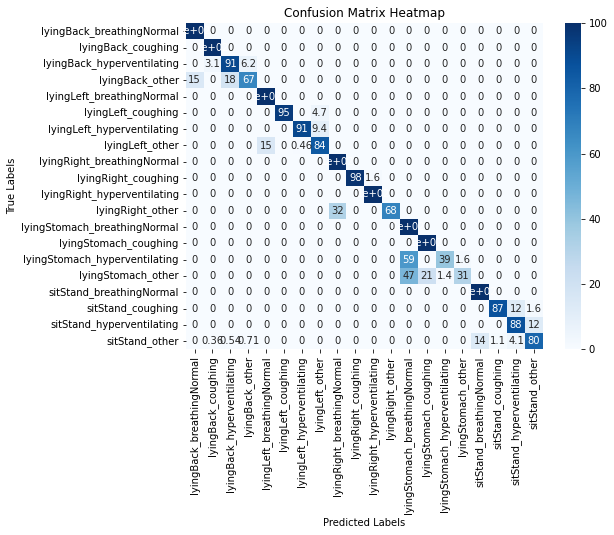

3/71 0.7961956521739131 0.7357935916388415


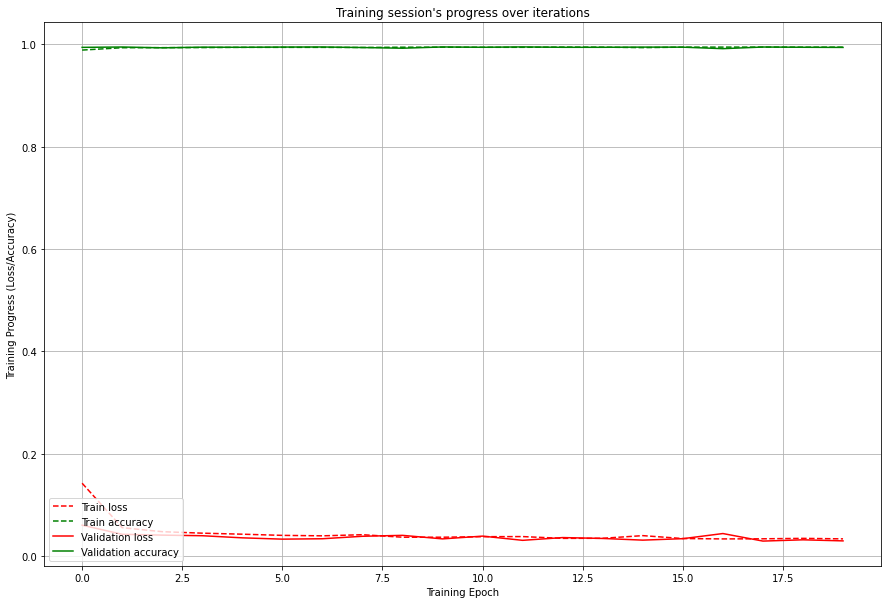

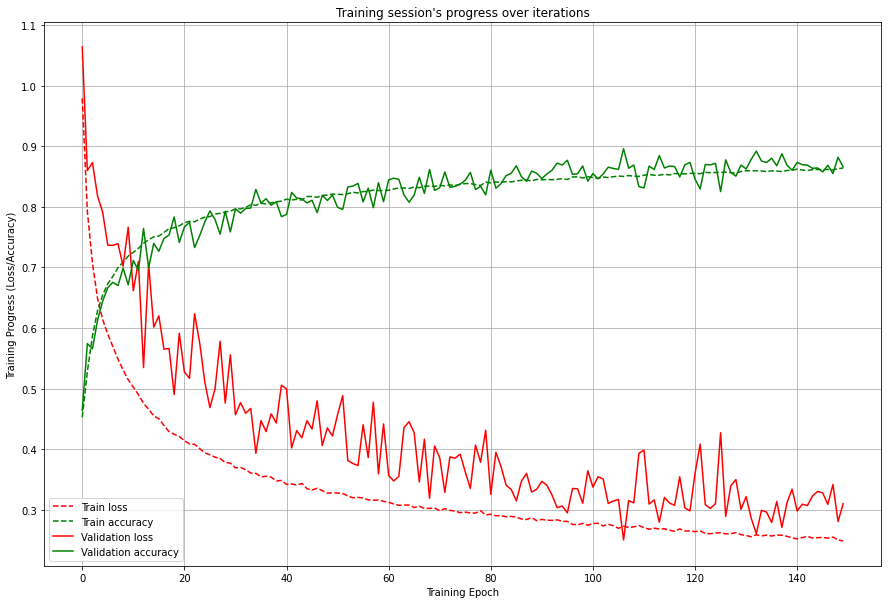

Model: "sequential_8"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_4 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_4 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_16 (Dropout)        (None, 512)               0         
                                                                 
 dense_16 (Dense)            (None, 64)                32832     
                                                                 
 dense_17 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 81549

Epoch 13/150
1111/1111 [==============================] - 14s 13ms/step - loss: 0.4801 - accuracy: 0.7402 - val_loss: 0.6282 - val_accuracy: 0.7235
Epoch 14/150
1111/1111 [==============================] - 14s 13ms/step - loss: 0.4669 - accuracy: 0.7457 - val_loss: 0.6315 - val_accuracy: 0.7255
Epoch 15/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.4589 - accuracy: 0.7511 - val_loss: 0.5568 - val_accuracy: 0.7534
Epoch 16/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.4494 - accuracy: 0.7545 - val_loss: 0.5422 - val_accuracy: 0.7604
Epoch 17/150
1111/1111 [==============================] - 14s 13ms/step - loss: 0.4420 - accuracy: 0.7598 - val_loss: 0.5366 - val_accuracy: 0.7617
Epoch 18/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.4341 - accuracy: 0.7638 - val_loss: 0.5222 - val_accuracy: 0.7697
Epoch 19/150
1111/1111 [==============================] - 14s 13ms/step - loss: 0.4289 - accuracy: 0.7672 - val_

1111/1111 [==============================] - 15s 13ms/step - loss: 0.2573 - accuracy: 0.8583 - val_loss: 0.2756 - val_accuracy: 0.8835
Epoch 124/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.2571 - accuracy: 0.8588 - val_loss: 0.3241 - val_accuracy: 0.8602
Epoch 125/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.2586 - accuracy: 0.8580 - val_loss: 0.2619 - val_accuracy: 0.8910
Epoch 126/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.2604 - accuracy: 0.8558 - val_loss: 0.3714 - val_accuracy: 0.8439
Epoch 127/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.2546 - accuracy: 0.8608 - val_loss: 0.3768 - val_accuracy: 0.8431
Epoch 128/150
1111/1111 [==============================] - 15s 13ms/step - loss: 0.2545 - accuracy: 0.8603 - val_loss: 0.3199 - val_accuracy: 0.8630
Epoch 129/150
1111/1111 [==============================] - 14s 13ms/step - loss: 0.2557 - accuracy: 0.8586 - val_loss: 0

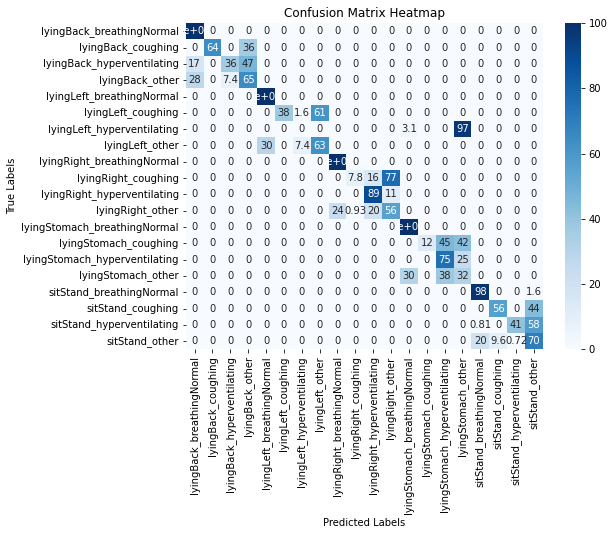

4/71 0.6083039561300431 0.7324386012307152


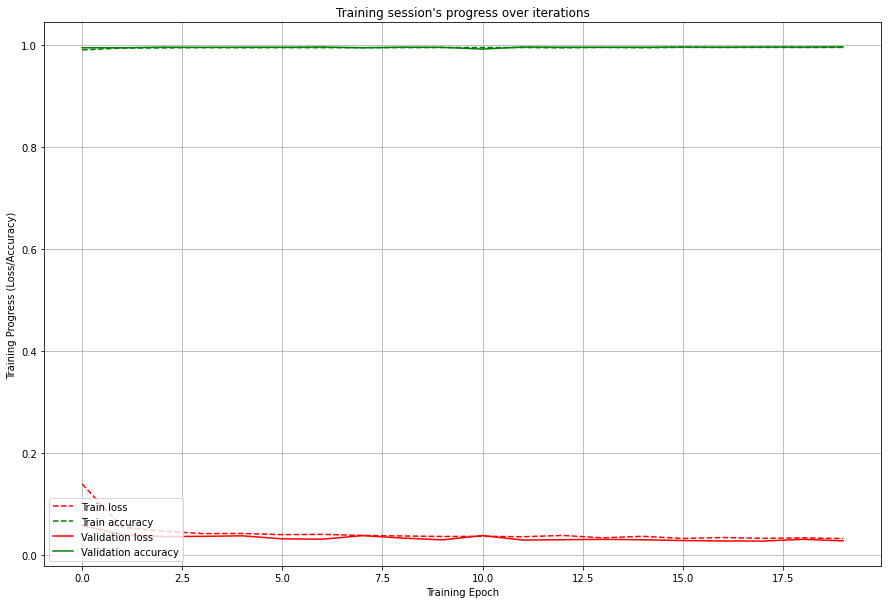

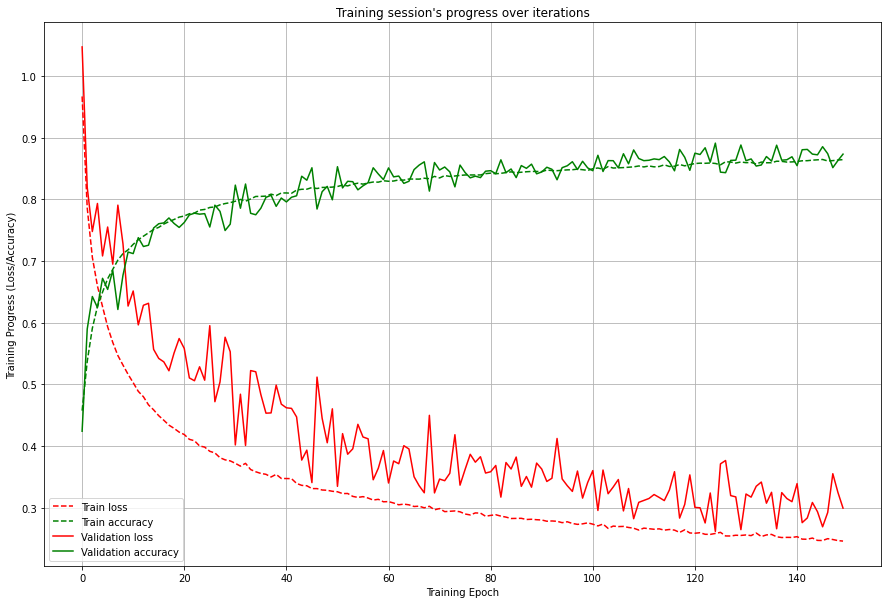

Model: "sequential_10"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_5 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_5 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_20 (Dropout)        (None, 512)               0         
                                                                 
 dense_20 (Dense)            (None, 64)                32832     
                                                                 
 dense_21 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.3016 - accuracy: 0.8341 - val_loss: 0.3635 - val_accuracy: 0.8430
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2979 - accuracy: 0.8361 - val_loss: 0.3745 - val_accuracy: 0.8350
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2958 - accuracy: 0.8372 - val_loss: 0.3229 - val_accuracy: 0.8659
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2956 - accuracy: 0.8385 - val_loss: 0.3997 - val_accuracy: 0.8257
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2975 - accuracy: 0.8372 - val_loss: 0.3613 - val_accuracy: 0.8452
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2945 - accuracy: 0.8390 - val_loss: 0.4328 - val_accuracy: 0.8208
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2938 - accuracy: 0.8398 - val_loss: 0.3961 

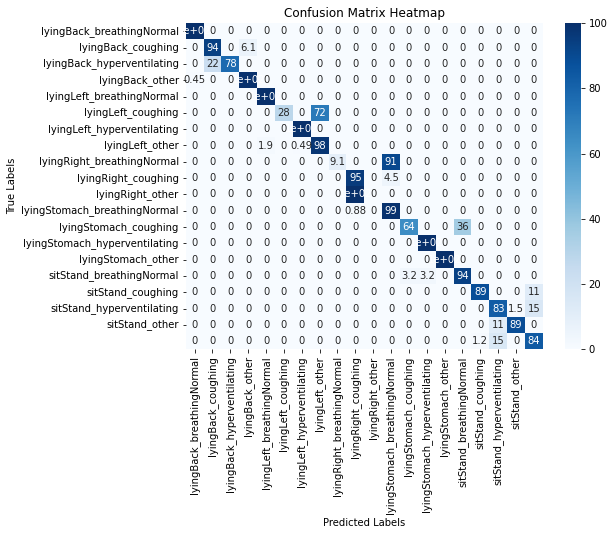

5/71 0.8520642201834863 0.7355059247936068


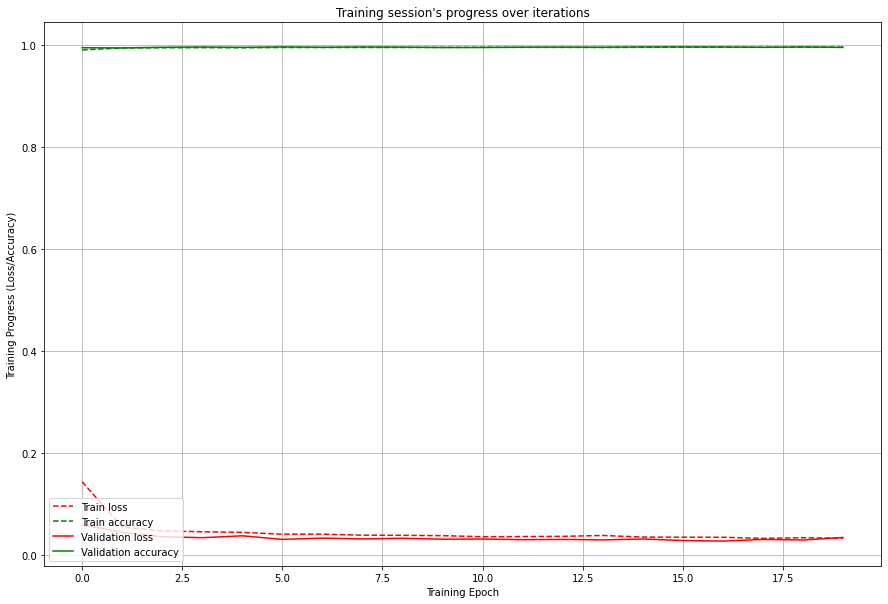

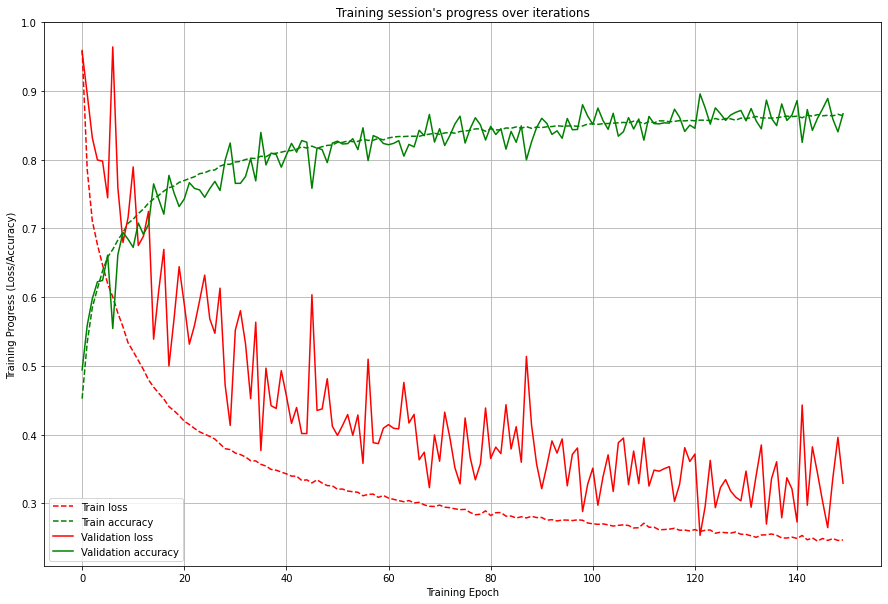

Model: "sequential_12"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_6 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_6 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_24 (Dropout)        (None, 512)               0         
                                                                 
 dense_24 (Dense)            (None, 64)                32832     
                                                                 
 dense_25 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1113/1113 [==============================] - 11s 10ms/step - loss: 0.2997 - accuracy: 0.8344 - val_loss: 0.4577 - val_accuracy: 0.8113
Epoch 68/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2969 - accuracy: 0.8362 - val_loss: 0.4484 - val_accuracy: 0.8163
Epoch 69/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2988 - accuracy: 0.8356 - val_loss: 0.3732 - val_accuracy: 0.8387
Epoch 70/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2994 - accuracy: 0.8351 - val_loss: 0.4024 - val_accuracy: 0.8268
Epoch 71/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2977 - accuracy: 0.8367 - val_loss: 0.4150 - val_accuracy: 0.8220
Epoch 72/150
1113/1113 [==============================] - 11s 9ms/step - loss: 0.2934 - accuracy: 0.8388 - val_loss: 0.3427 - val_accuracy: 0.8552
Epoch 73/150
1113/1113 [==============================] - 11s 10ms/step - loss: 0.2973 - accuracy: 0.8369 - val_loss: 0.3489 -

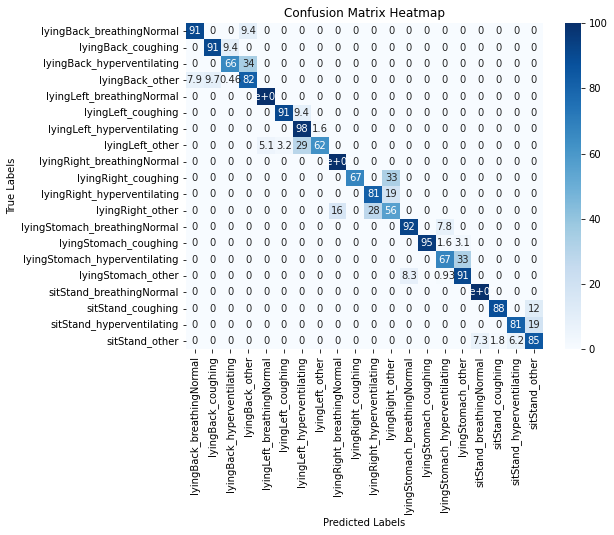

6/71 0.8202639751552795 0.7376248760526487


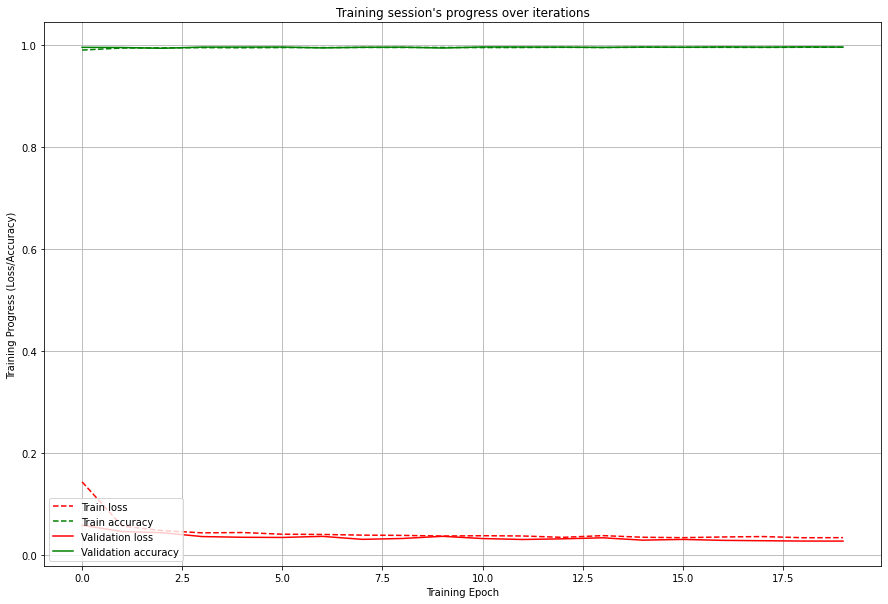

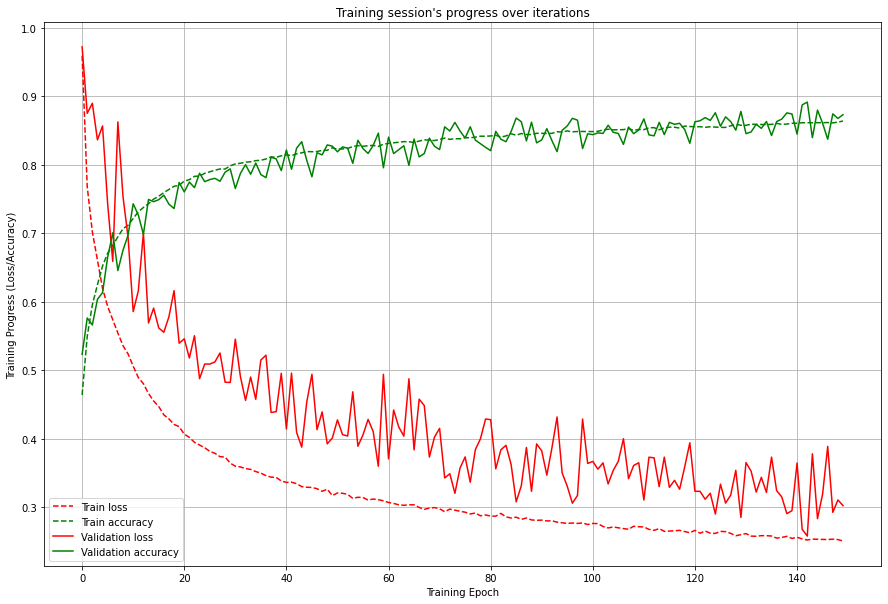

Model: "sequential_14"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_7 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_7 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_28 (Dropout)        (None, 512)               0         
                                                                 
 dense_28 (Dense)            (None, 64)                32832     
                                                                 
 dense_29 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1111/1111 [==============================] - 11s 10ms/step - loss: 0.2777 - accuracy: 0.8479 - val_loss: 0.3140 - val_accuracy: 0.8660
Epoch 90/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2750 - accuracy: 0.8478 - val_loss: 0.2793 - val_accuracy: 0.8823
Epoch 91/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2755 - accuracy: 0.8483 - val_loss: 0.3388 - val_accuracy: 0.8572
Epoch 92/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2771 - accuracy: 0.8468 - val_loss: 0.3342 - val_accuracy: 0.8605
Epoch 93/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2761 - accuracy: 0.8470 - val_loss: 0.3551 - val_accuracy: 0.8489
Epoch 94/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2759 - accuracy: 0.8483 - val_loss: 0.3578 - val_accuracy: 0.8493
Epoch 95/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2735 - accuracy: 0.8485 - val_loss: 0.3776 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1112/1112 [==============================] - 13s 12ms/step - loss: 0.0371 - accuracy: 0.9946 - val_loss: 0.0339 - val_accuracy: 0.9944
Epoch 12/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0363 - accuracy: 0.9947 - val_loss: 0.0358 - val_accuracy: 0.9938
Epoch 13/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0372 - accuracy: 0.9943 - val_loss: 0.0330 - val_accuracy: 0.9943
Epoch 14/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0342 - accuracy: 0.9949 - val_loss: 0.0397 - val_accuracy: 0.9935
Epoch 15/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0335 - accuracy: 0.9947 - val_loss: 0.0314 - val_accuracy: 0.9945
Epoch 16/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0361 - accuracy: 0.9946 - val_loss: 0.0427 - val_accuracy: 0.9927
Epoch 17/20
1112/1112 [==============================] - 13s 12ms/step - loss: 0.0332 - accuracy: 0.9949 - val_loss: 0.0365 - val_

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1112/1112 [==============================] - 12s 10ms/step - loss: 0.3000 - accuracy: 0.8344 - val_loss: 0.3963 - val_accuracy: 0.8318
Epoch 67/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2974 - accuracy: 0.8349 - val_loss: 0.5154 - val_accuracy: 0.7882
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2976 - accuracy: 0.8355 - val_loss: 0.3348 - val_accuracy: 0.8573
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2939 - accuracy: 0.8376 - val_loss: 0.3544 - val_accuracy: 0.8481
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2957 - accuracy: 0.8364 - val_loss: 0.3902 - val_accuracy: 0.8327
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2944 - accuracy: 0.8376 - val_loss: 0.4042 - val_accuracy: 0.8247
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2954 - accuracy: 0.8366 - val_loss: 0.3791 

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1112/1112 [==============================] - 11s 9ms/step - loss: 0.2484 - accuracy: 0.8639 - val_loss: 0.3039 - val_accuracy: 0.8721
Epoch 141/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2484 - accuracy: 0.8628 - val_loss: 0.2982 - val_accuracy: 0.8744
Epoch 142/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2481 - accuracy: 0.8630 - val_loss: 0.2816 - val_accuracy: 0.8834
Epoch 143/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2459 - accuracy: 0.8644 - val_loss: 0.2838 - val_accuracy: 0.8825
Epoch 144/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2498 - accuracy: 0.8627 - val_loss: 0.3443 - val_accuracy: 0.8587
Epoch 145/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2421 - accuracy: 0.8674 - val_loss: 0.3261 - val_accuracy: 0.8616
Epoch 146/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2473 - accuracy: 0.8641 - val_loss: 0.3048

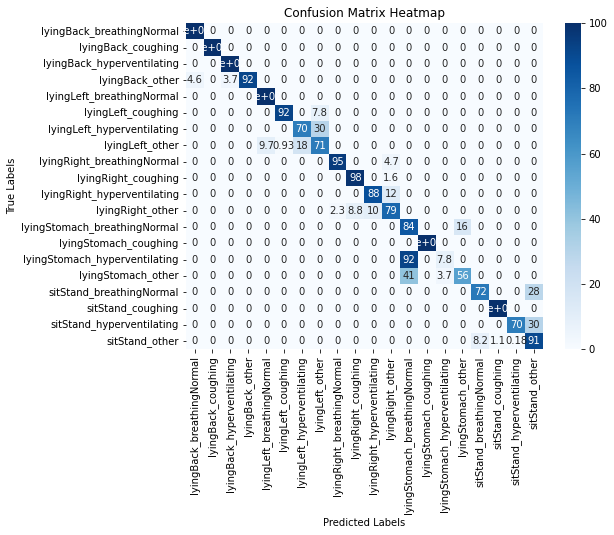

8/71 0.8237577639751553 0.7401461334106033


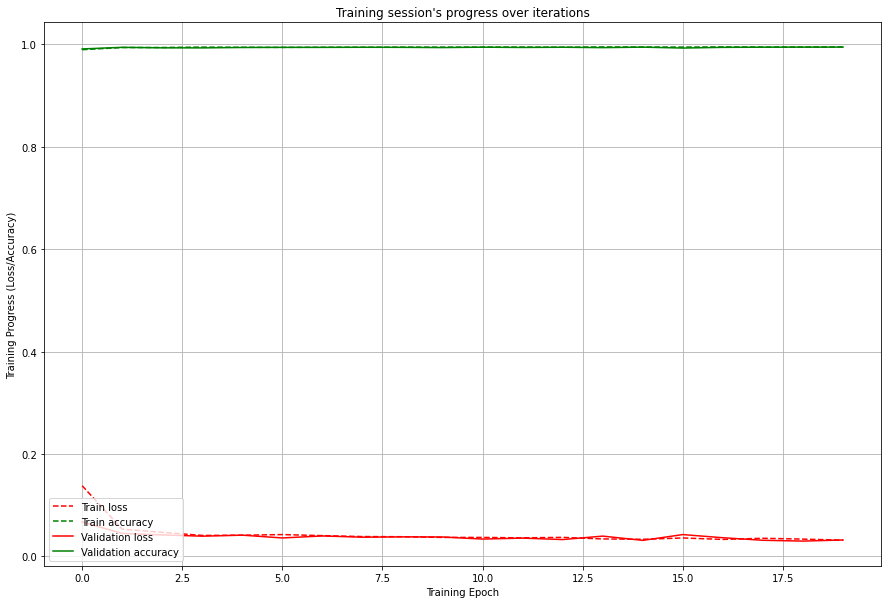

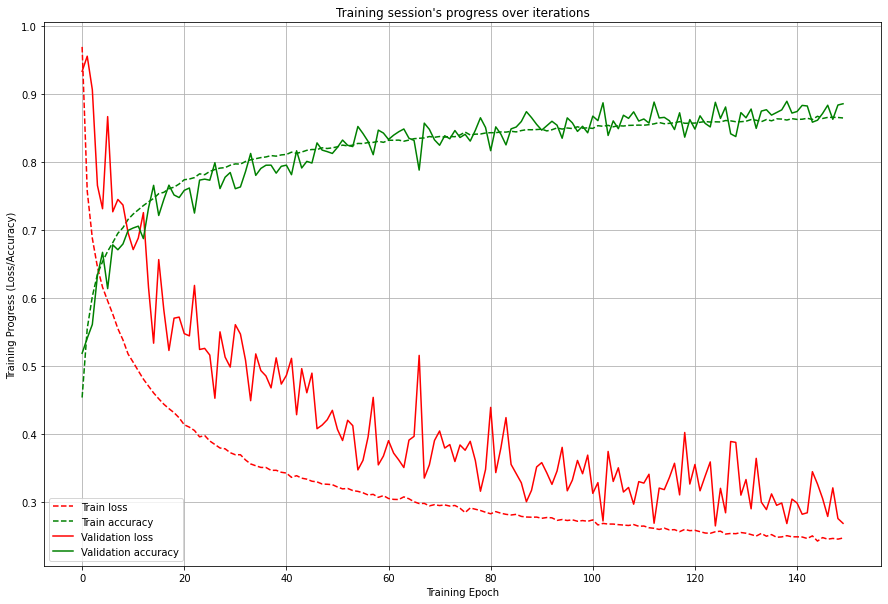

Model: "sequential_18"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_9 (Normaliza  (None, None, 125)         251       
 tion)                                                           
                                                                 
 bidirectional_9 (Bidirecti  (None, 512)               782336    
 onal)                                                           
                                                                 
 dropout_36 (Dropout)        (None, 512)               0         
                                                                 
 dense_36 (Dense)            (None, 64)                32832     
                                                                 
 dense_37 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

IOPub message rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_msg_rate_limit`.

Current values:
NotebookApp.iopub_msg_rate_limit=1000.0 (msgs/sec)
NotebookApp.rate_limit_window=3.0 (secs)



1112/1112 [==============================] - 11s 10ms/step - loss: 0.3517 - accuracy: 0.8067 - val_loss: 0.4394 - val_accuracy: 0.8075
Epoch 36/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3526 - accuracy: 0.8057 - val_loss: 0.4378 - val_accuracy: 0.8063
Epoch 37/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3499 - accuracy: 0.8079 - val_loss: 0.4523 - val_accuracy: 0.8026
Epoch 38/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3481 - accuracy: 0.8097 - val_loss: 0.4800 - val_accuracy: 0.7997
Epoch 39/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3423 - accuracy: 0.8114 - val_loss: 0.4860 - val_accuracy: 0.7909
Epoch 40/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3425 - accuracy: 0.8120 - val_loss: 0.4247 - val_accuracy: 0.8149
Epoch 41/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3419 - accuracy: 0.8121 - val_loss: 0.5082 

1112/1112 [==============================] - 10s 9ms/step - loss: 0.2450 - accuracy: 0.8652 - val_loss: 0.2531 - val_accuracy: 0.8936
Epoch 146/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2473 - accuracy: 0.8650 - val_loss: 0.3025 - val_accuracy: 0.8680
Epoch 147/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2455 - accuracy: 0.8659 - val_loss: 0.2921 - val_accuracy: 0.8763
Epoch 148/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2476 - accuracy: 0.8649 - val_loss: 0.2757 - val_accuracy: 0.8817
Epoch 149/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2447 - accuracy: 0.8646 - val_loss: 0.2971 - val_accuracy: 0.8725
Epoch 150/150
81/81 [==============================] - 0s 2ms/step


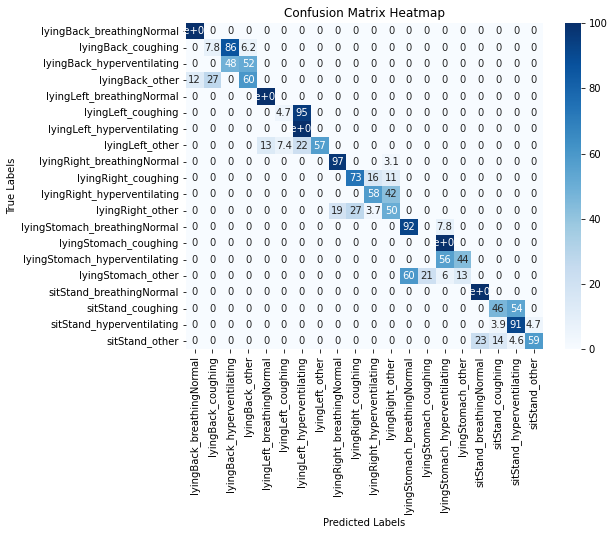

9/71 0.5807453416149069 0.7364391382525639


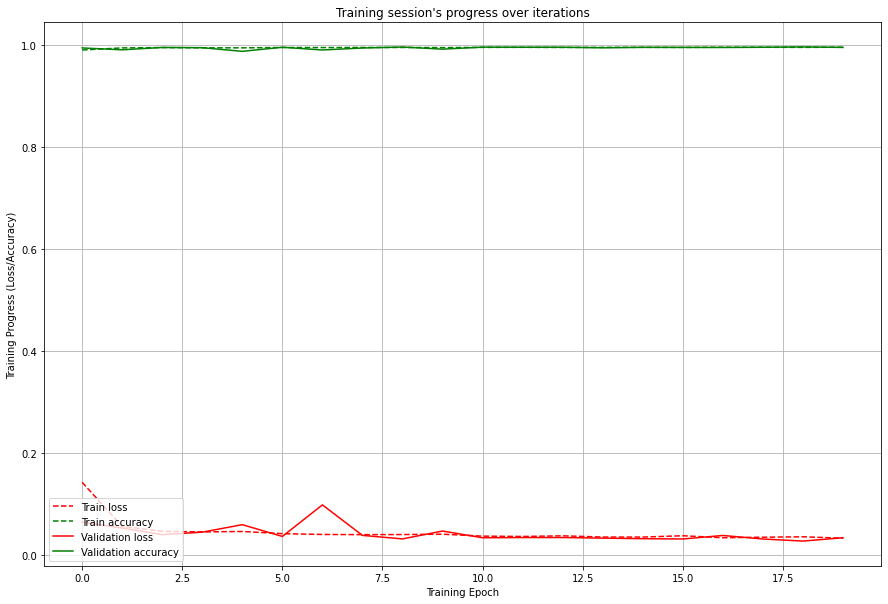

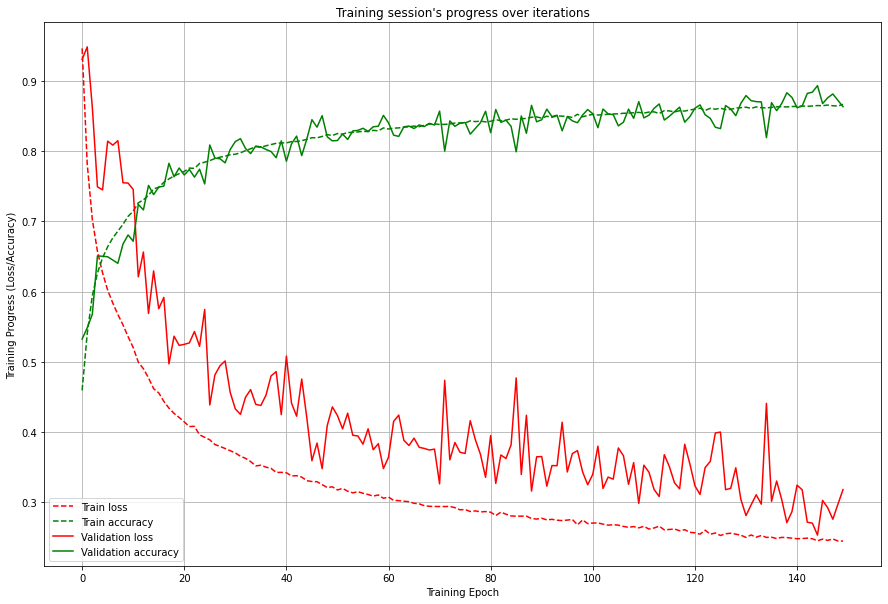

Model: "sequential_20"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_10 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_10 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_40 (Dropout)        (None, 512)               0         
                                                                 
 dense_40 (Dense)            (None, 64)                32832     
                                                                 
 dense_41 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1111/1111 [==============================] - 11s 9ms/step - loss: 0.3047 - accuracy: 0.8333 - val_loss: 0.3901 - val_accuracy: 0.8331
Epoch 68/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3001 - accuracy: 0.8364 - val_loss: 0.4487 - val_accuracy: 0.8101
Epoch 69/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3009 - accuracy: 0.8356 - val_loss: 0.3773 - val_accuracy: 0.8406
Epoch 70/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3020 - accuracy: 0.8351 - val_loss: 0.3783 - val_accuracy: 0.8386
Epoch 71/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3001 - accuracy: 0.8360 - val_loss: 0.3225 - val_accuracy: 0.8640
Epoch 72/150
1111/1111 [==============================] - 11s 9ms/step - loss: 0.2955 - accuracy: 0.8383 - val_loss: 0.4658 - val_accuracy: 0.8112
Epoch 73/150
1111/1111 [==============================] - 11s 9ms/step - loss: 0.3003 - accuracy: 0.8359 - val_loss: 0.3785 - v

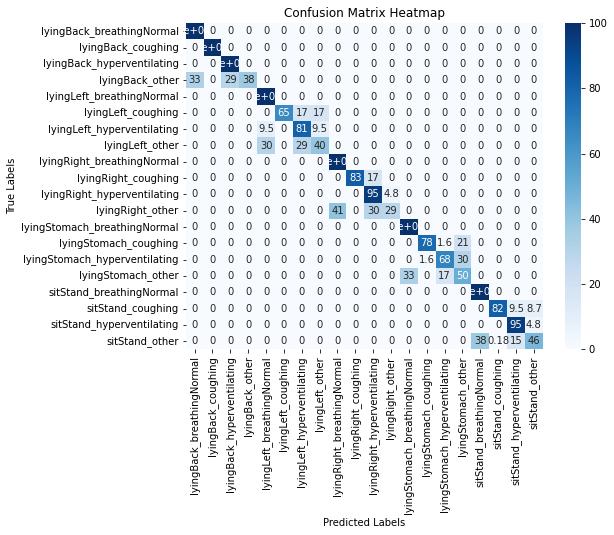

10/71 0.6357537490134175 0.7341508339516742


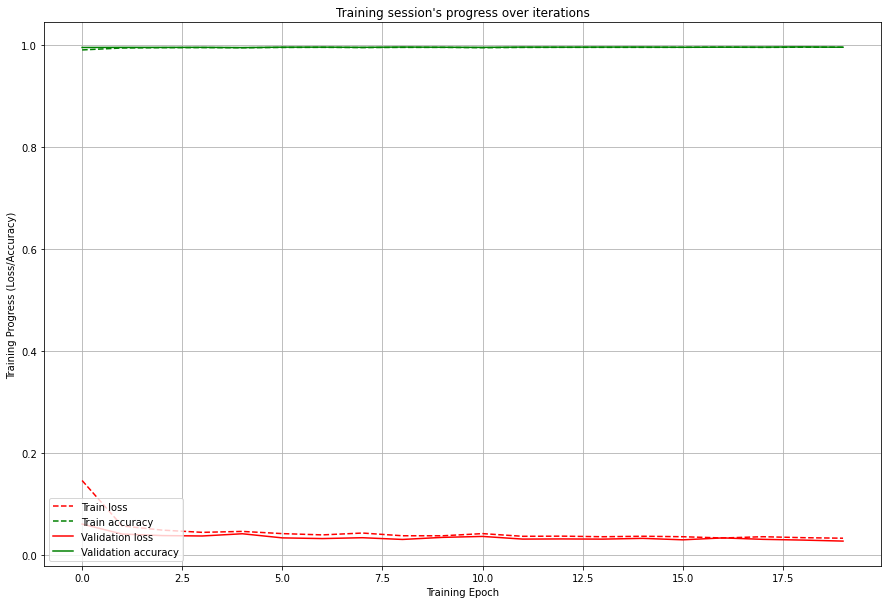

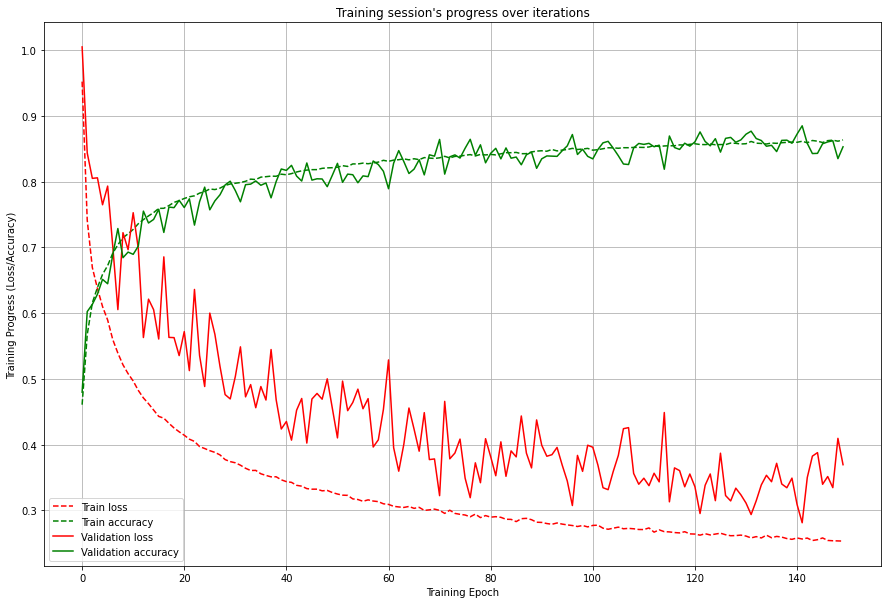

Model: "sequential_22"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_11 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_11 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_44 (Dropout)        (None, 512)               0         
                                                                 
 dense_44 (Dense)            (None, 64)                32832     
                                                                 
 dense_45 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4835 - accuracy: 0.7354 - val_loss: 0.6337 - val_accuracy: 0.7179
Epoch 14/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4741 - accuracy: 0.7413 - val_loss: 0.6469 - val_accuracy: 0.7201
Epoch 15/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4606 - accuracy: 0.7492 - val_loss: 0.6041 - val_accuracy: 0.7292
Epoch 16/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4551 - accuracy: 0.7509 - val_loss: 0.6524 - val_accuracy: 0.7158
Epoch 17/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4457 - accuracy: 0.7553 - val_loss: 0.6053 - val_accuracy: 0.7432
Epoch 18/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4405 - accuracy: 0.7588 - val_loss: 0.6455 - val_accuracy: 0.7282
Epoch 19/150
1111/1111 [==============================] - 10s 9ms/step - loss: 0.4333 - accuracy: 0.7619 - val_loss: 0

1111/1111 [==============================] - 11s 10ms/step - loss: 0.2718 - accuracy: 0.8496 - val_loss: 0.3061 - val_accuracy: 0.8687
Epoch 124/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2736 - accuracy: 0.8487 - val_loss: 0.3242 - val_accuracy: 0.8633
Epoch 125/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2714 - accuracy: 0.8509 - val_loss: 0.3488 - val_accuracy: 0.8482
Epoch 126/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2690 - accuracy: 0.8520 - val_loss: 0.2872 - val_accuracy: 0.8791
Epoch 127/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2679 - accuracy: 0.8522 - val_loss: 0.3489 - val_accuracy: 0.8511
Epoch 128/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2702 - accuracy: 0.8508 - val_loss: 0.3175 - val_accuracy: 0.8626
Epoch 129/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2706 - accuracy: 0.8505 - val_loss: 0

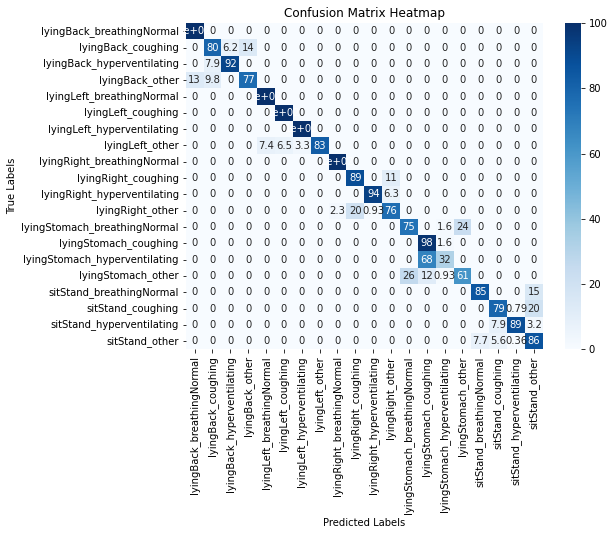

11/71 0.8260188087774295 0.7361923445033576


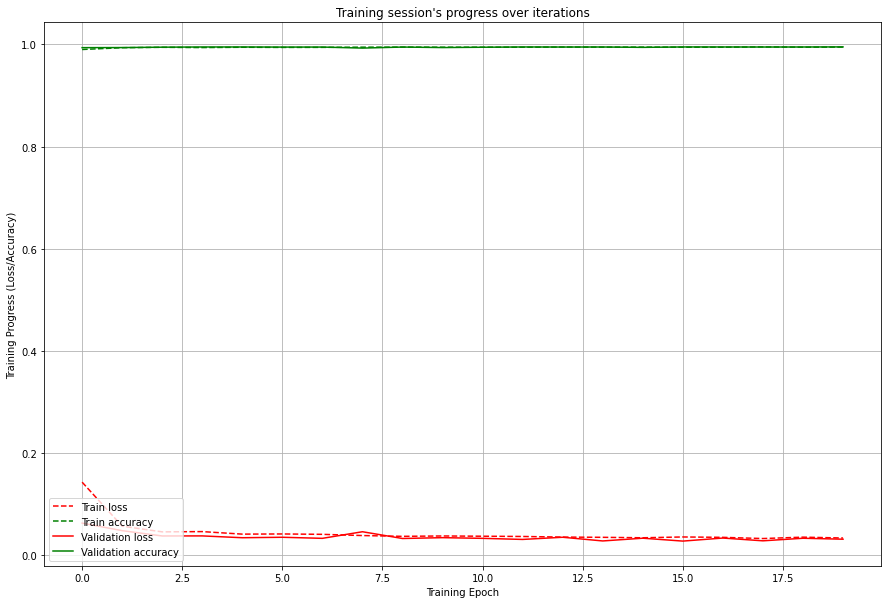

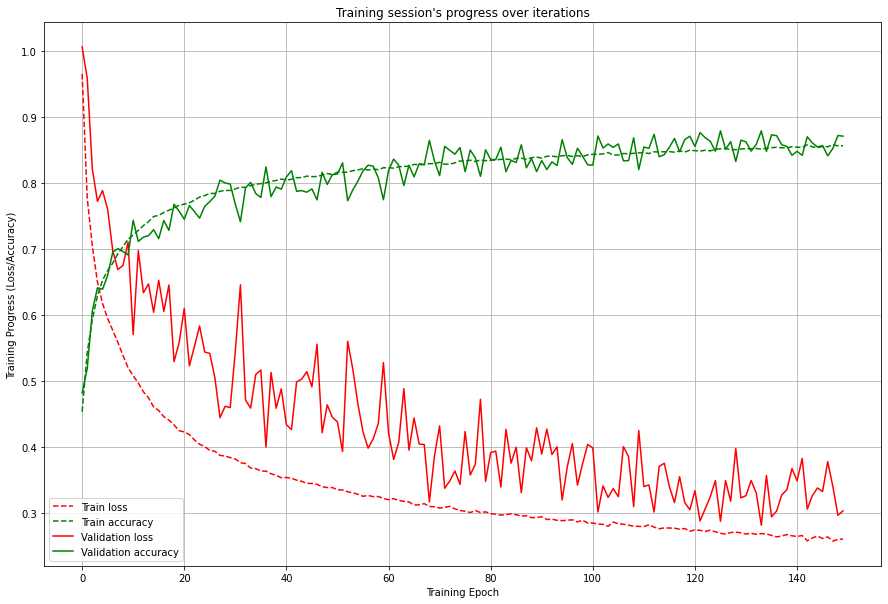

Model: "sequential_24"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_12 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_12 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_48 (Dropout)        (None, 512)               0         
                                                                 
 dense_48 (Dense)            (None, 64)                32832     
                                                                 
 dense_49 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4899 - accuracy: 0.7327 - val_loss: 0.6331 - val_accuracy: 0.7241
Epoch 14/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4745 - accuracy: 0.7407 - val_loss: 0.6714 - val_accuracy: 0.7093
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4610 - accuracy: 0.7483 - val_loss: 0.5576 - val_accuracy: 0.7535
Epoch 16/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4513 - accuracy: 0.7530 - val_loss: 0.5864 - val_accuracy: 0.7407
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4487 - accuracy: 0.7540 - val_loss: 0.6246 - val_accuracy: 0.7376
Epoch 18/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4398 - accuracy: 0.7596 - val_loss: 0.8066 - val_accuracy: 0.6934
Epoch 19/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4314 - accuracy: 0.7635 - val_loss: 

Epoch 69/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.3029 - accuracy: 0.8344 - val_loss: 0.3679 - val_accuracy: 0.8409
Epoch 70/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.3028 - accuracy: 0.8344 - val_loss: 0.3770 - val_accuracy: 0.8368
Epoch 71/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3027 - accuracy: 0.8338 - val_loss: 0.3954 - val_accuracy: 0.8328
Epoch 72/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3000 - accuracy: 0.8346 - val_loss: 0.3673 - val_accuracy: 0.8383
Epoch 73/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2997 - accuracy: 0.8351 - val_loss: 0.4004 - val_accuracy: 0.8285
Epoch 74/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2952 - accuracy: 0.8376 - val_loss: 0.3911 - val_accuracy: 0.8319
Epoch 75/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2944 - accuracy: 0.8375 - val_loss: 0

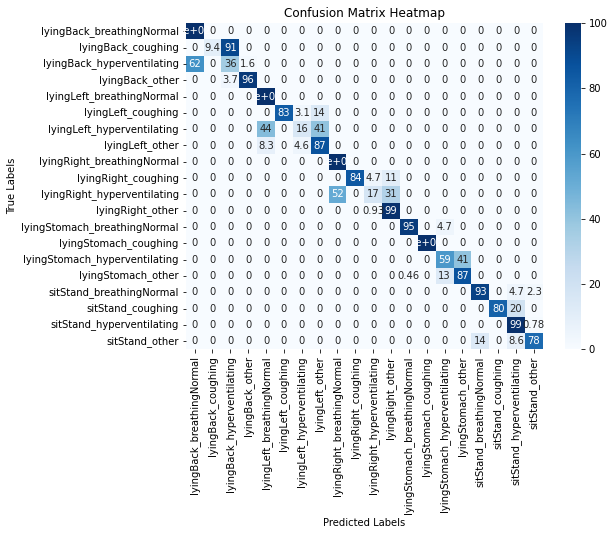

12/71 0.8125 0.7378512065793715


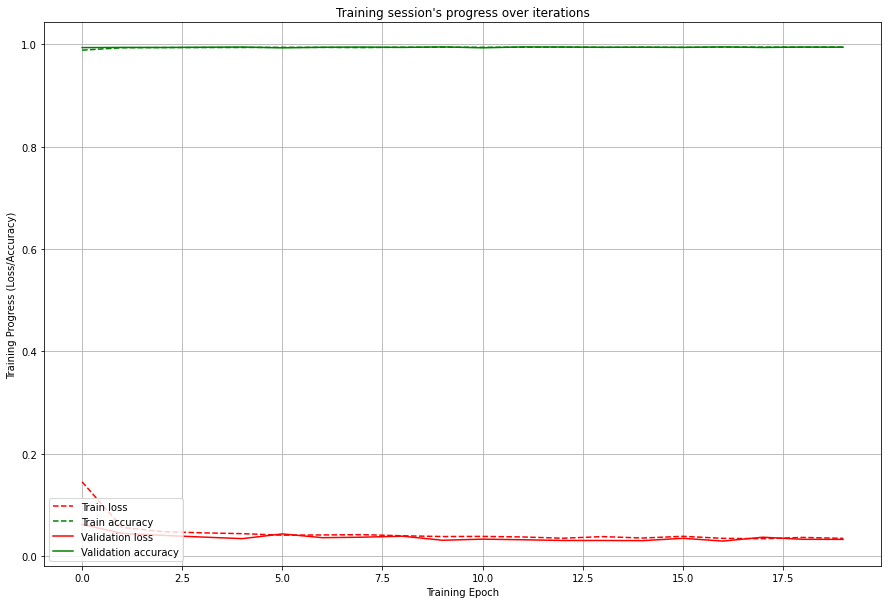

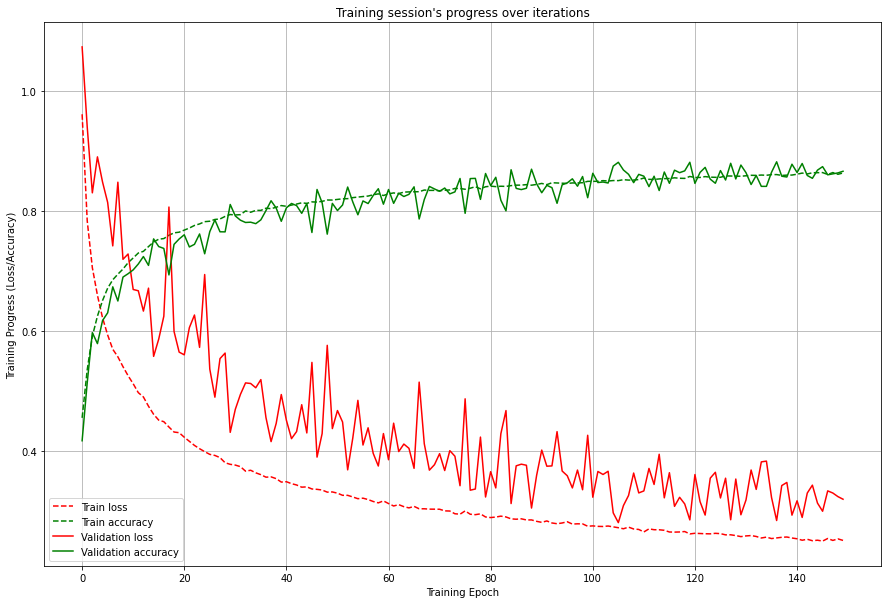

Model: "sequential_26"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_13 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_13 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_52 (Dropout)        (None, 512)               0         
                                                                 
 dense_52 (Dense)            (None, 64)                32832     
                                                                 
 dense_53 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2960 - accuracy: 0.8379 - val_loss: 0.3768 - val_accuracy: 0.8356
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2916 - accuracy: 0.8404 - val_loss: 0.4379 - val_accuracy: 0.8149
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2949 - accuracy: 0.8374 - val_loss: 0.4423 - val_accuracy: 0.8213
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2928 - accuracy: 0.8400 - val_loss: 0.3521 - val_accuracy: 0.8501
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2920 - accuracy: 0.8397 - val_loss: 0.4258 - val_accuracy: 0.8241
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2891 - accuracy: 0.8422 - val_loss: 0.3556 - val_accuracy: 0.8458
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2875 - accuracy: 0.8429 - val_loss: 0.3201 

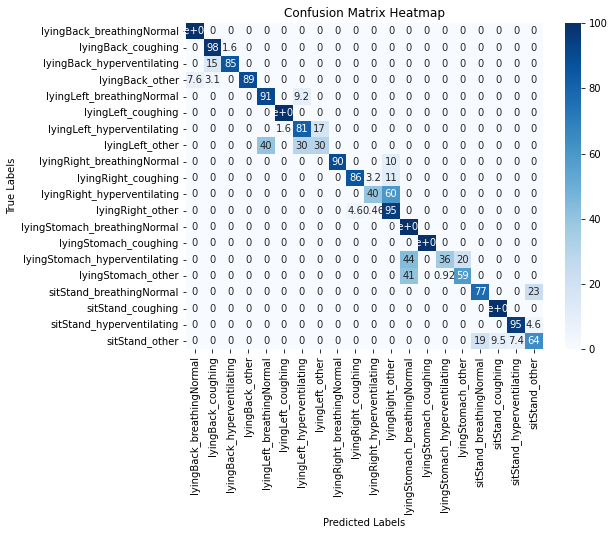

13/71 0.7533666794921123 0.7381813230243235


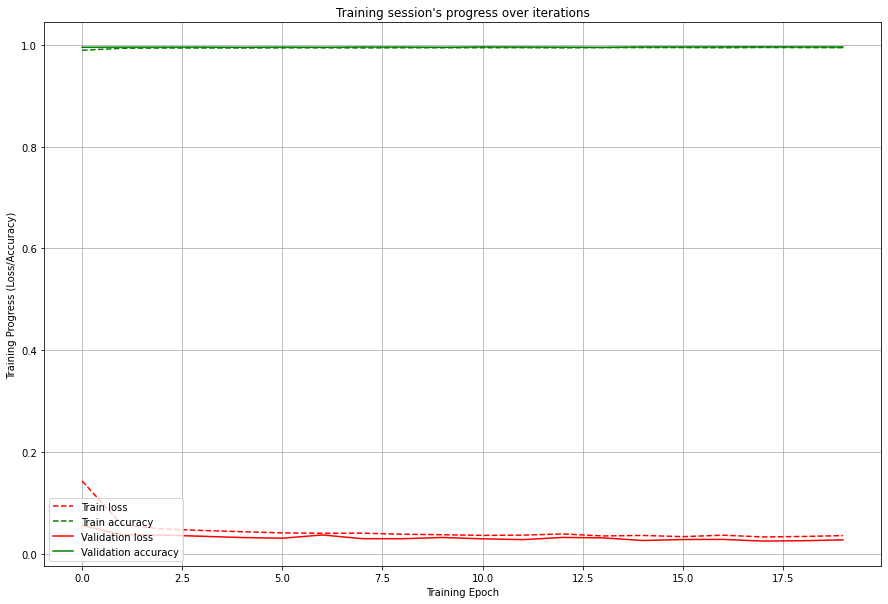

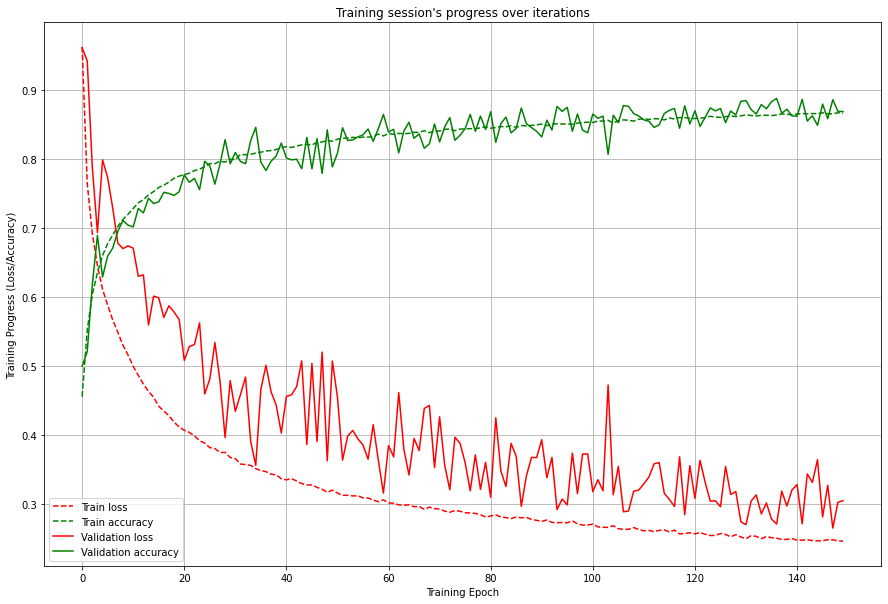

Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_14 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_14 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_56 (Dropout)        (None, 512)               0         
                                                                 
 dense_56 (Dense)            (None, 64)                32832     
                                                                 
 dense_57 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4846 - accuracy: 0.7349 - val_loss: 0.5765 - val_accuracy: 0.7427
Epoch 14/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4699 - accuracy: 0.7420 - val_loss: 0.6525 - val_accuracy: 0.7152
Epoch 15/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4567 - accuracy: 0.7502 - val_loss: 0.5957 - val_accuracy: 0.7401
Epoch 16/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4497 - accuracy: 0.7554 - val_loss: 0.5671 - val_accuracy: 0.7484
Epoch 17/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4410 - accuracy: 0.7593 - val_loss: 0.5630 - val_accuracy: 0.7556
Epoch 18/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4336 - accuracy: 0.7629 - val_loss: 0.5948 - val_accuracy: 0.7425
Epoch 19/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4283 - accuracy: 0.7660 - val_

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2630 - accuracy: 0.8563 - val_loss: 0.2805 - val_accuracy: 0.8804
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2626 - accuracy: 0.8554 - val_loss: 0.3622 - val_accuracy: 0.8480
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2612 - accuracy: 0.8577 - val_loss: 0.3947 - val_accuracy: 0.8380
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2614 - accuracy: 0.8581 - val_loss: 0.2631 - val_accuracy: 0.8891
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2609 - accuracy: 0.8569 - val_loss: 0.3494 - val_accuracy: 0.8486
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2601 - accuracy: 0.8580 - val_loss: 0.2868 - val_accuracy: 0.8788
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2595 - accuracy: 0.8585 - val_loss: 0

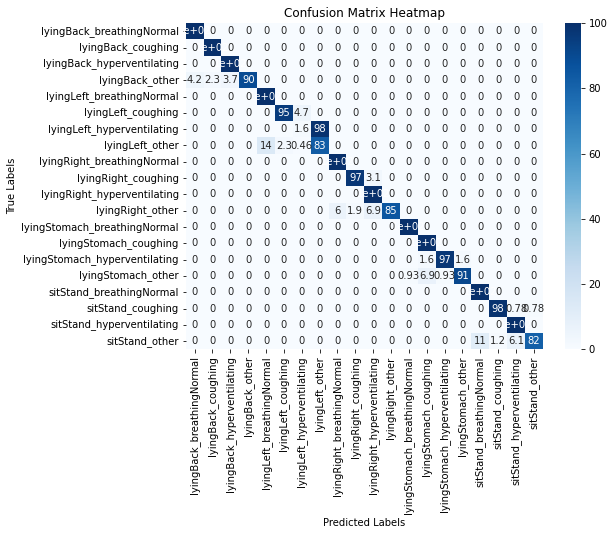

14/71 0.8893633540372671 0.7413309486704264


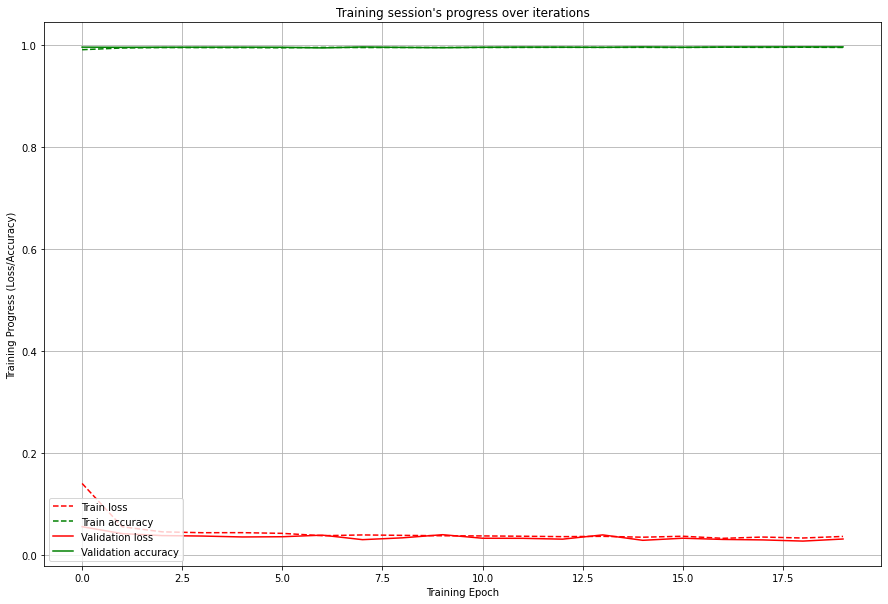

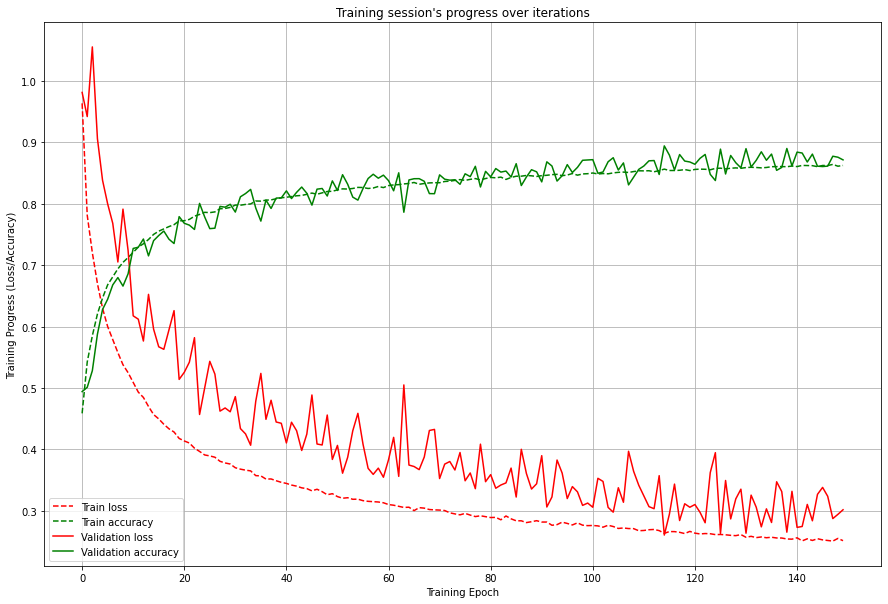

Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_15 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_15 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_60 (Dropout)        (None, 512)               0         
                                                                 
 dense_60 (Dense)            (None, 64)                32832     
                                                                 
 dense_61 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4833 - accuracy: 0.7365 - val_loss: 0.6630 - val_accuracy: 0.7086
Epoch 14/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4688 - accuracy: 0.7447 - val_loss: 0.6872 - val_accuracy: 0.7129
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4606 - accuracy: 0.7484 - val_loss: 0.5506 - val_accuracy: 0.7602
Epoch 16/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4524 - accuracy: 0.7542 - val_loss: 0.6281 - val_accuracy: 0.7269
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4437 - accuracy: 0.7573 - val_loss: 0.4990 - val_accuracy: 0.7822
Epoch 18/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4361 - accuracy: 0.7612 - val_loss: 0.5946 - val_accuracy: 0.7416
Epoch 19/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4321 - accuracy: 0.7640 - val_loss: 

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2633 - accuracy: 0.8576 - val_loss: 0.2744 - val_accuracy: 0.8876
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2620 - accuracy: 0.8556 - val_loss: 0.3299 - val_accuracy: 0.8579
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2630 - accuracy: 0.8570 - val_loss: 0.3440 - val_accuracy: 0.8558
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2617 - accuracy: 0.8581 - val_loss: 0.3443 - val_accuracy: 0.8540
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2606 - accuracy: 0.8574 - val_loss: 0.3159 - val_accuracy: 0.8665
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2605 - accuracy: 0.8565 - val_loss: 0.3673 - val_accuracy: 0.8431
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2617 - accuracy: 0.8586 - val_loss: 0

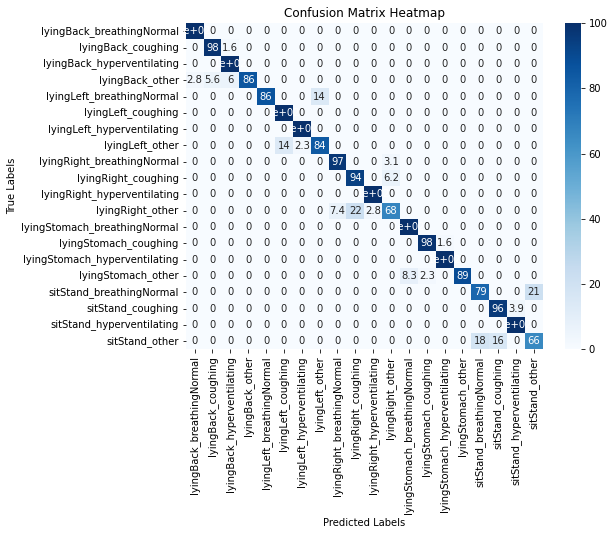

15/71 0.845108695652174 0.7434488618741355


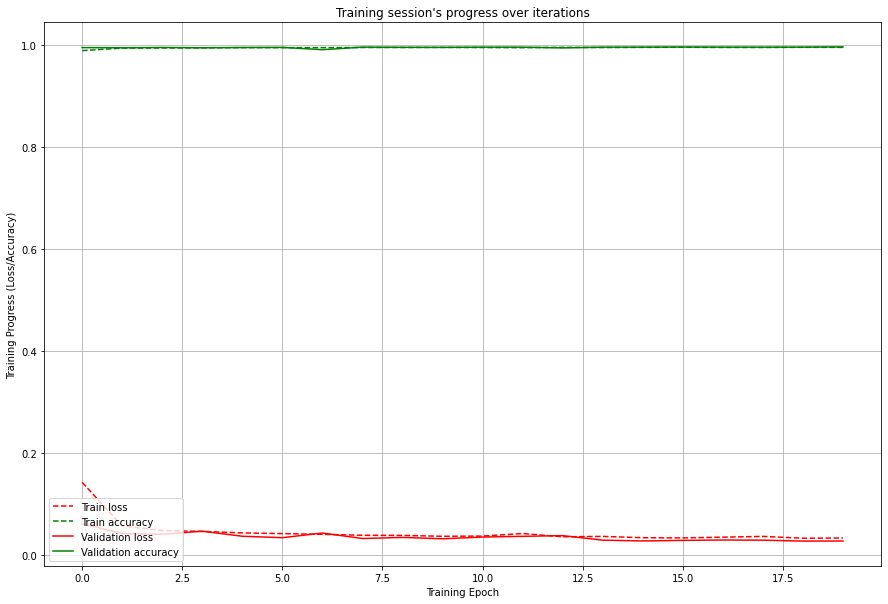

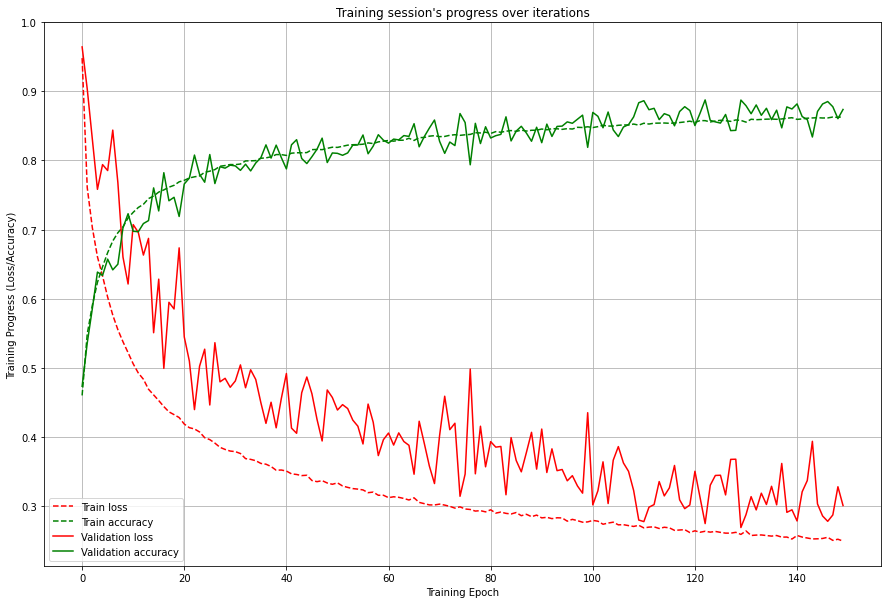

Model: "sequential_32"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_16 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_16 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_64 (Dropout)        (None, 512)               0         
                                                                 
 dense_64 (Dense)            (None, 64)                32832     
                                                                 
 dense_65 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4744 - accuracy: 0.7405 - val_loss: 0.5718 - val_accuracy: 0.7451
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4619 - accuracy: 0.7467 - val_loss: 0.6458 - val_accuracy: 0.7216
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4529 - accuracy: 0.7517 - val_loss: 0.6312 - val_accuracy: 0.7277
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4436 - accuracy: 0.7564 - val_loss: 0.5616 - val_accuracy: 0.7531
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4376 - accuracy: 0.7601 - val_loss: 0.5671 - val_accuracy: 0.7489
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4277 - accuracy: 0.7654 - val_loss: 0.5742 - val_accuracy: 0.7403
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4193 - accuracy: 0.7691 - val_loss: 

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2561 - accuracy: 0.8596 - val_loss: 0.3559 - val_accuracy: 0.8514
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2561 - accuracy: 0.8594 - val_loss: 0.3100 - val_accuracy: 0.8635
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2560 - accuracy: 0.8578 - val_loss: 0.3412 - val_accuracy: 0.8542
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2547 - accuracy: 0.8595 - val_loss: 0.2891 - val_accuracy: 0.8761
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2530 - accuracy: 0.8600 - val_loss: 0.3267 - val_accuracy: 0.8596
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2503 - accuracy: 0.8627 - val_loss: 0.3284 - val_accuracy: 0.8577
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2522 - accuracy: 0.8619 - val_loss: 0

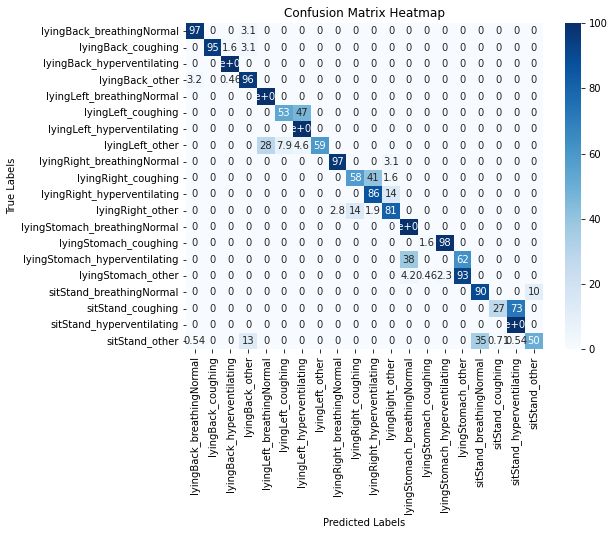

16/71 0.7142857142857143 0.7428655989223671


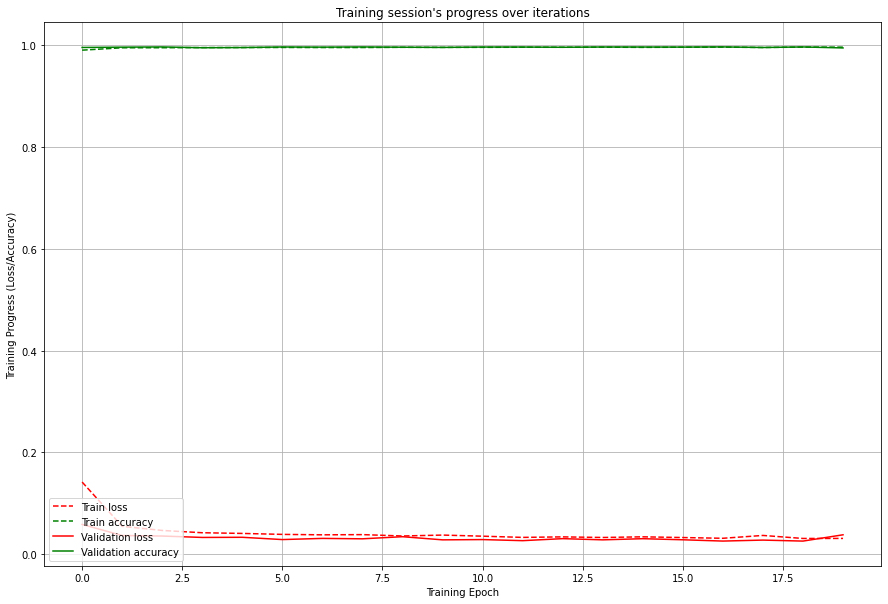

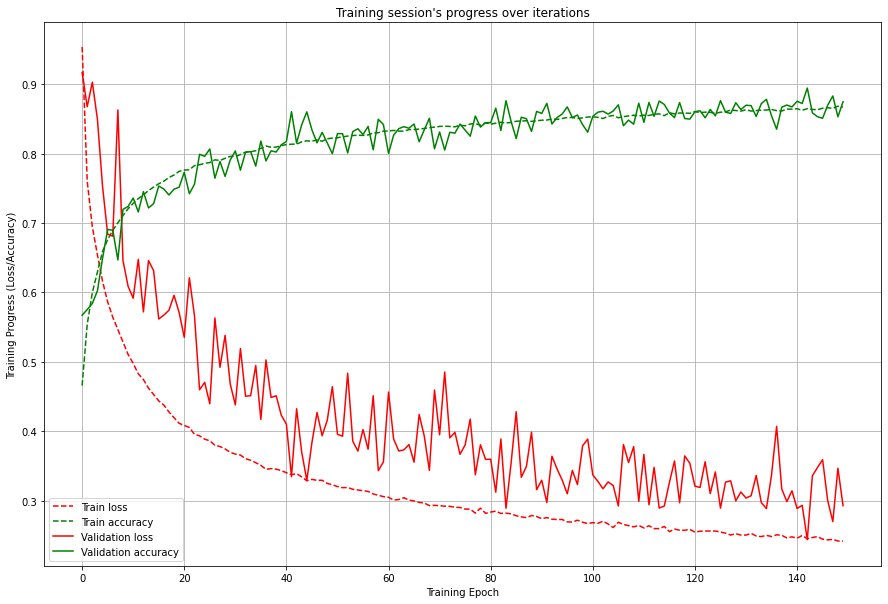

Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_17 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_17 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_68 (Dropout)        (None, 512)               0         
                                                                 
 dense_68 (Dense)            (None, 64)                32832     
                                                                 
 dense_69 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4897 - accuracy: 0.7319 - val_loss: 0.6274 - val_accuracy: 0.7186
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4750 - accuracy: 0.7420 - val_loss: 0.6227 - val_accuracy: 0.7273
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4669 - accuracy: 0.7459 - val_loss: 0.5260 - val_accuracy: 0.7746
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4610 - accuracy: 0.7481 - val_loss: 0.5705 - val_accuracy: 0.7464
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4496 - accuracy: 0.7549 - val_loss: 0.6253 - val_accuracy: 0.7261
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4428 - accuracy: 0.7587 - val_loss: 0.5986 - val_accuracy: 0.7408
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4321 - accuracy: 0.7644 - val_loss: 0

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2574 - accuracy: 0.8603 - val_loss: 0.3259 - val_accuracy: 0.8631
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2533 - accuracy: 0.8613 - val_loss: 0.2733 - val_accuracy: 0.8855
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2550 - accuracy: 0.8606 - val_loss: 0.2976 - val_accuracy: 0.8729
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2516 - accuracy: 0.8626 - val_loss: 0.3257 - val_accuracy: 0.8618
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2533 - accuracy: 0.8619 - val_loss: 0.2973 - val_accuracy: 0.8758
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2532 - accuracy: 0.8616 - val_loss: 0.3571 - val_accuracy: 0.8522
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2526 - accuracy: 0.8622 - val_loss: 0

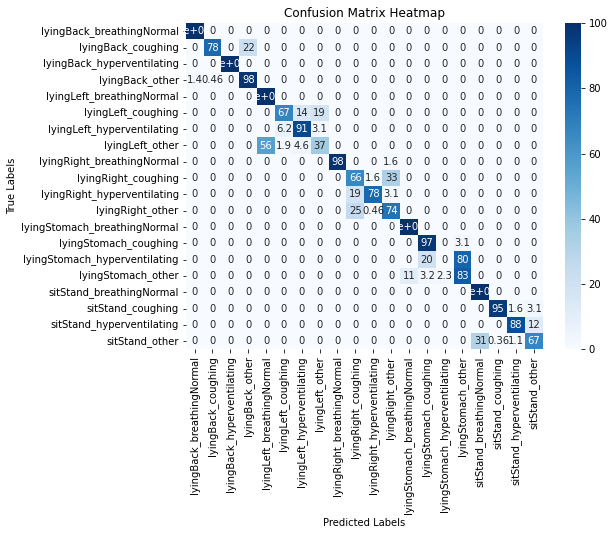

17/71 0.7744565217391305 0.7434850287815193


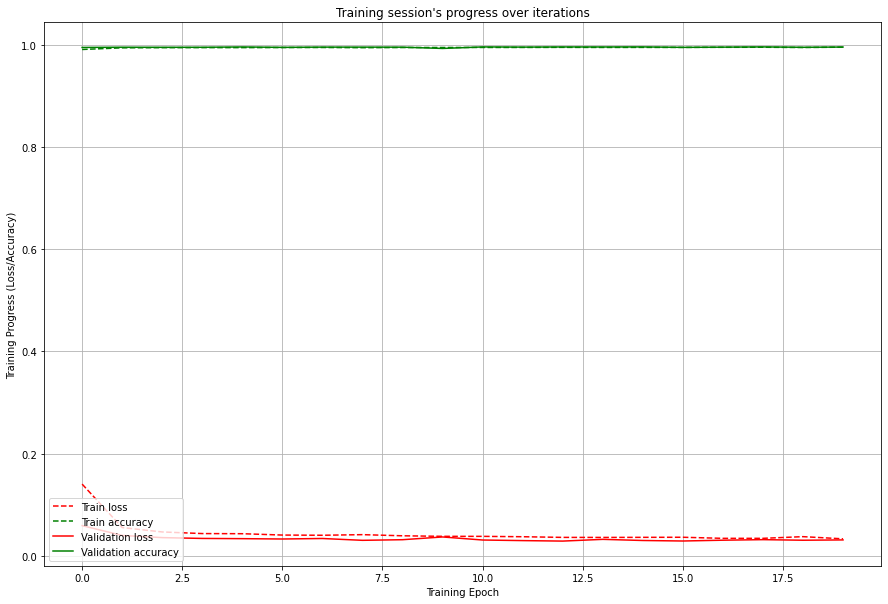

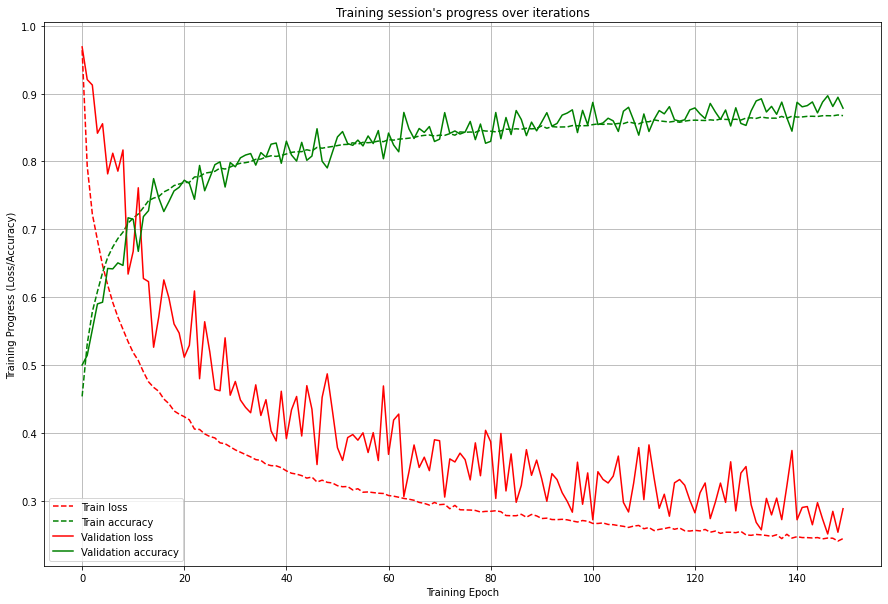

Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_18 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_18 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_72 (Dropout)        (None, 512)               0         
                                                                 
 dense_72 (Dense)            (None, 64)                32832     
                                                                 
 dense_73 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.3020 - accuracy: 0.8340 - val_loss: 0.4228 - val_accuracy: 0.8225
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3010 - accuracy: 0.8337 - val_loss: 0.3835 - val_accuracy: 0.8348
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3016 - accuracy: 0.8331 - val_loss: 0.3843 - val_accuracy: 0.8392
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2980 - accuracy: 0.8360 - val_loss: 0.3228 - val_accuracy: 0.8656
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2981 - accuracy: 0.8361 - val_loss: 0.3620 - val_accuracy: 0.8434
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2960 - accuracy: 0.8373 - val_loss: 0.3931 - val_accuracy: 0.8377
Epoch 73/150
1112/1112 [==============================] - 12s 11ms/step - loss: 0.2958 - accuracy: 0.8369 - val_loss: 0.3910 

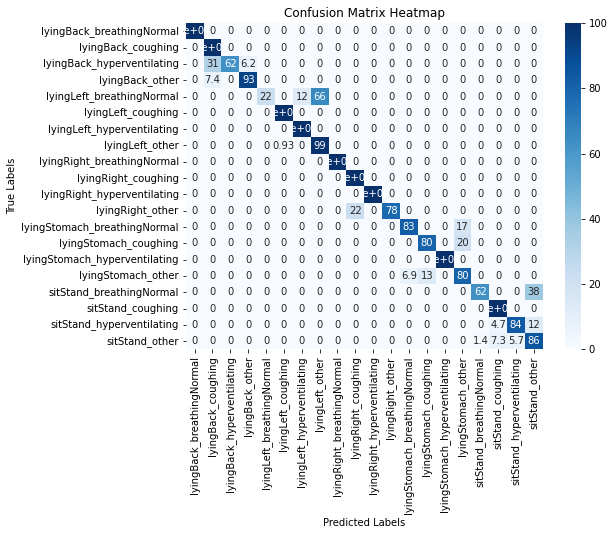

18/71 0.8614130434782609 0.7457528752179952


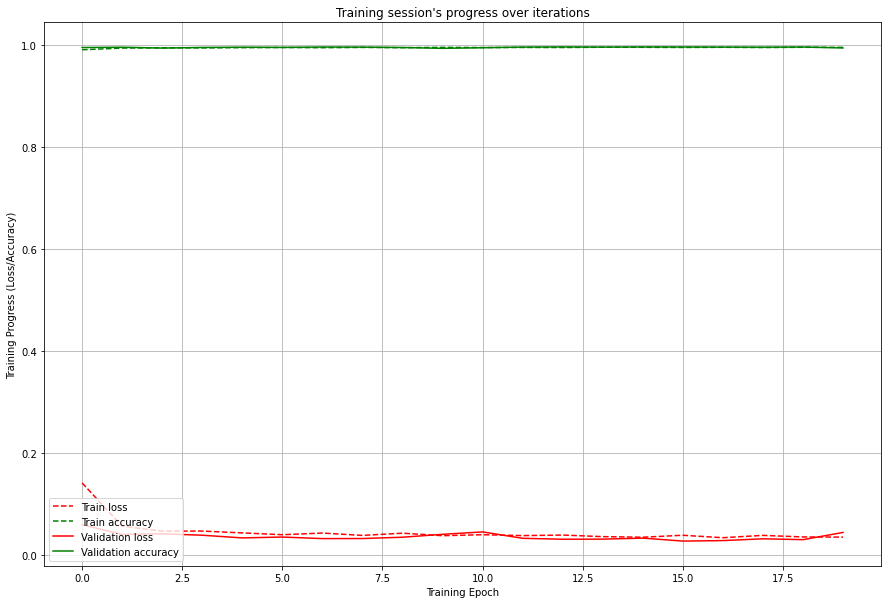

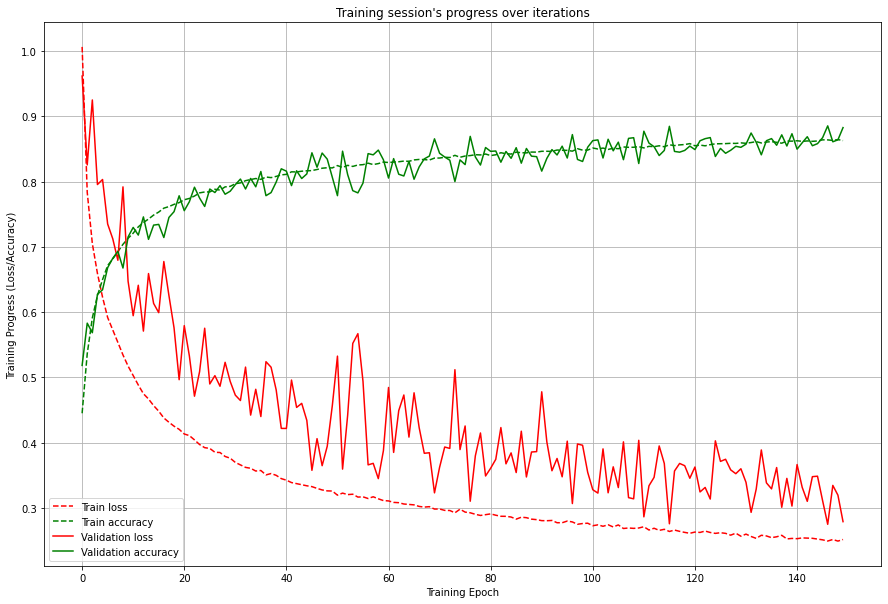

Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_19 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_19 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_76 (Dropout)        (None, 512)               0         
                                                                 
 dense_76 (Dense)            (None, 64)                32832     
                                                                 
 dense_77 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1111/1111 [==============================] - 11s 10ms/step - loss: 0.3108 - accuracy: 0.8287 - val_loss: 0.3473 - val_accuracy: 0.8496
Epoch 68/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3077 - accuracy: 0.8316 - val_loss: 0.3944 - val_accuracy: 0.8335
Epoch 69/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3072 - accuracy: 0.8314 - val_loss: 0.4444 - val_accuracy: 0.8118
Epoch 70/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3082 - accuracy: 0.8329 - val_loss: 0.4298 - val_accuracy: 0.8203
Epoch 71/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3017 - accuracy: 0.8340 - val_loss: 0.4420 - val_accuracy: 0.8152
Epoch 72/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.2997 - accuracy: 0.8368 - val_loss: 0.3808 - val_accuracy: 0.8351
Epoch 73/150
1111/1111 [==============================] - 11s 10ms/step - loss: 0.3004 - accuracy: 0.8347 - val_loss: 0.3302 

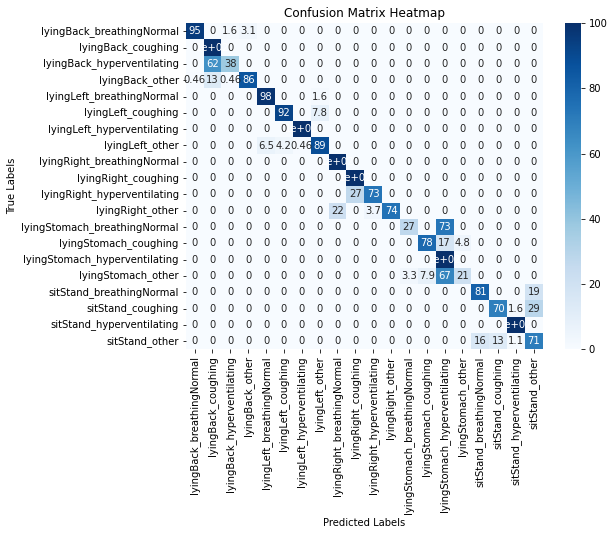

19/71 0.7536118703631394 0.7459011581452619


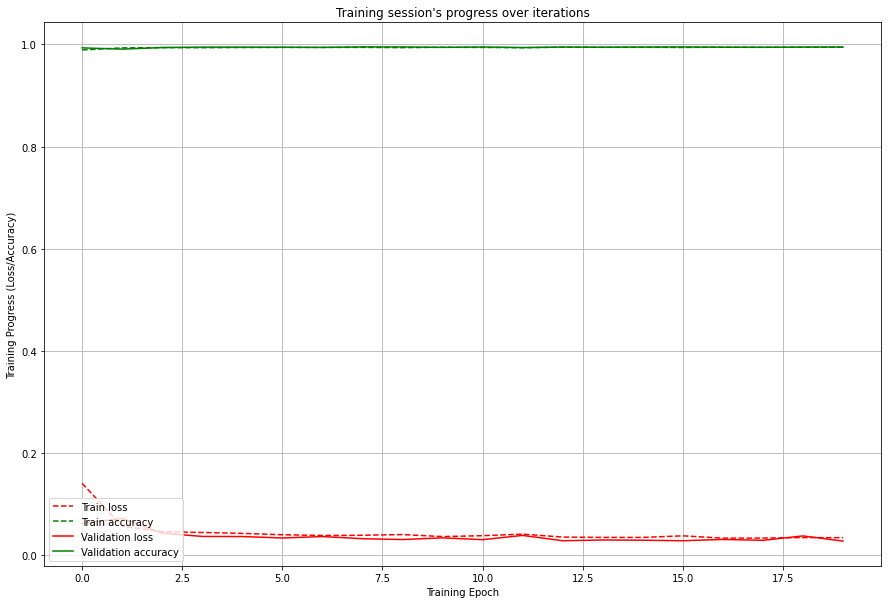

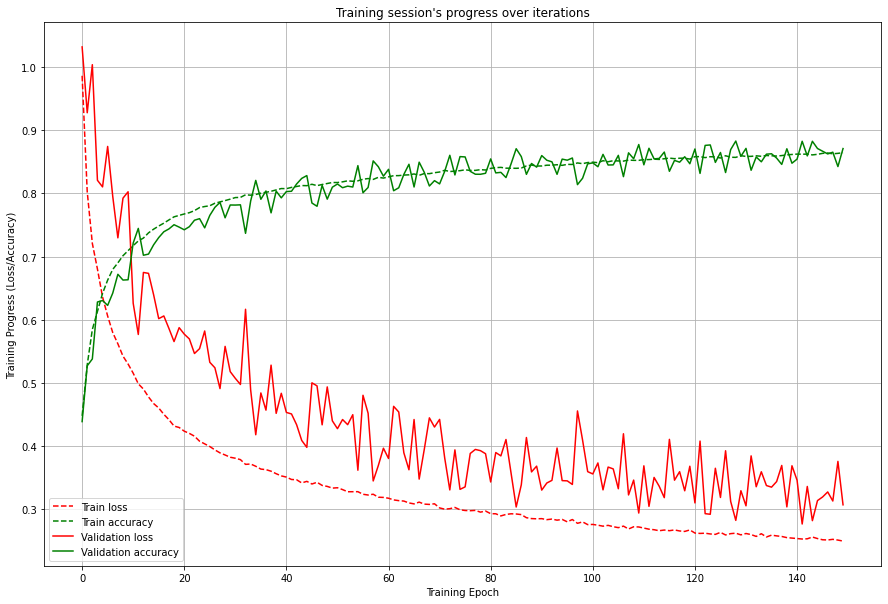

Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_20 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_20 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_80 (Dropout)        (None, 512)               0         
                                                                 
 dense_80 (Dense)            (None, 64)                32832     
                                                                 
 dense_81 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.3066 - accuracy: 0.8325 - val_loss: 0.3612 - val_accuracy: 0.8402
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3046 - accuracy: 0.8339 - val_loss: 0.4104 - val_accuracy: 0.8226
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3043 - accuracy: 0.8340 - val_loss: 0.3669 - val_accuracy: 0.8413
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3003 - accuracy: 0.8360 - val_loss: 0.4803 - val_accuracy: 0.8023
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3029 - accuracy: 0.8354 - val_loss: 0.4435 - val_accuracy: 0.8187
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3005 - accuracy: 0.8364 - val_loss: 0.3649 - val_accuracy: 0.8457
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2965 - accuracy: 0.8391 - val_loss: 0.3792 

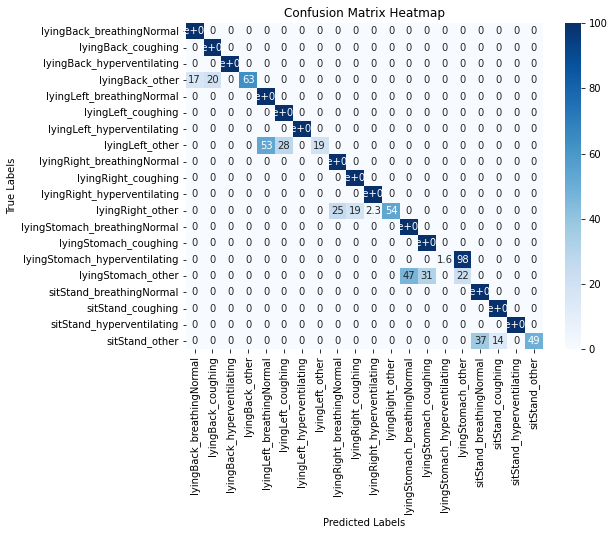

20/71 0.6629082426127527 0.7443642523020673


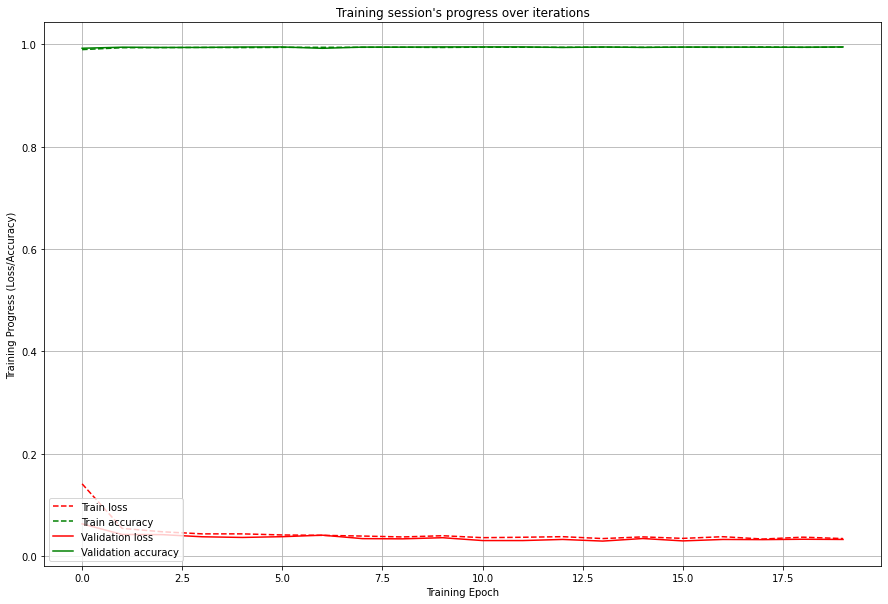

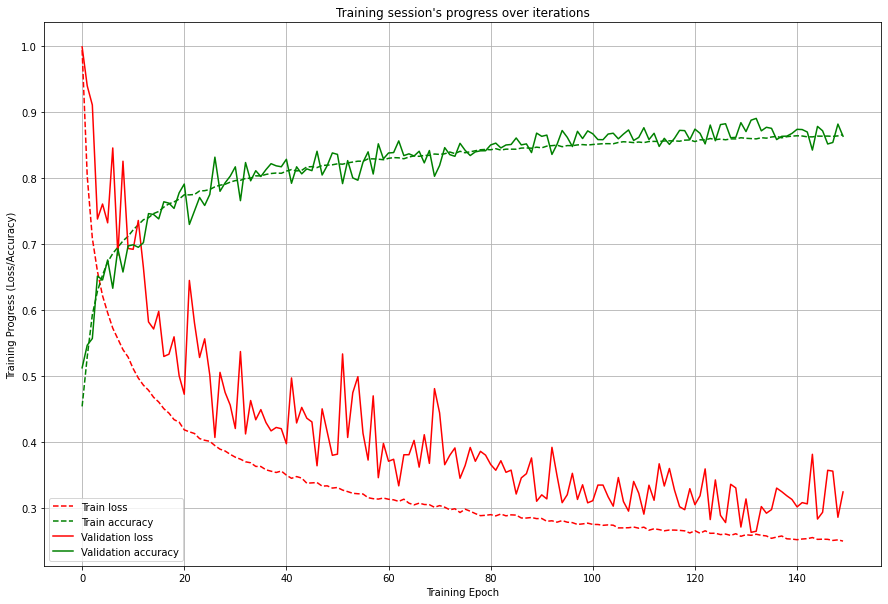

Model: "sequential_42"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_21 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_21 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_84 (Dropout)        (None, 512)               0         
                                                                 
 dense_84 (Dense)            (None, 64)                32832     
                                                                 
 dense_85 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4917 - accuracy: 0.7336 - val_loss: 0.6383 - val_accuracy: 0.7137
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4789 - accuracy: 0.7414 - val_loss: 0.6187 - val_accuracy: 0.7266
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4665 - accuracy: 0.7468 - val_loss: 0.6300 - val_accuracy: 0.7348
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4586 - accuracy: 0.7532 - val_loss: 0.6703 - val_accuracy: 0.7157
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4500 - accuracy: 0.7560 - val_loss: 0.6057 - val_accuracy: 0.7301
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4452 - accuracy: 0.7610 - val_loss: 0.6013 - val_accuracy: 0.7339
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4366 - accuracy: 0.7629 - val_loss: 0

Epoch 69/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3095 - accuracy: 0.8299 - val_loss: 0.3748 - val_accuracy: 0.8365
Epoch 70/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3055 - accuracy: 0.8326 - val_loss: 0.3800 - val_accuracy: 0.8379
Epoch 71/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3030 - accuracy: 0.8338 - val_loss: 0.4050 - val_accuracy: 0.8309
Epoch 72/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3033 - accuracy: 0.8338 - val_loss: 0.3108 - val_accuracy: 0.8745
Epoch 73/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3049 - accuracy: 0.8335 - val_loss: 0.3834 - val_accuracy: 0.8375
Epoch 74/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3045 - accuracy: 0.8326 - val_loss: 0.3060 - val_accuracy: 0.8662
Epoch 75/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.3028 - accuracy: 0.8337 - val_loss: 0

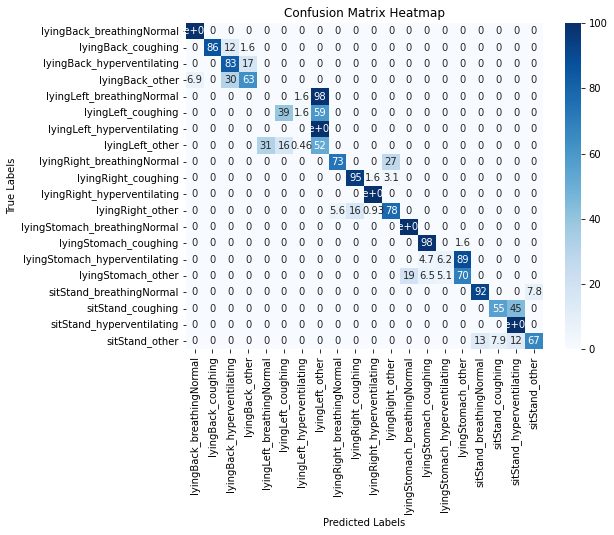

21/71 0.6828416149068323 0.7432456588948813


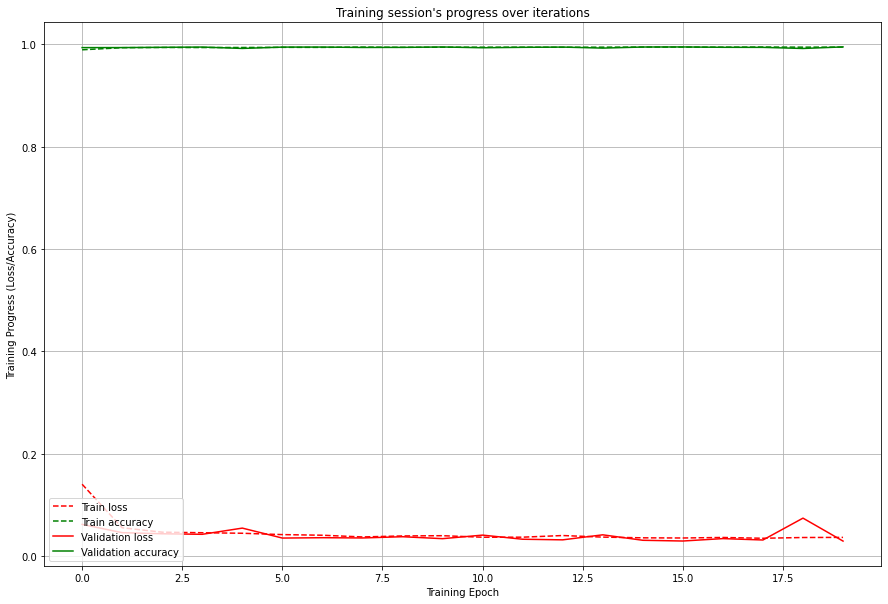

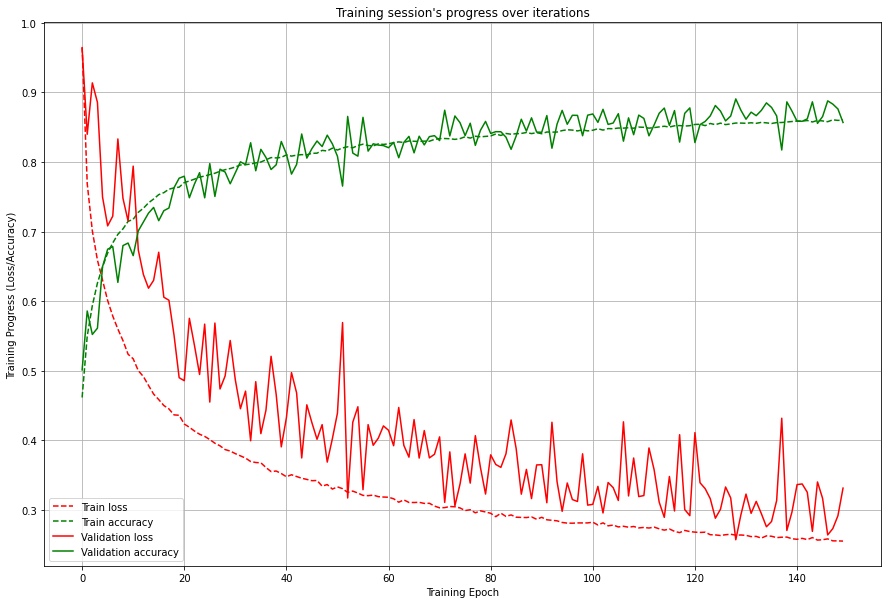

Model: "sequential_44"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_22 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_22 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_88 (Dropout)        (None, 512)               0         
                                                                 
 dense_88 (Dense)            (None, 64)                32832     
                                                                 
 dense_89 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4749 - accuracy: 0.7410 - val_loss: 0.6260 - val_accuracy: 0.7333
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4668 - accuracy: 0.7458 - val_loss: 0.5977 - val_accuracy: 0.7369
Epoch 15/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4580 - accuracy: 0.7502 - val_loss: 0.6639 - val_accuracy: 0.7162
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4484 - accuracy: 0.7551 - val_loss: 0.6263 - val_accuracy: 0.7277
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4426 - accuracy: 0.7585 - val_loss: 0.5719 - val_accuracy: 0.7503
Epoch 18/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4351 - accuracy: 0.7612 - val_loss: 0.5996 - val_accuracy: 0.7401
Epoch 19/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4255 - accuracy: 0.7673 - val_loss: 0

1112/1112 [==============================] - 10s 9ms/step - loss: 0.2618 - accuracy: 0.8569 - val_loss: 0.3267 - val_accuracy: 0.8610
Epoch 124/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2591 - accuracy: 0.8580 - val_loss: 0.2862 - val_accuracy: 0.8804
Epoch 125/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.2590 - accuracy: 0.8579 - val_loss: 0.2980 - val_accuracy: 0.8770
Epoch 126/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2582 - accuracy: 0.8585 - val_loss: 0.3340 - val_accuracy: 0.8587
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2593 - accuracy: 0.8587 - val_loss: 0.3628 - val_accuracy: 0.8461
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2591 - accuracy: 0.8581 - val_loss: 0.3735 - val_accuracy: 0.8464
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2562 - accuracy: 0.8583 - val_loss: 0.296

/tmp/ipykernel_3187136/842456319.py:33: RuntimeWarning: invalid value encountered in divide
  cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100


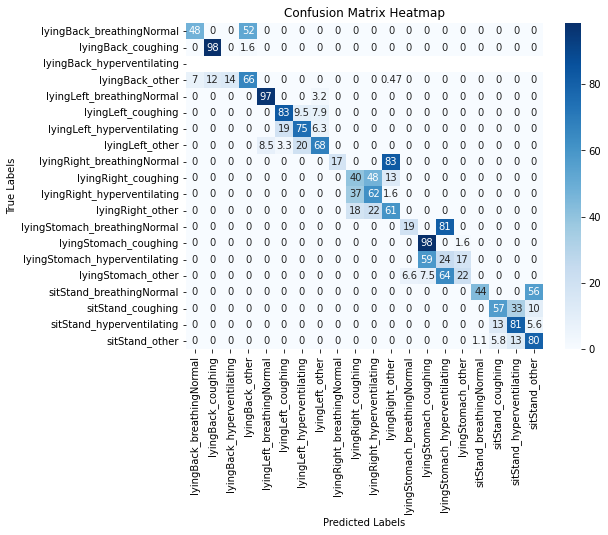

22/71 0.6246464646464647 0.7411278161404454


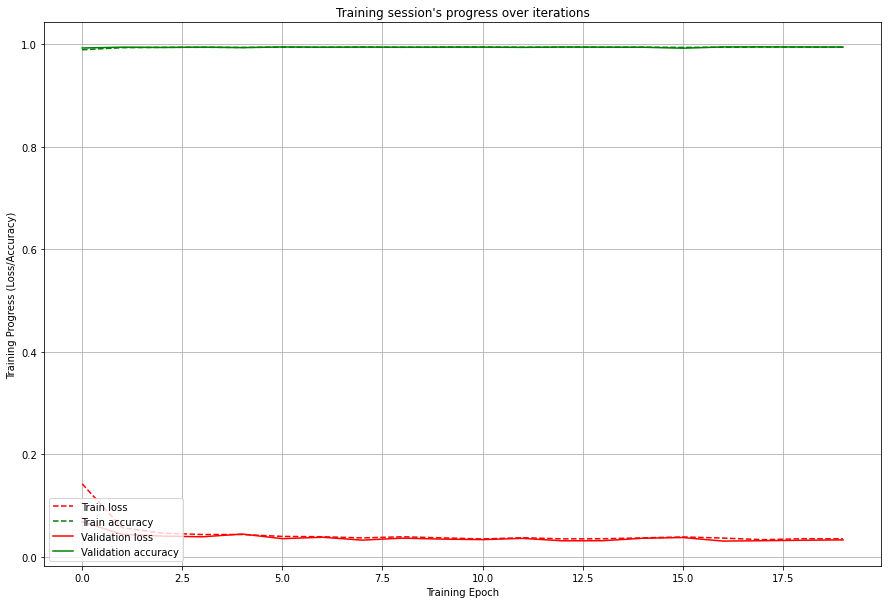

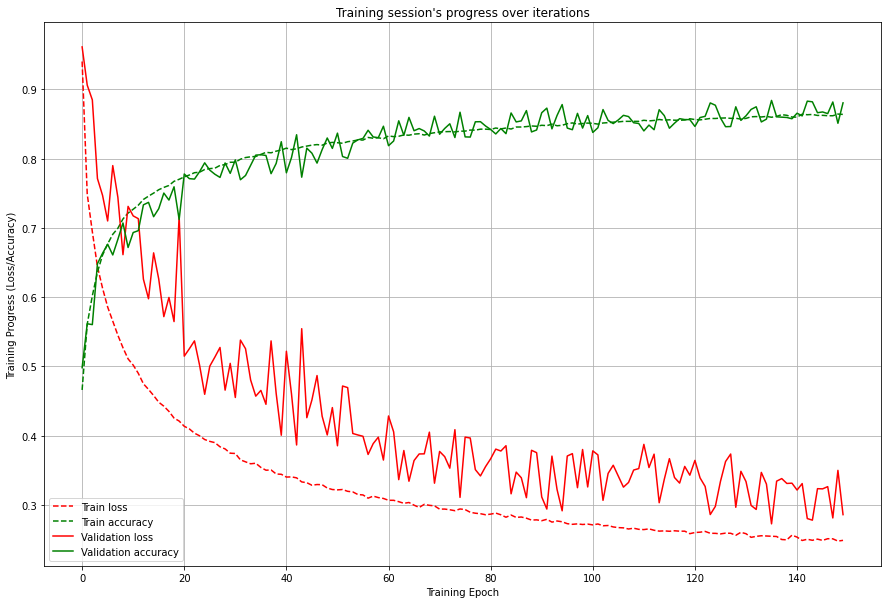

Model: "sequential_46"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_23 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_23 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_92 (Dropout)        (None, 512)               0         
                                                                 
 dense_92 (Dense)            (None, 64)                32832     
                                                                 
 dense_93 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.3072 - accuracy: 0.8308 - val_loss: 0.3506 - val_accuracy: 0.8468
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3069 - accuracy: 0.8301 - val_loss: 0.3929 - val_accuracy: 0.8267
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3035 - accuracy: 0.8318 - val_loss: 0.4051 - val_accuracy: 0.8253
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3068 - accuracy: 0.8311 - val_loss: 0.4260 - val_accuracy: 0.8158
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3038 - accuracy: 0.8323 - val_loss: 0.3684 - val_accuracy: 0.8382
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3022 - accuracy: 0.8329 - val_loss: 0.3929 - val_accuracy: 0.8274
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2998 - accuracy: 0.8345 - val_loss: 0.4362 

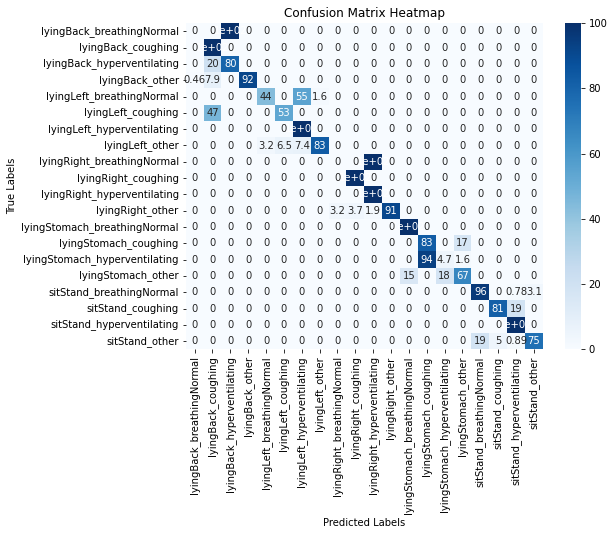

23/71 0.7705745341614907 0.7416444252285339


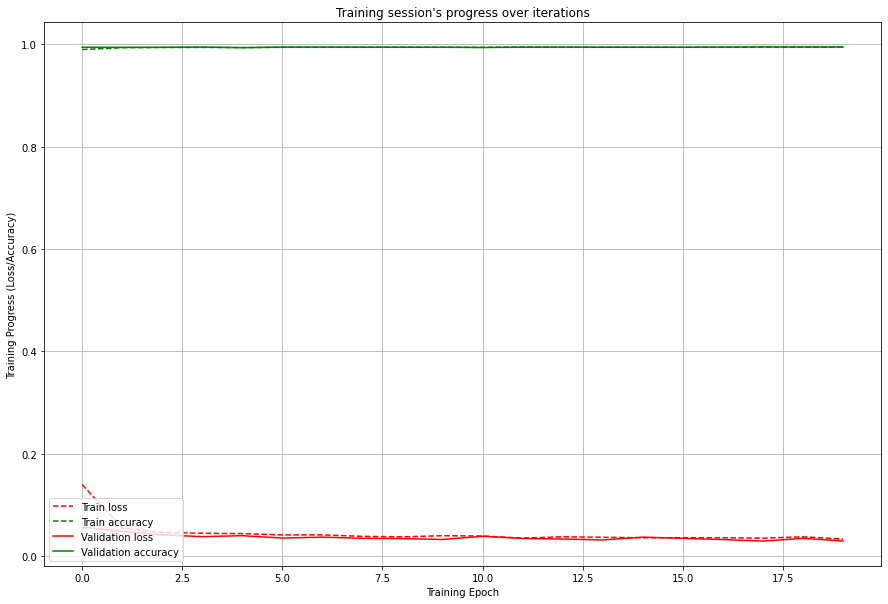

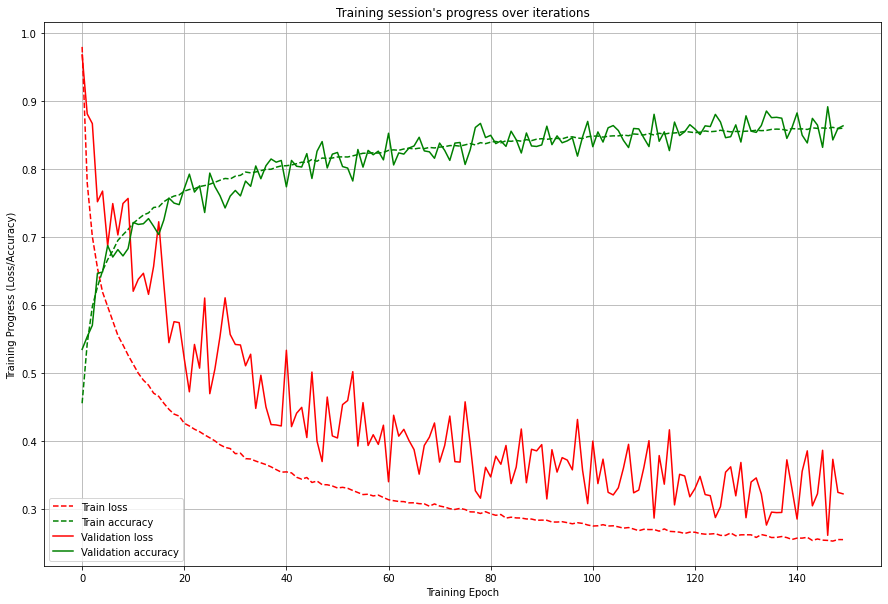

Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_24 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_24 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_96 (Dropout)        (None, 512)               0         
                                                                 
 dense_96 (Dense)            (None, 64)                32832     
                                                                 
 dense_97 (Dense)            (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2964 - accuracy: 0.8372 - val_loss: 0.3561 - val_accuracy: 0.8501
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2956 - accuracy: 0.8385 - val_loss: 0.4469 - val_accuracy: 0.8134
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2927 - accuracy: 0.8389 - val_loss: 0.3849 - val_accuracy: 0.8374
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2905 - accuracy: 0.8402 - val_loss: 0.3885 - val_accuracy: 0.8350
Epoch 71/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2907 - accuracy: 0.8394 - val_loss: 0.3628 - val_accuracy: 0.8418
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2912 - accuracy: 0.8402 - val_loss: 0.3929 - val_accuracy: 0.8358
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2898 - accuracy: 0.8407 - val_loss: 0.3390 -

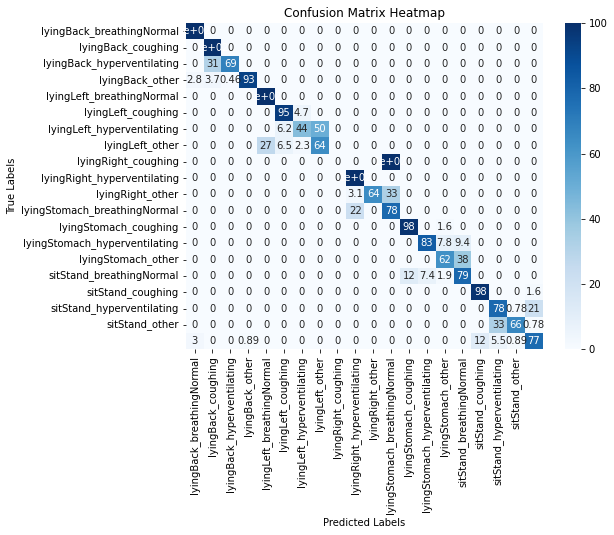

24/71 0.7795031055900621 0.7422971610968361


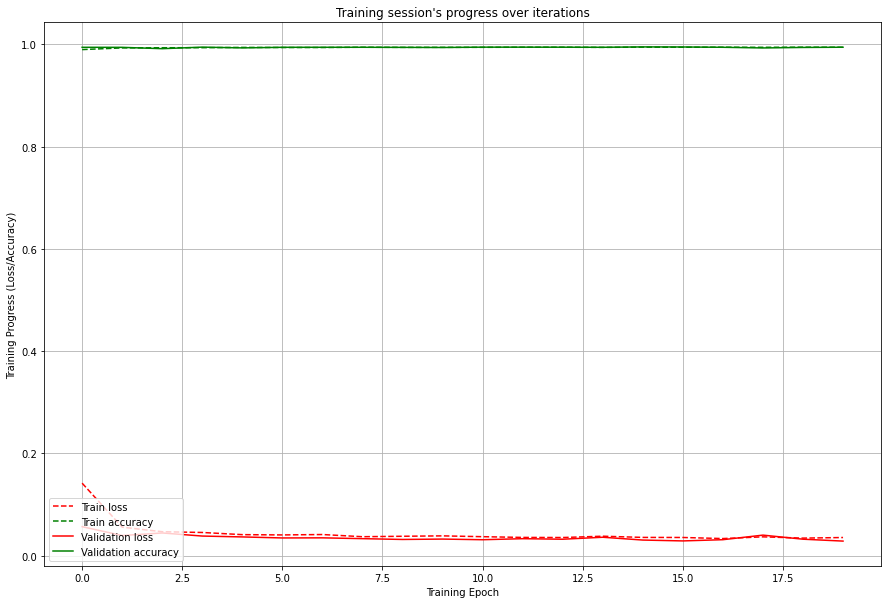

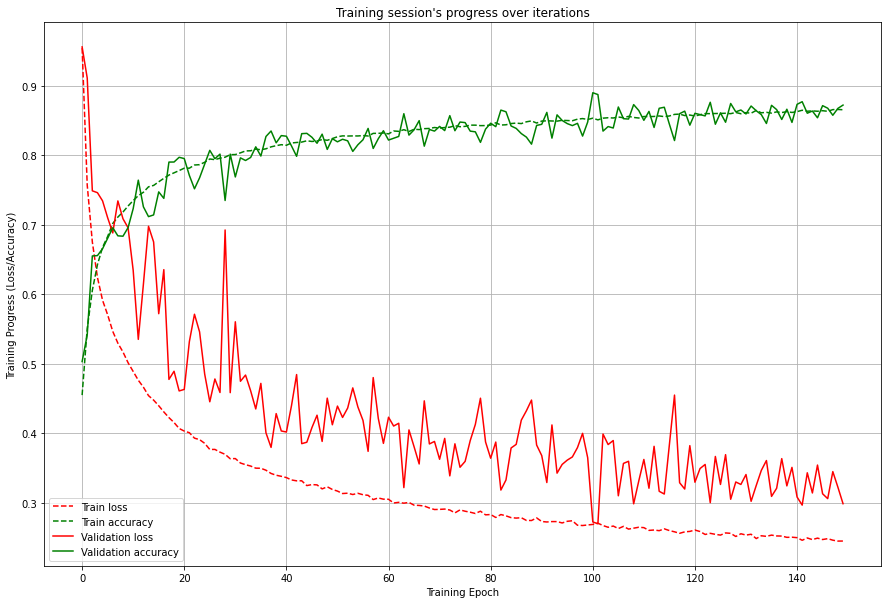

Model: "sequential_50"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_25 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_25 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_100 (Dropout)       (None, 512)               0         
                                                                 
 dense_100 (Dense)           (None, 64)                32832     
                                                                 
 dense_101 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2974 - accuracy: 0.8347 - val_loss: 0.3836 - val_accuracy: 0.8330
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2924 - accuracy: 0.8386 - val_loss: 0.3400 - val_accuracy: 0.8535
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2910 - accuracy: 0.8393 - val_loss: 0.3667 - val_accuracy: 0.8377
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2922 - accuracy: 0.8384 - val_loss: 0.3286 - val_accuracy: 0.8581
Epoch 71/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2908 - accuracy: 0.8392 - val_loss: 0.3932 - val_accuracy: 0.8283
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2904 - accuracy: 0.8390 - val_loss: 0.3848 - val_accuracy: 0.8318
Epoch 73/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2889 - accuracy: 0.8411 - val_loss: 0.3510 -

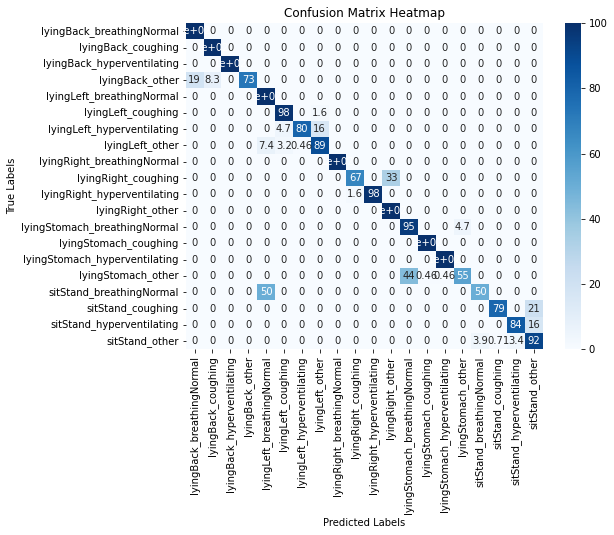

25/71 0.8540372670807453 0.7441910611982583


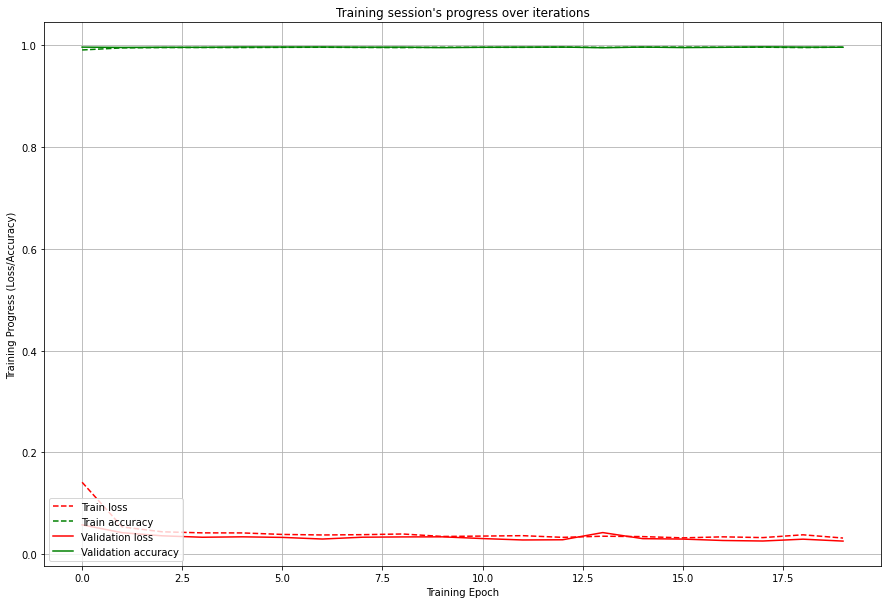

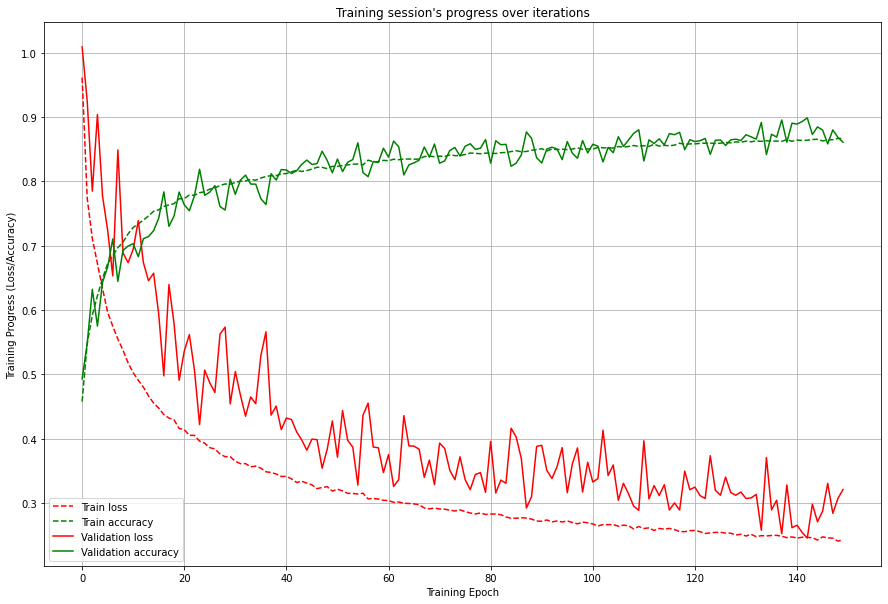

Model: "sequential_52"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_26 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_26 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_104 (Dropout)       (None, 512)               0         
                                                                 
 dense_104 (Dense)           (None, 64)                32832     
                                                                 
 dense_105 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4710 - accuracy: 0.7420 - val_loss: 0.6365 - val_accuracy: 0.7263
Epoch 14/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4623 - accuracy: 0.7476 - val_loss: 0.6315 - val_accuracy: 0.7330
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4511 - accuracy: 0.7539 - val_loss: 0.6590 - val_accuracy: 0.7186
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4417 - accuracy: 0.7590 - val_loss: 0.5255 - val_accuracy: 0.7625
Epoch 17/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4353 - accuracy: 0.7613 - val_loss: 0.5945 - val_accuracy: 0.7477
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4237 - accuracy: 0.7682 - val_loss: 0.6033 - val_accuracy: 0.7439
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4193 - accuracy: 0.7709 - val_loss: 0

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2581 - accuracy: 0.8585 - val_loss: 0.3036 - val_accuracy: 0.8732
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2581 - accuracy: 0.8582 - val_loss: 0.2970 - val_accuracy: 0.8738
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2559 - accuracy: 0.8593 - val_loss: 0.3419 - val_accuracy: 0.8542
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2566 - accuracy: 0.8601 - val_loss: 0.3159 - val_accuracy: 0.8683
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2600 - accuracy: 0.8579 - val_loss: 0.2759 - val_accuracy: 0.8842
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2588 - accuracy: 0.8601 - val_loss: 0.3124 - val_accuracy: 0.8669
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2553 - accuracy: 0.8605 - val_loss: 0

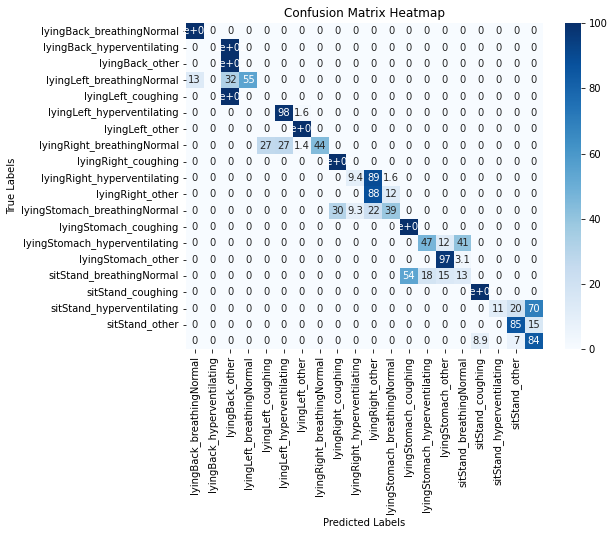

26/71 0.6152950310559007 0.742042794029219


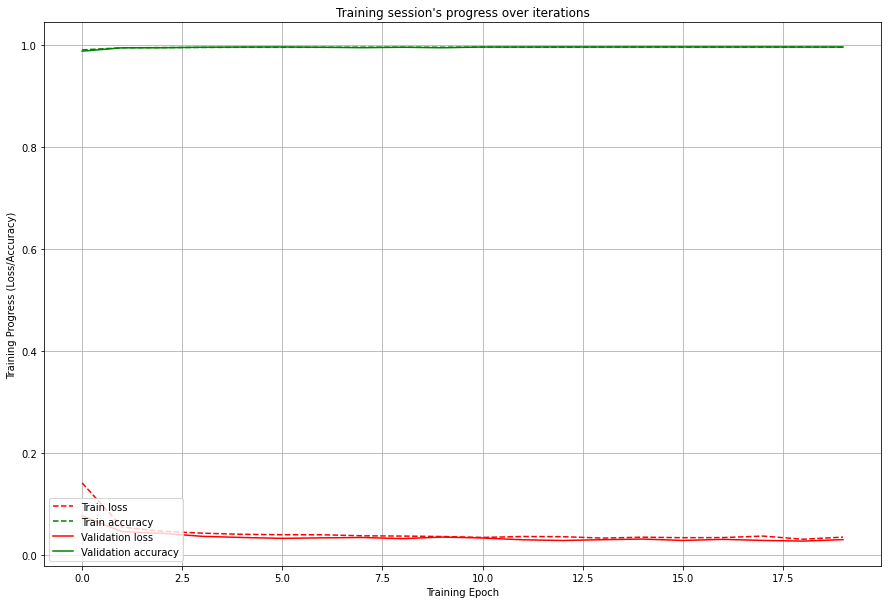

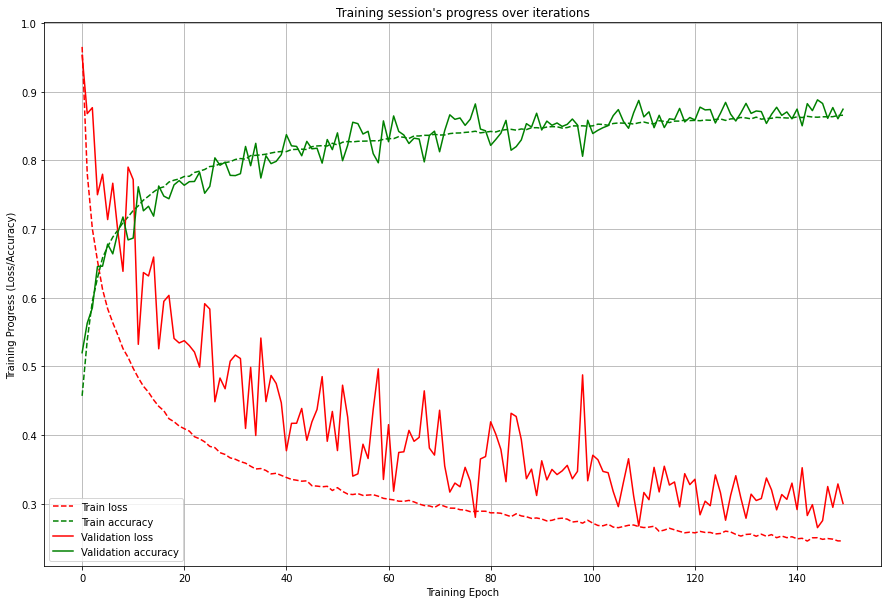

Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_27 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_27 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_108 (Dropout)       (None, 512)               0         
                                                                 
 dense_108 (Dense)           (None, 64)                32832     
                                                                 
 dense_109 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4772 - accuracy: 0.7408 - val_loss: 0.6626 - val_accuracy: 0.7174
Epoch 14/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.4655 - accuracy: 0.7462 - val_loss: 0.6012 - val_accuracy: 0.7405
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4562 - accuracy: 0.7495 - val_loss: 0.5601 - val_accuracy: 0.7510
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4490 - accuracy: 0.7546 - val_loss: 0.7072 - val_accuracy: 0.7119
Epoch 17/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4386 - accuracy: 0.7603 - val_loss: 0.5762 - val_accuracy: 0.7481
Epoch 18/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4304 - accuracy: 0.7660 - val_loss: 0.5700 - val_accuracy: 0.7487
Epoch 19/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4261 - accuracy: 0.7675 - val_loss:

1112/1112 [==============================] - 11s 10ms/step - loss: 0.2552 - accuracy: 0.8607 - val_loss: 0.3338 - val_accuracy: 0.8586
Epoch 124/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2576 - accuracy: 0.8591 - val_loss: 0.2634 - val_accuracy: 0.8884
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2545 - accuracy: 0.8604 - val_loss: 0.3690 - val_accuracy: 0.8412
Epoch 126/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2546 - accuracy: 0.8609 - val_loss: 0.2802 - val_accuracy: 0.8826
Epoch 127/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2559 - accuracy: 0.8603 - val_loss: 0.2922 - val_accuracy: 0.8753
Epoch 128/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2525 - accuracy: 0.8621 - val_loss: 0.3519 - val_accuracy: 0.8523
Epoch 129/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2529 - accuracy: 0.8617 - val_loss: 0

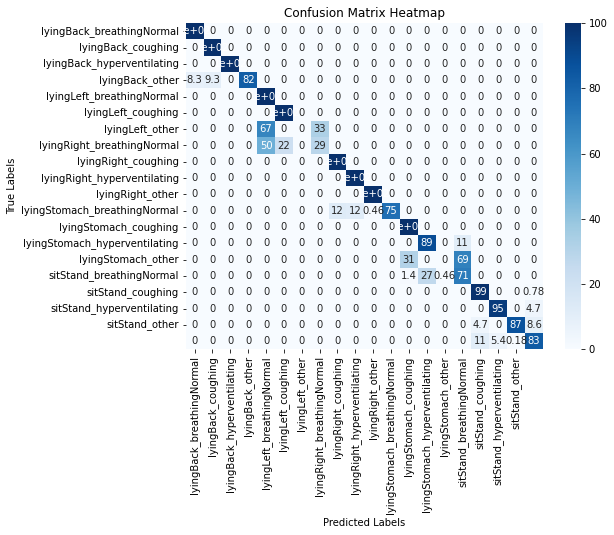

27/71 0.7829126213592233 0.7427127911985634


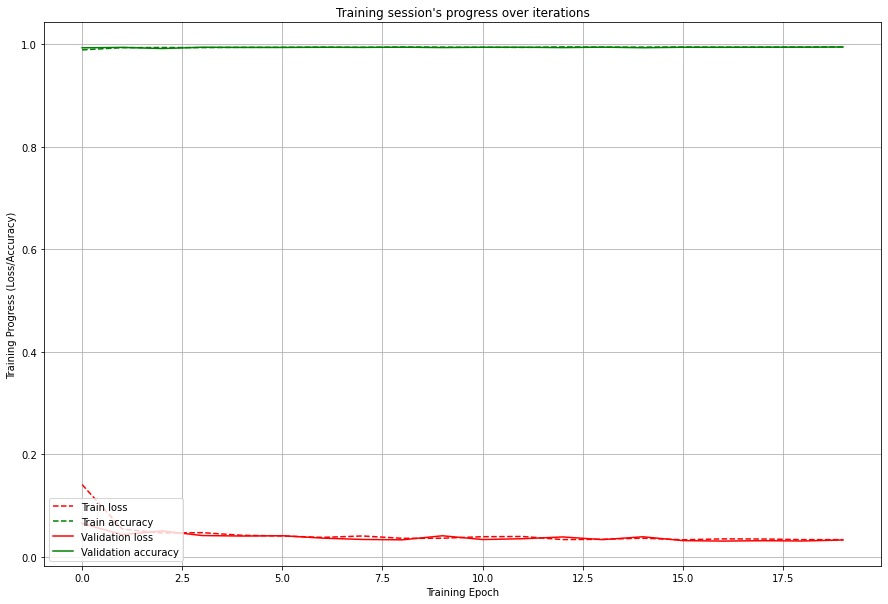

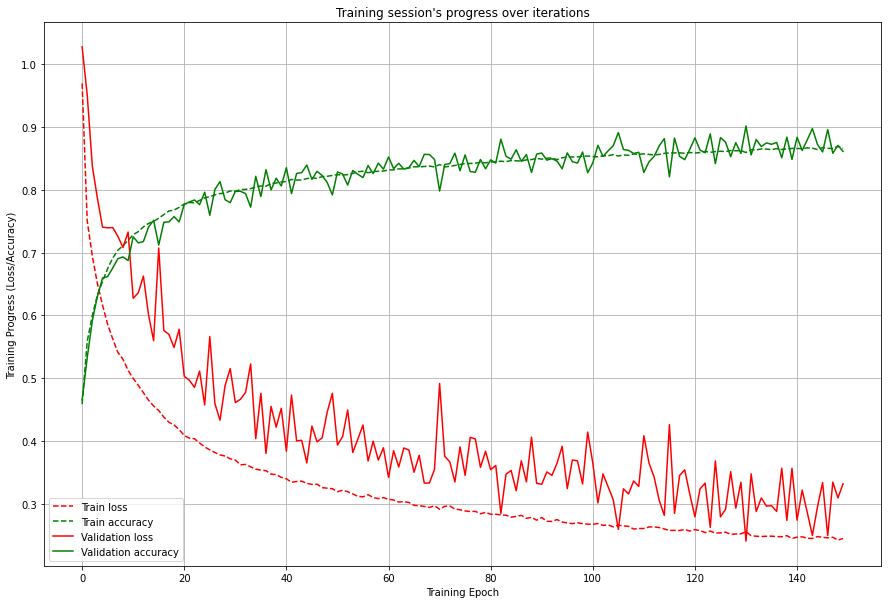

Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_28 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_28 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_112 (Dropout)       (None, 512)               0         
                                                                 
 dense_112 (Dense)           (None, 64)                32832     
                                                                 
 dense_113 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

Epoch 13/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4887 - accuracy: 0.7338 - val_loss: 0.5914 - val_accuracy: 0.7365
Epoch 14/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4756 - accuracy: 0.7394 - val_loss: 0.5954 - val_accuracy: 0.7388
Epoch 15/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4655 - accuracy: 0.7458 - val_loss: 0.6069 - val_accuracy: 0.7310
Epoch 16/150
1112/1112 [==============================] - 10s 9ms/step - loss: 0.4588 - accuracy: 0.7502 - val_loss: 0.6344 - val_accuracy: 0.7335
Epoch 17/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4507 - accuracy: 0.7536 - val_loss: 0.5937 - val_accuracy: 0.7441
Epoch 18/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4396 - accuracy: 0.7594 - val_loss: 0.6151 - val_accuracy: 0.7415
Epoch 19/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.4335 - accuracy: 0.7623 - val_lo

1112/1112 [==============================] - 11s 9ms/step - loss: 0.2568 - accuracy: 0.8592 - val_loss: 0.3281 - val_accuracy: 0.8610
Epoch 124/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2557 - accuracy: 0.8605 - val_loss: 0.2903 - val_accuracy: 0.8755
Epoch 125/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.2531 - accuracy: 0.8610 - val_loss: 0.3838 - val_accuracy: 0.8427
Epoch 126/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2548 - accuracy: 0.8593 - val_loss: 0.3435 - val_accuracy: 0.8587
Epoch 127/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2546 - accuracy: 0.8608 - val_loss: 0.3138 - val_accuracy: 0.8663
Epoch 128/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2518 - accuracy: 0.8615 - val_loss: 0.2945 - val_accuracy: 0.8760
Epoch 129/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.2518 - accuracy: 0.8624 - val_loss: 0.2883 

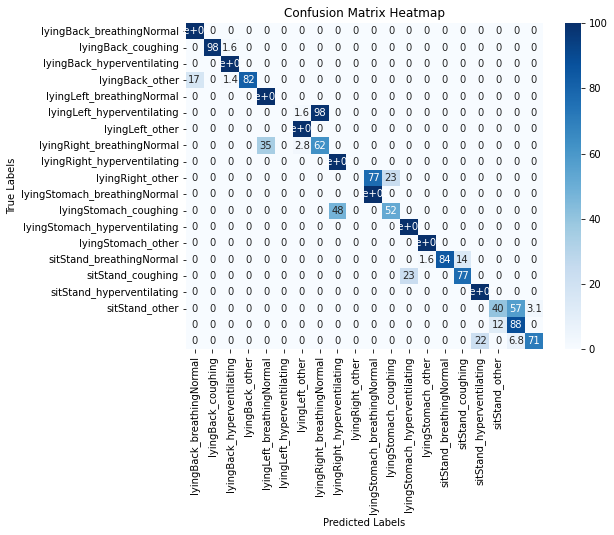

28/71 0.7418478260869565 0.7426988401483761


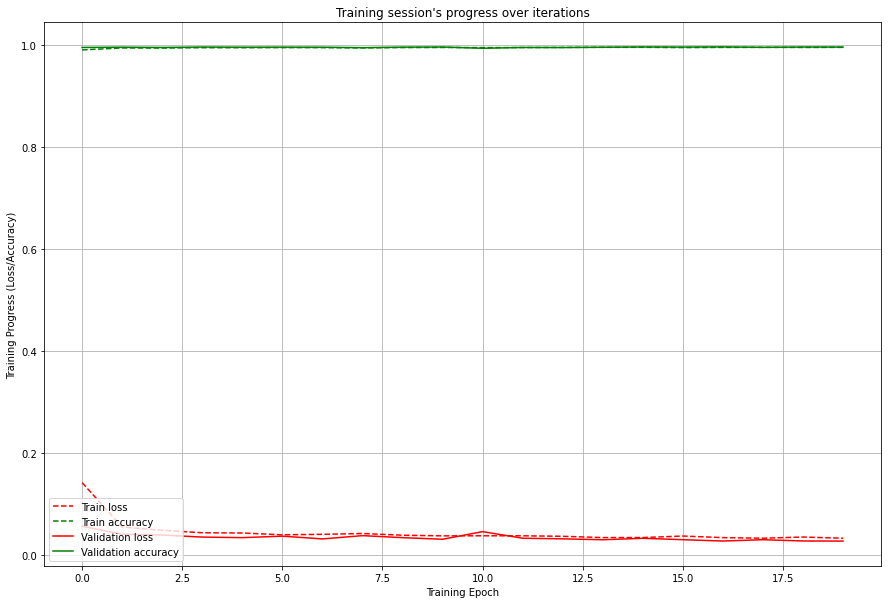

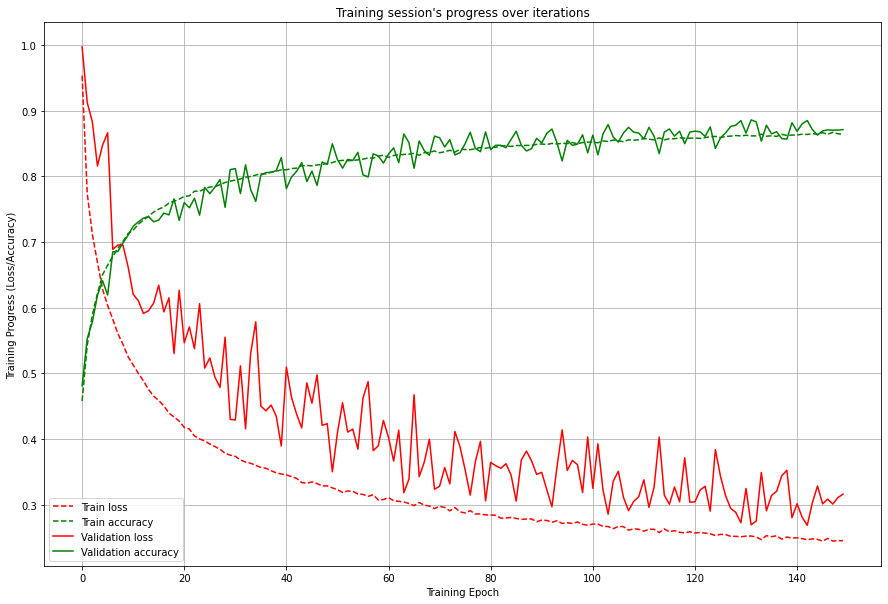

Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_29 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_29 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_116 (Dropout)       (None, 512)               0         
                                                                 
 dense_116 (Dense)           (None, 64)                32832     
                                                                 
 dense_117 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

1112/1112 [==============================] - 11s 10ms/step - loss: 0.3168 - accuracy: 0.8249 - val_loss: 0.3961 - val_accuracy: 0.8277
Epoch 68/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3173 - accuracy: 0.8260 - val_loss: 0.4581 - val_accuracy: 0.8027
Epoch 69/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3130 - accuracy: 0.8271 - val_loss: 0.4025 - val_accuracy: 0.8253
Epoch 70/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3112 - accuracy: 0.8300 - val_loss: 0.3762 - val_accuracy: 0.8367
Epoch 71/150
1112/1112 [==============================] - 11s 9ms/step - loss: 0.3094 - accuracy: 0.8312 - val_loss: 0.4161 - val_accuracy: 0.8177
Epoch 72/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3100 - accuracy: 0.8284 - val_loss: 0.4049 - val_accuracy: 0.8288
Epoch 73/150
1112/1112 [==============================] - 11s 10ms/step - loss: 0.3075 - accuracy: 0.8305 - val_loss: 0.3739 -

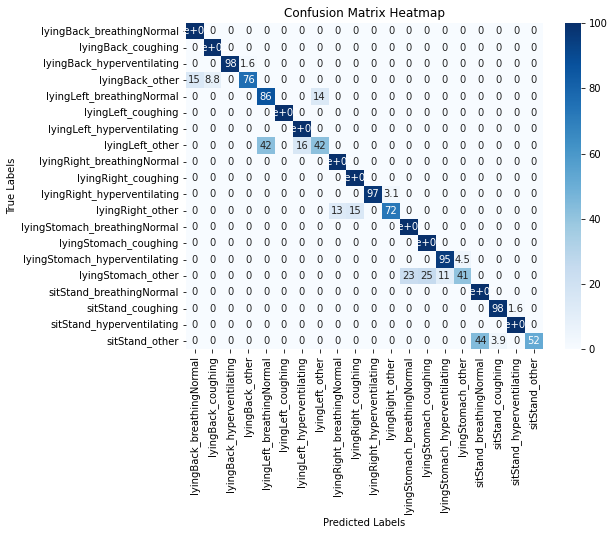

29/71 0.7469972878729175 0.7427670694773371


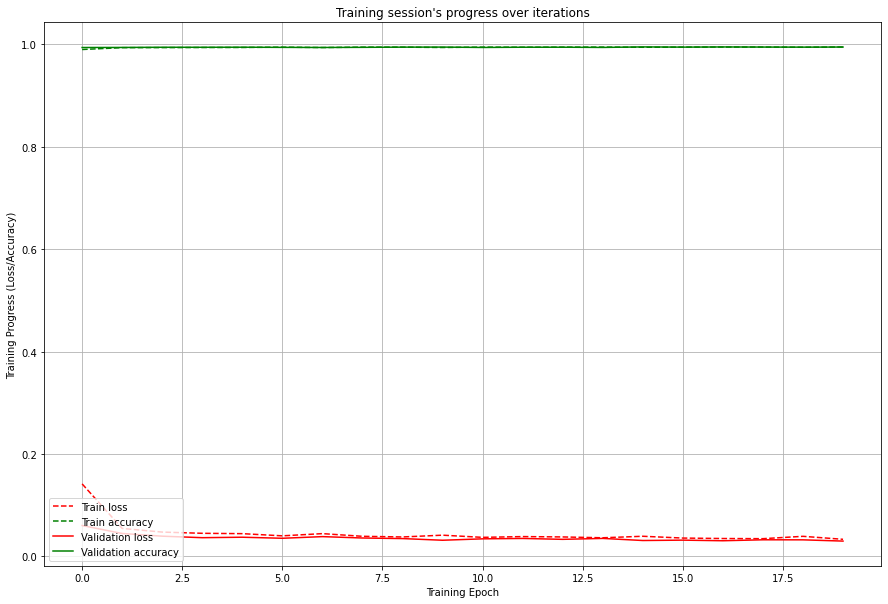

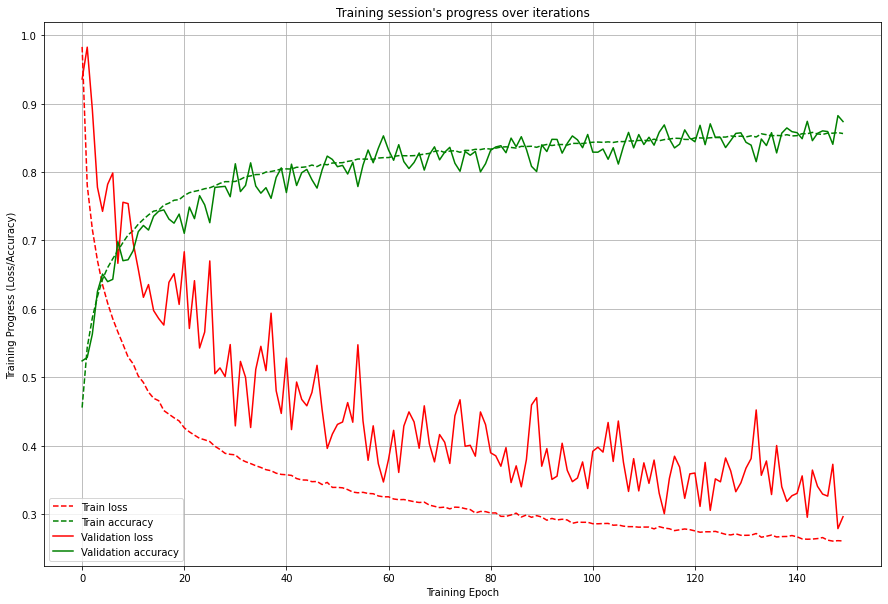

Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 normalization_30 (Normaliz  (None, None, 125)         251       
 ation)                                                          
                                                                 
 bidirectional_30 (Bidirect  (None, 512)               782336    
 ional)                                                          
                                                                 
 dropout_120 (Dropout)       (None, 512)               0         
                                                                 
 dense_120 (Dense)           (None, 64)                32832     
                                                                 
 dense_121 (Dense)           (None, 5)                 325       
                                                                 
Total params: 815744 (3.11 MB)
Trainable params: 8154

In [ ]:
accuracies = accuracies_old
histories_act = []
histories_sub = []

for i,student in enumerate(students[34:]):
    train_dataset = task3Dataset[task3Dataset.file_id != student]
    test_dataset = task3Dataset[task3Dataset.file_id == student]

    Xtrn_act, Xtrn_sub, ytrn_act, ytrn_sub = sliding_window(train_dataset, 4)
    Xtst_act, Xtst_sub, ytst_act, ytst_sub = sliding_window(test_dataset, 4)

#     print(" ..after sliding and reshaping, train data: inputs {0}, targets {1}".format(X_train.shape, y_train.shape))
#     print(" ..after sliding and reshaping, test data : inputs {0}, targets {1}".format(X_test.shape, y_test.shape))

    # ACTIVITIES
    model1 = build_model_activities(Xtrn_act)
    history_act = model1.fit(Xtrn_act, ytrn_act, epochs = 20, validation_split = 0.20, batch_size = 128, verbose=1, class_weight=class_weights_dict_act)
    pred_y_act = list(map(np.argmax, model1.predict(Xtst_act)))
    true_y_act = list(map(np.argmax, ytst_act))
    
    # SUBACTIVITIES
    model2 = build_model3()
    history_sub = model2.fit(Xtrn_sub, ytrn_sub, epochs = 150, validation_split = 0.20, batch_size = 128, verbose=1, class_weight=class_weights_dict_sub)#, callbacks=[early_stopping])
    pred_y_sub = list(map(np.argmax, model2.predict(Xtst_sub)))
    true_y_sub = list(map(np.argmax, ytst_sub))
    
    pred_y = list(map(lambda x: f'{label_stationary_dict[x[0]]}_{label_sub_activity_dict[x[1]]}', zip(pred_y_act, pred_y_sub)))
    true_y = list(map(lambda x: f'{label_stationary_dict[x[0]]}_{label_sub_activity_dict[x[1]]}', zip(true_y_act, true_y_sub)))

    labels = np.unique(pred_y)
    
    cm = confusion_matrix(true_y, pred_y)
    cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

    plt.figure(figsize=(8, 6))
    sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=labels, yticklabels=labels)
    plt.xlabel("Predicted Labels")
    plt.ylabel("True Labels")
    plt.title("Confusion Matrix Heatmap")
    plt.show()
    
    accuracy = accuracy_score(true_y, pred_y)
    accuracies.append(accuracy)
    histories_act.append(history_act)
    histories_sub.append(history_sub)

    print(f'{i}/{len(students)}', accuracy, np.average(accuracies))

    plt.figure(figsize=(15,10))
    plt.plot(np.array(history_act.history['loss']), "r--", label = "Train loss")
    plt.plot(np.array(history_act.history['accuracy']), "g--", label = "Train accuracy")
    plt.plot(np.array(history_act.history['val_loss']), "r-", label = "Validation loss")
    plt.plot(np.array(history_act.history['val_accuracy']), "g-", label = "Validation accuracy")
    plt.title("Training session's progress over iterations")
    plt.legend(loc='lower left')
    plt.ylabel('Training Progress (Loss/Accuracy)')
    plt.xlabel('Training Epoch')
    # plt.ylim(0)
    plt.grid()
    plt.show()
    
    plt.figure(figsize=(15,10))
    plt.plot(np.array(history_sub.history['loss']), "r--", label = "Train loss")
    plt.plot(np.array(history_sub.history['accuracy']), "g--", label = "Train accuracy")
    plt.plot(np.array(history_sub.history['val_loss']), "r-", label = "Validation loss")
    plt.plot(np.array(history_sub.history['val_accuracy']), "g-", label = "Validation accuracy")
    plt.title("Training session's progress over iterations")
    plt.legend(loc='lower left')
    plt.ylabel('Training Progress (Loss/Accuracy)')
    plt.xlabel('Training Epoch')
    # plt.ylim(0)
    plt.grid()
    plt.show()

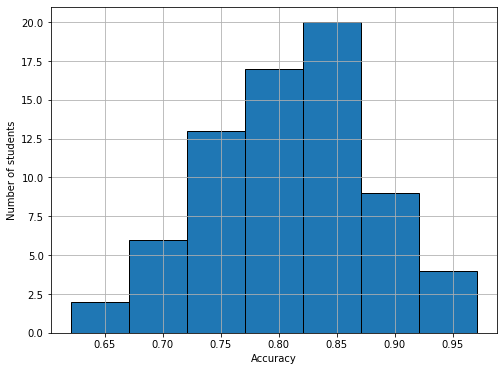

0.8041332501132601

In [46]:
plt.figure(figsize=(8,6))
plt.hist(accuracies, bins=np.arange(min(accuracies), max(accuracies) + 0.05, 0.05), edgecolor='black')
plt.xlabel('Accuracy')
plt.ylabel('Number of students')
plt.grid()
plt.savefig('acc_spread_3.pdf')
plt.show()
np.average(accuracies)

1128/1128 [==============================] - 2s 2ms/step


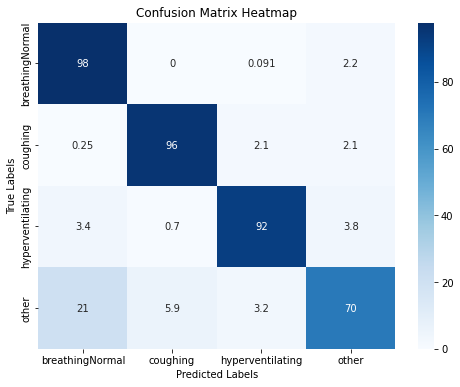

In [107]:
# true_y = list(map(np.argmax, y_test))
# pred_y = list(map(np.argmax, model.predict(X_test)))

# cm = confusion_matrix(true_y, pred_y)
# cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis] * 100

# plt.figure(figsize=(8, 6))
# sns.heatmap(cm, annot=True, cmap="Blues", xticklabels=sub_activity_label_dict, yticklabels=sub_activity_label_dict)
# plt.xlabel("Predicted Labels")
# plt.ylabel("True Labels")
# plt.title("Confusion Matrix Heatmap")
# # plt.savefig('cm_task4_sub.pdf')
# plt.show()